  ### The task is to forecast the total amount of products sold in every shop for the test set. 

#### Import necessary libraries

In [329]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import TimeSeriesSplit, KFold, train_test_split
from datetime import datetime, date
from dateutil.relativedelta import relativedelta
from sklearn.preprocessing import StandardScaler
import sklearn.metrics as metrics
import pandas as pd
from math import sqrt
import datetime as dt
import os
from keras.callbacks import LambdaCallback
from keras.models import Sequential
from keras.layers import Dense, Activation
from keras.layers import LSTM
from keras.optimizers import RMSprop

import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil
import numpy as np

%matplotlib inline

Using TensorFlow backend.


#### Load the data

In [125]:
os.chdir('../Data')
os.getcwd()

'/Users/pavelfedorov/Desktop/competitive_data_science/How to win DS competitions/Data'

In [126]:
os.listdir()

['submission_2',
 '.DS_Store',
 'sales_train.csv',
 'shops.csv',
 'test.csv',
 'item_categories.csv',
 'test_pairs.csv',
 'submission_1',
 'items.csv',
 'sample_submission.csv']

In [256]:
df_sales_train = pd.read_csv('sales_train.csv')
df_test = pd.read_csv('test.csv')
df_shops = pd.read_csv('shops.csv')
df_item_cat = pd.read_csv('item_categories.csv')
df_items = pd.read_csv('items.csv')
sample_submission = pd.read_csv('sample_submission.csv')

First we will check if all shop and items in the test set is also in the training set.

In [257]:
test_shops = df_test.shop_id.unique()
train = df_sales_train[df_sales_train.shop_id.isin(test_shops)]
test_items = df_test.item_id.unique()
train = df_sales_train[df_sales_train.item_id.isin(test_items)]

In [222]:
MAX_BLOCK_NUM = df_sales_train.date_block_num.max()
MAX_ITEM = len(test_items)
MAX_CAT = len(df_item_cat)
MAX_YEAR = 3
MAX_MONTH = 4 # 7 8 9 10
MAX_SHOP = len(test_shops)

,shop_id,date_block_num,item_cnt_day


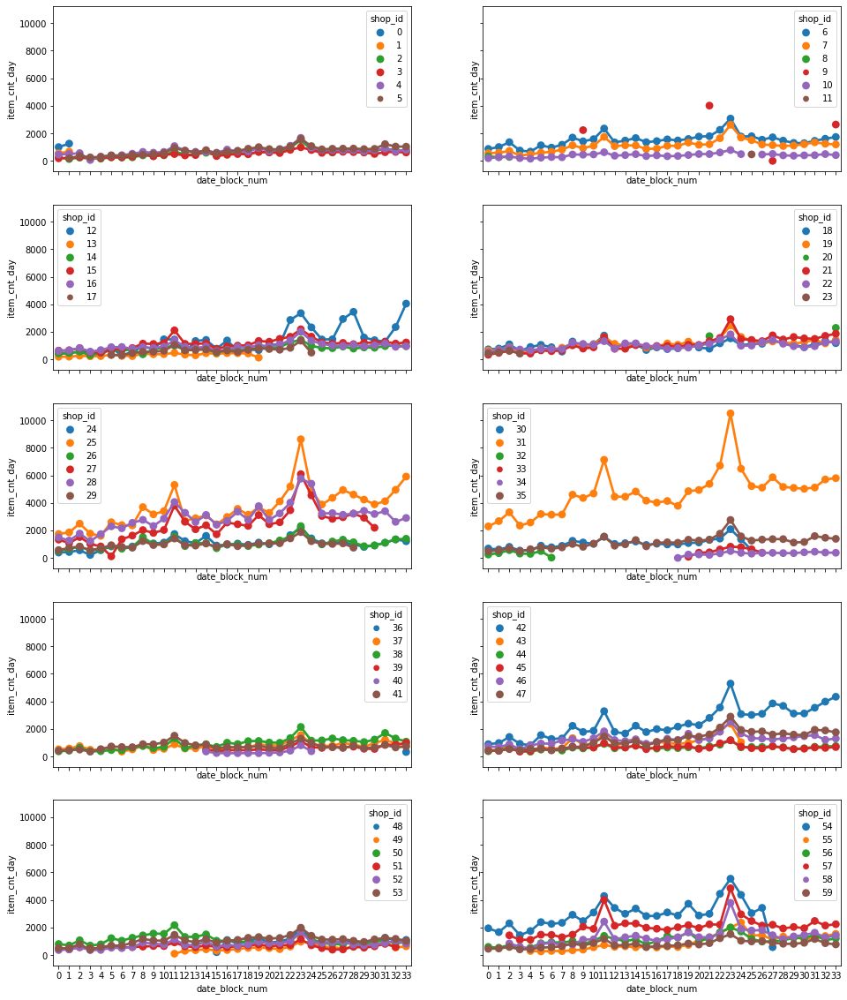

In [244]:
grouped = pd.DataFrame(train.groupby(['shop_id', 'date_block_num'])['item_cnt_day'].sum().reset_index())
fig, axes = plt.subplots(nrows=5, ncols=2, sharex=True, sharey=True, figsize=(16,20))

num_graph = 10
id_per_graph = ceil(grouped.shop_id.max() / num_graph)
count = 0

for i in range(5):
    for j in range(2):
        sns.pointplot(x='date_block_num', y='item_cnt_day', hue='shop_id', data=grouped[np.logical_and(count*id_per_graph <= grouped['shop_id'], grouped['shop_id'] < (count+1)*id_per_graph)], ax=axes[i][j])
        count += 1
        
grouped[np.logical_and(count*id_per_graph <= grouped['shop_id'], grouped['shop_id'] < (count+1)*id_per_graph)]

Clearly, there is a peak in shop shop at the end of the year, probably due to the holiday season. Therefore, it would be beneficial to add month and year, so that the network can pickup this pattern. It would be nice to see how each item sale is going. However, given the number of items, it would be more beneficial if we look at how each item categories is doing instead.

In [259]:
train = train.set_index('item_id').join(df_items.set_index('item_id')).drop('item_name', axis=1).reset_index()

In [260]:
train.head()

,item_id,date,date_block_num,shop_id,item_price,item_cnt_day,item_category_id
0,30,28.02.2013,1,50,399.0,1.0,40
1,30,26.02.2013,1,50,399.0,1.0,40
2,30,12.02.2013,1,50,399.0,1.0,40
3,30,14.02.2013,1,50,399.0,2.0,40
4,30,15.02.2013,1,50,399.0,3.0,40


In [261]:
train['month'] = train.date.apply(lambda x: datetime.strptime(x, '%d.%m.%Y').strftime('%m'))
train['year'] = train.date.apply(lambda x: datetime.strptime(x, '%d.%m.%Y').strftime('%Y'))

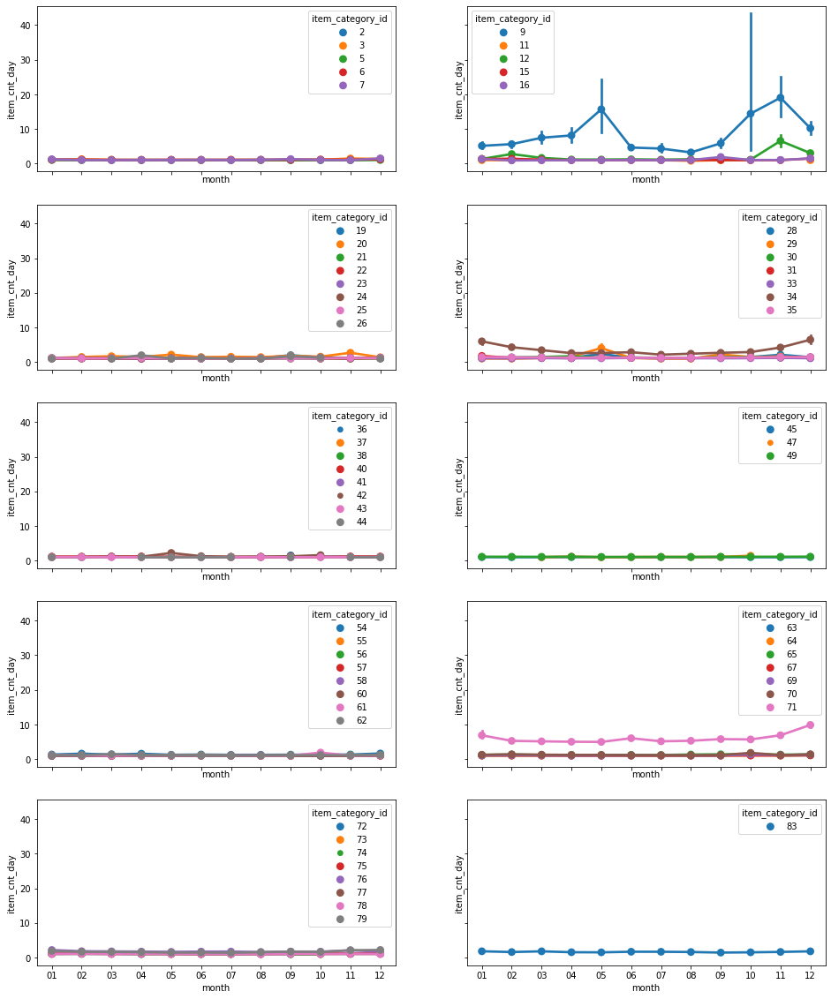

In [251]:
fig, axes = plt.subplots(nrows=5, ncols=2, sharex=True, sharey=True, figsize=(16,20))
num_graph = 10
id_per_graph = ceil(train.item_category_id.max() / num_graph)
count = 0
for i in range(5):
    for j in range(2):
        sns.pointplot(x='month', y='item_cnt_day', hue='item_category_id', 
                      data=train[np.logical_and(count*id_per_graph <= train['item_category_id'], train['item_category_id'] < (count+1)*id_per_graph)], 
                      ax=axes[i][j])
        count += 1

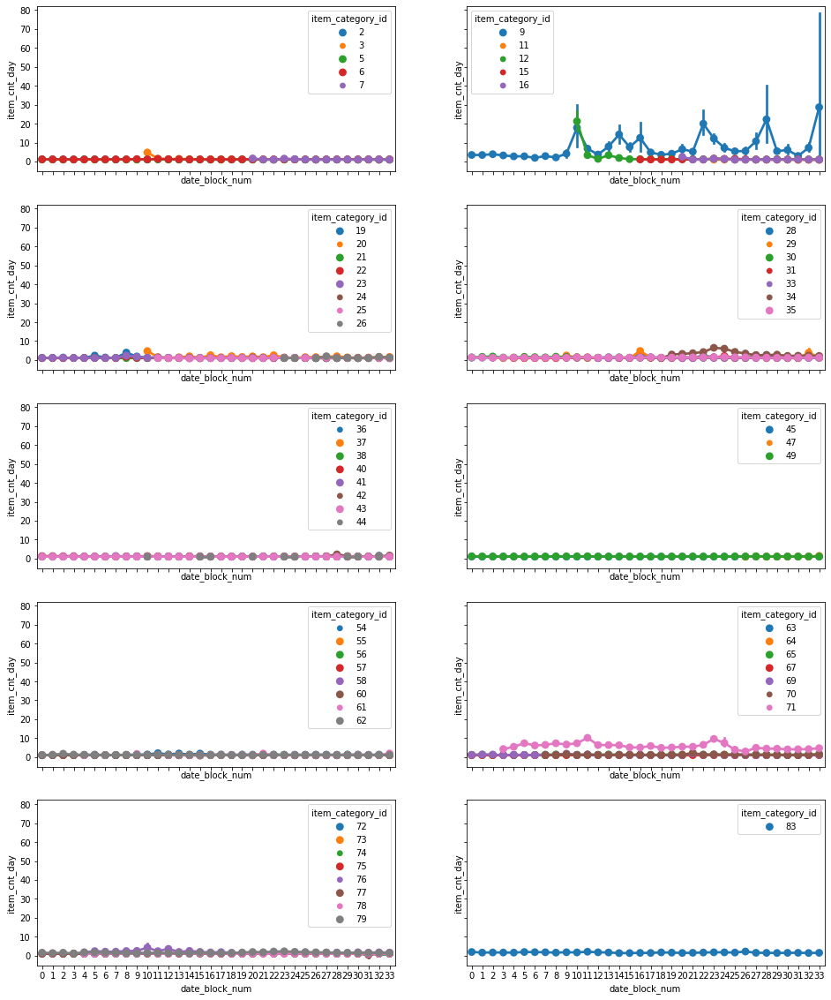

In [252]:
fig, axes = plt.subplots(nrows=5, ncols=2, sharex=True, sharey=True, figsize=(16,20))
num_graph = 10
id_per_graph = ceil(train.item_category_id.max() / num_graph)
count = 0
for i in range(5):
    for j in range(2):
        sns.pointplot(x='date_block_num', y='item_cnt_day', hue='item_category_id', 
                      data=train[np.logical_and(count*id_per_graph <= train['item_category_id'], train['item_category_id'] < (count+1)*id_per_graph)], 
                      ax=axes[i][j])
        count += 1

In [263]:
train = train.drop('date', axis=1)
train = train.drop('item_category_id', axis=1)
train = train.groupby(['shop_id', 'item_id', 'date_block_num', 'month', 'year']).sum()
train = train.sort_index()

item_price  item_cnt_day
shop_id item_id date_block_num month year                          
0       30      1              02    2013      2385.0          31.0
        31      1              02    2013      3038.0          11.0
        32      0              01    2013       884.0           6.0
                1              02    2013      1547.0          10.0
        33      0              01    2013      1041.0           3.0
...                                               ...           ...
59      22164   27             04    2015      1398.0           2.0
                30             07    2015       699.0           1.0
        22167   9              10    2013       299.0           1.0
                11             12    2013       598.0           2.0
                17             06    2014       299.0           1.0

[704403 rows x 2 columns]

### Training
In gradient based learning method, it is common to normalize the numerical variable to speed up the training

In [275]:
scaler = StandardScaler()
cnt_scaler = StandardScaler()

scaler.fit(train.item_price.as_matrix().reshape(-1, 1))
cnt_scaler.fit(train.item_cnt_day.as_matrix().reshape(-1, 1))

train.item_price = scaler.transform(train.item_price.as_matrix().reshape(-1, 1))
train.item_cnt_day = cnt_scaler.transform(train.item_cnt_day.as_matrix().reshape(-1, 1))

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  """
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:7: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  import sys
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:8: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  


It is natural to try to encode the whole training set to feed to the network. However, this approach has two drawbacks:

* It is unlikely that sale data from Jan 2013 or any time close by has any effect with sale of Nov 2015.

* The memory requirements exceed the limit that Kaggle provides.

We would instead learn the sequence of July, August, September, October, November in 2013 and 2014.

### Missing data
Not every item is saled in the above time period, we will add a record for them with `item_cnt_day` as 0. The `price` is a little bit tricky. As can be seen at the code below, price of an item depends on shop and point of time. We will fill in empty values with the closest past record.

In [277]:
train.reset_index().groupby(['item_id', 'date_block_num', 'shop_id']).mean()

item_price  item_cnt_day
item_id date_block_num shop_id                          
30      1              0          0.040539      2.474011
                       1         -0.034424      0.636210
                       3         -0.071057      0.111124
                       4          0.041812      0.373667
                       5         -0.071057      0.198638
...                                    ...           ...
22167   33             28        -0.254505     -0.151419
                       37        -0.254505     -0.151419
                       42        -0.169923      0.111124
                       47        -0.254505     -0.151419
                       50        -0.254505     -0.151419

[704403 rows x 2 columns]

For easier grouping, I would change the grouping order a little

In [292]:
price = train.reset_index().set_index(['item_id', 'shop_id', 'date_block_num'])
price = price.sort_index()

I would then define some helper functions

In [303]:
def convert(date_block):
    date = datetime(2013, 1, 1)
    date += relativedelta(months = date_block)
    return (date.month, date.year)

def closest_date_block(current_day, item_id, shop_id):
    """Find the block_date which is closest to the current_day, given item_id and shop_id. Returns index integer"""
    if (item_id, shop_id) in price.index:
        search_lst = np.array(price.loc[(item_id, shop_id)].index)
        return search_lst[np.abs(current_day - search_lst).argmin()]
    return -1
                
def closest_price(current_day, item_id, shop_id):
    closest_date = closest_date_block(current_day, item_id, shop_id)
    if closest_date != -1:
        return price.loc[( item_id, shop_id, closest_date )]['item_price']
    return np.nan

def closest_price_lambda(x):
    return closest_price(34, x.item_id, x.shop_id)

In [304]:
assert closest_date_block(18, 30, 5) == 18

Int64Index([1, 2, 3, 9, 12, 17, 18, 19, 31], dtype='int64', name='date_block_num')


In [305]:
print(convert(6))
print(convert(18))
print(convert(30))

(7, 2013)
(7, 2014)
(7, 2015)


In [320]:
maxlen = 4 # 4 months
step = 1
# 0: train, 1: val, 2:test
sentences = [[],[],[]]
next_chars = [[], []]
BLOCKS = [6, 18, 30]

for s in test_shops:
    shop_items = list(train.loc[s].index.get_level_values(0).unique())
    for it in shop_items:        
        for i_index, i in enumerate(BLOCKS):
            sentence = []
            closest_pc = closest_price(i, it, s)            
            for j in range(maxlen+1):
                if j < maxlen:
                    if (s, it, i+j) in train.index:
                        r = train.loc[(s, it, i + j)].to_dict(orient='list')                    
                        closest_pc = r['item_price'][0]
                        item_cnt_day = r['item_cnt_day'][0]
                        row = {'shop_id': s, 'date_block_num': i+j, 'item_cnt_day': item_cnt_day, 
                               'month': month, 'item_id': it, 'item_price': closest_pc, 'year': year}
                    else:
                        month, year = convert(i+j)                    
                        row = {'shop_id': s, 'date_block_num': i+j, 'item_cnt_day': 0, 
                               'month': month, 'item_id': it, 'item_price': closest_pc, 'year': year}
                    sentence.append(row)
                elif i_index < 2:   # not in test set
                    next_chars[i_index].append(row)
            sentences[i_index].append(sentence)

Int64Index([1, 2, 3, 9, 12, 17, 18, 19, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 9, 12, 17, 18, 19, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 9, 12, 17, 18, 19, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 12, 16, 21, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 12, 16, 21, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 12, 16, 21, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 14, 16, 22, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 14, 16, 22, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 14, 16, 22, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 7, 8, 21, 23, 25, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 7, 8, 21, 23, 25, 26, 30, 33], dtype='int64', 

Int64Index([5, 10, 16, 20, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 10, 12, 17, 19, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 10, 12, 17, 19, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 10, 12, 17, 19, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([5, 26, 28], dtype='int64', name='date_block_num')
Int64Index([5, 26, 28], dtype='int64', name='date_block_num')
Int64Index([5, 26, 28], dtype='int64', name='date_block_num')
Int64Index([4, 6, 13, 14, 18, 25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([4, 6, 13, 14, 18, 25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([4, 6, 13, 14, 18, 25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num

Int64Index([18, 20, 23, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 11, 12, 13, 17, 19, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 11, 12, 13, 17, 19, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 11, 12, 13, 17, 19, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 33], dtype='int6

Int64Index([9, 10, 11, 12, 13, 14, 19, 23, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 19, 23, 31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 11, 12, 13], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 11, 12, 13], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 11, 12, 13], dtype='int64', name='date_block_num')
Int64Index([6, 8, 12, 19], dtype='int64', nam

           dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  6,  7,  8,  9, 10, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  6,  7,  8,  9, 10, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 17, 20, 24, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 17, 20, 24, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 17, 20, 24, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 17, 19, 21, 22, 23, 24, 27, 28, 29, 31,
            32],
    

Int64Index([10, 15, 20], dtype='int64', name='date_block_num')
Int64Index([8, 29], dtype='int64', name='date_block_num')
Int64Index([8, 29], dtype='int64', name='date_block_num')
Int64Index([8, 29], dtype='int64', name='date_block_num')
Int64Index([6, 19, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([6, 19, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([6, 19, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([3, 8, 15, 18, 21, 29, 33], dtype='int64', name='date_block_num')
Int64Index([3, 8, 15, 18, 21, 29, 33], dtype='int64', name='date_block_num')
Int64Index([3, 8, 15, 18, 21, 29, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', nam

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 29, 32, 33], dtype='int64', name='dat

Int64Index([15, 21], dtype='int64', name='date_block_num')
Int64Index([15, 21], dtype='int64', name='date_block_num')
Int64Index([15, 21], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 12, 19, 29], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 12, 19, 29], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 12, 19, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 16, 18, 19, 20, 21, 23, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 16, 18, 19, 20, 21, 23, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 16, 18, 19, 20, 21, 23, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([15, 29], dtype='int64', name='date_block_num')
Int64Index([15, 29], dtype='int64', name='date_blo

Int64Index([5, 11, 16], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([11, 15, 16, 18, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([11, 15, 16, 18, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([11, 15, 16, 18, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([1, 2, 14, 23, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 14, 23, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 14, 23, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name=

Int64Index([12, 24], dtype='int64', name='date_block_num')
Int64Index([12, 24], dtype='int64', name='date_block_num')
Int64Index([12, 24], dtype='int64', name='date_block_num')
Int64Index([3, 10, 12, 17, 24], dtype='int64', name='date_block_num')
Int64Index([3, 10, 12, 17, 24], dtype='int64', name='date_block_num')
Int64Index([3, 10, 12, 17, 24], dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 9, 11, 15, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 9, 11, 15, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 9, 11, 15, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 14, 15, 17, 20, 22, 23, 24, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 14, 15, 17, 20, 22, 23, 24, 25, 30, 32, 33], dtype='int64'

Int64Index([11, 14, 18, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 14, 18, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 14, 18, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([12, 23], dtype='int64', name='date_block_num')
Int64Index([12, 23], dtype='int64', name='date_block_num')
Int64Index([12, 23], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 20, 23, 29], dtype='int64', name='date_block_num')
Int64Index([17, 20, 23, 29], dtype='int64', name='date_block_num')
Int64Index([17, 20, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 27], dtype='int64', name='date_block_num')
Int64Index([22, 27], dtype='int64', name='date_block_num')
Int64Index([22, 27], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 30], dt

Int64Index([24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,

Int64Index([1, 4, 5, 14, 20, 21, 30], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 14, 20, 21, 30], dtype='int64', name='date_block_num')
Int64Index([4, 8, 12, 33], dtype='int64', name='date_block_num')
Int64Index([4, 8, 12, 33], dtype='int64', name='date_block_num')
Int64Index([4, 8, 12, 33], dtype='int64', name='date_block_num')
Int64Index([13, 21, 33], dtype='int64', name='date_block_num')
Int64Index([13, 21, 33], dtype='int64', name='date_block_num')
Int64Index([13, 21, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 18, 31], dtype='int64', name='date_block_num')
Int64Index([4, 6, 18, 31], dtype='int64', name='date_block_num')
Int64Index([4, 6, 18, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9], dtype='int64', name='date_block_num')
Int64Index([8, 9], dtype='int64', name='date_block_num')
Int64Index([8, 9], dtype='int64', name='date_block_num')
Int64Index([2, 4, 11, 18, 20], dtype='int64', name='date_block_num')
Int64Index([2, 4, 11, 18, 20]

           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 7, 10, 11, 12, 14, 15, 16, 18, 23, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 7, 10, 11, 12, 14, 15, 16, 18, 23, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 7, 10, 11, 12, 14, 15, 16, 18, 23, 29], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 9, 10, 11, 12, 13, 16, 17, 18, 21, 22, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 9, 10, 11, 12, 13, 16, 17, 18, 21, 22, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 9, 10, 11, 12, 13, 16, 17, 18, 21, 22, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20

Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([11, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([11, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 11, 12, 13, 16, 17, 18, 19, 20, 21, 22, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 11, 12, 13, 16, 17, 18, 19, 20, 21, 22, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 11, 12, 13, 16, 17, 18, 19, 20, 21, 22, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([3, 4, 24], dtype='int64', name='date_block_num')
Int64Index([3, 4, 24], dtype='int

Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        

Int64Index([6, 19], dtype='int64', name='date_block_num')
Int64Index([6, 19], dtype='int64', name='date_block_num')
Int64Index([19, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 12, 16, 20, 28], dtype='int64', name='date_block_num')
Int64Index([4, 12, 16, 20, 28], dtype='int64', name='date_block_num')
Int64Index([4, 12, 16, 20, 28], dtype='int64', name='date_block_num')
Int64Index([3, 4, 10, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 10, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 10, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 12, 15, 18, 19, 20, 23, 25, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([8, 12, 15, 18, 19, 20, 23, 25, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([8, 12, 15, 18, 19, 20, 23, 25, 26, 29, 33]

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 

Int64Index([18, 19, 21, 27, 31], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([11, 12, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 12, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 12, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 12, 23], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28,
            29],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 2

           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  7,  8,  9, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21, 23,
            24, 25, 27, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  7,  8,  9, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21, 23,
            24, 25, 27, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  7,  8,  9, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21, 23,
            24, 25, 27, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 9, 11, 12, 14, 21, 29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 9, 11, 12, 14, 21, 29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 9, 11, 12, 14, 21, 29, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 17, 18, 19, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 17, 18, 19, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13

Int64Index([16, 20, 31], dtype='int64', name='date_block_num')
Int64Index([16, 20, 31], dtype='int64', name='date_block_num')
Int64Index([16, 20, 31], dtype='int64', name='date_block_num')
Int64Index([1, 8, 14], dtype='int64', name='date_block_num')
Int64Index([1, 8, 14], dtype='int64', name='date_block_num')
Int64Index([1, 8, 14], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([14, 33], dtype='int64', name='date_block_num')
Int64Index([14, 33], dtype='int64', name='date_block_num')
Int64Index([14, 33], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 22], dtype='int64', name='date_block_num')
Int64Index([17, 22], dtype

           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 28, 29, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 28, 29, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 28, 29, 33],
           dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 24, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 24, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 10, 11, 13, 14, 15, 16, 17, 20, 22, 24, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 20, 26, 33], dtype='int64', name

Int64Index([21, 23, 29], dtype='int64', name='date_block_num')
Int64Index([21, 23, 29], dtype='int64', name='date_block_num')
Int64Index([21, 23, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='dat

Int64Index([28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16], dtype='int64', name='date_block_num')
Int64Index([4, 9, 10, 19, 23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([4, 9, 10, 19, 23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([4, 9, 10, 19, 23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([2, 4, 11, 12, 14, 16, 18, 20, 21, 23, 25, 30, 32], dtype='int64', name='date_block_num'

Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31

Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([10, 15, 18, 32], dtype='int64', name='date_block_num')
Int64Index([10, 15, 18, 32], dtype='int64', name='date_block_num')
Int64Index([10, 15, 18, 32], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([20, 30], dtype='int64', name='date_block_num')
Int64Index([20, 30], dtype='int64', name='date_block_num')
Int64Index([20, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 20, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 20, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 20, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([1, 4, 9, 10, 11, 12, 14, 18, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 4, 9, 10, 11, 12, 14, 18, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 4, 9, 10, 11, 12, 14, 18, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 31], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 9, 14, 16, 19, 23, 32], dtype='int64', name='date_block_num')
Int64Index([1,

Int64Index([3, 13, 14, 30], dtype='int64', name='date_block_num')
Int64Index([3, 13, 14, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 12, 13, 17], dtype='int64', name='date_block_num')
Int64Index([4, 5, 12, 13, 17], dtype='int64', name='date_block_num')
Int64Index([4, 5, 12, 13, 17], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 12, 14, 15, 19, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 12, 14, 15, 19, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 12, 14, 15, 19, 23], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num

Int64Index([4, 7, 9, 11], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 11], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 11], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 13], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 13], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 13], dtype='int64', name='date_block_num')
Int64Index([2, 7, 9, 10, 12, 15, 16, 18, 19, 21, 22, 24, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 7, 9, 10, 12, 15, 16, 18, 19, 21, 22, 24, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 7, 9, 10, 12, 15

Int64Index([2, 6, 7, 13, 14, 18, 19, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([7, 10, 11, 12, 17, 19, 21, 23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 10, 11, 12, 17, 19, 21, 23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 10, 11, 12, 17, 19, 21, 23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([6, 24], dtype='int64', name='date_block_num')
Int64Index([6, 24], dtype='int64', name='date_block_num')
Int64Index([6, 24], dtype='int64', name='date_block_num')
Int64Index([6, 8, 12, 19, 21, 24, 31], dtype='int64', name='date_block_num')
Int64Index([6, 8, 12, 19, 21, 24, 31], dtype='int64', name='date_block_num')
Int64Index([6, 8, 12, 19, 21, 24, 31], dt

Int64Index([21, 31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([1, 6, 9, 11, 20, 21, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 6, 9, 11, 20, 21, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 6, 9, 11, 20, 21, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 9, 10, 11, 20, 21, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 9, 10, 11, 20, 21, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 9, 10, 11, 20, 21, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 9, 13, 14, 16, 19, 21, 22, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 9, 13, 14, 16, 19, 21, 22, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7,

Int64Index([19, 21, 22, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', n

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 8, 12, 13, 16, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 8, 12, 13, 16, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 8, 12, 13, 16, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 29, 3

Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([15, 16, 22], dtype='int64', name='date_block_num')
Int64Index([15, 16, 22], dtype='int64', name='date_block_num')
Int64Index([15, 16, 22], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 13, 14, 17, 18, 19, 21, 23, 25,

Int64Index([14, 27], dtype='int64', name='date_block_num')
Int64Index([14, 27], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([11, 18, 28], dtype='int64', name='date_block_num')
Int64Index([11, 18, 28], dtype='int64', name='date_block_num')
Int64Index([11, 18, 28], dtype='int64',

Int64Index([1, 4, 7, 9, 12, 18, 19, 29], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 9, 12, 18, 19, 29], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([1, 6, 8, 15, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([1, 6, 8, 15, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([1, 6, 8, 15, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([5, 6, 9, 12, 19, 22, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([5, 6, 9, 12, 19, 22, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([5, 6, 9, 12, 19, 22, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([25, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')


Int64Index([5, 11, 23, 25], dtype='int64', name='date_block_num')
Int64Index([10, 14, 16, 19, 23], dtype='int64', name='date_block_num')
Int64Index([10, 14, 16, 19, 23], dtype='int64', name='date_block_num')
Int64Index([10, 14, 16, 19, 23], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 30], dtype='int64', name='date_block_num')
Int64Index([24, 30], dtype='int64', name='date_block_num')
Int64Index([24, 30], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dt

Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([11, 24, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 24, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 24, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([3, 6, 11], dtype='int64', name='date_block_num')
Int64Index([3, 6, 11], dtype='int64', name='date_block_num')
Int64Index([3, 6, 11], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64

Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 11, 12, 13, 22, 23, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 11, 12, 13, 22, 23, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 11, 12, 13, 22, 23, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([12, 15, 19, 24, 25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([12, 15, 19, 24, 25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([12, 15, 19, 24, 25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  6,  7, 10, 11, 13, 14, 16, 17, 18, 19, 21, 22, 23, 24,
            25, 26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  6,  7, 10, 11, 13, 14, 16, 17, 18, 19, 21, 22, 23, 24,
            25, 26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  6,  7, 10, 11, 13, 14, 16, 17, 18, 19, 21, 22, 23, 24,
            25, 26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  7,  9, 11, 12, 13, 14, 15, 18, 19, 21, 23, 24, 25, 26, 27,
            28, 29, 30, 31, 32, 33],
           dtype='int64', name=

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 27, 28], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 27, 28], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 27, 28], dtype='int64', name='date_block_num')
Int64Index([5, 6, 12, 18, 19, 20, 22, 28, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 12, 18, 19, 20, 22, 28, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 12, 18, 19, 20, 22, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([4, 6], dtype='int64', name='date_block_num')
Int64Index([4, 6], dtype='int64', name='date_block_num')
Int64Index([4, 6], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64',

Int64Index([17, 18, 19, 20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([16, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_nu

Int64Index([3, 5, 7, 11, 13, 25, 26], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 11, 13, 25, 26], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 11, 13, 25, 26], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([17, 31], dtype='int64', name='date_block_num')
Int64Index([17, 31], dtype='int64', name='date_block_num')
Int64Index([17, 31], dtype='int64', name='date_bloc

Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([16, 18, 31], dtype='int64', name='date_block_num')
Int64Index([16, 18, 31], dtype='int64', name='date_block_num')
Int64Index([16, 18, 31], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([16, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 30, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([6, 9, 17, 18], dtype='int64', name='date_block_num')
Int64Index([6, 9, 17, 18], dtype='int64', name='date_block_num')

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 22, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 22, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 22, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 11, 14, 19, 22, 23, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 11, 14, 19, 22, 23

Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([10, 11], dtype='int64', name='date_block_num')
Int64Index([10, 11], dtype='int64', name='date_block_num')
Int64Index([10, 11], dtype='int64', name='date_block_num')
Int64Index([19, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 32, 33], dtype='int64', nam

Int64Index([1, 4, 6, 7, 8, 11, 13, 16, 17], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 8, 11, 13, 16, 17], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([7, 9, 18, 19], dtype='int64', name='date_block_num')
Int64Index([7, 9, 18, 19], dtype='int64', name='date_block_num')
Int64Index([7, 9, 18, 19], dtype='int64', name='date_block_num')
Int64Index([7, 8, 19, 24, 25], dtype='int64', name='date_block_num')
Int64Index([7, 8, 19, 24, 25], dtype='int64', name='date_block_num')
Int64Index([7, 8, 19, 24, 25], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='da

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([14, 19], dtype='int64', name='date_block_num')
Int64Index([14, 19], dtype='int64', name='date_block_num')
Int64Index([14, 19], dtype='int64', name='date_block_num')
Int64Index([11, 13, 18, 19, 21, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 18, 19, 21, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 18, 19, 21, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([18, 20,

Int64Index([15, 17, 21, 23, 26, 27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([15, 19, 22], dtype='int64', name='date_block_num')
Int64Index([15, 19, 22], dtype='int64', name='date_block_num')
Int64Index([15, 19, 22], dtype='int64', name='date_block_num')
Int64Index([17, 23], dtype='int64', name='date_block_num')
Int64Index([17, 23], dtype='int64', name='date_block_num')
Int64Index([17, 23], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([16, 18, 20, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 18, 20, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10], dtype='int64', name='date_block_num')
Int64Index([9, 10], dtype='int64', name='date_block_num')
Int64Index([9, 10], dtype='int64', name='date_block_num')
Int64Index([9, 10, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 26], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 30, 31], dtype='int64', name='date_block_num')
Int64

Int64Index([13, 18, 32], dtype='int64', name='date_block_num')
Int64Index([13, 18, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 10], dtype='int64', name='date_block_num')
Int64Index([4, 6, 10], dtype='int64', name='date_block_num')
Int64Index([4, 6, 10], dtype='int64', name='date_block_num')
Int64Index([15, 16, 20, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 20, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 20, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([6, 16, 17, 18, 26], dtype='int64', name='date_block_num')
Int64Index([6, 16, 17, 18, 26], dtype='int64', name='date_block_num')
Int64Index([6, 16, 17, 18, 26], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 11, 12, 14, 15, 16, 17, 18, 20, 22, 23, 26, 27, 28,
            31],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 11, 12, 14, 15, 16, 17, 18, 20, 22, 23, 26, 27, 28,
            31],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 11, 12, 14, 15, 16, 17, 18, 20, 22, 23, 26, 27,

Int64Index([21, 23, 24, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 33], dtype='int64

Int64Index([13, 21, 24, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([13, 21, 24, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([13, 21, 24, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 11, 14, 18, 20, 26], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 11, 14, 18, 20, 26], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 11, 14, 18, 20, 26], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([8, 26], dtype='int64', name='date_block_num')
Int64Index([8, 26], dtype='int64', name='date_block_num')
Int64Index([8, 26], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([5, 7, 13], dt

Int64Index([16, 18, 25, 26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([10, 26], dtype='int64', name='date_block_num')
Int64Index([10, 26], dtype='int64', name='date_block_num')
Int64Index([10, 26], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([13, 14, 19, 20, 23, 31, 32], dtype='int64', name='da

Int64Index([4, 5, 7, 9, 12, 17, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 9, 12, 17, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 9, 12, 17, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([11, 19, 28], dtype='int64', name='date_block_num')
Int64Index([11, 19, 28], dtype='int64', name='date_block_num')
Int64Index([11, 19, 28], dtype='int64', name='date_block_num')
Int64Index([14, 15, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 31], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([5], dty

Int64Index([19, 20, 21, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([2, 4, 6, 7, 8, 9, 10, 12, 13, 21, 25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 8, 9, 10, 12, 13, 21, 25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 2

Int64Index([20, 21, 23, 24, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 12, 13, 15, 19, 24], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 12, 13, 15, 19, 24], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 12, 13, 15, 19, 24], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 6, 9, 11, 14, 15, 20], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 6, 9, 11, 14, 15, 20], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 6, 9, 11, 14, 15, 20], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2,

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 16, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 16, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 16, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([3, 11, 12, 21, 26], dtype='int64', name='date_block_num')
Int64Index([3, 11, 12, 21, 26], dtype='int64', name='date_block_num')
Int64Index([3, 11, 12, 21, 26], dtype='int64', name='date_block_num')
Int64Index([9, 20], dtype='int64', name='date_block_num')
Int64Index([9, 20], dtype='int64', name='date_block_num')
Int64Index([9, 20], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int6

Int64Index([8, 10, 11, 12, 13, 14, 15, 16, 18, 25, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 12, 13, 14, 15, 16, 18, 25, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 12, 13, 14, 15, 16, 18, 25, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 9, 10, 11, 12, 13, 14, 16, 21, 22, 23, 24, 26, 27, 28,
            29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 9, 10, 11, 12, 13, 14, 16, 21, 22, 23, 24, 26, 27, 28,
            29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 9, 10, 11, 12, 13, 14, 16, 21, 22, 23, 24, 26, 27, 28,
            29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 7, 11, 14, 16, 18, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 7, 11, 14, 16, 18, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 7, 11, 14, 16, 1

Int64Index([6, 12, 22, 30], dtype='int64', name='date_block_num')
Int64Index([6, 12, 22, 30], dtype='int64', name='date_block_num')
Int64Index([6, 12, 22, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([14, 17, 20, 28], dtype='int64', name='date_block_num')
Int64Index([14, 17, 20, 28], dtype='int64', name='date_block_num')
Int64Index([14, 17, 20, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([ 6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 29, 32], dtype='int64', name

Int64Index([22, 23, 24, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([7, 15, 17, 23, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([7, 15, 17, 23, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([7, 15, 17, 23, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6, 10, 11, 13, 14, 15, 18, 21, 22, 23, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([1, 6, 10, 11, 13, 14, 15, 18, 21, 22, 23, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([1, 6, 10, 11, 13, 14, 15, 18, 21, 22, 23, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([0, 7, 17, 20, 21], dtype='int64', name='date_block_num')
Int64Index([0, 7, 17, 20, 21], dtype='int64', name='date_block_num')
Int64Index([0, 7, 17, 20, 21], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')


Int64Index([13, 14, 15, 18, 20, 21, 23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 14, 15, 18, 19, 20, 21, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 14, 15, 18, 19, 20, 21, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 14, 15, 18, 19, 20, 21, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  5,  7, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23,
            24, 25, 27, 28, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  5,  7, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23,
            24, 25, 27, 28, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  5,  7, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23,
            24, 25

Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 11, 12, 15, 24, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 11, 12, 15, 24, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 11, 12, 15, 24, 33], dtype='int64', name='date_block_num')
Int64Index([1, 8, 9, 11, 24, 28], dtype='int64', name='date_block_num')
Int64Index([1, 8, 9, 11, 24, 28], dtype='int64', name='date_block_num')
Int64Index([1, 8, 9, 11, 24, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 23, 24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 23, 24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 23, 24, 25, 30, 31], dtype='int64', name='d

Int64Index([13, 15, 16, 17, 19, 23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([11, 20, 21, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([11, 20, 21, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([11, 20, 21, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 11, 16, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 11, 16, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 11, 16, 31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dt

Int64Index([14, 15, 16, 17, 18, 23, 24, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([14, 28], dtype='int64', name='date_block_num')
Int64Index([14, 28], dtype='int64', name='date_block_num')
Int64Index([14, 28], dtype='int64', name='date_block_num')
Int64Index([14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 16, 17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 16, 17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 16, 17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 24, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 24, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 24, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29

Int64Index([22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([17, 25, 31], dtype='int64', name='date_block_num')
Int64Index([17, 25, 31], dtype='int64', name='date_block_num')
Int64Index([17, 25, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 16, 1

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 29, 30], dtype='

Int64Index([12, 13, 16, 22, 25, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([13, 16], dtype='int64', name='date_block_num')
Int64Index([13, 16], dtype='int64', name='date_block_num')
Int64Index([13, 16], dtype='int64', name='date_block_num')
Int64Index([13, 24], dtype='int64', name='date_block_num')
Int64Index([13, 24], dtype='int64', name='date_block_num')
Int64Index([13, 24], dtype='int64', name='date_block_num')
Int64Index([13, 14, 17, 19, 21, 23, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 17, 19, 21, 23, 27], dtype='int64', name='date_block_num')

Int64Index([7, 21, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([7, 21, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([7, 21, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 13, 15, 16, 18, 19, 21, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 13, 15, 16, 18, 19, 21, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 13, 15, 16, 18, 19, 21, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 15, 22, 30], dtype='int64', name='date_block_num')
Int64Index([5, 15, 22, 30], dtype='int64', name='date_block_num')
Int64Index([5, 15, 22, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_bl

Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 11, 14, 16, 17, 18, 19, 21, 22, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 11, 14, 16, 17, 18, 19, 21, 22, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 11, 14, 16, 17, 18, 19, 21, 22, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 21, 23], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 21, 23], dtype='int64', name=

Int64Index([18, 19, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 18], dtype='int64', name='date_block_num')
Int64Index([16, 18], dtype='int64', name='date_block_num')
Int64Index([16, 18], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20, 28, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20, 28, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20, 28, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18,

Int64Index([7, 8, 9, 10, 12, 17, 18, 19, 22, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 12, 17, 18, 19, 22, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 12, 17, 18, 19, 22, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([11, 16, 23], dtype='int64', name='date_block_num')
Int64Index([11, 16, 23], dtype='int64', name='date_block_num')
Int64Index([11, 16, 23], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 16, 17, 18, 19, 20, 21, 22, 24, 26, 27, 28, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 16, 17, 18, 19, 20, 21, 22, 24, 26, 27, 28, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 16, 17, 18, 19, 20, 21, 22, 24, 26, 27, 28, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([10, 16, 25, 32], dtype='int64', name='date_block_num')
Int64Index([10, 16, 2

Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', n

Int64Index([8, 10], dtype='int64', name='date_block_num')
Int64Index([8, 10], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([19, 31], dtype='int64', name='date_block_num')
Int64Index([19, 31], dtype='int64', name='date_block_num')
Int64Index([19, 31], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 9,

Int64Index([16, 31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='da

Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([10, 23], dtype='int64', name='date_block_num')
Int64Index([10, 23], dtype='int64', name='date_block_num')
Int64Index([10, 23], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 

Int64Index([11, 12, 19, 25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 19, 25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 19, 25], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 7, 9, 11, 12, 15, 22, 23, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 7, 9, 11, 12, 15, 22, 23, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 7, 9, 11, 12, 15, 22, 23, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 9, 11, 12, 18, 19, 20, 21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 9, 11, 12, 18, 19, 20, 21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 9, 11, 12, 18, 19, 20, 21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 9, 10, 11, 23], dtype='int64', name='

Int64Index([1, 5, 7, 9, 12, 13, 14, 15, 17, 19, 21, 22, 23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 9, 12, 13, 14, 15, 17, 19, 21, 22, 23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([2, 6, 12, 13, 18, 19, 22, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([2, 6, 12, 13, 18, 19, 22, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([2, 6, 12, 13, 18, 19, 22, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 12, 13, 18, 21, 22, 23, 25, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 12, 13, 18, 21, 22, 23, 25, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 12, 13, 18, 21, 22, 23, 25, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([6, 19, 21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([6, 19, 21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([6, 19, 21, 23, 31], dtype='int64', name='date_block_

Int64Index([25, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 7, 15, 16, 17, 19, 21, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 7, 15, 16, 17, 19, 21, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 7, 15, 16, 17, 19, 21, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([11, 14, 16], dtype='int64', name='date_block_num')
Int64Index([11, 14, 16], dtype='int64', name='date_block_num')
Int64Index([11, 14, 16], dtype='int64', name='date_block_num')
Int64Index([8, 15, 18, 20, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([8, 15, 18, 20, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([8, 15, 18, 20, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 17, 20, 21, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([11, 1

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([5, 8, 17, 19, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 8, 17, 19, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 8, 17, 19, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date

Int64Index([21, 25, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 14, 20, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([10, 14, 20, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([10, 14, 20, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([4, 22, 26, 32], dtype='int64', name='date_block_num')
Int64Index([4, 22, 26, 32],

           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 27, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 27, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block

Int64Index([15, 18, 23], dtype='int64', name='date_block_num')
Int64Index([13, 20], dtype='int64', name='date_block_num')
Int64Index([13, 20], dtype='int64', name='date_block_num')
Int64Index([13, 20], dtype='int64', name='date_block_num')
Int64Index([13, 18, 19], dtype='int64', name='date_block_num')
Int64Index([13, 18, 19], dtype='int64', name='date_block_num')
Int64Index([13, 18, 19], dtype='int64', name='date_block_num')
Int64Index([0, 4, 11, 13, 17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([0, 4, 11, 13, 17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([0, 4, 11, 13, 17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([13, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([13, 23, 26, 30], dtype='int64

Int64Index([10, 19, 30], dtype='int64', name='date_block_num')
Int64Index([10, 19, 30], dtype='int64', name='date_block_num')
Int64Index([10, 19, 30], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype=

Int64Index([9, 10, 11, 12, 13, 15, 16, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 16, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 16, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([16, 19, 23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16, 19, 23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16, 19, 23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int

Int64Index([2, 8, 10, 11, 12, 13, 14, 18, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 8, 10, 11, 12, 13, 14, 18, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 9, 10, 11, 12, 13, 14, 15, 18, 23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 9, 10, 11, 12, 13, 14, 15, 18, 23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 9, 10, 11, 12, 13, 14, 15, 18, 23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14, 21, 33], dtype='int64', name='date_block_num')
Int64Index([14, 21, 33], dtype='int64', name='date_block_num')
Int64Index([14, 21, 33], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 10, 11, 12, 13, 16, 18, 22, 23, 24, 26, 27, 28, 29, 30,
            31, 32],
           dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 10, 11, 12, 13, 16, 18, 22, 23, 24, 26, 27, 28, 29, 30,
            31, 32],
           dtype='int64', name='date_block_num')
Int

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([10, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([10, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([10, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')


Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([2, 29], dtype='int64', name='date_block_num')
Int64Index([2, 29], dtype='int64', name='date_block_num')
Int64Index([2, 29], dtype='int64', name='date_block_n

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', nam

Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 8, 15, 20, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 8, 15, 20, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 8, 15, 20, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([5, 11, 16, 17, 21, 30], dtype='int64', name='date_block_num')
Int64Index([5, 11, 16, 17, 21, 30], dtype='int64', name='date_block_num')
Int64Index([5, 11, 16, 17, 21, 30], dtype='int64', name='date_block_num')
Int64Index([10, 24], dtype='int64', name='date_block_num')
Int64Index([10, 24], dtype='int64', name='date_block_num')
Int64Index([10, 24], dtype='int64', name='date_block_num')
Int64Index([5, 12], dtype='int64', name='date_block_num')
Int64Index([5, 12], dtype='int64', name='date_block_num')
Int64Index([5, 12], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 2

Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([13, 15, 19, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 15, 19, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 15, 19, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 30], dtype='int64', n

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16, 28], dtype='int64', name='date_block_num')
Int64Index([16, 28], dtype='int64', name='date_block_num')
Int64Index([16, 28], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 11, 19, 22, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 11, 19, 22, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 11, 19, 22, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 8, 11, 12, 13, 14, 15, 18, 19, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 8, 11, 12, 13, 14, 15, 18, 19, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 8, 11, 12, 13, 14, 15, 18, 19, 23, 24, 27], dtype='

Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', nam

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 23, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 23, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 23, 30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='in

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([4, 12, 15, 19, 20, 32], dtype='int64', name='date_block_num')
Int64Index([4, 12, 15, 19, 20, 32], dtype='int64', name='date_block_num')
Int64Index([4, 12, 15, 19, 20, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 30], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 30], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 30], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([2, 4, 5, 23, 27, 31], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 23, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 23, 24, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 23, 24, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 23, 24, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 23], dtype='int64', name='date_block_num')
Int64Index([0, 2, 23], dtype='int64', name='date_block_num')
Int64Index([0, 2, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 24], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='dat

Int64Index([0, 3, 5, 10, 12, 13, 15, 17, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 10, 12, 13, 15, 17, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 10, 12, 13, 15, 17, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([19, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 8, 9, 10, 12], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 8, 9, 10, 12], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 8, 9, 10, 12], dtype='int64', name='dat

Int64Index([25, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 8, 9, 11, 14, 16, 17, 18, 21, 23, 24, 25, 26, 27,
            29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 8, 9, 11, 14, 16, 17, 18, 21, 23, 24, 25, 26, 27,
            29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 8, 9, 11, 14, 16, 17, 18, 21, 23, 24, 25, 26, 27,
            29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 15, 20, 23, 27], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 15, 20, 23, 27], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 15, 20, 23, 27], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 10, 18, 20, 21, 23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 10, 18, 20, 21, 23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([2, 6,

Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 13, 14, 17, 20, 22, 23, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 13, 14, 17, 20, 22, 23, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 13, 14, 17, 20, 22, 23, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29, 31, 32], dtyp

Int64Index([5, 6, 7, 8, 9, 11, 14, 17, 20, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 11, 14, 17, 20, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 11, 14, 17, 20, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([1, 12, 13, 19, 22, 25], dtype='int64', name='date_block_num')
Int64Index([1, 12, 13, 19, 22, 25], dtype='int64', name='date_block_num')
Int64Index([1, 12, 13, 19, 22, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 19, 22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 1

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 9, 13, 17, 18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 9, 13, 17, 18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 9, 13, 17, 18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([10, 28, 31], dtype='int64', name='date_block_num')
Int64Index([10, 28, 31], dtype='int64', name='date_block_num')
Int64Index([10, 28, 31], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 7, 8, 10, 12, 15, 16, 18, 23, 24], dtype='int64', nam

Int64Index([19, 20, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 1

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32],
  

Int64Index([25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([6, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([6, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([6, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([2, 4, 10, 27, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 10, 27, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 10, 27, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 12, 18, 22, 23, 24, 25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 12, 18, 22, 23, 24, 25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 12, 18, 22, 23, 24, 25, 26, 30, 32], dtype='int64', name='date_blo

Int64Index([0, 2, 5, 6, 7, 9, 11, 12, 14, 19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 9, 11, 12, 14, 19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 8, 9, 10, 12, 15, 16], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 8, 9, 10, 12, 15, 16], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 8, 9, 10, 12, 15, 16], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 2

Int64Index([15, 16, 17, 18, 19, 22, 23, 24, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 22, 23, 24, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 22, 23, 24, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_bloc

Int64Index([2, 3, 4, 5, 6, 7, 9, 11, 17, 24, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 9, 11, 17, 24, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 9, 11, 17, 24, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 22,
            23, 24, 25, 29],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 22,
            23, 24, 25, 29],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 22,
            23, 24, 25, 29],
           dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64'

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 8, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 8, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 8, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 20, 21, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 20, 21, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 20, 21, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([2, 

Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([18, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([18, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 14, 17, 18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 14, 17, 18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 14, 17, 18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 29,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 29,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 10, 11

Int64Index([14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='in

Int64Index([2, 3, 5, 6, 7, 8, 13, 14, 15, 17, 20, 23, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 8, 13, 14, 15, 17, 20, 23, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 8, 13, 14, 15, 17, 20, 23, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 9, 10, 12, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 9, 10, 12, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 9, 10, 12, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 7, 8, 9, 11, 13, 14, 15, 16, 19, 20, 22, 23, 25, 26,
            28, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 7, 8, 9, 11, 13, 14, 15, 16, 19, 20, 22, 23, 25, 26,
            28, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 7, 8, 9, 11, 13, 14, 15, 16, 19, 20, 22, 23, 25, 26,
            28, 31],
           dtype='int64

Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 7, 8, 9, 12, 16, 19, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 7, 8, 9, 12, 16, 19, 21, 22, 23], dtype='int64', name

Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1, 5], dtype='int64', name='date_block_num')
Int64Index([1, 5], dtype='int64', name='date_block_num')
Int64Index([1, 5], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index

Int64Index([22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 11, 17, 18, 19, 20, 21, 23, 25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 11, 17, 18, 19, 20, 21, 23, 25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 11, 17, 18, 19, 20, 21, 23, 25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 11, 14, 17, 18, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 11, 14, 17, 18, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 11, 14, 17, 18, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([18, 22, 24], dtype='int64', name='date_block_num')
Int64Index([18, 22, 24], dtype='int64', name

Int64Index([0, 1, 2, 4, 5, 7, 8, 9, 10, 11, 13, 14, 15, 17, 24, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 7, 8, 9, 10, 11, 13, 14, 15, 17, 24, 30], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 21, 22, 23, 25, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 21, 22, 23, 25, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 21, 22, 23, 25, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11,

           dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 14, 15, 16, 17, 21, 22, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 14, 15, 16, 17, 21, 22, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 14, 15, 16, 17, 21, 22, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 18, 21, 22, 23,
            24, 25, 28],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 18, 21, 22, 23,
            24, 25, 28],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 18, 21, 22, 23,
            24, 25, 28],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 9, 10, 11, 12, 13, 15, 16, 19, 21], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 9, 10, 11, 12, 13, 15, 16, 19, 21], dtype='int64', name='date_block_num')

Int64Index([0, 3, 4, 5, 6, 9, 11, 12, 15, 19, 24, 25, 27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 6, 9, 11, 12, 15, 19, 24, 25, 27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 6, 9, 11, 12, 15, 19, 24, 25, 27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 24, 26, 27, 29,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 24, 26, 27, 29,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 24, 26, 27, 29,
            33],
           dtype='int64', name='date_block_num')
Int64Index([12, 18, 31

           dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 17, 18, 19, 23, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 17, 18, 19, 23, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 17, 18, 19, 23, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 19, 20, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 19, 20, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 19, 20, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  

Int64Index([18, 20, 21, 23, 24, 25, 26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 24, 25, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 24, 25, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 24, 25, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 8, 11, 12, 13, 16, 17, 18, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 8, 11, 12, 13, 16, 17, 18, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 8, 11, 12, 13, 16, 17, 18, 19, 21, 23], dtype='int64',

Int64Index([9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 31], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 19, 20, 21, 22,
            23, 24, 27],
           dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 19, 20, 21, 22,
            23, 24, 2

Int64Index([16, 17, 21, 23], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 23], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 21, 22, 23, 24, 25, 28, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 21, 22, 23, 24, 25, 28, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19

Int64Index([20, 22, 23, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([1, 8, 9, 11, 12, 14, 17, 20, 21,

Int64Index([1, 4, 6, 7], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7], dtype='int64', name='date_block_num')
Int64Index([0, 1], dtype='int64', name='date_block_num')
Int64Index([0, 1], dtype='int64', name='date_block_num')
Int64Index([0, 1], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 15, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 15, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 15, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 8, 16, 17, 19, 20, 26, 30], dtype='int64', name='

Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([10, 14, 16], dtype='int64', name='date_block_num')
Int64Index([10, 14, 16], dtype='int64', name='date_block_num')
Int64Index([10, 14, 16], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23, 26, 30], dtype='int6

           dtype='int64', name='date_block_num')
Int64Index([20, 25], dtype='int64', name='date_block_num')
Int64Index([20, 25], dtype='int64', name='date_block_num')
Int64Index([20, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 14, 15, 17, 26, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 14, 15, 17, 26, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 14, 15, 17, 26, 32], dtype='int64', name='date_block_

Int64Index([12, 16, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([12, 16, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([12, 16, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64In

Int64Index([17, 18, 19, 20, 21, 22, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([9, 14], dtype='int64', name='date_block_num')
Int64Index([9, 14], dtype='int64', name='date_block_num')
Int64Index([9, 14], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([18, 23, 31], dtype='int64', name='date_block_num')


Int64Index([11, 19, 22, 24, 31], dtype='int64', name='date_block_num')
Int64Index([0, 13], dtype='int64', name='date_block_num')
Int64Index([0, 13], dtype='int64', name='date_block_num')
Int64Index([0, 13], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 23, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 23, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 23, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 24], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 24], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 24], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 16, 17, 21, 23, 27, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 16, 17, 21, 23, 27, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 16, 17, 21, 23, 27, 33], dtype='int64', name='date_block_num')
Int64Index([5, 8, 13, 16, 20, 25, 27, 30, 31, 33], dtype='int64',

Int64Index([0, 2, 9, 10, 11, 15, 23, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 9, 10, 11, 15, 18, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 9, 10, 11, 15, 18, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 9, 10, 11, 15, 18, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 9, 10, 11, 15, 23, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 9, 10, 11, 15, 23, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 9, 10, 11, 15, 23, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([16, 17], dtype='i

Int64Index([6, 11, 12], dtype='int64', name='date_block_num')
Int64Index([6, 11, 12], dtype='int64', name='date_block_num')
Int64Index([1, 11, 13, 14, 15, 17, 22, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([1, 11, 13, 14, 15, 17, 22, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([1, 11, 13, 14, 15, 17, 22, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 23, 25], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 23, 25], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 23, 25], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 9, 11, 14, 15, 16, 19], dtype='int64', name='date_block_num')
Int64Index([1, 2, 9, 11, 14, 15, 16, 19], dtype='int64', name='date_block_num')
Int64Index([1, 2, 9, 11, 14, 15, 16, 19], dtype='int64', name='date_

Int64Index([23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([0, 8, 11, 14, 16, 22, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 8, 11, 14, 16, 22, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 8, 11, 14, 16, 22, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5, 10, 14], dtype='int64', name='date_block_num')
Int64Index([1, 5, 10, 14], dtype='int64', name='date_block_num')
Int64Index([1, 5, 10, 14], dtype='int64', name='date_block_num')
Int64Index([4, 15, 21, 26], dtype='int64', name='date_block_num')
Int64Index([4, 15, 21, 26], dtype='int64', name='date_block_num')
Int64Index([4, 15, 21, 26], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 24, 31], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 24, 31], dtype='int64', name='date_block_num')
I

Int64Index([25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([0, 6, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 6, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 6, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 5, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 5, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 5, 30, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([5, 8, 28, 33], dtype='int64', name='date_block_num')
Int64Index([5, 8, 28, 33], dtype='int64', name='date_block_num')
Int64Index([5, 8, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 6], dtype='int64', name='date_block_num')
Int64Index([0, 3, 6], dtype='int64', name='date_block_num')
Int64Index([0, 3, 6], dtype='int64', name='

Int64Index([15, 16, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 7, 10, 11], dtype='int64', name='date_block_num')
Int64Index([2, 7, 10, 11], dtype='int64', name='date_block_num')
Int64Index([2, 7, 10, 11], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 13, 14, 21, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 13, 14, 21, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 13, 14, 21, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 25, 27], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 25, 27], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 25, 27], dtype='int64', name='date_block_num')
Int64Index([16, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2], dtype='int64',

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([12, 23, 25], dtype='int64', name='date_block_num')
Int64Index([12, 23, 25], dtype='int64', name='date_block_num')
Int64Index([12, 23, 25], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([18, 21, 26, 27], dtype='int64', name='date_block_num')
Int64Index([18, 21, 26, 27], dtype='int64', name='date_block_num')
Int64Index([18, 21, 26, 27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='in

Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 16, 17, 21, 24], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 16, 17, 21, 24], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 16, 17, 21, 24], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([18, 22, 25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([18, 22, 25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([18, 22, 25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64I

Int64Index([0, 3, 16, 23, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([3, 7, 13, 16, 23, 26], dtype='int64', name='date_block_num')
Int64Index([3, 7, 13, 16, 23, 26], dtype='int64', name='date_block_num')
Int64Index([3, 7, 13, 16, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 16, 23, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 16, 23, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 16, 23, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 9, 10, 14, 15, 19, 20, 22, 24, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 9, 10, 14, 15, 19, 20, 22, 24, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 9, 10, 14, 15, 19, 20, 22, 24, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 7, 9, 10, 14, 17, 23, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([1, 7, 9, 1

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([0, 4, 8, 9, 10, 14, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 8, 9, 10, 14, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 8, 9, 10, 14, 24, 33], dtype='int64', name='date_block_num')
Int64Index([12, 16, 21], dtype='int64', name='date_block_num')
Int64Index([12, 16, 21], dtype='int64', name='date_block_num')
Int64Index([12, 16, 21], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index

Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([11, 16], dtype='int64', name='date_block_num')
Int64Index([11, 16], dtype='int64', name='date_block_num')
Int64Index([11, 16], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([17, 22], dtype='int64', name='date_block_num')
Int64Index([17, 22], dtype='int64', name='date_block_num')
Int64Index([17, 22], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([0, 6, 18], dtype='int64', na

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 11, 16, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([5, 6, 11, 16, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([5, 6, 11, 16, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([2, 6, 15, 17, 19, 30], dtype='int64', name='date_block_num')
Int64Index([2, 6, 15, 17, 19, 30], dtype='int64', name='date_block_num

Int64Index([0, 1, 2, 4, 6, 7, 10, 12], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 7, 10, 12], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 7, 10, 12], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([5, 9, 17], dtype='int64', name='date_block_num')
Int64Index([5, 9, 17], dtype='int64', name='date_block_num')
Int64Index([5, 9, 17], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 8], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 8], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 8], dtype='int64', name='date_block_num')
Int64Index([11, 23], dtype='int64', name='date_bl

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 23, 28], dtype='int64', name='date_block_num')
Int64Index([19, 23, 28], dtype='int64', name='date_block_num')
Int64Index([19, 23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 16, 20, 26, 28, 29, 33], dtype='int64', name='date_

Int64Index([20, 21, 22, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num

Int64Index([25, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 11, 13, 25, 31], dtype='int64', name='date_block_num')
Int64Index([1, 11, 13, 25, 31], dtype='int64', name='date_block_num')
Int64Index([1, 11, 13, 25, 31], dtype='int64', name='date_block_num')
Int64Index([2, 10, 23, 25], dtype='int64', name='date_block_num')
Int64Index([2, 10, 23, 25], dtype='int64', name='date_block_num')
Int64Index([2, 10, 23, 25], dtype='int64', name='date_block_num')
Int64Index([15, 24], dtype='int64', name='date_block_num')
Int64Index([15, 24], dtype='int64', name='date_block_num')
Int64Index([15, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 11, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 11, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 11, 23, 24, 25, 28], 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 18, 19, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 18, 19, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 18, 19, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 30, 32], dtype='int64', name='date_block_num')
Int64Index

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 3

Int64Index([2, 11, 12, 15, 16, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 11, 12, 15, 16, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 11, 12, 15, 16, 23, 24], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([19, 32], dtype='int64', name='date_block_num')
Int64Index([19, 32], dtype='int64', name='date_block_num')
Int64Index([19, 32], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 8, 10, 11, 14, 16, 23, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 8, 10, 11, 14, 16, 23, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 8, 10, 11, 14

Int64Index([8, 9, 10, 11, 17, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 22, 23, 24, 25, 26, 28, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 22, 23, 24, 25, 26, 28, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 22, 23, 24, 25, 26, 28, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 16, 29], dtype='int64', name='date_block_num')
Int64Index([11, 16, 29], dtype='int64', name='date_block_num')
Int64Index([11, 16, 29], dtype='int64', name='date_block_num')
Int64In

           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 10, 12, 15, 16, 17, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 10, 12, 15, 16, 17, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 10, 12, 15, 16, 17, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='in

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 7, 9, 11, 13, 14, 16, 17, 18, 23], dtype='int64', name='date_block_num')
Int64Index([0, 7, 9, 11, 13, 14, 16, 17, 18, 23], dtype='int64', name='date_block_num')
Int64Index([0, 7, 9, 11, 13, 14, 16, 17, 18, 23], dtype='int64', name='date_block_num')
Int64Index([12, 14, 17, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([12, 14, 17, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([12, 14, 17, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 24, 25, 29, 30, 31,
            32],
      

Int64Index([5, 9, 11, 15, 18, 19, 21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([5, 9, 11, 15, 18, 19, 21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 30, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 17, 19, 21, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 17, 19, 21, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 17, 19, 21, 32], dtype='int64', name='date_block_num')
Int64Index([1,

Int64Index([19, 20, 21, 33], dtype='int64', name='date_block_num')
Int64Index([18, 21, 28], dtype='int64', name='date_block_num')
Int64Index([18, 21, 28], dtype='int64', name='date_block_num')
Int64Index([18, 21, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 29], dtype='int64', name='date_block_num')
Int64Index([0, 29], dtype='int64', name='date_block_num')
Int64Index([0, 29], dtype='int64', name='date_block_num')
Int64Index([19,

Int64Index([18, 19, 21, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 22, 23, 25], dtype='int64'

Int64Index([27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num

Int64Index([17, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 14, 15, 20, 21, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 14, 15, 20, 21, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 14, 15, 20, 21, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([17, 20, 24], dtype='int64', name='date_block_num')
Int64Index([17, 20, 24], dtype='int64', name='date_block_num')
Int64Index([17, 20, 24], dtype='int64', name='date

Int64Index([1, 2, 6, 10, 14, 15, 18, 23, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 10, 14, 15, 18, 23, 30], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 7, 17], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 7, 17], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 7, 17], dtype='int64', name='date_block_num')
Int64Index([10, 12, 15, 23, 24, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([10, 12, 15, 23, 24, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([10, 12, 15, 23, 24, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([9, 14, 25], dtype='int64', name='date_block_num')
Int64Index([9, 14, 25], dtype='int64', name='date_block_num')
Int64Index([9, 14, 25], dtype='int64', name='date_block_num')
Int64Index([2, 4, 9, 10, 11, 17, 18, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([2, 4, 9, 10, 11, 17, 18, 23, 25, 26], dtype='int64', name='date

Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([2, 6, 13, 21, 22, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 13, 21, 22, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 13, 21, 22, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 13, 14, 15, 17, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 13, 14, 15, 17, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 13, 14, 15, 17, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([8, 13, 18, 19, 21, 22, 23, 24, 29, 32], dtype='int64', name='date_block_num')
Int64Index([8, 13, 18, 19, 21, 22, 23, 24, 29, 32], dtype=

Int64Index([0, 1, 6, 7, 11, 13, 19], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 23], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 23], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 23], dtype='int64', name='date_block_num')
Int64Index([18, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 

Int64Index([16, 24], dtype='int64', name='date_block_num')
Int64Index([16, 24], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([22, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int6

Int64Index([7, 8, 18, 19, 21, 22, 23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([7, 8, 18, 19, 21, 22, 23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 16, 21, 25, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 16, 21, 25, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 16, 21, 25, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 32], dtype='int64', name='date_block_num')
Int64Index([16, 21, 23, 28, 30], dtype

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], 

Int64Index([25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 18, 19, 20, 21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 18, 19, 20, 21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 18, 19, 20, 21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([10, 12, 14, 15, 16, 17, 18, 19, 20, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([10, 12, 14, 15, 16, 17, 18, 19, 20, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([10, 12, 14, 15, 16, 17, 18, 19, 20, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='da

Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 29, 30,

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([20, 26], dtype='int64', name='date_block_num')
Int64Index([20, 26], dtype='int64', name='date_block_num')
Int64Index([20, 26], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 15, 18, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 15, 18, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 15, 18, 32], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([0, 4, 10], dtype='int64', name='date_block_num')
Int64Index([0, 4, 10], dtype='int64', name='date_block_num')
Int64Index([0, 4, 10], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int

Int64Index([5, 6, 7, 8, 9, 10, 12, 13, 16, 17, 18, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 21, 22, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 21, 22, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 21, 22, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([5, 10, 12], dtype='int64', name='date_block_num')
Int64Index([5, 10, 12], dtype='int64', name='date_block_num')
Int64I

           dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 24, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 24, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 24, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 10, 12, 14, 15, 16, 19, 21, 22, 23, 24, 25,
            27, 28, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 10, 12, 14, 15, 16, 19, 21, 22, 23, 24, 25,
            27, 28, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 10, 12, 14, 15, 16, 19, 21, 22, 23, 24, 25,
            27, 28, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([24, 32, 33], dtype='int64', name='date_block_num

Int64Index([11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 16, 17, 20, 21, 22, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 16, 17, 20, 21, 22, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 16, 17, 20, 21, 22, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dt

Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([24, 32], dtype='int64', name='date_block_num')
Int64Index([24, 32], dtype='int64', name='date_block_num')
Int64Index([24, 32], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  8,  9, 11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  8,  9, 11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  8,  9, 11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtyp

Int64Index([20, 24], dtype='int64', name='date_block_num')
Int64Index([20, 24], dtype='int64', name='date_block_num')
Int64Index([20, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20, 28, 32], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20, 28, 32], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20, 28, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  8,  9, 10, 11, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 27, 28, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  8,  9, 10, 11, 13, 14, 15, 16, 17, 18, 19,
            20, 21

Int64Index([22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='in

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([13, 17, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([13, 17, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([13, 17, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 31], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 31], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 20, 22, 25, 27, 29, 33], dtype='int64', name='date_block_num')
I

Int64Index([23, 24, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 17, 18, 19, 20, 22, 23, 24, 25, 26, 29, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 17, 18, 19, 20, 22, 23, 24, 25, 26, 29, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 17, 18, 19, 20, 22, 23, 24, 25, 26, 29, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index

Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([19, 30], dtype='int64', name='date_block_num')
Int64Index([19, 30], dtype='int64', name='date_block_num')
Int64Index([19, 30], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], 

Int64Index([12, 16, 17, 21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([12, 21, 23], dtype='int64', name='date_block_num')
Int64Index([12, 21, 23], dtype='int64', name='date_block_num')
Int64Index([12, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 24, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 24, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 24, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 20], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 20], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 20], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 23, 24, 

Int64Index([9, 12, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([16, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([16, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([16, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([16, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([16, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([16, 24, 25, 29, 32], dtype='int64', name='date_block_num

Int64Index([22, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64

Int64Index([0, 3, 6, 20, 27], dtype='int64', name='date_block_num')
Int64Index([0, 3, 6, 20, 27], dtype='int64', name='date_block_num')
Int64Index([0, 3, 6, 20, 27], dtype='int64', name='date_block_num')
Int64Index([1, 11, 13, 16, 20, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([1, 11, 13, 16, 20, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([1, 11, 13, 16, 20, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([5, 11, 12, 13, 14, 16, 20, 24, 29], dtype='int64', name='date_block_num')
Int64Index([5, 11, 12, 13, 14, 16, 20, 24, 29], dtype='int64', name='date_block_num')
Int64Index([5, 11, 12, 13, 14, 16, 20, 24, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_

Int64Index([8, 9, 12, 13, 15, 18], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 14, 17, 21], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 14, 17, 21], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 14, 17, 21], dtype='int64', name='date_block_num')
Int64Index([12, 17], dtype='int64', name='date_block_num')
Int64Index([12, 17], dtype='int64', name='date_block_num')
Int64Index([12, 17], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64',

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([1, 10, 29], dtype='int64', name='date_block_num')
Int64Index([1, 10, 29], dtype='int64', name='date_block_num')
Int64Index([1, 10, 29], dtype='int64', name='date_block_num')
Int64Index([21, 29], dtype='int64', name='date_block_num')
Int64Index([21, 29], dtype='int64', name='date_block_num')
Int64Index([21, 29], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([3, 5, 12, 13, 14, 23], dtype='int64', name='date_block_num')
Int64Index([3, 5, 12, 13, 14, 23], dtype='int64', name='date_block_num')
Int64Index([3, 5, 12, 13, 14, 23], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 30],
           

Int64Index([20, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 31], dtype='int64', name='da

Int64Index([20, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 20, 28], dtype='int64', name='date_block_num')
Int64Index([16, 20, 28], dtype='int64', name='date_block_num')
Int64Index([16, 20, 28], dtype='int64', name='date_block_num')
Int64Index([16, 26], dtype='int64', name='date_block_num')
Int64Index([16, 26], dtype='int64', name='date_block_num')
Int64Index([16, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 22, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 2

Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([23, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num

Int64Index([20, 24, 33], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([7, 9, 13, 14, 16, 18, 20, 23, 24, 25, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 13, 14, 16, 18, 20, 23, 24, 25, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 13, 14, 16, 18, 20, 23, 24, 25, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([19, 28], dtype='int64', name='date_block_num')
Int64Index([19, 28], dtype='int64', name='date_block_num')
Int64Index([19, 28], dtype='int64', name='date_block_num')
Int64Index([6, 10, 15, 23], dtype='int64', name='date_block_num')
Int64Index([6, 10, 15, 23], dtype='int64', name='date_block_num'

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 13, 29, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 13, 29, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 13, 29, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([11, 25, 26,

Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 30, 31], dtype='int64', name='date_block_num')
Int64Index([8, 18, 23, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([8, 18, 23, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([8, 18, 23, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33]

Int64Index([19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([9, 11, 15, 18, 22, 30], dtype='int64', name='date_block_num')
Int64Index([9, 11, 15, 18, 22, 30], dtype='int64', name='date_block_num')
Int64Index([9, 11, 15, 18, 22, 30], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([1, 2, 10, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 10, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 10, 23], dtype='int64', name='date_block_num')
Int64Index([9, 13, 26], dtype='int64', name='date_block_num')
Int64Index([9, 13, 26], dtype='int64', name='date_block_num')
Int64Index([9, 13, 26], dtype='int64', name='date_bloc

Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([15, 22, 26], dtype='int64', name='date_block_num')
Int64Index([15, 22, 26], dtype='int64', name='date_block_num')
Int64Index([15, 22, 26], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([11, 12, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 31], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 8, 10, 11, 1

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([11, 12, 17, 18], dtype='int64', name='date_block_num')
Int64Index([11, 12, 17, 18], dty

Int64Index([20, 31], dtype='int64', name='date_block_num')
Int64Index([20, 31], dtype='int64', name='date_block_num')
Int64Index([20, 31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64

Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 18, 20,
            21, 22, 23, 24, 26, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 18, 20,
            21, 22, 23, 24, 26, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 18, 20,
            21, 22, 23, 24, 26, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 21, 23, 27], dtype='int64', 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 7, 9, 11, 19, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 7, 9, 11, 19, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 7, 9, 11, 19, 23], dtype='int64', name='date_block_num')
Int64Index([24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 8, 11], dtype='int64', name='date_block_num')
Int64Index([2, 3, 8, 11], dtype='int64', name='date_block_

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dty

Int64Index([25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 22], dtype='int64', name='date_block_num')
Int64Index([14, 15, 22], dtype='int64', name='dat

Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 14], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([23, 24

           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 8, 9, 10, 11, 12, 14, 16, 17, 18, 19, 20, 24, 25,
            26, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 8, 9, 10, 11, 12, 14, 16, 17, 18, 19, 20, 24, 25,
            26, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([11, 18], dtype='int64', name='date_block_num')
Int64Index([11, 18], dtype='int64', name='date_block_num')
Int64Index([11, 18], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 23, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 23, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 23, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='

Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([2, 27], dtype='int64', name='date_block_num')
Int64Index([2, 27], dtype='int64', name='date_block_num')
Int64Index([2, 27], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_b

Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 18, 23, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 18, 23, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 18, 23, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 9, 28], dtype='int64', name='date_block_num')
Int64Index([2, 9, 28], dtype='int64', name='date_block_num')
Int64Index([2, 9, 28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], d

Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([13, 24, 25], dtype='int64', name='date_block_num')
Int64Index([13, 24, 25], dtype='int64', name='date_block_num')
Int64Index([13, 24, 25], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([22, 23, 24, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 28, 29], dtype='int64', name='date_block_num')
Int64Index([18, 27], dtype='int64', name='date_block_num')
Int64Index([18, 27], dtype='int64', name='date_block_num')
Int64Index([18, 27], dtype='int64', name='

Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name

Int64Index([15, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7], dtype='int64', name='date_

Int64Index([18, 19, 20, 21, 24, 25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 16, 17, 18, 19, 20, 21, 22, 24, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([11, 13, 16, 17, 18, 19, 20, 21, 22, 24, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([11, 13, 16, 17, 18, 19, 20, 21, 22, 24, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 9, 15, 20], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6

           dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 10, 14, 15, 16, 17, 18, 19, 20, 23, 24, 26, 27, 30,
            31, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num'

           dtype='int64', name='date_block_num')
Int64Index([ 0,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 11, 12, 14, 15, 16, 17, 18, 19, 20, 23, 25,
            26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 11, 12, 14, 15, 16, 17, 18, 19, 20, 23, 25,
            26, 27, 28],
           dtype='int64', name='date_block_num')
Int64I

           dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([5, 32], dtype='int64', name='date_block_num')
Int64Index([5, 32], dtype='int64', name='date_block_num')
Int64Index([5, 32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_n

Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int6

Int64Index([0, 1, 2, 4, 8, 12, 13, 14, 16, 17, 18, 20, 24, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 8, 12, 13, 14, 16, 17, 18, 20, 24, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 12, 13, 15, 16, 18, 21, 22, 23, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 12, 13, 15, 16, 18, 21, 22, 23, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 12, 13, 15, 16, 18, 21, 22, 23, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 13, 15, 17, 22, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 13, 15, 17, 22, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 13, 15, 17, 22, 25], dtype='int64

Int64Index([25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64I

           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            25, 26, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            25, 26, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9

Int64Index([ 0,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31, 33],
           dtype='int64', na

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([16, 18, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([16, 18, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([16, 18, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([14, 15, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([14, 15, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([14, 16, 22], dtype='int64', name='date_block_num')
Int64Index([14, 16, 22], dtype='int64', name='date_block_num')
Int64Index([14, 16, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24

Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([20, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 30], dtype='int64', name='date_block_num')
Int64Index([19, 30], dtype='int64', name='date_block_num')
Int64Index([19, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 18, 19, 25, 26, 27, 29, 30], dtype='int64', name='date_

Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([19, 28, 33], dtype='int64', name='date_block_num')
Int64Index([19, 28, 33], dtype='int64', name='date_block_num')
Int64Index([19, 28, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 17, 18, 20, 21, 22, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 17, 18, 20, 21, 22, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 17, 18, 20, 21, 22, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 25, 26, 27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 25, 26, 27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 25, 26, 27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 29,
            30],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 

Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27], dtype='int64', name='date_b

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 7, 11, 14, 15, 19], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 7, 11, 14, 15, 19], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 7, 11, 14, 15, 19], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 9, 12, 13, 14, 17, 18, 19, 21, 23, 25, 26, 28,
            29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 9,

Int64Index([13, 14, 18, 19, 20, 21, 25, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 20, 21, 25, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 20, 21, 25, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 28, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 28, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 28, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 20, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 20, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 20, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 27], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18], dty

Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 19, 21, 22, 23, 24, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 19, 21, 22, 23, 24, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 19, 21, 22, 23, 24, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 26, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 26, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 26, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 3

Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([20, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([20, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([20, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([13], dty

Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([16, 26, 29, 31], dtype='int64', name='date_block_

Int64Index([0, 4, 6], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 21, 24, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 21, 24, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 21, 24, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([13, 32], dtype='int64', name='date_block_num')
Int64Index([13, 32], dtype='int64', name='date_block_num')
Int64Index([13, 32], dtype='int64', name='date_block_num'

Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64

Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([12, 16], dtype='int64', name='date_block_num')
Int64Index([12, 16], dtype='int64', name='date_block_num')
Int64Index([12, 16], dtype='int64', name='date_block_num')
Int64Index([11, 16, 27, 33], dtype='int64', name='date_block_num')
Int64Index([11, 16, 27, 33], dtype='int64', name='date_block_num')
Int64Index([11, 16, 27, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='d

Int64Index([17, 19, 21, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([15, 17, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([15, 17, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([3, 7, 15, 22, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([3, 7, 15, 22, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([3, 7, 15, 22, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_

Int64Index([26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dty

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([0, 23], dtype='int64', name='date_block_num')
Int64Index([0, 23], dtype='int64', name='date_block_num')
Int64Index([0, 23], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 16, 17, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 16, 17, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 16, 17, 30, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64I

Int64Index([1, 8, 9, 10, 11, 15, 19, 21, 22, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 8, 9, 13, 14, 20, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 8, 9, 13, 14, 20, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 8, 9, 13, 14, 20, 28], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 28, 29, 30, 

Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 17, 20, 22, 23, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 17, 20, 22, 23, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 17, 20, 22, 23, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date

Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29, 33], dtype='int64', name='date_block_num')


Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([11, 18, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 18, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 18, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([2

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 11, 12, 14, 16, 17, 18, 22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 11, 12, 14, 16, 17, 18, 22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 11, 12, 14, 16, 17, 18, 22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 7, 9, 11, 14, 18, 20, 23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 7, 9, 11, 14, 18, 20, 23, 24, 27, 29, 30], dtype='int64', nam

Int64Index([26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([20, 31], dtype='int64', name='date_block_nu

Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([15, 16, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 28, 30], dtype='int64', name='date_block_num')
Int64Index([12, 14, 16], dtype='int64', name='date_block_num')
Int64Index([12, 14, 16], dtype='int64', name='date_block_num')
Int64Index([12, 14, 16], dtype='int64', name='date_block_num')
Int64Index([7, 8, 28], dtype='int64', name='date_block_n

Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([2, 9, 16, 33], dtype='int64', name='date_block_num')
Int64Index([2, 9, 16, 33], dtype='int64', name='date_block_num')
Int64Index([2, 9, 16, 33], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], d

Int64Index([10, 16, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 16, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 16, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 2

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 19, 29], dtype='int64', name='date_block_num')
Int64Index([11, 19, 29], dtype='int64', name='date_block_num')
Int64Index([11, 19, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27], dty

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64

Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 33], dtype='int64', name='date_

Int64Index([20, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 14, 17, 18, 29], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 14, 17, 18, 29], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 14, 17, 18, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 8, 9, 10, 14, 20, 21, 24, 27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 8, 9, 10, 14, 20, 21, 24, 27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 8, 9, 10, 14, 20, 21, 24, 27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 2

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 8, 11, 14, 19, 20, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 5, 8, 11, 14, 19, 20, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 5, 8, 11, 14, 19, 20, 26, 30], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 12, 18, 22, 25, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 12, 18, 22, 25, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 12, 18, 22, 25, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 

Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 30, 31],
           dtype='int6

Int64Index([3, 4, 12, 19, 23], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 11, 12, 15, 16, 18, 19, 22, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 11, 12, 15, 16, 18, 19, 22, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 11, 12, 15, 16, 18, 19, 22, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([6, 8, 10, 11, 17, 19, 21, 23, 24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([6, 8, 10, 11, 17, 19, 21, 23, 24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([6, 8, 10, 11, 17, 19, 21, 23, 24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 2

Int64Index([7, 9, 11], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 18, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([9, 18, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([9, 18, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 10, 13, 16, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 10, 13, 16, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 10, 13, 16, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 13], dtype='int64', name='date_block_num')
Int64Index([9, 13], dtype='int64', name='date_block_num')
Int64Index([9, 13], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 31], dtype='int64', name

Int64Index([3, 13, 16, 17], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18, 19, 20, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18, 19, 20, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18, 19, 20, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 28, 30], dtype='int64', name='date_block_nu

Int64Index([8, 9, 10, 11, 12, 13, 15, 16, 18, 19], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 15, 16, 18, 19], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 15, 16, 18, 19], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 30, 32], dtype='int64

           dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 19, 20, 21, 23, 25, 27,
            28, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 11, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 11, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 11, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 12, 13, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 12, 13, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 12, 13, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 18, 20, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 18, 20

Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='i

Int64Index([23, 24, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([3

Int64Index([6, 7, 9, 14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([1, 7, 9, 18, 19], dtype='int64', name='date_block_num')
Int64Index([1, 7, 9, 18, 19], dtype='int64', name='date_block_num')
Int64Index([1, 7, 9, 18, 19], dtype='int64', name='date_block_num')
Int64Index([3, 4, 9, 14, 17, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([3, 4, 9, 14, 17, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([3, 4, 9, 14, 17, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 11, 12, 17, 18, 22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 11, 12, 17, 18, 22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 11, 12, 17, 18, 22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_bloc

Int64Index([15, 21], dtype='int64', name='date_block_num')
Int64Index([15, 21], dtype='int64', name='date_block_num')
Int64Index([15, 21], dtype='int64', name='date_block_num')
Int64Index([4, 17, 19, 21, 27], dtype='int64', name='date_block_num')
Int64Index([4, 17, 19, 21, 27], dtype='int64', name='date_block_num')
Int64Index([4, 17, 19, 21, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 7, 12, 16, 17, 18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 7, 12, 16, 17, 18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 7, 12, 16, 17, 18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 26, 27, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 26, 27, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 26, 27, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21, 24, 26, 28, 29, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21, 24, 26, 28, 29, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21, 24, 

Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 8, 21], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 8, 21], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 8, 21], dtype='int64', name='date_block_num')
Int64Index([0, 4, 7, 8, 12, 16, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 7, 8, 12, 16, 26, 27,

Int64Index([10, 11, 14, 17, 18], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 17, 18], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 17, 18], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19, 28], dtype='int64', name='date_block_num')
Int64Index([17, 19, 28], dtype='int64', name='date_block_num')
Int64Index([17, 19, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64

Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([33], dtype=

Int64Index([2, 7, 9, 26, 31], dtype='int64', name='date_block_num')
Int64Index([2, 7, 9, 26, 31], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 16, 19, 20, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 16, 19, 20, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 16, 19, 20, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11, 12, 24, 29, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11, 12, 24, 29, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11, 12, 24, 29, 32], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 8, 9, 10, 11, 13, 14, 17, 20, 23, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 8, 9, 10, 11, 13, 14, 17, 20, 23, 26, 27, 32], dty

           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27,
            28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27,
            28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27,
            28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([19, 23, 25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22, 32], dtype='int64', name='date_block_num')


Int64Index([26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 10, 11, 15, 16, 23, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 10, 11, 15, 16, 23, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 10, 11, 15, 16, 23, 27], dtype='int64', name='date_block_num')
Int64Index([5, 6, 20, 21], dtype='int64', name='date_block_num')
Int64Index([5, 6, 20, 21], dtype='int64', name='date_block_num')
Int64Index([5, 6, 20, 21], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 11, 12, 16, 24], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 11, 12, 16, 24], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 11, 12, 16, 24], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 11, 19, 24], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 11, 19, 24], dtype='int64', name='

Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17, 30], dtype='int64', name='date_block_num')
Int64Index([17, 30], dtype='int64', name='date_block_num')
Int64Index([17, 30], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 8, 9, 12], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 8, 9, 12], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 8, 9, 12], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33]

Int64Index([22, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 29], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([3, 9, 11, 18, 19, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([3, 9, 11, 18, 19, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([3, 9, 11, 18, 19, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([18, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([18, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([18, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([17, 

Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 20, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 20, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 20, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 17, 18, 19, 20, 21, 22, 23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 17, 18, 19, 20, 21, 22, 23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 17, 18, 19, 20, 21, 22, 2

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64

Int64Index([16, 17, 20, 24, 31], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 16, 18, 19, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13

           dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 11, 29], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 11, 29], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 11, 29], dtype='int64', name='date_block_num')
Int64Index([0, 12, 15, 18, 20, 22, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([0, 12, 15, 18, 20, 22, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([0, 12, 15, 18, 20, 22, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num

Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 17, 18, 20, 22, 24, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 17, 18, 20, 22, 24, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 17, 18, 20, 22, 24, 32], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 26,

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([6, 7, 31, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 31, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 31, 33], dtype='int64', nam

Int64Index([25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name

Int64Index([3, 18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([3, 18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2], dtype='int64', name='date_block_num')
Int64Index([18, 22], dtype='int64', name='date_block_num')
Int64Index([18, 22], dtype='int64', name='date_block_num')
Int64Index([18, 22], dtype='int64', name='date_bloc

Int64Index([2, 15, 16, 17, 22, 23, 24, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 15, 16, 17, 22, 23, 24, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 15, 16, 17, 22, 23, 24, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([17, 19, 23, 30, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19, 23, 30, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19, 23, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 30], 

Int64Index([1, 4, 25], dtype='int64', name='date_block_num')
Int64Index([1, 4, 25], dtype='int64', name='date_block_num')
Int64Index([0, 11, 14, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 11, 14, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 11, 14, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([0, 4, 8, 11], dtype='int64', name='date_block_num')
Int64Index([0, 4, 8, 11], dtype='int64', name='date_block_num')
Int64Index([0, 4, 8, 11], dtype='int64', name='date_block_num')
Int64Index([11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([13, 19, 23], dtype='int64', name='date_block_num')
Int64Index([13, 19, 23], dtype='int64'

Int64Index([19, 20, 23, 33], dtype='int64', name='date_block_num')
Int64Index([19, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 17, 19, 22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 17, 19, 22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 17, 19, 22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 15, 18, 19, 21, 22, 23, 24, 26], dtype='int64', name='date_block_num'

Int64Index([0, 1, 4, 23, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 23, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 23, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([14, 20, 22], dtype='int64', name='date_block_num')
Int64Index([14, 20, 22], dtype='int64', name='date_block_num')
Int64Index([14, 20, 22], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 8, 10, 12, 17, 18, 19, 21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 8, 10, 12, 17, 18, 19, 21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 8, 10, 12, 17, 18, 19, 21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([3, 14, 18, 23, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17, 22, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 22, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 22, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 7, 8, 12, 13, 15, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 7, 8, 12, 13, 15, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 

Int64Index([25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name

Int64Index([12, 13, 16, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 10, 12, 15, 21, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 10, 12, 15, 21, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 10, 12, 15, 21, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 19, 20, 22,
            24, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([0

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 23, 25, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 23, 25, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 23, 25, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 10, 11, 12, 13, 15, 20, 23, 24, 27, 30], dtype='int6

Int64Index([0, 2, 5, 19, 20, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([13, 31], dtype='int64', name='date_block_num')
Int64Index([13, 31], dtype='int64', name='date_block_num')
Int64Index([13, 31], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 19, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 19, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 19, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
I

Int64Index([1, 7], dtype='int64', name='date_block_num')
Int64Index([1, 7], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 31], dtype='int64', name='date_block_num')
Int64Index([21, 31], dtype='int64', name='date_block_num')
Int64Index([21, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 6, 10, 21, 22, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 

Int64Index([1, 7, 23], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 11], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 11], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 11], dtype='int64', name='date_block_num')
Int64Index([14, 18], dtype='int64', name='date_block_num')
Int64Index([14, 18], dtype='int64', name='date_block_num')
Int64Index([14, 18], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 22], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 22], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 22], dtype='int64', name='date_block_num')
Int64Index([1, 2, 11, 19, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 11, 19, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 11, 19, 23], dtype='int64', name='date_block_num')
Int64Index([12, 18], dtype='int64', name='date_block_num')
Int64Index([12, 18], dtype='int64', name='date_block_num')
Int64Index([12, 18], dtype='int64', name='date_blo

Int64Index([5, 6, 10, 11, 18, 19, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int

Int64Index([14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([4, 8, 10, 11, 15, 16, 21, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([4, 8, 10, 11, 15, 16, 21, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([4, 8, 10, 

Int64Index([6, 8, 10, 11, 14, 16, 18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([5, 13, 30], dtype='int64', name='date_block_num')
Int64Index([5, 13, 30], dtype='int64', name='date_block_num')
Int64Index([5, 13, 30], dtype='int64', name='date_block_num

Int64Index([22, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([20, 32], dtype='int64', name='date_block_num')
Int64Index([20, 32], dtype='int64', name='date_block_num')
Int64Index([20, 32], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([20, 24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31]

           dtype='int64', name='date_block_num')
Int64Index([ 0,  4,  5,  6,  8,  9, 10, 12, 14, 16, 18, 19, 20, 22, 23, 24, 25,
            26, 27, 28, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 7, 8, 9, 11, 15, 17, 18, 19, 20, 23, 24, 25, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 7, 8, 9, 11, 15, 17, 18, 19, 20, 23, 24, 25, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 7, 8, 9, 11, 15, 17, 18, 19, 20, 23, 24, 25, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 10, 11, 12, 13, 15, 23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 10, 11, 12, 13, 15, 23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 10, 11, 12, 13, 15, 23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28

Int64Index([25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 27, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 27, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 27, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32], dt

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 10, 12, 16, 18, 21, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 10, 12, 16, 18, 21, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 10, 12, 16, 18, 21, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', 

Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index

Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_bl

Int64Index([15, 18, 22, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 7, 8, 15, 16, 17, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 7, 8, 15, 16, 17, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 7, 8, 15, 16, 17, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 31,

Int64Index([10, 11, 12, 13, 20, 26, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 20, 26, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 20, 26, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24]

           dtype='int64', name='date_block_num')
Int64Index([11, 13, 17, 19, 22, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 13, 17, 19, 22, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 13, 17, 19, 22, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 31, 32]

Int64Index([19, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 21, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 21, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 21, 27], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 26, 33], dtype='int64', name='date_block_n

Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([11, 12, 21, 23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 21, 23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 21, 23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([18, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([18, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([18, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 13, 16, 19, 20, 22, 23], dtype='int64', name

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 24], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num

Int64Index([2, 3, 4, 9, 10, 11, 12, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 9, 10, 11, 12, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 9, 10, 11, 12, 24], dtype='int64', name='date_block_num')
Int64Index([2, 5, 20, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([2, 5, 20, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([2, 5, 20, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 14, 17, 18, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 14, 17, 18, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 14, 17, 18, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([5, 7, 12, 18, 19, 23, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 12, 18, 19, 23, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 12, 18, 19, 23, 28, 30, 31], dtype='int64', name='date_b

Int64Index([13, 20], dtype='int64', name='date_block_num')
Int64Index([13, 20], dtype='int64', name='date_block_num')
Int64Index([13, 20], dtype='int64', name='date_block_num')
Int64Index([9, 11, 16, 18, 22, 23, 31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 16, 18, 22, 23, 31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 16, 18, 22, 23, 31, 32], dtype='int64', name='date_block_num')
Int64Index([4, 9, 11, 17, 18], dtype='int64', name='date_block_num')
Int64Index([4, 9, 11, 17, 18], dtype='int64', name='date_block_num')
Int64Index([4, 9, 11, 17, 18], dtype='int64', name='date_block_num')
Int64Index([13, 16, 23, 25, 26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 16, 23, 25, 26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 16, 23, 25, 26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 20, 22, 23, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 20, 22, 23

Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([0, 11, 21], dtype='int64', name='date_block_num')
Int64Index([0, 11, 21], dtype='int64', name='date_block_num')
Int64Index([0, 11, 21], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 8, 9, 10, 12, 17, 18, 24, 26, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 8, 9, 10, 12, 17, 18, 24, 26, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 8, 9, 10, 12, 17, 18, 24, 26, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 28,

Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([4, 10, 11, 28], dtype='int64', name='date_block_num')
Int64Index([4, 10, 11, 28], dtype='int64', name='date_block_num')
Int64Index([4, 10, 11, 28], dtype='int64', name='date_block_num')
Int64Index([1, 3, 10, 12, 15, 32], dtype='int64', name='date_block_num')
Int64Index([1, 3, 10, 12, 15, 32], dtype='int64', name='date_block_num')
Int64Index([1, 3, 10, 12, 15, 32], dtype='int64', name='date_block_num')
Int64Index([6, 11], dtype='int64', name='date_block_num')
Int64Index([6, 11], dtype='int64', name='date_block_num')
Int64Index([6, 11], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 19, 22, 24], dtype='int64', name='date_block_n

Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([6, 10, 11, 15, 32], dtype='int64', name='date_block_num')
Int64Index([6, 10, 11, 15, 32], dtype='int64', name='date_block_num')
Int64Index([6, 10, 11, 15, 32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 14, 17, 21], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 14, 17, 21], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 14, 17, 21], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([8, 11, 33], dtype='int64', name='date_block

Int64Index([8, 10, 11, 15, 16, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 28], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 10, 11, 19, 24], dtype='int64', name='date_block_num')
Int64Index([6, 10, 11, 19, 24], dtype='int64', name='date_block_num')
Int64Index([6, 10, 11, 19, 24], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([9, 10, 18, 19, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 18, 19, 31], dtype='int64', name='date_block_num')
Int64Index([9

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 28], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 28], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 28], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 7, 8, 11, 12, 13, 14, 15, 18, 23, 26], dtype=

Int64Index([0, 1, 9], dtype='int64', name='date_block_num')
Int64Index([0, 1, 9], dtype='int64', name='date_block_num')
Int64Index([22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 32], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block

Int64Index([7, 9, 11, 13, 14, 15, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([11, 12, 22, 23], dtype='int64', name='date_block_num')
Int64Index([11, 12, 22, 23], dtype='int64', name='date_block_num')
Int64Index([11, 12, 22, 23], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 20, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 20, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 20, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 3

Int64Index([14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([20, 24], dtype='int64', name='date_block_num')
Int64Index([20, 24], dtype='int64', name='date_block_num')
Int64Index([20, 24], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([15, 26], dtype='int64', name='date_block_num')
Int64Index([15, 26], dtype='int64', name='date_block_num')
Int64Index([15, 26], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name

Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 13, 19, 20, 22, 28], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 13, 19, 20, 22, 28], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 13, 19, 20, 22, 28], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 15, 17, 26, 27], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 15, 17, 26, 27], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 15, 17, 26, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([20, 31], dtype='int64', name='date_block_num')
Int64Index([20, 31], dtype='int64', name='date_block_num')
Int64Index([20, 31], dtype='int64', name='date_blo

Int64Index([19, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 12, 13, 14, 15, 20, 22], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 12, 13, 14, 15, 20, 22], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 12, 13, 14, 15, 20, 22], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 6, 11, 12, 13, 16, 17, 20, 21, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 6, 11, 12, 13, 16, 17, 20, 21, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 6, 11, 12, 13, 16, 17, 20, 21, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22],

Int64Index([5, 14, 24, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([5, 14, 24, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 24, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 24, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 24, 27], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15, 18, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15, 18, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15, 18, 31], dtype='int64', name='date_block_num')
Int64Index([0, 5, 13, 14, 15, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 5, 13, 14, 15, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 5, 13, 14, 15, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([14, 30], dtype='int64', name='date_block_num')
Int64Index([14, 30], dtype='int64', name='date_block_num')
Int64Index([14, 30], dtype='int64', name='date_b

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24, 32], dtype='int64', name='date_block_num')
Int64Index([24, 32], dtype='int64', name='date_block_num')
Int64Index([24, 32], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([14, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 29, 32, 33], 

Int64Index([0, 1, 2, 6, 8, 11, 14, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 8, 11, 14, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 18, 19, 20, 22, 23, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 18, 19, 20, 22, 23, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 18, 19, 20, 22, 23, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 20], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 20], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 20], dtype='int64', name='date_block_num')
Int64Index([14, 17, 20, 32], dtype='int64', name='date_block_num')
Int64Index([14, 17, 20, 32], dtype='int64', name='date_block_num')
Int64Index([14, 17, 20, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([22, 31], dtype='int64', name='date_block_num')
Int64Index([22, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 23, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 23, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 23, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 2

Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 27], dtype='int64', name='date_block_num')
Int64Index([12, 13, 21], dtype='int64', name='date_block_num')
Int64Index([12, 13, 21], dtype='int64', name='date_block_num')
Int64Index([12, 13, 21], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([13, 14, 19, 23], dtype='int64', name='date_block_num')


Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([2, 8, 11], dtype='int64', name='date_block_num')
Int64Index([2, 8, 11], dtype='int64', name='date_block_num')
Int64Index([2, 8, 11], dtype='int64', name='date_block_num')
Int64Index([6, 19, 20, 21, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([6, 19, 20, 21, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([6, 19, 20, 21, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12

Int64Index([13, 31], dtype='int64', name='date_block_num')
Int64Index([13, 31], dtype='int64', name='date_block_num')
Int64Index([13, 31], dtype='int64', name='date_block_num')
Int64Index([18, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 12, 18, 26], dtype='int64', name='date_block_num')
Int64Index([2, 12, 18, 26], dtype='int64', name='date_block_num')
Int64Index([2, 12, 18, 26], dtype='int64', name='date_block_num')
Int64Index([18, 22, 24], dtype='int64', name='date_block_num')
Int64Index([18, 22, 24], dtype='int64', name='date_b

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([13, 18, 20], dtype='int64', name='date_block_num')
Int64Index([13, 18, 20], dtype='int64', name='date_block_num')
Int64Index([13, 18, 20], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 18, 19, 22, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 18, 19, 22, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 18, 19, 22, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 19, 22], dtype='int64', name='date_block_num')
Int64Index([0, 19, 22], dtype='int64', name='date_block_num')
Int64Index([0, 19, 22], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15], dtype='int64', name='date_block_num'

Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([10, 16], dtype='int64', name='date_block_num')
Int64Index([10, 16], dtype='int64', name='date_block_num')
Int64Index([10, 16], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([20, 27], dtype='int64', name='date_block_num')
Int64Index([20, 27], dtype='int64', name='date_block_num')
Int64Index([20, 27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([2, 11, 19, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 11, 19, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 11, 19, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([1, 5, 26], dtype='int64', name='date_block_num')
Int64Index([1, 5, 26], dtype='int64', name='date_block_num')
Int64Index([1, 5, 26], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 15, 17, 18, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 15, 17, 18, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 15, 17, 18, 23

Int64Index([11, 16], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([6, 14, 18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([6, 14, 18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([6, 14, 18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int6

Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 22, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 22, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 22, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18,

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([3, 6, 8, 9, 11, 23], dtype='int64', name='date_block_num')
Int64Index([3, 6, 8, 9, 11, 23], dtype='int64', name='date_block_num')
Int64Index([3, 6, 8, 9, 11, 23], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int

Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([9, 21], dtype='int64', name='date_block_num')
Int64Index([9, 21], dtype='int64', name='date_block_num')
Int64Index([9, 21], dtype='int64', name='date_block_num')
Int64Index([6, 15, 17, 20, 23, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 15, 17, 20, 23, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 15, 17, 20, 23, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 11, 17, 20, 23, 26, 27, 28, 29, 31], dtype='in

Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int6

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 21, 22, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 21, 22, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 21, 22, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 18, 20, 21, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 18, 20, 21, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 18, 20, 21, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([7, 11, 16, 17,

Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 12], dtype='int64', name='date_block_num')
Int64Index([0, 12], dtype='int64', name='date_block_num')
Int64Index([0, 12], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([5, 28], dtype='int64', name='date_block_num')
Int64Index([5, 28], dtype='int64', name='date_block_num')
Int64Index([5, 28], dtype='int64', name='date_block_num')
Int64Index([13, 17, 18, 22, 30], dtype='int64', name='date_block_num')
Int64Index([13, 17, 18, 22, 30], dtype='int64', name='date_block_num')
Int64Index([13, 17, 18, 22, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([6, 10, 22, 23], dtype='int64', name='date_block_num')
Int64Index([6, 10, 22, 23], dtype='int64

Int64Index([17, 23], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([18, 20], dtype='int64', name='date_block_num')
Int64Index([18, 20], dtype='int64', name='date_block_num')
Int64Index([18, 20], dtype='int64', name='date_block_num')
Int64Index([19, 31], dtype='int64', name='date_block_num')
Int64Index([19, 31], dtype='int64', 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([14, 16, 27, 29], dtype='int64', name='date_block_num')
Int64Index([14, 16, 27, 29], dtype='int64', name='date_block_num')
Int64Index([14, 16, 27, 29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([9, 23, 24], dtype='int64', name='date_block_num')
Int64Index([9, 23, 24], dtype='int64', name='date_block_num')
Int64Index([9, 23, 24], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([2, 8, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 8, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 8, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 30, 33], dtype='int64

Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([6, 14, 19], dtype='int64', name='d

Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 23, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 23, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 23, 33], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([8, 9, 14, 17, 19], dtype='int64'

Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name=

Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num'

Int64Index([12, 21], dtype='int64', name='date_block_num')
Int64Index([12, 21], dtype='int64', name='date_block_num')
Int64Index([12, 21], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 31], dtype='int64', name='date_block_num')
Int64Index([22, 31], dtype='int64', name='date_block_num')
Int64Index([22, 31], dtype='int64', name='date_block_num')
Int64Index([22, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_b

Int64Index([1, 10], dtype='int64', name='date_block_num')
Int64Index([1, 10], dtype='int64', name='date_block_num')
Int64Index([1, 10], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([5, 19], dtype='int64', name='date_block_num')
Int64Index([5, 19], dtype='int64', name='date_block_num')
Int64Index([5, 19], dtype='int64', name='date_block_num'

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([0, 27, 28], dtype='int64', name='date_block_num')
Int64Index([0, 27, 28], dtype='int64', name='date_block_num')
Int64Index([0, 27, 28], dtype='int64', name='date_block_num')
Int64Index([0, 27, 28], dtype='int64', name='date_block_num')
Int64Index([0, 27, 28], dtype='int64', name='date_block_num')
Int64Index([0, 27, 28], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 9, 14, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 9, 14, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 9, 14, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_bl

Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 29], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 29], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 29], dtype='int64', name='date_block_num')
Int64Index([4, 5, 15], dtype='int64', name='date_block_num')
Int64Index([4, 5, 15], dtype='int64', name='date_block_num')
Int64Index([4, 5, 15], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 27], dtype='int64', name='date_block_num')
Int64Index([19, 27], dtype='int64', na

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 12, 29, 31], dtype='int64', name='date_block_num')
Int64Index([4, 12, 29, 31], dtype='int64', name='date_block_num')
Int64Index([4, 12, 29, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([15, 27, 31], dtype='int64', name='date_block_num')
Int64Index([15, 27, 31], dtype='int64', nam

Int64Index([1, 6, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 6, 26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_

Int64Index([22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([13, 20, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([13, 20, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([13, 20, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([7, 11, 22, 23], dtype='int64', name='date_block_num')
Int64Index([7, 11, 22, 23], dtype='int64', name='date_block_num')
Int64Index([7, 11, 22, 23], dtype='int64', name='date_block_num')
Int64Index([23, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 31, 32], dtype='int64', name='date_block_n

Int64Index([23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29], dt

Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='dat

Int64Index([22, 23, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtyp

Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 16, 17, 19, 20, 21, 23, 24, 25, 26, 28,
            29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 16, 17, 19, 20, 21, 23, 24, 25, 26, 28,
            29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 16, 17, 19, 20, 21, 23, 24, 25, 26, 28,
            29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 18, 21, 22, 24, 25, 27, 28, 32], dtype='int64', n

Int64Index([21, 23, 24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([20, 25], dtype='int64', name='date_block_num')
Int64Index([20, 25], dtype='int64', name='date_block_num')
Int64Index([20, 25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dty

Int64Index([17, 21, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtyp

Int64Index([18, 23, 29, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([15, 16, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([15, 16, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([5, 16, 27, 29, 31], dtype='int64', n

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 15, 17, 19, 26, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 15, 17, 19, 26, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 15, 17, 19, 26, 29, 31, 32], dtype='int64', 

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([6, 9], dtype='int64', name='date_block_num')
Int64Index([6, 9], dtype='int64', name='date_block_num')
Int64Index([6, 9], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27], dtype='int64', name=

Int64Index([13, 14, 15, 18, 19, 20, 22, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 11, 13, 14, 15, 18, 19, 21, 23, 24, 25, 26, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 11, 13, 14, 15, 18, 19, 21, 23, 24, 25, 26, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 11, 13, 14, 15, 18, 19, 21, 23, 24, 25, 26, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 10, 11, 13, 14, 20, 21, 22, 23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 10, 11, 13, 14, 20, 21, 22, 23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 10, 11, 13, 14, 20, 21, 22, 23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([4, 7, 10, 11, 13, 14, 15, 17, 18, 19, 21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([4, 7, 10, 11, 13, 14, 15, 17, 18, 19, 21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 11, 17, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 17, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 17, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 26, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 26, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 26, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 29], dtype='i

Int64Index([22, 23, 24, 25, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 10, 14, 15, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 10, 14, 15, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 10, 14, 15, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 10, 11, 13, 16, 19, 21, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 10, 11, 13, 16, 19, 21, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 10, 11, 13, 16, 19, 21, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 19, 23, 24, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 19, 23, 24, 27, 30, 31], dtype='int64', name='dat

Int64Index([15, 17, 24, 29], dtype='int64', name='date_block_num')
Int64Index([12, 18], dtype='int64', name='date_block_num')
Int64Index([12, 18], dtype='int64', name='date_block_num')
Int64Index([12, 18], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([11, 18], dtype='int64', name='date_block_num')
Int64Index([11, 18], dtype='int64', name='date_block_num')
Int64Index([11, 18], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name

Int64Index([20, 21, 22, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 3

Int64Index([22, 24, 25, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 29, 30, 31], dtype='int64', name='dat

Int64Index([25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([11, 13, 27], dtype='int64', name='date_block_num')
Int64Index([11, 13, 27], dtype='int64', name='date_block_num')
Int64Index([11, 13, 27], dtype='int64', name='date_block_num')
Int64Index([18, 22, 26, 33], dtype='int64', name='date_block_num')
Int64Index([18, 22, 26, 33], dtype='int64', name='date_block_num')
Int64Index([18, 22, 26, 33], dtype='int64', name='date_block_num')
Int64Index([9, 17, 18, 28, 30], dtype='int64', name='date_block_num')
Int64Index([9, 

Int64Index([17, 18, 23, 24, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 23, 24, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 23, 24, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30, 31], dtype='int64', name=

Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([15, 31], dtype='int64', name='date_block_num')
Int64Index([15, 31], dtype='int64', name='date_block_num')
Int64Index([15, 31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', n

Int64Index([23, 24, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date

Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([1, 18, 19, 22, 24, 28], dtype='int64', name='date_block_num')
Int64Index([1, 18, 19, 22, 24, 28], dtype='int64', name='date_block_num')
Int64Index([1, 18, 19, 22, 24, 28], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='d

Int64Index([5, 21], dtype='int64', name='date_block_num')
Int64Index([5, 21], dtype='int64', name='date_block_num')
Int64Index([5, 21], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 7, 8, 9, 11, 12, 15, 17, 19, 20, 22, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 7, 8, 9, 11, 12, 15, 17, 19, 20, 22, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 7, 8, 9, 11, 12, 15, 17, 19, 20, 22, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64

Int64Index([27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 22, 23, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([10, 22, 23, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([10, 22, 23, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int

Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([21, 27], dtype='int64', name='date_block_num')
Int64Index([21, 27], dtype='int64', name='date_block_num')
Int64Index([21, 27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='dat

Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 7, 8, 9, 10, 11, 12, 15, 19, 22, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 7, 8, 9, 10, 11, 12, 15, 19, 22, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 7, 8, 9, 10, 11, 12, 15, 19, 22, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8, 10, 11, 12, 13, 14, 16, 17, 18, 19,
            20, 23, 25, 26, 27, 28, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8, 10, 11, 12, 13, 14, 16, 17, 18, 19,
            20, 23, 25, 26, 27, 28, 29, 30, 32],
           dtype='int64', n

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64

Int64Index([22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24, 32], dtype='int64', name='date_block_num')
Int64Index([24, 32],

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 8, 11, 12, 16, 18, 23, 24, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 8, 11, 12, 16, 18, 23, 24, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 8, 11, 12, 16, 18, 23, 24, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 23], dtype='int64', name='date_block_num')
Int64Index([15, 17, 23], dtype='int64', name='date_block_num')
Int64Index([15,

Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 13, 21, 23, 25, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 13, 21, 23, 25, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 13, 21, 23, 25, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([13, 15, 16, 17, 19, 20, 21, 26], dtype='int64', name='date_block_num')
Int64Index([13, 15, 16, 17, 19, 20, 21, 26], dtype='int64', name='date_block_num')
Int64Index([13, 15, 16, 17, 19, 20, 21, 26], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64In

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([8, 23, 27], dtype='int64', name='date_block_num')
Int64Index([8, 23, 27], dtype='int64', name='date_block_num')
Int64Index([8, 23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33],

Int64Index([11, 33], dtype='int64', name='date_block_num')
Int64Index([11, 33], dtype='int64', name='date_block_num')
Int64Index([11, 33], dtype='int64', name='date_block_num')
Int64Index([8, 11, 17], dtype='int64', name='date_block_num')
Int64Index([8, 11, 17], dtype='int64', name='date_block_num')
Int64Index([8, 11, 17], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 21, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 21, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 21, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([7, 10, 27], dtype='int64', name='date_block_num')
Int64Index([7, 10, 27], dtype='int64', name='date_block_num')
Int64Index([7, 10, 27], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24, 33], dtype='int64', name='date_block_nu

Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([4, 9, 31], dtype='int64', name='date_block_num')
Int64Index([4, 9, 31], dtype='int64', name='date_block_num')
Int64Index([4, 9, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 18, 19, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 18, 19, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 18, 19, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num'

Int64Index([9, 11, 17], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([14, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([14, 19, 23, 26], dtype='int64', name=

           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 23, 24, 25,
            26, 27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 23, 24, 25,
            26, 27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 23, 24, 25,
            26, 27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  6,  7,  9, 11, 12, 15, 16, 17, 18,

Int64Index([24, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([7, 15, 17, 27, 32], dtype='int64', name='date_block_num')
Int64Index([7, 15, 17, 27, 32], dtype='int64', name='date_block_num')
Int64Index([7, 15, 17, 27, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 13, 21], dtype='int64', name='date_block_num')
Int64Index([7, 8, 13, 21], dtype='int64', name='date_block_num')
Int64Index([7, 8, 13, 21], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 30, 31, 32, 33], dtype='int64',

Int64Index([10, 12, 13, 25], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([7, 12, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([7, 12, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([7, 12, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([0, 28], dtype='int64', name='date_block_num')
Int64Index([0, 28], dtype='int64', name='date_block_num')
Int64Index([0, 28], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 18, 19, 20, 22, 24, 26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 18, 19, 20, 22, 24, 26, 27, 28, 29, 30, 32], dtype='int64', 

Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([17, 22, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 22, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 22, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 22], dtype='int64', name='date_blo

Int64Index([0, 3, 12, 14, 16, 19, 24, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 3, 12, 14, 16, 19, 24, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([16, 29], dtype='int64', name='date_block_num')
Int64Index([16, 29], dtype='int64', name='date_block_num')
Int64Index([16, 29], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([16, 18, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 18, 24, 31, 32], dtype='int64', name='da

Int64Index([16, 17, 18, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([0, 3, 6, 11], dtype='int64', name='date_block_num')
Int64Index([0, 3, 6, 11], dtype='int64', name='date_block_num')
Int64Index([0, 3, 6, 11], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 11, 12, 13, 15, 18, 19, 21, 22, 23, 24, 25, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([2, 6, 11, 12, 13, 15, 18, 19, 21, 22, 23, 24, 25, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([2, 6, 11, 12, 13, 15, 18, 19, 21, 22, 23, 24, 25, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([6, 14, 

Int64Index([0, 1, 3, 7, 8, 9, 11, 12, 13, 14, 17, 18, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 7, 8, 9, 11, 12, 13, 14, 17, 18, 23], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 8, 10, 14, 15, 16, 17, 20], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 8, 10, 14, 15, 16, 17, 20], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 8, 10, 14, 15, 16, 17, 20], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 8, 10, 11, 12, 13, 14, 15, 17, 18, 20, 21, 27, 28,
            30, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 8, 10, 11, 12, 13, 14, 15, 17, 18, 20, 21, 27, 28,
            30, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 8, 10, 11, 12, 13, 14, 15, 17, 18, 20, 21, 27, 28,
         

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 24], dtype='int64', name='date_block_num')
Int64Index([11, 24], dtype='int64', name='date_block_num')
Int64Index([11, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 27, 32, 33], dtype='int64', n

Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 

Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 10, 15, 17, 19, 22, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 10, 15, 17, 19, 22, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 10, 15, 17, 19, 22, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([ 0,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  3,  4,

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 24, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 24, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 24, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='in

Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([24, 25, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 20, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 20, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 20, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 24, 28], dtype='int64', name='date_block_num')
Int64Index([1

Int64Index([23, 24, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
In

Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 2

           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            25, 26, 28, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            25, 26, 28, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 

Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 22, 23, 24, 25, 26, 28, 29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19

Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26,

Int64Index([0, 1, 2, 3, 6, 8, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 29,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 8, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 29,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 25, 26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 25, 26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 25, 26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 24], dtyp

           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 27, 28, 29,
            30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 27, 28, 29,
            30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 24, 25, 26, 27, 28, 29,
            30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 22, 23, 24, 25, 26, 27, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 22, 23, 24, 25, 26, 27, 29, 30, 32, 33]

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 18, 19, 20, 22, 23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 18, 19, 20, 22, 23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 18, 19, 20, 22, 23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 2

Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='dat

Int64Index([18, 22, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([ 1,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20,
            22, 23, 24, 25, 26, 27, 28, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20,
            22, 23, 24, 25, 26, 27, 28, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20,
            22, 23, 24, 25, 26, 27, 28, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 17, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 17, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  9, 11, 12, 13, 14, 17, 18, 19, 20,
            21, 23, 24, 25, 26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  9, 11, 12, 13, 14, 17, 18, 19, 20,
            21, 23, 24, 25, 26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 13, 15, 16, 17, 23, 24, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 13, 15, 16, 17, 23, 24, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 13, 15, 16, 17, 23, 24, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 10, 14, 15, 24], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 10, 14, 15, 24], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 10, 14, 15, 24], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 1

           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 21, 22, 23, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 21, 22, 23, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 21, 22, 23, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 20, 23], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 20, 23], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 20, 23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num'

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')


Int64Index([19, 27, 33], dtype='int64', name='date_block_num')
Int64Index([19, 27, 33], dtype='int64', name='date_block_num')
Int64Index([19, 27, 33], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 28, 29, 30], dtype='in

Int64Index([24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([10, 14, 15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([10, 14, 15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([10, 14, 15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 19, 25, 26, 28], dtype='int64', 

Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 9, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 9, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 9, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 15, 16, 17, 19, 20,
            22, 23, 24, 25, 26, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 2

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
       

Int64Index([23, 24, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 

Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26,

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 7, 8, 9, 12, 16, 17, 19, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 7, 8, 9, 12, 16, 17, 19, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 7, 8, 9, 12, 16, 17, 19, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25,
            26, 28, 29, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25,
            26, 28, 29, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25,
            26, 28, 29, 32],
           dtype='int64', name='date_block_num

Int64Index([7, 8, 9, 10, 11, 13, 18, 25], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 13, 18, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 29,
            31],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 29,
            31],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 29,
            31],
           dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 10, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 10, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 10, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7, 8, 9, 10, 11, 14, 15, 23, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7, 8, 9, 10, 11, 14, 15, 23, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7, 8, 9, 10, 11, 14, 15, 23, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 9, 18, 19, 21, 22, 24, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6,

Int64Index([22, 23, 24, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 22, 23, 25, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 22, 23, 25, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 22, 23, 25, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([11, 16, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 21, 22, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 21, 22, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 21, 22, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 21, 22, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 21, 22, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 21, 22, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 12, 14, 15, 17, 22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([9, 12, 14, 15, 17, 22, 23, 24, 33], dtype='int64', name='date_bloc

Int64Index([23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([17, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([17, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 21, 23, 25, 26, 27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 21, 23, 25, 26, 27, 28, 32, 33], dtype='int64', name='dat

Int64Index([2, 5, 10, 12, 14, 15, 17, 19, 23, 24, 25, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 12, 14, 15, 17, 19, 24, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 12, 14, 15, 17, 19, 24, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 12, 14, 15, 17, 19, 24, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 5, 17, 23, 24, 25, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 5, 17, 23, 24, 25, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([22, 23, 24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30], dtype='int64', name='

Int64Index([0, 9, 10, 13, 20, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 8, 9, 10, 11, 12, 14, 17, 18, 19, 20, 24, 25, 29,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 8, 9, 10, 11, 12, 14, 17, 18, 19, 20, 24, 25, 29,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 8, 9, 10, 11, 12, 14, 17, 18, 19, 20, 24, 25, 29,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', 

Int64Index([5, 6, 8, 9, 10, 12, 13, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 9, 10, 12, 13, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 16, 19, 20, 24, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 16, 19, 20, 24, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 16, 19, 20, 24, 27], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_

Int64Index([0, 1, 2, 3, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 11, 13, 14, 15, 17, 18], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 11, 13, 14, 15, 17, 18], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 11, 13, 14, 15, 17, 18], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 17, 20, 22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([14, 17, 20, 22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([14, 17, 20, 22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 12, 15, 16, 19, 20, 24, 25, 27, 28]

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 29], dtype='int64', name='date_block_num')
Int64Index([11, 13, 29], dtype='int64', name='date_block_num')
Int64Index([11, 13, 29], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 21, 23, 24, 25, 26, 27, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 21, 23, 24, 25, 26, 27, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 21, 23, 24, 25, 26, 27, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', n

Int64Index([3, 4, 5, 10], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 10], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 8, 16, 17, 22, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 8, 16, 17, 22, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 8, 16, 17, 22, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  5,  6,  7, 10, 11, 14, 15, 17, 18, 19, 20, 22, 23, 24, 25,
            28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  5,  6,  7, 10, 11, 14, 15, 17, 18, 19, 20, 22, 23, 24, 25,
            28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([13, 15, 19, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([13, 15, 19, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([13, 15, 19, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 5, 6, 11, 12, 14, 15, 16, 18, 19, 20, 21, 22, 23, 24, 26,
            29, 31, 32],
           dtype='int64', name='date_

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 11, 12, 16, 17, 18, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 11, 12, 16, 17, 18, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 11, 12, 16, 17, 18, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 11, 13, 18, 21, 23, 24, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 11, 13,

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 16, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 16, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 16, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 12, 16, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 12, 16, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 12, 16, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 9, 10, 31], dtype='int64', name='date_block_num')
Int64I

Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31]

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([7, 10, 11, 13, 14, 17, 18, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([7, 10, 11, 13, 14, 17, 18, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([7, 10, 11, 13, 14, 17, 18, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 27, 28, 29, 3

Int64Index([4, 5, 7, 13], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 33], dtype='int64', name='date_bl

Int64Index([21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([3, 4, 13, 24, 26, 32], dtype='int64', name='date_

Int64Index([12, 18], dtype='int64', name='date_block_num')
Int64Index([12, 18], dtype='int64', name='date_block_num')
Int64Index([2, 21, 22, 23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([2, 21, 22, 23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([2, 21, 22, 23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 11, 12, 17, 19, 22, 24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 11, 12, 17, 19, 22, 24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 11, 12, 17, 19, 22, 24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 11, 12, 22, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 11, 12, 22, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 11, 12, 22, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype

Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 11, 12, 13, 14, 15, 17, 22, 23, 25, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 11, 12, 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 6, 8, 9, 10, 11, 12, 14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 6, 8, 9, 10, 11, 12, 14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 6, 8, 9, 10, 11, 12, 14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtyp

Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 18, 19, 20, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 18, 19, 20, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 18, 19, 20, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 19, 20, 22, 23, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 19, 20, 22, 23, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 19, 20, 22, 23, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([20, 27, 28, 29, 32], dtype='int64', name=

Int64Index([17, 18, 19, 22, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 19, 20, 21, 23, 25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 19, 20, 21, 23, 25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 19,

Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 

Int64Index([26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  7, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 26, 27, 28, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  7, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 26, 27, 28, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  7, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 26, 27, 28, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 7, 8, 9, 11, 17, 18, 20, 21, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 7, 8, 9, 11, 17, 18, 20, 21, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 7, 8, 9, 11, 17, 18, 20, 21, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_

Int64Index([26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 8, 10, 11, 19, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 8, 10, 11, 19, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 8, 10, 11, 19, 30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32

Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 6, 10], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 6, 10], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 6, 10], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 22,
            23, 24, 25, 26, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 22,
            23, 24, 25, 26, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 22,
            23, 24, 25, 26, 29],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64

           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 13, 14, 15, 16, 17, 18,
            19, 22, 23, 24, 25, 26, 27, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 13, 14, 15, 16, 17, 18,
            19, 22, 23, 24, 25, 26, 27, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 13, 14, 15, 16, 17, 18,
            19, 22, 23, 24, 25, 26, 27, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([19, 20, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 24], dtype='int64', name='date_block_num')
Int64Index([20, 29

           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 13, 14, 17, 19, 20, 21, 22, 23,
            24, 25],
           dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 9, 10, 11, 13, 14, 15, 16, 17, 19, 23, 24, 26,
            27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 9, 10, 11, 13, 14, 15, 16, 17, 19, 23, 24, 26,
            27, 28, 29],
      

Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 13, 17], dtype='int64', name='date_block_num')
Int64Index([4, 13, 17], dtype='int64', name='date_block_num')
Int64Index([4, 13, 17], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_

Int64Index([0, 4, 9, 15, 16, 18, 32], dtype='int64', name='date_block_num')
Int64Index([0, 4, 9, 15, 16, 18, 32], dtype='int64', name='date_block_num')
Int64Index([0, 4, 9, 15, 16, 18, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([0, 6, 9, 14, 21, 23, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 6, 9, 14, 21, 23, 26, 32, 33], dtype='int64', name='date_block_num')
Int6

Int64Index([0, 1, 2, 3, 9, 10, 12, 13, 15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 9, 10, 12, 13, 15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 9, 10, 12, 13, 15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 12, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 12, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 12, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 10, 11, 12, 14, 16, 17, 20, 24, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 10, 11, 12, 14, 16, 17, 20, 24, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 10, 11, 12, 14, 16, 17, 20, 24, 29], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32], dtype='int64

Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([11, 15], dtype='int64', name='date_block_num')
Int64Index([11, 15], dtype='int64', name='date_block_num')
Int64Index([11, 15], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 18, 28, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 18, 28, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 18, 28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 15, 16, 17, 25, 29,

Int64Index([15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 8, 12, 15, 17], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 8, 12, 15, 17], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 8, 12, 15, 17], dtype='int64', name='date_block_num')
Int64Index([1, 9, 10, 16], dtype='int64', name='date_block_num')
Int64Index([1, 9, 10, 16], dtype='int64', name='da

Int64Index([23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 7, 11, 13, 16, 17, 20, 23, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 7, 11, 13, 16, 17, 20, 23, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 7, 11, 13, 16, 17, 20, 23, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 12, 14, 21, 22, 26, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 12, 14, 21, 22, 26, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 12, 14, 21, 22, 26, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([3, 6, 9, 11, 12, 14, 15, 17, 18, 20, 22, 28, 31], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([2, 5, 6, 7, 8, 10, 11, 12, 16, 20, 22, 23, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 8, 10, 11, 12, 16, 20, 22, 23, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 8, 10, 11, 12, 16, 20, 22, 23, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 7, 10, 11, 13, 16, 17, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 7, 10, 11, 13, 16, 17, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 7, 10, 11, 13, 16, 17, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 8, 9, 14, 15, 21, 22, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 8, 9, 14, 15, 21, 22, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 8, 9, 14, 15, 21, 22, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 10, 16, 19, 29], dtype='int64', name='date_block_num')


           dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 17, 19, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 17, 19, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 17, 19, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 10, 11, 13, 14, 19, 21, 25, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 10, 11, 13, 14, 19, 21, 25, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 10, 11, 13, 14, 19, 21, 25, 31], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 21, 22, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 21, 22, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 21, 22, 24, 25, 26], dtype='int64',

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29, 30, 31, 32, 

           dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 14, 18, 20, 22, 24, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 14, 18, 20, 22, 24, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 14, 18, 20, 22, 24, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 11, 17, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 11, 17, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 11, 17, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 17, 25], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 17, 25], dtype='int64', name='date_bl

Int64Index([11, 14, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 14, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 22, 26, 30], dtype='int64', name='date_block_num'

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([16, 17, 18, 19, 20, 22, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 20, 22, 23, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 20, 22, 23, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 20, 22, 23, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 10, 12, 14, 15, 18, 20, 21, 22, 23, 24, 25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([7, 9, 10, 12, 14, 15, 18, 20, 21, 22, 23, 24, 25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([7, 9, 10, 12, 14, 15, 18, 20, 21, 22, 23, 

Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([5, 6, 15, 19, 21], dtype='int64', name='date_block_num')
Int64Index([5, 6, 15, 19, 21], dtype='int64', name='date_block_num')
Int64Index([5, 6, 15, 19, 21], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 6, 7, 10, 11, 13, 14, 15, 16, 19, 21, 22, 23, 25, 26, 27,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 6, 7, 10, 11, 13, 14, 15, 16, 19, 21, 22, 23, 25, 26, 27,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 6, 7, 10, 11, 13, 14, 15, 16, 19, 21, 22, 23, 25, 26, 27,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 22, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 22, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 22, 26, 27, 32], dtype='int64', name='date_block_num')
Int64

Int64Index([11, 12, 13, 17, 18, 19, 20, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 18, 19, 20, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 18, 19, 20, 27], dtype='int64', name='date_block_num')
Int64Index([14, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 11, 12, 13, 21, 23, 24, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 11, 12, 13, 21, 23, 24, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 11, 12, 13, 21, 23, 24, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 6, 15, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 6, 15, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 6, 15, 20, 21, 25], dtype='int64', name='date_block_num')
I

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  9, 12, 13, 14, 15, 17, 18, 19, 20, 21,
            22, 24, 25, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  9, 12, 13, 14, 15, 17, 18, 19, 20, 21,
            22, 24, 25, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  9, 12, 13, 14, 15, 17, 18, 19, 20, 21,
            22, 24, 25, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 28, 29, 30, 31], dtype='i

Int64Index([1, 4, 7, 8, 9, 10, 11, 16, 17, 20, 21, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 8, 9, 10, 11, 16, 17, 20, 21, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 7, 8, 9, 10, 11, 13, 14, 15, 18, 20, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 7, 8, 9, 10, 11, 13, 14, 15, 18, 20, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 7, 8, 9, 10, 11, 13, 14, 15, 18, 20, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 8, 9, 10, 13, 17, 18, 22, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 8, 9, 10, 13, 17, 18, 22, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 8, 9, 10, 13, 17, 18, 22, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 8, 16, 17, 20, 21, 23, 24, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 8, 

Int64Index([18, 21, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 16, 17, 18, 20, 21,
            22, 23, 24, 25, 26, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 16, 17, 18, 20, 21,
            22, 23, 24, 25, 26, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 16, 17, 18, 20, 21,
            22, 23, 24, 25, 26, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 8, 11, 12, 13, 15, 16, 17, 18, 19, 21, 23, 

Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 32, 33], dtype='int64', na

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64In

Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22], dtype='int

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  9, 10, 11, 12, 14, 16, 18, 19, 21,
            23, 24, 25, 26, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  9, 10, 11, 12, 14, 16, 18, 19, 21,
            23, 24, 25, 26, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  9, 10, 11, 12, 13, 15, 16, 17, 18, 19,
            20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  9, 10, 11, 12, 13, 15, 16, 17, 18, 19,
            20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  9, 10, 11, 12, 13, 15, 16, 17, 18, 19,
            20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='dat

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', n

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 25, 26, 27],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 25, 26, 27],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 25, 26, 27],
           dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([6, 20, 27], dtype='int64', name='date_block_num')

Int64Index([23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28], dtyp

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 21, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([8, 21, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([8, 21, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([9, 30], dtype='int64', name='date_block_num')
Int64Index([9, 30], dtype='int64', name='date_block_num')
Int64In

           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25,
            26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25,
            26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25,
            26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 27, 29], dtype='int64', n

           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 7, 8, 9, 11, 13, 15, 16, 18, 19, 21, 23, 25, 26, 27,
            29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 18, 20, 21, 22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 18, 20, 21, 22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 18, 20, 21, 22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9, 10, 11, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9, 10, 11, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32], dtyp

           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date

Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30,

Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 12, 13, 15, 16, 17, 18, 19,
            22, 23, 25, 28, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 12, 13, 15, 16, 17, 18, 19,
            22, 23, 25, 28, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 12, 13, 15, 16, 17, 18, 19,
            22, 23, 25, 28, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 11, 12, 13, 14, 15, 17, 21, 22, 23, 24, 25,
            26, 27],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 11, 12, 13, 14, 15, 1

           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 23, 24, 26, 27, 29,
            30],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 23, 24, 26, 27, 29,
            30],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([2, 5, 10, 11, 14, 17, 18, 20, 21, 23, 25, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 10, 11, 14, 17, 18, 20, 21, 23, 25, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 10, 11, 14, 17, 18, 20, 21, 23, 25, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13, 14, 17, 18, 19, 20,
            21, 22, 23, 26, 29, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13, 14, 17, 18, 19, 20,
            21, 22, 23, 26, 29, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13, 14, 17, 18, 19, 20,
            21, 22, 23, 26, 29, 33],
           dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 24, 25, 26, 27, 28], 

           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21, 23, 27,
            28, 30],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 21], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28,
            29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28,
            29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28,
            29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
I

Int64Index([12, 13, 14, 15, 16, 18, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 18, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64

Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([5, 9, 18], dtype='int64', name='date_block_num')
Int64Index([5, 9, 18], dtype='int64', name='date_block_num')
Int64Index([5, 9, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 7, 10, 11, 12, 13, 14, 15, 17, 19, 23, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 7, 10, 11, 12, 13, 14, 15, 17, 19, 23, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 7, 10, 11, 12, 13, 14, 15, 17, 19, 23, 29], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 15, 21, 22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([9, 

Int64Index([22, 23, 24, 25, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 9, 10, 12, 13, 20, 26, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 9, 10, 12, 13, 20, 26, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 9, 10, 12, 13, 20, 26, 29], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([19, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([19, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([19, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 23], dtype='in

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  5,  6,  7,  8,  9, 10, 11, 13, 14, 16, 18, 20, 21, 22,
            23, 24, 25, 26, 27, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  5,  6,  7,  8,  9, 10, 11, 13, 14, 16, 18, 20, 21, 22,
            23, 24, 25, 26, 27, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  5,  6,  7,  8,  9, 10, 11, 13, 14, 16, 18, 20, 21, 22,
            23, 24, 25, 26, 27, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 17, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 

Int64Index([26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 21,
            22, 23, 24, 25, 26, 27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 24, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 24, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 24, 28], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 27], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 27], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 27], dtype='int64', name='date_bl

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 21, 22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 21

Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18,

Int64Index([13, 14, 15, 16, 17, 18, 23, 24, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 23, 24, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 23, 24, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([12, 19, 21, 22, 23, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([12, 19, 21, 22, 23, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([12, 19, 21, 22, 23, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='

           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 28, 31, 3

Int64Index([23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([21, 22, 28, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 28, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 28, 30], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')

Int64Index([21, 22, 23, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_bloc

Int64Index([0, 1, 2, 3, 5, 6, 7, 9, 10, 11, 18, 19, 23, 24, 25, 26, 28, 29, 30,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 9, 10, 11, 18, 19, 23, 24, 25, 26, 28, 29, 30,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 18, 19,
            20, 21, 22, 23, 25, 26, 27, 28, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 18, 19,
            20, 21, 22, 23, 25, 

Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 15, 17, 18, 19, 20, 23,
            24],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 15, 1

Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 9, 15, 20, 23], dtype='int64', name='date_block_num')
Int64Index([2, 5, 9, 15, 20, 23], dtype='int64', name='date_block_num')
Int64Index([2, 5, 9, 15, 20, 23], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 11, 14, 15,

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25, 27,
            29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25, 27,
            29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25, 27,
            29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31, 33], d

Int64Index([4, 7, 8, 10, 11, 12, 13, 14, 15, 17, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 28], dtype='int64', name=

Int64Index([13, 14, 15, 16, 18, 20, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 16, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 16, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 16, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64',

Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([0, 4, 19, 21, 23, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 4, 19, 21, 23, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 4, 19, 21, 23, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30,
            31, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30,
            31, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30,
            31, 33],
           dtype='int64', name='date_block_num')
Int64Index([17, 22, 23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([17, 22, 23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([17, 22, 23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', na

Int64Index([0, 1, 4, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 30], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([3, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 8], dtype=

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 20, 22, 23, 24, 27, 28, 29, 30,

Int64Index([12, 25, 30], dtype='int64', name='date_block_num')
Int64Index([12, 25, 30], dtype='int64', name='date_block_num')
Int64Index([12, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 7, 9, 10, 11, 12, 13, 17, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 7, 9, 10, 11, 12, 13, 17, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 7, 9, 10, 11, 12, 13, 17, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([1, 8, 11, 22, 27], dtype='int64', name='date_block_num')
Int64Index([1, 8, 11, 22, 27], dtype='int64', name='date_block_num')
Int64Index([1, 8, 11, 22, 27], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 9, 10, 11, 12, 13, 14, 17, 18, 21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 9, 10, 11, 12, 13, 14, 17, 18, 21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 9, 10, 11, 12, 13, 14, 17, 18, 21, 22, 24, 25], dtype='in

Int64Index([1, 2, 4, 7, 10, 11, 12, 13, 17, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 7, 10, 11, 12, 13, 17, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 8, 9, 10, 12, 15, 17, 19, 20, 21, 22, 23, 24, 27, 28, 30,
            32],
           dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 8, 9, 10, 12, 15, 17, 19, 20, 21, 22, 23, 24, 27, 28, 30,
            32],
           dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 8, 9, 10, 12, 15, 17, 19, 20, 21, 22, 23, 24, 27, 28, 30,
            32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 11, 13, 14, 15, 17, 18, 19, 20,
            21, 23, 24, 25, 26, 27, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4, 

Int64Index([19, 20, 22, 23, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 9, 13, 14, 16, 18, 19, 24, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 9, 13, 14, 16, 18, 19, 24, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 9, 13, 14, 16, 18, 19, 24, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64

Int64Index([0, 1, 2, 3, 5, 6, 18, 21, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 21, 22, 23, 25, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 21, 22, 23, 25, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 21, 22, 23, 25, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  3,  5,  6,  7, 

Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 18, 26], dtype='int64', name='date_block_num')
Int64Index([16, 18, 26], dtype='int64', name='date_block_num')
Int64Index([16, 18, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 12, 15, 16, 17, 19, 20, 21, 23, 24, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 12, 15, 16, 17, 19, 20, 21, 23, 24, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 12, 15, 16, 17, 19, 20, 21, 23, 24, 27, 28, 29, 33], dtype='int64', 

Int64Index([15, 18, 19, 27, 29], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 27, 29], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26

Int64Index([22, 23, 24, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  9, 10, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  9, 10, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  9, 10, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28

           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 25, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 25, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 25, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 26, 28, 30], dtype='int64', name='date_blo

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 17,
            18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 9, 10, 12, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 9, 10, 12, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 9, 10, 12, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31

Int64Index([9, 10, 18, 22, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 18, 22, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
I

Int64Index([23, 24, 25, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 17, 23, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 17, 23, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 17, 23, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 18, 20, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 18, 20, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([12

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30], dtyp

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19, 20, 21, 22, 23, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 

Int64Index([18, 20, 24], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([11, 14, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 14, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 14, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_

Int64Index([25, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33]

           dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 21, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 21, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 21, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 6, 9, 10, 12, 15, 18, 19, 20, 21, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 6, 9, 10, 12, 15, 18, 19, 20, 21, 28, 30], dtype='int64',

           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
I

Int64Index([17, 18, 19, 20, 21, 22, 23, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 7, 10, 11, 12, 13, 14, 15, 18, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 7, 10, 11, 12, 13, 14, 15, 18, 21], dtype='int64', name='da

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21,
            22, 23, 24, 26, 27, 28, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21,
            22, 23, 24, 26, 27, 28, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21,
            22, 23, 24, 26, 27, 28, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  8,  9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  8,  9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20,
            21, 22,

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 24, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 24, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 24, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 

Int64Index([13, 14, 15, 17, 19, 20, 22, 23, 24, 25, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 19, 20, 22, 23, 24, 25, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dt

           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 22, 23, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 22, 23, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 22, 23, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 3

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7, 10, 11, 13,

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25,
            26, 27, 28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25,
            26, 27, 28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25,
            26, 27, 28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21, 22, 23, 25, 27, 28,
            29, 30, 31, 32],
           dtype='int64', name='date_bl

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 16, 17, 18,
            19, 20, 21, 23, 25, 26, 27, 28, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 16, 17, 18,
            19, 20, 21, 23, 25, 26, 27, 28, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 16, 17, 18,
            19, 20, 21, 23, 25, 

Int64Index([15, 16, 17, 18, 20, 21, 22, 23, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 20, 21, 22, 23, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 8, 10, 11, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 8, 10, 11, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 8, 10, 11, 30, 32, 33], dtype='int64', name='dat

           dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 23, 

Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7, 10, 11, 12, 15, 16, 17, 19, 20, 21, 23,
            24, 25, 26, 27, 28, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7, 10, 11, 12, 15, 16, 17, 19, 20, 21, 23,
            24, 25, 26, 27, 28, 29, 30, 31],
           dtype='int64', 

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 18,
            19, 20, 23, 25, 26, 28, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 7, 9, 11, 13, 15, 16, 19, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 7, 9, 11, 13, 15, 16, 19, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 7, 9, 11, 13, 15, 16, 19, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([29,

Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 23, 24, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 23, 24, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,

Int64Index([6, 8, 12, 14], dtype='int64', name='date_block_num')
Int64Index([6, 8, 12, 14], dtype='int64', name='date_block_num')
Int64Index([6, 8, 12, 14], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 12, 13, 15, 16, 18, 21, 22, 23, 26, 27, 28, 29, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 12, 13, 15, 16, 18, 21, 22, 23, 26, 27, 28, 29, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 12, 13, 15, 16, 18, 21, 22, 23, 26, 27, 28, 29, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([6, 11, 23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([6, 11, 23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64I

Int64Index([16, 17, 18, 19, 21, 22, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 22, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([6, 7, 16, 17, 19, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 16, 17, 19, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 16, 17, 19, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 13, 17, 29, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 13, 17, 29, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 13, 17, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 7, 8, 10, 15, 19, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 7, 8, 10, 15, 19, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 7, 8, 10, 15, 19,

Int64Index([0, 1, 2, 4, 5, 6, 7, 8, 10, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 8, 10, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 8, 10, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 22, 23],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 22, 23],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 22, 23],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  9, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21,
            22, 23, 24, 25, 26, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  9, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21,
            22, 23, 24, 25, 26

Int64Index([19, 20, 21, 22, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31,
            32, 33],
           dtype='int64

Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30,

           dtype='int64', name='date_block_num')
Int64Index([4, 7, 10, 11, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 28,
            29, 32],
           dtype='int64', name='date_block_num')
Int64Index([4, 7, 10, 11, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 28,
            29, 32],
           dtype='int64', name='date_block_num')
Int64Index([4, 7, 10, 11, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 28,
            29, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  8,  9, 10, 11, 12, 14, 15, 17, 18, 21, 23, 24,
            25, 26, 27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  8,  9, 10, 11, 12, 14, 15, 17, 18, 21, 23, 24,
            25, 26, 27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  8,  9, 10, 11, 12, 14, 15, 17, 18, 21, 23, 24,
            25, 26, 27, 28, 29, 30, 31, 32],
           dtype='int64', name='da

Int64Index([0, 11, 12, 14, 17, 20, 21, 22, 23, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 11, 12, 14, 17, 20, 21, 22, 23, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  4,  5,  6,  7,  8,  9, 11, 16, 17, 18, 19, 21, 22, 23, 24,
            25, 26, 27, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  4,  5,  6,  7,  8,  9, 11, 16, 17, 18, 19, 21, 22, 23, 24,
            25, 26, 27, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  4,  5,  6,  7,  8,  9, 11, 16, 17, 18, 19, 21, 22, 23, 24,
            25, 26, 27, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 18, 20, 21, 22, 23, 24, 25, 30, 31, 32], dtyp

           dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 15, 17, 19, 21, 23, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 15, 17, 19, 21, 23, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 15, 17, 19, 21, 23, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 8, 11, 13, 15], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 8, 11, 13, 15], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 8, 11, 13, 15], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 

Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31,
            33],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31,
            33],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31,
            33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 12, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 28,
            30, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 12, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 28,
            30, 33],
           dtype='int64', name='date_block_num')
Int64Index([8,

Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 9, 15, 17, 18, 20, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 9, 15, 17, 18, 20, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 9, 15, 17, 18, 20, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([21, 22, 23, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 14], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 14], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 14], dtype='int64', name='date_block_num')
Int64Index([5, 8, 11, 13, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([5, 8, 11, 13, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([5, 8, 11, 13, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 18, 19, 21, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 18, 19, 21, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 15, 18, 19, 21, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 9, 10, 11, 16, 23, 24, 26, 27, 28, 

           dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19, 20, 22, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19, 20, 22, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19, 20, 22, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27],
           dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27],
           dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27],
           dtype='int64', name='date_

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 12, 17, 20, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([8, 12, 17, 20, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([8, 12, 17, 20, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([9, 19, 25], dtype='int64', name='date_block_num')
Int64Index([9, 19, 25], dtype='int64', name='date_block_num')
Int64Index([9, 19, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 24, 25, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 24, 25, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 24, 25, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29

Int64Index([20, 23, 24, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 17, 21, 22, 23, 24, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 17, 21, 22, 23, 24, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 17, 21, 22, 23, 24, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 15, 16, 21, 22, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 15, 16, 21, 22, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 15, 16, 21, 22, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 13, 15, 17, 18, 23, 25, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 13, 15, 17, 18, 23, 25, 26, 27, 29,

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 12, 13, 14, 17, 21, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 12, 13, 14, 17, 21, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 12, 13, 14, 17, 21, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 13, 28, 30], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 13, 28, 30], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 13, 28, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            29, 30, 31, 32, 33],
          

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 24, 25], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 24, 25], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 24, 25], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([19, 21, 27], dtype='int64', name='date_block_num')
Int64Index([19, 21, 27], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 26, 27, 28, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 26, 27, 28, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 26, 27, 28, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            2

Int64Index([1, 3, 4, 5, 6, 7, 12, 14, 17, 20, 21, 23, 24, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([7, 10, 12, 14, 28], dtype='int64', name='date_block_num')
Int64Index([7, 10, 12, 14, 28], dtype='int64', name='date_block_num')
Int64Index([7, 10, 12, 14, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 25, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 25, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 25, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 9, 10, 15, 16, 17, 18, 19, 20, 23, 25, 26, 27, 28, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 4, 9, 10, 15, 16, 17, 18, 19, 20, 23, 25, 26, 27, 28, 30,

Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 5, 10, 15, 18, 20, 22, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 5, 10, 15, 18, 20, 22, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 5, 10, 15, 18, 20, 22, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([5, 11, 14, 15, 16, 20, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([5, 11, 14, 15, 16, 20, 25, 27, 28], dtype='int64', na

Int64Index([5, 8, 9, 11, 16, 18, 20, 21, 23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([5, 8, 9, 11, 16, 18, 20, 21, 23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 7, 11, 16, 17, 19, 23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 7, 11, 16, 17, 19, 23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 7, 11, 16, 17, 19, 23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 33], dtype='int64', name='date_block_num')
Int64Index([0, 9, 11, 30, 31, 33], dtype='in

Int64Index([2, 7, 14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([2, 7, 14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([2, 7, 14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 14, 23, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 14, 23, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 14, 23, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 11, 18, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 11, 18, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 11, 18, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 32, 33], dtype='int64', name='date_b

Int64Index([9, 12, 13, 14, 22, 26, 28], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 14, 22, 26, 28], dtype='int64', name='date_block_num')
Int64Index([0, 6, 11, 19, 28], dtype='int64', name='date_block_num')
Int64Index([0, 6, 11, 19, 28], dtype='int64', name='date_block_num')
Int64Index([0, 6, 11, 19, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 6, 7, 10, 11, 12, 13, 14, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 6, 7, 10, 11, 12, 13, 14, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 6, 7, 10, 11, 12, 13, 14, 28], dtype='int64', name='date_block_num')
Int64Index([20, 30], dtype='int64', name='date_block_num')
Int64Index([20, 30], dtype='int64', name='date_block_num')
Int64Index([20, 30], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([1], dtype='in

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 

Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 19, 20, 21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 19, 20, 21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 19, 20, 21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')


Int64Index([6, 12, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([6, 12, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([6, 12, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 18, 19, 23, 24, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 18, 19, 23, 24, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 18, 19, 23, 24, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 22, 23, 24, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 22, 23, 24, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 22, 23, 24, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 16, 18, 19], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 16, 18, 19], dtype='int64

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 11, 14, 15, 22, 23, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 11, 14, 15, 22, 23, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 11, 14, 15, 22, 23, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([14, 24, 25], dtype='int64', name='date_block_num')
Int64Index([14, 24, 25], dtype='int64', name='date_block_num')
Int64Index([14, 24, 25], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name=

Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 32], dtype='int64', name='date_block_n

Int64Index([1, 3, 4, 5, 7, 9, 11, 15, 20, 24], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 7, 9, 11, 15, 20, 24], dtype='int64', name='date_block_num')
Int64Index([1, 3, 7, 9, 13, 17, 24], dtype='int64', name='date_block_num')
Int64Index([1, 3, 7, 9, 13, 17, 24], dtype='int64', name='date_block_num')
Int64Index([1, 3, 7, 9, 13, 17, 24], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64In

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31, 32], dtype='int64', n

Int64Index([1, 5, 7, 8, 9, 10, 11, 14, 15, 16, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 8, 9, 10, 11, 14, 15, 16, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 8, 9, 10, 11, 14, 15, 16, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8, 9, 10, 11, 12, 13, 17, 18, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8, 9, 10, 11, 12, 13, 17, 18, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8, 9, 10, 11, 12, 13, 17, 18, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64In

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 29, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 29, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 22, 23, 24, 29, 32], dtype='int64', name='date_block_num')
Int6

           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 11, 12, 13, 15, 16, 18, 19, 21, 22, 23, 24, 25, 26,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 11, 12, 13, 15, 16, 18, 19, 21, 22, 23, 24, 25, 26,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 12, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 12, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 12, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 18, 20, 22, 23, 31], dtype='int64', na

Int64Index([5, 17, 23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 12, 13, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 12, 13, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 12, 13, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([3, 17, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([3, 17, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([3, 17, 23,

Int64Index([0, 2, 5], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 16, 17, 18, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 16, 17, 18, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 16, 17, 18, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='

Int64Index([21, 31], dtype='int64', name='date_block_num')
Int64Index([21, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 17, 19, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 17, 19, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 17, 19, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64I

Int64Index([24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 23, 24, 25, 27, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 23, 24, 25, 27, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 23, 24, 25, 27, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 28, 31,
            33],
           dtype='int64', name

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 20], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 20], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 20], dtype='int64', name='date_block_num')
Int64

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  9, 10, 11, 12, 13, 14, 15, 16, 19, 20,
            21, 22, 23, 24, 26, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  9, 10, 11, 12, 13, 14, 15, 16, 19, 20,
            21, 22, 23, 24, 26, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  9, 10, 11, 12, 13, 14, 15, 16, 19, 20,
            21, 22, 23, 24, 26,

Int64Index([0, 1, 7, 8, 11, 12, 13, 14, 16, 17, 20, 21, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 8, 11, 12, 13, 14, 16, 17, 20, 21, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 11, 12, 14, 15, 17, 18, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 11, 12, 14, 15, 17, 18, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 11, 12, 14, 15, 17, 18, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 29, 30, 31, 

Int64Index([15, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 16, 18], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 16, 18], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 16, 18], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 12, 14, 15, 23, 24, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 12, 14, 15, 23, 24, 26, 28, 29, 30], dtype='int64', name='date_block

Int64Index([2, 10, 17, 19, 21, 29], dtype='int64', name='date_block_num')
Int64Index([2, 10, 17, 19, 21, 29], dtype='int64', name='date_block_num')
Int64Index([2, 10, 17, 19, 21, 29], dtype='int64', name='date_block_num')
Int64Index([2, 10, 11], dtype='int64', name='date_block_num')
Int64Index([2, 10, 11], dtype='int64', name='date_block_num')
Int64Index([2, 10, 11], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([13, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([13, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([13, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 23, 27, 28], dtype='int64', name='dat

Int64Index([20, 21, 22, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 8, 11], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 8, 11], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 8, 11], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 16, 17, 18, 21, 22,
            23, 24, 27, 28, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 16, 17, 18, 21, 22,
            23, 24, 27, 28, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 16, 17, 18, 21, 22,
            23, 24, 27, 28, 29

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 24, 26, 28, 29, 31], dtype='int64', 

Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index

Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([6, 15, 16, 17, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([6, 15, 16, 17, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([6, 15, 16, 17, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 8, 13, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 8, 13, 23, 24, 25], dtype='i

Int64Index([6, 7, 20, 21], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 13, 20, 21], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 13, 20, 21], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 13, 20, 21], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([3, 5, 9, 16, 28, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 9, 16, 28, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 9, 16, 28, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 11], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 11], dtype='int64', name='date_block_num')
Int64Index([0, 5,

Int64Index([1, 3, 10, 11, 17, 24, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 3, 10, 11, 17, 24, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 3, 10, 11, 17, 24, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 9, 10, 11, 12, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 9, 10, 11, 12, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 9, 10, 11, 12, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 5, 7, 8, 9, 10, 11, 24, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 5, 7, 8, 9, 10, 11, 24, 27, 

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([7, 19, 20], dtype='int64', name='date_block_num')
Int64Index([7, 19, 20], dtype='int64', name='date_block_num')
Int64Index([7, 19, 20], dtype='int64', name='date_block_num')
Int64Index([14, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([14, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([14, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([1, 10, 13, 33], dtype='int64', name='date_block_num')
Int64Index([1, 10, 13, 33], dtype='int64', name='date_block_num')
Int64Index([1, 10, 13, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8, 11, 13, 17, 24], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([8, 10], dtype='int64', name='date_block_num')
Int64Index([8, 13, 22, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([8, 13, 22, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([8, 13, 22, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 14, 16, 19, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 14, 16, 19, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 14, 16, 19, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 13, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 13, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 13, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([14, 16, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([14, 16, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([14, 16, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 11, 14, 15, 18, 26], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 11, 14, 15, 18, 26], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 11, 14, 15, 18, 26], dtype='int64', name='date_block_num')
Int64Index([2, 13, 33], dtype='int64', name='date_block_num')
Int64Index([2, 13, 33], dtype='int64', name='date_block_num')
Int64Index([2, 13, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64I

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 11, 12, 13, 17, 19, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 11, 12, 13, 17, 19, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 11, 12, 13, 17, 19, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 6, 8, 10, 11, 18, 23], dtype='int64

Int64Index([21, 23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 14], dtype='int64', name='date_block_num')
Int64Index([9, 11, 14], dtype='int64', name='date_block_num')
Int64Index([9, 11, 14], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 16, 17, 19,
            21, 22, 23, 24, 26, 28, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 16, 17, 19,
            21, 22, 23, 24, 26, 28, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 16, 17, 19,
            21, 22, 23, 24, 26, 28, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 7, 10, 11, 12, 15, 16, 17, 19, 21, 22, 24

Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([20, 23, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 14, 18, 21, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([11, 14, 18, 21, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([11, 14, 18, 21, 23, 25, 26], dtype='int64', nam

Int64Index([6, 8, 22, 23], dtype='int64', name='date_block_num')
Int64Index([6, 8, 22, 23], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 11, 12, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 11, 12, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 11, 12, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 18, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 18, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 18, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dt

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_bl

Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 8, 14, 23, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 8, 14, 23, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 8, 14, 23, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11], dtype='int64', name='date_block_num')
Int64Index([10, 11], dtype='int64', name='date_block_num')
Int64Index([10, 11], dtype=

Int64Index([14, 17, 18, 19, 20, 21, 22, 26, 33], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 19, 20, 21, 22, 26, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([2, 17, 26], dtype='int64', name='date_block_num')
Int64Index([2, 17, 26], dtype='int64', name='date_block_num')
Int64Index([2, 17, 26], dtype='int64', name='date_block_num')
Int64Index([15, 26], dtype='int64', name='date_block_num')
Int64Index([15, 26], dtype='int64', name='date_block_num')
Int64Index([15, 26], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num

Int64Index([0, 3, 4, 5, 8, 13, 17], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 8, 13, 17], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 10, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 10, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 10, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 12, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 12, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 12, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([4, 14], dtype='int64', name='date_block_num')
Int64Index([4, 14], dtype='int64', name='date_block_num')
Int64Index([4, 14], dtype='int64', name='date_block_num')
Int64Index([22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 31], dtype='int64', name='date_block_n

Int64Index([3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            23, 24, 26],
           dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            23, 24, 26],
           dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 24], dtype='in

Int64Index([7, 11, 14], dtype='int64', name='date_block_num')
Int64Index([7, 11, 14], dtype='int64', name='date_block_num')
Int64Index([7, 11, 14], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 11, 18, 19, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 11, 18, 19, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 11, 18, 19, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 12, 13, 14, 15, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 12, 13, 14, 15, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 12, 13, 14,

Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([5, 8], dtype='int64', name='date_block_num')
Int64Index([5, 8], dtype='int64', name='date_block_num')
Int64Index([5, 8], dtype='int64', name='date_block_num')
Int64Index([12, 15, 17], dtype='int64', name='date_block_num')
Int64Index([12, 15, 17], dtype='int64', name='date_block_num')
Int64Index([12, 15, 17], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')

Int64Index([0, 1, 2, 4, 8, 11, 12, 13, 17, 18, 19, 20, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 8, 11, 12, 13, 17, 18, 19, 20, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([3, 8], dtype='int64', name='date_block_num')
Int64Index([3, 8], dtype='int64', name='date_block_num')
Int64Index([3, 8], dtype='int64', name='date_block_num')
Int64Index([15, 21], dtype='int64', name='date_block_num')
Int64Index([15, 21], dtype='int64', name='date_block_num')
Int64Index([15, 21], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_

Int64Index([19, 21, 23, 27, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 27, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 27, 32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 10, 11, 16, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 10, 11, 16, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 10, 11, 16, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([0, 3, 7, 9, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 3, 7, 9, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 3, 7, 9, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 23, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11

Int64Index([2, 10, 18, 19], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 9, 13, 14, 25, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 9, 13, 14, 25, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 9, 13, 14, 25, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 9, 11, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 9, 11, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 9, 11, 14], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 15, 20, 27], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 15, 20, 27], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 15, 20, 27], dtype='int64', name='date_block_num')
Int64Index([13, 21, 31

Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 21], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 21], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 21], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index

Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([18, 21, 29], dtype='int64', name='date_block_num')
Int64Index([18, 21, 29], dtype='int64', name='date_block_num')
Int64Index([18, 21, 29], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 33]

Int64Index([17, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([11, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([10, 12, 19], dtype='int64', name='date_block_num')
Int64Index([10, 12, 19], dtype='int64', name='date_block_num')
Int64Index([10, 12, 19], dtype='int64', name='date_block_num')
Int64Index([18, 27, 30], dtype='int64', name='date_block_num')
Int64Index([18, 27, 30], dtype='int64', name='date_block_num')
Int64Index([18, 27, 30], dtype='int64', name='date_block_num')
Int64Index([9, 13], dtype='int64', name='date_block_num')
Int64Index([9, 13], dtype='int64', name='date_block_num')
Int64Index([9, 13], dtype='int64', name='date_block_num')
Int

Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 19, 24, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 19, 24, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 19, 24, 33], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 14, 16, 17], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 14, 16, 17], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 14, 16, 17], dtype='int64', name='date_block_num')
Int64Index([23, 28, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10

Int64Index([5, 10, 17, 20, 21, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([9, 18, 19, 27, 30], dtype='int64', name='date_block_num')
Int64Index([9, 18, 19, 27, 30], dtype='int64', name='date_block_num')
Int64Index([9, 18, 19, 27, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 9, 12, 13, 14, 17, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 9, 12, 13, 14, 17, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 9, 12, 13, 14, 17, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 12, 19], dtype='int64', name='date_block_num')
Int64Index([7, 9, 12, 19], dtype='int64', name='date_block_num')
Int64Index([7, 9, 12, 19], dtype='int64', name='date_block_num')
Int64Index([0, 5, 8, 9, 11, 27], dtype=

Int64Index([20, 21, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([13, 33], dtype='int64', name='date_block_num')
Int64Index([13, 33], dtype='int64', name='date_block_num')
Int64Index([13, 33], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([8, 11, 15, 19, 22], dtype='int64', name='date_block_num')
Int64Index([8, 11, 15, 19, 22], dtype='int64', name='date_block_num')
Int64Index([8, 11, 15, 19, 22], dtype='int64', name='date_block_num'

Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([3, 4, 11, 12, 13], dtype='int64', name='date_block_num')
Int64Index([3, 4, 11, 12, 13], dtype='int64', name='date_block_num')
Int64Index([3, 4, 11, 12, 13], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64I

Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 21, 23], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 33], d

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([10, 18, 31], dtype='int64', name='date_block_num')
Int64Index([10, 18, 31], dtype='int64', name='date_block_num')
Int64Index([10, 18, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30], dty

Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 16, 21, 22], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 16, 21, 22], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 16, 21, 22], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([1, 11, 12, 13, 19, 21], dtype='int64', name='date_block_num')
Int64Index([1, 11, 12, 13, 19, 21], dtype='int64', name='date_block_num')
Int64Index([1, 11, 12, 13, 19, 21], dtype='int64', name='date_block_num')
Int64Index([26, 28, 33], dtype='int64', name='

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 15, 17, 22, 24], dtype='int64', name='date_block_num')
Int64Index([1, 15, 17, 22, 24], dtype='int64', name='date_block_num')
Int64Index([1, 15, 17, 22, 24], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', nam

Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64

Int64Index([0, 2, 13, 15, 16, 21, 22, 24, 25, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 13, 15, 16, 21, 22, 24, 25, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 13, 15, 16, 21, 22, 24, 25, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 8, 10, 13, 21, 23, 25, 26, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 8, 10, 13, 21, 23, 25, 26, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 8, 10, 13, 21, 23, 25, 26, 27, 28, 29, 32, 33], dtype='int64', name='dat

Int64Index([17, 18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  8, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25,
            26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  8, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25,
            26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  8, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25,
            26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7, 15, 16, 17, 18, 19, 20, 22, 23, 24, 27, 28, 29, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7, 15, 16, 17, 18, 19, 20, 22, 23, 24, 27, 28, 29, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7, 15, 16, 17, 18, 19, 20, 22, 23, 24, 27, 28, 29, 32,
            33],
           dtype='int64', name='date_

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7, 10, 11, 12, 14, 15, 18, 19, 21, 22, 23, 24, 27,
            29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7, 10, 11, 12, 14, 15, 18, 19, 21, 22, 23, 24, 27,
            29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7, 10, 11, 12, 14, 15, 18, 19, 21, 22, 23, 24, 27,
            29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([6, 11, 19, 20, 21, 22, 23, 24, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 11, 19, 20, 21, 22, 23, 24, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 11, 19, 20, 21, 22, 23, 24, 26, 28, 30, 32], dty

Int64Index([19, 20, 21, 23, 24, 25, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27,
            28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27,
            28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27,
            28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_bloc

Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 7, 8, 9, 11, 14, 19, 22, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 7, 8, 9, 11, 14, 19, 22, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 7, 8, 9, 11, 14, 19, 22, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 7, 8, 9, 11, 12, 13, 14, 16, 17, 22, 23, 24, 25, 26,
            28, 33],
           dty

Int64Index([15, 18, 19, 22, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 1

Int64Index([22, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27], dtype='int64', name='date_bloc

Int64Index([4, 8, 21, 22, 23, 24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 11, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 28, 29, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 11, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 28, 29, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 11, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 2

Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 24, 25, 26, 27, 28], dtype='int64', name='date

           dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 12, 13, 15, 16, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28],
           dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 13, 14, 15, 16, 20, 23], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 13, 14, 15, 16, 20, 23], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 13, 14, 15, 16, 20, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int

Int64Index([21, 22, 24, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 7, 10, 11, 13, 15, 19,

Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([0, 7, 8, 9, 10, 11, 16, 17, 19, 21, 23, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9, 10, 11, 16, 17, 19, 21, 23, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13, 15, 16, 17, 18, 19,
            21, 22, 23, 24, 26, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13, 15, 16, 17, 18, 19,
            21, 22, 23, 24, 26, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13, 15, 16, 17, 18, 19,
            21, 22, 23, 24, 26, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_b

Int64Index([13, 15, 16, 17, 18, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([13, 15, 16, 17, 18, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 22, 23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 22, 23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 22, 23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 33], dtype='int64', name='date_blo

Int64Index([0, 1, 3, 11, 18, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 9, 10, 12, 13, 18, 19, 21, 23, 24, 26, 27, 28, 29, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 9, 10, 12, 13, 18, 19, 21, 23, 24, 26, 27, 28, 29, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 9, 10, 12, 13, 18, 19, 21, 23, 24, 26, 27, 28, 29, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 8, 11, 22, 23, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 8, 11, 22, 23, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 8, 11, 22, 23, 25, 32, 33], dtype='int64', name='date_bloc

           dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 20, 21, 22, 23, 24, 25, 26, 27, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 20, 21, 22, 23, 24, 25, 26, 27, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 20, 21, 22, 23, 24, 25, 26, 27, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 

Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 23, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 23, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 23, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20], dtype='int64', name='date

Int64Index([13, 14, 18, 19, 21, 23, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 17, 18, 21, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 17, 18, 21, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64I

           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8, 10, 12, 13, 14, 15, 16, 17, 18, 21,
            22, 23, 24, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 27],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 1

Int64Index([2, 4, 6, 7, 11, 25, 26, 27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 11, 25, 26, 27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 11, 25, 26, 27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 10, 11, 12, 19, 22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 10, 11, 12, 19, 22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 10, 11, 12, 19, 22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 17, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 17, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 17, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 

Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 15, 16, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 15, 16, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 15, 16, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 16, 21, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 16, 21, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 16, 21, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Ind

           dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 7, 8, 9, 10, 11, 12, 13, 15, 19, 23, 24, 26, 27, 29, 30,
            31, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 7, 8, 9, 10, 11, 12, 13, 15, 19, 23, 24, 26, 27, 29, 30,
            31, 32],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            25, 28, 33],
           dtype='int6

           dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int

           dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 25, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 10, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 25, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7, 10, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7, 10, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7, 10, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 11, 17, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 11, 17, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 11, 17, 25], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 15, 17, 18, 19,
            20, 21, 22, 23, 26, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64

Int64Index([22, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 8, 9, 10, 11, 12, 13, 14, 16, 18, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 8, 9, 10, 11, 12, 13, 14, 16, 18, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 8, 9, 10, 11, 12, 13, 14, 16, 18, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 32],
           dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64

           dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 24, 28, 30], dtype='int64', name='date_block

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([11, 16, 31], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 8, 10, 11, 12, 14, 16, 22, 23, 24, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 8, 10, 11, 12, 14, 16, 22, 23, 24, 26, 27, 30, 3

Int64Index([23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 16, 19, 20, 21, 23, 24, 25, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 16, 19, 20, 21, 23, 24, 25, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 16, 19, 20, 21, 23, 24, 25, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
        

Int64Index([23, 24, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 12, 15, 17, 19, 22, 23, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 12, 15, 17, 19, 22, 23, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 12, 15, 17, 19, 22, 23, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 33], dtype='int64', name='date_block_num')
Int64Index([2, 12], dtype='int64', name='date_block_num')
Int64Index([2, 12], dtype='int64', name='date_block_num')
Int64Index([2, 12], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28,

Int64Index([0, 1, 2, 3, 5, 6, 9, 11], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 9, 11], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 9, 11], dtype='int64', name='date_block_num')
Int64Index([0, 3], dtype='int64', name='date_block_num')
Int64Index([0, 3], dtype='int64', name='date_block_num')
Int64Index([0, 3], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 8, 11, 15, 28], dtype='int64', name='date_block_num')
Int64Index([4, 8, 11, 15, 28], dtype='int64', name='date_block_num')
Int64Index([4, 8, 11, 15, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 7

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 11, 12, 19, 23, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 11, 12, 19, 23, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 11, 12, 19, 23, 27, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 9, 12, 19, 21, 23, 25, 26, 27, 30, 32], dtype='int64', name='date_

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 8, 9, 11, 12, 17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 8, 9, 11, 12, 17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 8, 9, 11, 12, 17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6, 11, 13, 14, 15, 17, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6, 11, 13, 14, 15, 17, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6, 11, 13, 14, 15, 17, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 29, 30, 33],
           dtyp

Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 10, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 10, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 10, 28], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 7, 9, 10, 11, 13, 16, 18, 19, 22, 24, 25, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 7, 9, 10, 11, 13, 16, 18, 19, 22, 24, 25, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 7, 9, 10, 11, 13, 16, 18, 19, 22, 24, 25, 30, 31,
     

Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 22, 23, 25, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 22, 23, 25, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 22, 23, 25, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29],

Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([16, 21, 28], dtype='int64', name='date_block_num')
Int64Index([16, 21, 28], dtype='int64', name='date_block_num')
Int64Index([16, 21, 28], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([14, 16, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 16, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 16, 29, 30], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 12, 13, 15, 16, 17, 18, 20, 22, 24, 25, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 12, 13, 15, 16, 17, 18, 20, 22, 24, 25, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 12, 13, 15, 16, 17, 18, 20, 22, 24, 25, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 25, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 25, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 25, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 9, 11, 12, 13, 15, 20, 22, 23, 24, 25, 26, 29,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 9, 11, 12, 13, 15, 20, 22, 23, 24, 25, 26, 29,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 9, 11, 12, 13, 15, 20, 22, 23, 24, 25, 26, 29,
            32],
           dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 11, 12, 13, 15, 20, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 11, 12, 13, 15, 20, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 11, 12, 1

Int64Index([20, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 3

Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 8, 10, 11, 13, 14, 16, 19, 20, 23, 24, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 8, 10, 11, 13, 14, 16, 19, 20, 23, 24, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1,

Int64Index([3, 8, 9, 11, 17, 21, 22, 25, 32], dtype='int64', name='date_block_num')
Int64Index([3, 8, 9, 11, 17, 21, 22, 25, 32], dtype='int64', name='date_block_num')
Int64Index([2, 9, 13, 17, 19, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 9, 13, 17, 19, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 9, 13, 17, 19, 30, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 27, 28,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 27, 28,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 24, 25, 26, 27, 28,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 32, 33], dtype='int64'

Int64Index([0, 1, 2, 6, 8, 12, 18, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 8, 12, 18, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 8, 12, 18, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8], dtype='int64', name='date_block_num')
Int64Index([7, 9, 10, 15], dtype='int64', name='date_block_num')
Int64Index([7, 9, 10, 15], dtype='int64', name='date_block_num')
Int64Index([7, 9, 10, 15], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 21, 22, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 21, 22, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 21, 22, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 21, 22, 23, 24, 27, 28, 29, 32], dtype='in

Int64Index([23, 24, 25, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28, 31, 33], dtype='int64', name='date_blo

Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 11, 12, 19, 20, 21, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 11, 12, 19, 20, 21, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 11, 12, 19, 20, 21, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 10, 11, 12, 19, 20, 22, 23, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 10, 11, 12, 19, 20, 22, 23, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 10, 11, 12, 19, 20, 22, 23, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int

Int64Index([22, 23, 24, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15, 17, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15, 17, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15, 17, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 13, 17, 19, 20, 21,
            22, 23, 24, 25, 26, 27, 28, 29, 30,

Int64Index([0, 3, 6, 7, 11, 14, 16, 19, 20, 21, 23, 24, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 8, 11, 12, 13, 14, 17, 23, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 8, 11, 12, 13, 14, 17, 23, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 8, 11, 12, 13, 14, 17, 23, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 21, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 21, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 21, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 14, 20, 21, 22, 23, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 14, 20, 21, 22, 23, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 14, 20, 21, 22, 23, 24, 26, 30, 33], dtype='int64', name='date_block_num

Int64Index([21, 22, 23, 24, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7, 11, 15, 16, 17, 18, 19, 21, 22, 23,
            25, 26, 27, 28, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7, 11, 15, 16, 17, 18, 19, 21, 22, 23,
            25, 26, 27, 28, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7, 11, 15, 16, 17, 18, 19, 21, 22, 23,
            25, 26, 27, 28, 29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 7, 8, 10, 17, 20, 21, 22, 23, 24, 27, 33], 

           dtype='int64', name='date_block_num')
Int64Index([10, 14, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 14, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 14, 30, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 33], dtype='int64', name='date_block_

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
   

Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32, 

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='

Int64Index([21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 28, 30, 32], dtype='int64', name='date_block_nu

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64In

           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 9, 12, 13, 15, 16, 20, 24, 27], dtype='int64', name='date_block_num')
Int64Index([1, 9, 12, 13, 15, 16, 20, 24, 27], dtype='int64', name='date_block_num')
Int64Index([1, 9, 12, 

           dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 6, 7, 9, 10, 11, 12, 13, 17, 19, 20, 21, 27, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 6, 7, 9, 10, 11, 12, 13, 17, 19, 20, 21, 27, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 16, 23, 24, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 16, 23, 24, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 16, 23, 24, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 8, 14, 15, 16, 23, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 8, 14, 15, 16, 23, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 8, 14, 15, 16, 23, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 1

Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 17, 20, 27], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 17, 20, 27], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 17, 20, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 22, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 22, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 22, 26, 29, 33], dtype='int64', nam

Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 19, 21, 23, 24, 25, 26,
            27, 32],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 19, 21, 23, 24, 25, 26,
            27, 32],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 19, 21, 23, 24, 25, 26,
            27, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 8, 9, 10, 12, 13, 14, 16, 17, 18, 19, 22, 23, 24,
            27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 8, 9, 10, 12, 13, 14, 16, 17, 18, 19, 22, 23, 24,
            27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 8, 9, 10, 12, 13, 14, 16, 17, 18, 19, 

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([22, 2

Int64Index([27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29,

           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 25, 26, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 25, 26, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12,

Int64Index([3, 6, 8, 11, 12, 14, 20, 23, 25, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 10, 11, 14, 16, 17, 19, 21, 22, 23, 24, 25,
            29, 30],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 10, 11, 14, 16, 17, 19, 21, 22, 23, 24, 25,
            29, 30],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 10, 11, 14, 16, 17, 19, 21, 22, 23, 24, 25,
            29, 30],
           dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  4,  5,  7,  9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21,
            22, 23, 25, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  4,  5,  7,  9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21,
            22, 23, 25, 28, 29,

Int64Index([16, 17, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 13], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 13], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], 

Int64Index([23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', n

           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Inde

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  7,  9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20,
            22, 23, 24, 25, 26, 28, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 8, 10, 11, 15, 17, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 8, 10, 11, 15, 17, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 8, 10, 11, 15, 17, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7, 10, 11, 13, 16, 17, 19, 20, 21, 23, 24, 25,
            27, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7, 10, 11, 13, 16, 17, 19, 20, 21, 23, 24, 25,
            27, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7, 10, 11, 13, 16, 17, 19, 20, 21, 23, 24, 25,
            27, 29, 31, 32, 33],
           dtype='int64',

Int64Index([21, 22, 23, 25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([25,

Int64Index([1, 7, 12, 13, 14, 17, 18, 19, 22, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 13, 14, 17, 18, 19, 22, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 20, 22, 23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 20, 22, 23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 20, 22, 23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14,

Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  8,  9, 11, 12, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 26, 27, 28, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  8,  9, 11, 12, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 26, 27, 28, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  8,  9, 11, 12, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 26, 27, 28, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 9], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 9], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 9], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21, 28], dtype='int64', name='date_block_num')
Int64Index([21, 28], dtype='int64', name='date_block_num')
Int64Index([21, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', na

Int64Index([2, 3, 6, 7, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 10], dtype='int64', name='date_block_num')
Int64Index([0, 10], dtype='int64', name='date_block_num')
Int64Index([0, 10], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 16, 17, 18, 19, 20,
            22, 23],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 16, 17, 18, 19, 20,
            22, 23],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 

Int64Index([19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 25, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 25, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 25, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 32], dtype='int64', name='date_block_num')
Int64Index([6, 32], dtype='int64', name='date_block_num')
Int64Index([6, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 22, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 22, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 22, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([2, 9], dtype='int64', name='date_block_num')
Int64Index([2, 9], dtype='int64', name='date_block_num')
Int64Index([2, 9], dtype='in

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 32], dtype='int64', name='date_blo

Int64Index([1, 4, 13, 14, 15, 20, 23, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([1, 5, 14, 19, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5, 14, 19, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5, 14, 19, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 21, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 21, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 21, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64

Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 13, 19, 23, 24, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([11, 13, 19, 23, 24, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([11, 13, 19, 23, 24, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([10, 15, 16, 24, 28], dtype='int64', name='date_block_num')
Int64Index([10, 15, 16, 24, 28], dtype='int64', name='date_block_num')
Int64Index([10, 15, 16, 24, 28], dtype='int64', name='date_block_num')
Int64In

Int64Index([8, 10, 12, 15, 18, 20, 22, 23, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([8, 10, 12, 15, 18, 20, 22, 23, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([8, 10, 12, 15, 18, 20, 22, 23, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 9, 11, 15, 18, 20, 21, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 9, 11, 15, 18, 20, 21, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 9, 11, 15, 18, 20, 21, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([15, 19], dtype='int64', name='date_block_num')
Int64Index([15, 19], dtype='int64', name='date_block_num')
Int64Index([15, 19], dtype='int64', name='date_block_num')
Int64Index([20, 22,

           dtype='int64', name='date_block_num')
Int64Index([21, 25, 26], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 11, 14, 17, 19, 23, 24, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 11, 14, 17, 19, 23, 24, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 11, 14, 17, 19, 23, 24, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  9, 10, 11, 13, 14, 15, 16, 17, 19, 23,
            24, 27, 28, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  9, 10, 11, 13, 14, 15, 16, 17, 19, 23,
            24, 27, 28, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  9, 10, 11, 13, 14, 15, 16, 17, 19, 23,
            24, 27, 28, 29, 30, 33],
 

Int64Index([4, 6, 11, 12, 13, 17, 19, 22], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 12, 13, 17, 19, 22], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0, 2, 11, 12, 14, 19, 20, 24, 25, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 11, 12, 14, 19, 20, 24, 25, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 11, 12, 14, 19, 20, 24, 25, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 7, 9, 10, 11, 12, 14, 16, 18, 19, 21, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 7, 9, 10, 11, 12, 14, 16, 18, 19, 21, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 7, 9, 10, 11, 12, 14, 16, 18, 19, 21, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([4, 7, 8, 9, 10, 11, 12, 13, 16, 19, 22, 24,

Int64Index([18, 23, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([18, 23, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 7, 9, 11, 15, 18, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 7, 9, 11, 15, 18, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 7, 9, 11, 15, 18, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 8, 10, 13, 15, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 8, 10, 13, 15, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 8, 10, 13, 15, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int6

Int64Index([2, 3, 4, 5, 9, 13, 16, 17, 18], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 9, 13, 16, 17, 18], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 19, 20, 21, 23, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 19, 20, 21, 23, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 19, 20, 21, 23, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 16, 17, 18, 19, 22, 27, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 16, 17, 18, 19, 22, 27, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 16, 17, 18, 19, 22, 27, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 10, 12, 13, 15, 16, 17, 19, 21, 25, 26, 27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 10, 12, 13, 15, 16, 17, 19, 21, 25, 26, 27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 10

           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='da

Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([4, 6, 10, 14, 25, 28], dtype='int64', name='date_block_num')
Int64Index([4, 6, 10, 14, 25, 28], dtype='int64', name='date_block_num')
Int64Index([4, 6, 10, 14, 25, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 11, 12,

Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 18, 19, 22, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 18, 19, 22, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 18, 19, 22, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 31], dtype='int64', name='date_block_num')
Int64Index([11, 31], dtype='int64', name='date_block_num')
Int64Index([11, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 11, 

Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 

Int64Index([22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([8, 9, 15, 16, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 15, 16, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 15, 16, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            32, 33],
           dtype='int64', name='dat

Int64Index([23, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([10, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([10

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([2, 7], dtype='int64', name='date_block_num')
Int64Index([2, 7], dtype='int64', name='date_block_num')
Int64Index([2, 7], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 16, 21], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 16, 21], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 16, 21], dtype='int64', name='date_block_num')
Int64Index([10, 13, 14, 15, 20, 23], dtype='int64', name='date_block_num')
Int64Index([10, 13, 14, 15, 20, 23], dtype='int64', name='date_block_num')
Int64Index([10, 13, 14, 15, 20, 23], dtype='int64', name='date_block_num'

Int64Index([4, 6, 7, 10, 11], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 10, 11], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 

Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_b

Int64Index([22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_bl

Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 26, 32], dtype='int64', name='date_block_num')
Int64Index([16, 26, 32], dtype='int64', name='date_block_num')
Int64Index([16, 26, 32], dtype='int64', name='date_block_num')
Int64Index([9, 20], dtype='int64', name='date_block_num')
Int64Index([9, 20], dtype='int64', name='date_block_num')
Int64Index([9, 20], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 28

Int64Index([13, 33], dtype='int64', name='date_block_num')
Int64Index([13, 33], dtype='int64', name='date_block_num')
Int64Index([13, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 20], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 20], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 20], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 17, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 17, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 17, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([19, 25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([19, 25, 27, 29, 33], dtype='int64', name='date_block_n

Int64Index([25, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='d

Int64Index([0, 2, 3, 4, 6, 7, 8, 11, 12, 18, 20, 21, 22, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 6, 7, 8, 11, 12, 18, 20, 21, 22, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 6, 7, 8, 11, 12, 18, 20, 21, 22, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19,
            20, 21, 22, 23, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19,
            20, 21, 22, 23, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19,
            20, 21, 22, 23, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 18], dtype='int64', name='date_block_num')
Int64Index([11, 18], dtype='int64',

Int64Index([15, 16, 17, 22, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 22, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 2

Int64Index([11, 12, 20, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 20, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 20, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([6, 8, 16, 33], dtype='int64', name='date_block_num')
Int64Index([6, 8, 16, 33], dtype='int64', name='date_block_num')
Int64Index([6, 8, 16, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 27, 28, 29, 31], 

Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4, 10, 15], dtype='int64', name='date_block_num')
Int64Index([4, 10, 15], dtype='int64', name='date_block_num')
Int64Index([4, 10, 15], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 26,

Int64Index([11, 12, 13, 20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 20, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 20, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 20, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 18, 22, 27, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 18, 22, 27, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 18, 22, 27, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31]

Int64Index([21, 22, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23], dtype='int64', 

Int64Index([1, 4], dtype='int64', name='date_block_num')
Int64Index([1, 4], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], 

Int64Index([1, 3, 6, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([19, 25, 26], dtype='int64', name='date_block_num')
Int64Index([19, 25, 26], dtype='int64', name='date_block_num')
Int64Index([19, 25, 26], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 10, 11, 12, 13, 14, 16, 18, 20, 21, 23, 24, 25, 26, 28,
            29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 10, 11, 12, 13, 14, 16, 18, 20, 21, 23, 24, 25, 26, 28,
         

Int64Index([18, 22], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 12, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([9, 12, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([9, 12, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([14, 23, 24, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 23, 24, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 23, 24, 29, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')

Int64Index([7, 9, 13, 28], dtype='int64', name='date_block_num')
Int64Index([7, 9, 13, 28], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([15, 16, 21, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 21, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 21, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 7, 8, 9, 11, 12, 13, 14, 16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 7, 8, 9, 11, 12, 13, 14, 16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 7, 8, 9, 11, 12, 13, 14, 1

Int64Index([16, 17, 19, 29], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 15, 18, 20, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 15, 18, 20, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 15, 18, 20, 25], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 20, 23, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 20, 23, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 20, 23, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 19, 21, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 19, 21, 30, 32], dtype='int64', name='date_block_num')

Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([13, 32], dtype='int64', name='date_block_num')
Int64Index([13, 32], dtype='int64', name='date_block_num')
Int64Index([13, 32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 22], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 22], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 22], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 

Int64Index([22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64',

Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 26, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 26, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 26, 27], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([0, 6, 22, 30], dtype='int64', name='date_block_num')
Int64Index([0, 6, 22, 30], dtype='int64', name='date_block_num')
Int64Index([0, 6

Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([14, 23, 26], dtype='int64', name='date_block_num')
Int64Index([14, 23, 26], dtype='int64', name='date_block_num')
Int64Index([14, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 4], dtype='int64', name='date_block_num')
Int64Index([0, 4], dtype='int64', name='date_block_num')
Int64Index([0, 4], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 11, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 11, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 11, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64I

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([17, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 32], dtype='int64', name='date_block_num')
Int64Index([17, 32], dtype='int64', name='date_block_num')
Int64Index([17, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_b

Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 23], dtype='int64', name='date_block_num')
Int64Index([15, 16, 23], dtype='int64', name='date_block_num')
Int64Index([15, 16, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 20, 21, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 20, 21, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 20, 21, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64'

Int64Index([27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([6, 9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([6, 9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([6, 9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([12, 13, 20], dtype='int64', name='date_block_num')
Int64Index([12, 13, 20], dtype='int64', name='date_block_num')
Int64Index([12, 13, 20], dtype='int64', name='date_block_num')
Int64Index([11, 14, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([11, 14, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([11, 14, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', n

Int64Index([21, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13], dtype='int64', name='date_block_num')
Int64Index([11, 13], dtype='int64', name='date_block_num')
Int64Index([11, 13], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([10, 20, 30], dtype='int64', name='date_block_num')
Int64Index([10, 20, 30], dtype='int64', name='date_block_num')
Int64Index([10, 20, 30], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 

Int64Index([7, 11, 15, 16, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([7, 11, 15, 16, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([7, 11, 15, 16, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([9, 12, 29, 30], dtype='int64', name='date_block_num')
Int64Index([9, 12, 29, 30], dtype='int64', name='date_block_num')
Int64Index([9, 12, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 27, 29, 30], dtype='int64', name='date_block_num')
I

Int64Index([12, 14, 19, 33], dtype='int64', name='date_block_num')
Int64Index([12, 14, 19, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 30], dtype='int64', name='date_block_num')
Int64Index([1, 5, 30], dtype='int64', name='date_block_num')
Int64Index([1, 5, 30], dtype='int64', name='date_block_num')
Int64Index([1, 9, 11, 30], dtype='int64', name='date_block_num')
Int64Index([1, 9, 11, 30], dtype='int64', name='date_block_num')
Int64Index([1, 9, 11, 30], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 19, 20, 26, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 19, 20, 26, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 19, 20, 26, 31], dtype='int64', name='date_block_num')
Int64Index([2, 7, 10, 24, 27, 29, 30, 31], dtype='int64', name='date_block

Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 13, 16], dtype='int64', name='date_block_num')
Int64Index([1, 3, 13, 16], dtype='int64', name='date_block_num')
Int64Index([1, 3, 13, 16], dtype='int64', name='date_block_num')
Int64Index([3, 4, 13, 16, 20], dtype='int64', name='date_block_num')
Int64Index([3, 4, 13, 16, 20], dtype='int64', name='date_block_num')
Int64Index([3, 4, 13, 16, 20], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([15, 19], dtype='int64', name='date_block_num')
Int64Index([15, 19], dtype='int64', n

Int64Index([3, 5, 6, 7, 8, 10, 14, 16, 17, 18, 19, 20, 21, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 18, 19,
            20, 21, 22, 23, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 18, 19,
            20, 21, 22, 23, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 18, 19,
            20, 21, 22, 23, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 19, 20, 22, 23, 24, 25, 26, 27, 28

Int64Index([8, 9, 11, 21, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 21, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 21, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([21, 23, 30], dtype='int64', name='date_block_num')
Int64Index([21, 23, 30], dtype='int64', name='date_block_num')
Int64Index([21, 23, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([21, 23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([21, 23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='da

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index

Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='in

Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 

Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([12, 18], dtype='int64', name='date_block_num')
Int64Index([12, 18], dtype='int64', name='date_block_num')
Int64Index([12, 18], dtype='int64', name='date_block_num')
Int64Index([5, 8, 19], dtype='int64', name='date_block_num')
Int64Index([5, 8, 19], dtype='int64', name='date_block_num')
Int64Index([5, 8, 19], dtype='int64', name='date_block_num')
Int64Index([2, 10, 12], dtype='int64', name='date_block_num')
Int64Index([2, 10, 12], dtype='int6

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 24], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 24], dtype='int64', name='date_block_num')
Int64Index([1,

           dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21,
            22, 23, 25, 27],
           dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='dat

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 25, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 25, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 25, 33], dtype='int64', name='date_block_num')
Int64Index([8, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([8, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([8, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int

Int64Index([26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([4, 8, 10], dtype='int64', name='date_block_num')
Int64Index([4, 8, 10], dtype='int64', name='date_block_num')
Int64Index([4, 8, 10], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([9, 19], dtype='int64', name='date_block_num')
Int64Index([9, 19], dtype='int64', name='date_block_num')
Int64Index([9, 19], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype

Int64Index([7, 8, 16], dtype='int64', name='date_block_num')
Int64Index([7, 8, 16], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype=

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([0, 3, 11, 25], dtype='int64', name='date_block_num')
Int64Index([0, 3, 11, 25], dtype='int64', name='date_block_num')
Int64Index([0, 3, 11, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 18, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 18, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 18, 27], dtype='int64', name='date_block_num')
Int64I

Int64Index([5, 6, 7, 8, 9, 11, 12, 13, 17, 18, 19, 20, 21, 24, 31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 5, 8, 9, 10, 11, 12, 13, 14, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 5, 8, 9, 10, 11, 12, 13, 14, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 5, 8, 9, 10, 11, 12, 13, 14, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 7, 8, 21, 22, 23, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 7, 8, 21, 22, 23, 27, 28, 29, 33

Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([10, 22, 23, 24, 26, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 22, 23, 24, 26, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 22, 23, 24, 26, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([21, 27], dtype='int64', name='date_block_num')
Int64Index([21, 27], dtype='int64', name='date_block_num')
Int64Index([21, 27], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([16, 21, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([16, 21, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 10, 14, 16, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 10, 14, 16, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 10, 14, 16, 31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([16, 22, 26, 32], dtype='int64', name='date_block_num')
Int64Index([16, 22, 26, 32], dtype=

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([0, 3, 8], dtype='int64', name='date_block_num')
Int64Index([0, 3, 8], dtype='int64', name='date_block_num')
Int64Index([0, 3, 8], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([3, 11, 20, 22], dtype='int64', name='date_block_num')
Int64Index([3, 11, 20, 22], dtype='int64', name='date_block_num')
Int64Index([3, 11, 20, 22], dtype='int64', name='date_block_num')
Int64Index([12, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([12, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([12, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 20], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 20], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 20], dtype='int64',

Int64Index([22, 23, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', n

Int64Index([2, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 23, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 23, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 23, 25, 26, 27, 28, 29, 

Int64Index([0, 3, 5], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='

Int64Index([8, 13, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([8, 13, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([8, 13, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([15, 33], dtype='int64', name='date_block_num')
Int64Index([15, 33], dtype='int64', name='date_block_num')
Int64Index([15, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 9, 10, 11, 13, 20, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 9, 10, 11, 13, 20, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 9, 10, 11, 13, 20, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 8, 9, 10, 12, 13, 14, 16, 19, 20, 21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([12, 13, 14, 16, 19, 21, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 16, 19, 21, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 16, 19, 21, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64',

Int64Index([13, 14, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([15, 17, 22, 25, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 22, 25, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 22, 25, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([11, 23], dtype='int64', name='date_block_num')
Int64Index([11, 23], dtype='int64', name='date_block_num')
Int64Index([11, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 7, 8, 9, 14, 26, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 7, 8, 9, 14, 26, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 7, 8, 9, 14, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 10, 13, 21], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([2, 11], dtype='int64', name='date_block_num')
Int64Index([2, 11], dtype='int64', name='date_block_num')
Int64Index([2, 11], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([16, 33], dtype='int64', name='date_block_num')
Int64Index([16, 33], dtype='int64', name='date_block_num')
Int64Index([16, 33], dtype='int64', name='date_block_num')
Int64Index([1, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([1, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([1, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([1, 2, 19], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 9, 10, 13], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 9, 10, 13], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 9, 10, 13], dtype='int64', name='date_block_num')
Int64Index([7, 9], dtype='int64', name='date_block_num')
Int64Index([7, 9], dtype='int64', name='date_block_num')
Int64Index([7, 9], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([5, 7, 8, 12, 17, 21, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 18, 25], dtype='int64', name='date_block_num')
Int64Index([0, 18, 25], dtype='int64', name='date_block_num')
Int64Index([0, 18, 25], dtype='int64', name='date_block_num')
Int64Index([14, 17], dtype='int64', name='date_block_num')
Int64Index([14, 17], dtype='int64', name='date_block_num')
Int64Index([14, 17], dtype='int64', name='date_block_num')
Int64Index([18, 19, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14], dtype='int64', name='dat

Int64Index([10, 11, 20], dtype='int64', name='date_block_num')
Int64Index([10, 11, 20], dtype='int64', name='date_block_num')
Int64Index([10, 11, 20], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 8, 9, 11, 12, 16, 18, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 8, 9, 11, 12, 16, 18, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 8, 9, 11, 12, 16, 18, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dty

Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([2, 21, 22, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([2, 21, 22, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([2, 21, 22, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([20, 21, 22, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 10, 11, 16, 17, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 10, 11, 16, 17, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 10, 11, 16, 17, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17

Int64Index([0, 8, 9, 11, 12, 15, 16, 17, 20, 22, 27], dtype='int64', name='date_block_num')
Int64Index([0, 8, 9, 11, 12, 15, 16, 17, 20, 22, 27], dtype='int64', name='date_block_num')
Int64Index([0, 8, 9, 11, 12, 15, 16, 17, 20, 22, 27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25,

Int64Index([23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25,

Int64Index([26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  4,  5,  6,  7,  8, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21,
            23, 24, 25, 26, 28, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  4,  5,  6,  7,  8, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21,
            23, 24, 25, 26, 28, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  4,  5,  6,  7,  8, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21,
            23, 24, 25, 26, 28, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  5,  6,  8,  9, 10, 11, 12, 13, 18, 19, 20, 21, 22, 23, 24,
            25, 27, 28, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  5,  6,  8,  9, 10, 11, 12, 13, 18, 19, 20, 21, 22, 23, 24,
            25, 27, 28, 29, 30],
           dty

Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 32], dtype='int64', name='date_block_num')
Int64Index([18, 32], dtype='int64', name='date_block_num')
Int64Index([18, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 21], dtype='int64', name='date_block_num')
Int64Index([7, 21], dtype='int64', name='date_block_num')
Int64Index([7, 21], dtype='int64', name='date_block_num')
Int64Index([29, 30], dty

Int64Index([22, 31], dtype='int64', name='date_block_num')
Int64Index([22, 31], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([13, 15, 20, 22, 23, 24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([13, 15, 20, 22, 23, 24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([13, 15, 20, 22, 23, 24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index(

           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 2

Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([4, 22, 27], dtype='int64', name='date_block_num')
Int64Index([4, 22, 27], dtype='int64', name='date_block_num')
Int64Index([4, 22, 27], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 9, 10, 15, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 9, 10, 15, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 9, 10, 15, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
In

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 11, 13, 16, 19, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 11, 13, 16, 19, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 11, 13, 16, 19, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 

Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 16, 18, 19, 20, 21, 24, 26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 16, 18, 19, 20, 21, 24, 26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 16, 18, 19, 20, 21, 24, 26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 13, 15, 16, 17, 18, 21, 23, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 13, 15, 16, 17, 18, 21, 23, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 13, 15, 16, 17, 18, 21, 23, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24,

Int64Index([19, 21, 22, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 12, 19, 21, 25, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 12, 19, 21, 25, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 12, 19, 21, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 2

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
           

           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 9, 14, 15, 16, 17, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 9, 14, 15, 16, 17, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 9, 14, 15, 16, 17, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([5, 10], dtype='int64', name='date_block_num')
Int64Index([5, 10], dtype='int64', name='date_block_num')
Int64Index([5, 10], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 32, 33], dtype='int64', name='date_block_n

Int64Index([1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11

Int64Index([0, 4, 6, 7, 9, 10, 11, 12, 14, 22, 23], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 9, 10, 11, 12, 14, 22, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 22, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 22, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 22, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 28, 29, 30, 32, 33], dtype=

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block

Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 14, 15, 19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([12, 15, 18, 20], dtype='int64', name='date_block_num')
Int64Index([12, 15, 18, 20], dtype='int64', name='date_block_num')
Int64Index([12, 15, 18, 20], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([3, 9], dtype='int64', name='date_block_num')
Int64Index([3, 9], dtype='int64', name='date_block_num')
Int64Index([3, 9], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([17, 18, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 18, 23, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 18, 23, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 18, 23, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([8, 10, 16, 19, 20, 27], dtype='int64', name='date_block_num')
Int64Index([8, 10, 16, 19, 20, 27], dtype='int64', name='date_block_num')
Int64Index([8, 10, 16, 19, 20, 27], dtype='int64', name='date_block_num')
Int64Index([6, 13, 19], d

Int64Index([12, 14, 16], dtype='int64', name='date_block_num')
Int64Index([12, 14, 16], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([7, 13, 20, 25], dtype='int64', name='date_block_num')
Int64Index([7, 13, 20, 25], dtype='int64', name='date_block_num')
Int64Index([7, 13, 20, 25], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 13, 16, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 13, 16, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 13, 16, 30], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int

Int64Index([8, 15, 17, 20, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([8, 15, 17, 20, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([18, 20, 22, 23, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 20, 22, 23, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 20, 22, 23, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 8, 13, 24, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 8, 13, 24, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 8, 13, 24, 30], dtype='int64', 

Int64Index([22, 23, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 23, 24, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 23, 24, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 23, 24, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([6, 11, 14, 20, 29, 32], dtype='int64', name='date_block_num')
Int64Index([6, 11, 14, 20, 29, 32], dtype='int64', name='date_block_num')
Int64Index([6, 11, 14, 20, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 9, 13, 16, 23, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 9, 1

Int64Index([6, 7, 10, 15, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 15, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 15, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 23, 24, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 23, 24, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 23, 24, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 32], dtype='int64', name='d

Int64Index([0, 7, 8, 9, 15, 18], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9, 15, 18], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9, 15, 18], dtype='int64', name='date_block_num')
Int64Index([0, 8, 13, 15], dtype='int64', name='date_block_num')
Int64Index([0, 8, 13, 15], dtype='int64', name='date_block_num')
Int64Index([0, 8, 13, 15], dtype='int64', name='date_block_num')
Int64Index([0, 6, 15], dtype='int64', name='date_block_num')
Int64Index([0, 6, 15], dtype='int64', name='date_block_num')
Int64Index([0, 6, 15], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 11, 13, 18], dtype='int64', name='date_block_num')
Int64Index([2, 3, 11, 13, 18], dtype='int64', name='date_block_num')
Int64Index([2, 3, 11, 13, 18], dtype='int64', name='date_block_num')
Int64Index([17, 20, 21, 2

Int64Index([19, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 11, 12], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 11, 12], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 11, 12], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 9, 12, 22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 9, 12, 22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 9, 12, 22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int6

Int64Index([20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 11, 12, 13, 16, 17, 19, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 11, 12, 13, 16, 17, 19, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 11, 12, 13, 16, 1

Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 21, 22, 23, 24, 26, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 21, 22, 23, 24, 26, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 21, 22, 23, 24, 26, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28,

Int64Index([0, 5, 6, 8, 9, 11, 12, 17, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 8, 9, 11, 12, 17, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 8, 9, 11, 12, 17, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([8, 11, 16, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 11, 16, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 11, 16, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 8, 18, 33], dtype='int64', name='date_block_num')
Int64Index([1, 8, 18, 33], dtype='int64', name='date_block_num')
Int64Index([1, 8, 18, 33], dtype='int64', name='date_block_num')
Int64Index([6, 10, 12, 19, 23, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([6, 10, 12, 19, 23, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([6, 10, 12, 19, 23, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 12, 17, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 12, 17, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 12, 17, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([4, 6, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([4, 6, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num'

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64

Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 15, 26, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 15, 26, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 15, 26, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 22, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 22, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 22, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([21, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30], dty

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtyp

Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([11, 18, 20, 22, 23, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 18, 20, 22, 23, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 18, 20, 22, 23, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([23], dt

Int64Index([8, 9, 11, 14, 20, 24], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 14, 20, 24], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 14, 17, 18, 27], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 14, 17, 18, 27], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 14, 17, 18, 27], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 17, 18, 19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 17, 18, 19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 17, 18, 19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([11, 16, 20], dtype='int64', name='date_block_num')
Int64Index([11, 16, 20], dtype='int64', name='date_block_num')
Int64Index([11, 16, 20], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block

Int64Index([6, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 25, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64I

Int64Index([11, 17], dtype='int64', name='date_block_num')
Int64Index([11, 17], dtype='int64', name='date_block_num')
Int64Index([11, 17], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='dat

Int64Index([25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([6, 10, 18, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([6, 10, 18, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([6, 10, 18, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 15, 27], dtype='int64', name='date_block_num')
Int64Index([2, 15, 27], dtype='int64', name='date_block_num')
Int64Index([2, 15, 27], dtype='int64', name='date_block_num')
Int64Index([7, 16, 33], dtype='int64', name='date_block_num')
Int64Index([7, 16, 33], dtype='int64', name='date_block_num')
Int64Index([7, 16, 33], dtype='int64', nam

Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13, 17], dtype='int64', name='date_block_num')
Int64Index([13, 17], dtype='int64', name='date_block_num')
Int64Index([13, 17], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([11, 13], dtype='int64', name='date_block_num')
Int64Index([11, 13], dtype='int64', name='date_block_num')
Int64Index([11, 13], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([24, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([5, 6, 7, 11, 15], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 17, 18, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 17, 18, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 17, 18, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([11, 16, 20, 22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([11, 16, 20, 22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([11, 16, 20, 22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([6, 7, 13, 14, 17, 21, 23, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 13, 14, 17, 21, 23, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 13, 14, 17, 21, 23, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 27, 31], dtype='int64', name='date_block_num')
Int64Index([21, 27, 31], dtype='int64', name='date_block_num')
Int64Index([21, 27, 31], dtype='int64', name='date_block_num')
In

Int64Index([9, 10, 11, 12, 13, 17, 18, 22, 33], dtype='int64', name='date_block_num')
Int64Index([11, 24, 25], dtype='int64', name='date_block_num')
Int64Index([11, 24, 25], dtype='int64', name='date_block_num')
Int64Index([11, 24, 25], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 14, 18], dtype='int64', name='date_block_num')
Int64Index([8, 14, 18], dtype='int64', name='date_block_num')
Int64Index([8, 14, 18], dtype='int64', name='date

Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([2, 7], dtype='int64', name='date_block_num')
Int64Index([2, 7], dtype='int64', name='date_block_num')
Int64Index([2, 7], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_bl

Int64Index([13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([0, 32], dtype='int64', name='date_block_num')
Int64Index([0, 32], dtype='int64', name='date_block_num')
Int64Index([0, 32], dtype='int64', name='date_block_num')
Int64Index([18, 21], dtype='int64', name='date_block_num')
Int64Index([18, 21], dtype='int64', name='date_block_num')
Int64Index([18, 21], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([1, 3, 11, 18, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 11, 18, 30,

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='

Int64Index([12, 19, 24], dtype='int64', name='date_block_num')
Int64Index([12, 19, 24], dtype='int64', name='date_block_num')
Int64Index([12, 19, 24], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], 

Int64Index([18, 19, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 10, 11, 16, 17, 24], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 10, 11, 16, 17, 24], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 10, 11, 16, 17, 24], dtype='int64', name='date_block_num')
Int64Index([4, 17], dtype='int64', name='date_block_num')
Int64Index([4, 17], dtype='int64', name='date_block_num')
Int64Index([4, 17], dtype='int64', name='date_block_num')
Int64Index([0, 1, 21, 24, 25, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 21, 24, 25, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 21, 24, 25, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_nu

Int64Index([24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([13, 15, 22, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 15, 22, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 15, 22, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 5, 13, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([0, 5, 13, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([0, 5, 13, 16, 17, 19], dtype='int64', name='date_block_num')
I

Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([6, 11, 20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([6, 11, 20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([6, 11, 20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 7, 10, 13, 20, 21, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 7, 10, 13, 20, 21, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 7, 10, 13, 20, 21, 28, 33], dtype='int64', name='date_block_num')
Int64Index([14, 17, 25], dtype='int64', name='date_block_num')
Int64Index([14, 17, 25], dtype='int64', name='date_block_num')
Int64Index([14, 17, 25], dtype='int64', name='date_block_num')
Int64Index([1, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([1, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([1, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([32],

Int64Index([15, 16, 17, 18, 30, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 30, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 30, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 30, 32], dtype='int64', name='date_block_num')
Int64Index([7, 33], dtype='int64', name='date_block_num')
Int64Index([7, 33], dtype='int64', name='date_block_num')
Int64Index([7, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 8, 11, 13, 19, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 8, 11, 13, 19, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 8, 11, 13, 19, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 8, 28, 29], dtype='int64', name='date_block_num')
In

Int64Index([21, 23, 24, 25, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28, 29, 30], dtype='i

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 17, 21, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 17, 21, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 17, 21, 27, 28], dtype='int64', name='date_block_num')
Int64Index([6, 7, 16, 19], dtype='int64', name='date_block_num')
Int64Index([6, 7, 16, 19], dtype='int64', name=

Int64Index([16, 19, 21, 27, 31], dtype='int64', name='date_block_num')
Int64Index([16, 19, 21, 27, 31], dtype='int64', name='date_block_num')
Int64Index([16, 19, 21, 27, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 25, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 25, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 25, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 28, 29,

Int64Index([25, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([19, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([19, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 21, 22, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 21, 22, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 21, 22, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  5,  6,  7,  8, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 25, 26, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  5,  6,  7,  8, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 25, 26, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  5,  6,  7,  8, 

Int64Index([20, 24], dtype='int64', name='date_block_num')
Int64Index([20, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 25, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 25, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 25, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            19, 20, 22

Int64Index([8, 16, 19, 20, 22, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([8, 16, 19, 20, 22, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([8, 16, 19, 20, 22, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 11, 15, 18], dtype='int64', name='date_block_num')
Int64Index([7, 11, 15, 18], dtype='int64', name='date_block_num')
Int64Index([7, 11, 15, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 7, 8, 9, 11, 12, 13, 20], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 7, 8, 9, 11, 12, 13, 20], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 7, 8, 9, 11, 12, 13, 20], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 8, 16, 17, 21, 25, 28, 33], dtype='int64', name='date_block_num'

Int64Index([8, 9, 10, 11, 12, 13, 15, 18, 19, 20, 21, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 15, 18, 19, 20, 21, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 19, 23, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([14, 19, 23, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([14, 19, 23, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 

Int64Index([20, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([3, 19], dtype='int64', name='date_block_num')
Int64Index([3, 19], dtype='int64', name='date_block_num')
Int64Index([3, 19], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 18, 21, 25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([7, 9, 18, 21, 25, 27, 28, 29, 30], dtype='in

Int64Index([1, 22, 25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([3, 5, 8, 9, 14, 21, 24, 28], dtype='int64', name='date_block_num')
Int64Index([3, 5, 8, 9, 14, 21, 24, 28], dtype='int64', name='date_block_num')
Int64Index([3, 5, 8, 9, 14, 21, 24, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 19, 20, 21, 22, 24, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 19, 20, 21, 22, 24, 28, 29, 31, 32,

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([4, 23, 33], dtype='int64', name='date_block_num')
Int64Index([4, 23, 33], dtype='int64', name='date_block_num')
Int64Index([4, 23, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31

Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 21], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 21], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 21], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64',

Int64Index([14, 15, 16, 17, 18, 20, 25, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([12, 15, 17, 23, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([12, 15, 17, 23, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([12, 15, 17, 23, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 19, 20, 21, 25, 27], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 19, 20, 21, 25, 27], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 19, 20, 21, 25, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 23, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 23, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 23, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 22], dtype='int6

Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 24, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 24, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 24, 26], dtype='int64', name='date_block_num')
Int64Index([17, 27, 28], dtype='int64', name='date_block_num')
Int64Index([17, 27, 28], dtype='int64', name='date_block_num')
Int64Index([17, 27, 28], dtype='int64', name='date_block_num')
Int64Index([17, 19, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([20, 22]

Int64Index([ 0,  2,  4,  5,  6,  7,  8, 11, 13, 14, 16, 19, 20, 21, 22, 23, 24,
            25, 26, 27, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  4,  5,  6,  7,  8, 11, 13, 14, 16, 19, 20, 21, 22, 23, 24,
            25, 26, 27, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  4,  5,  6,  7,  8, 11, 13, 14, 16, 19, 20, 21, 22, 23, 24,
            25, 26, 27, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 7, 14, 17, 18, 20, 21, 23, 26], dtype

Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 19, 20, 21, 22, 23, 24, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 19, 20, 21, 22, 23, 24, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 19, 20, 21, 22, 23, 24, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', n

Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 7, 8, 11, 13, 14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 7, 8, 11, 13, 14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 7, 8, 11, 13, 14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 10, 11, 14, 16, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 10, 11, 14, 16, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 10, 11, 14, 16, 23, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 23, 24, 25, 26, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 23, 24, 25, 26, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 23, 24, 25, 26, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int6

Int64Index([4, 5, 6, 7, 9, 11, 12, 13, 14, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 9, 11, 12, 13, 14, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 9, 11, 12, 13, 14, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block

Int64Index([3, 9, 12, 14, 21], dtype='int64', name='date_block_num')
Int64Index([3, 9, 12, 14, 21], dtype='int64', name='date_block_num')
Int64Index([3, 9, 12, 14, 21], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29],
           dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', 

Int64Index([25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 29, 30, 31, 32], dtype='int64', nam

Int64Index([1, 3, 7, 10, 11, 12, 13, 20, 23, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 7, 10, 11, 12, 13, 20, 23, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 21, 23, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([18, 21, 23, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([18, 21, 23, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([5, 14, 15, 17, 20, 22, 24, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([5, 14, 15, 17, 20, 22, 24, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([5, 14, 15, 17, 20, 22, 24, 26

Int64Index([21, 22, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype=

Int64Index([7, 9, 17], dtype='int64', name='date_block_num')
Int64Index([17, 18, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10], dtype='int64', name='date_block_num')
Int64Index([9, 10], dtype='int64', name='date_block_num')
Int64Index([9, 10], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_bl

Int64Index([22, 23, 24, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([16, 18, 21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([16, 18, 21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([16, 18, 21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([8, 10, 14, 17, 18, 21, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([8, 10, 14, 17, 18, 21, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([8, 10, 14, 17, 18, 21, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([3, 6, 12, 16, 17, 18, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([3, 6, 12, 16, 17, 18, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([3, 6, 12, 16, 17, 18, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 23, 26, 27,
            28, 30, 31],
           dtype='in

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([1, 6, 11, 15, 16, 18, 19, 23, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 6, 11, 15, 16, 18, 19, 23, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 6, 11, 15, 16, 18, 19, 23, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 33], dt

Int64Index([18, 22, 23, 24, 25, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([18, 23, 29], dtype='int64', name='date_block_num')
Int64Index([18, 23, 29], dtype='int64', name='date_block_num')
Int64Index([18, 23, 29], dtype='int64', name='date_block_num')
Int6

Int64Index([20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20, 21, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20, 21, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20, 21, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 21, 24, 26, 28, 29,

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dt

Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([4, 5, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8, 10, 13, 16], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8, 10, 13, 16], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8, 10, 13, 16], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 14, 16, 23, 26, 33], dtype='int64

Int64Index([0, 2, 3, 4, 10, 11, 12, 15, 16, 18, 19, 23, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([9, 13, 28, 32], dtype='int64', name='date_block_num')
Int64Index([9, 13, 28, 32], dtype='int64', name='date_block_num')
Int64Index([9, 13, 28, 32], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([22, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 11, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 11, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 11, 23

Int64Index([6, 7, 8, 9, 18, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 18, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 9, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 9, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 9, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 15, 21, 30, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 15, 21, 30, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 15, 21, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([32], dty

Int64Index([2, 6, 8], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8], dtype='int64', name='date_block_num')
Int64Index([15, 19, 22], dtype='int64', name='date_block_num')
Int64Index([15, 19, 22], dtype='int64', name='date_block_num')
Int64Index([15, 19, 22], dtype='int64', name='date_block_num')
Int64Index([15, 20, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([15, 20, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([15, 20, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 5, 8], dtype='int64', name='date_block_num')
Int64Index([0, 5, 8], dtype='int64', name='date_block_num')
Int64Index([0, 5, 8], dtype='int64', name='date_block_num')
Int64Index([9, 13, 18], dtype='int64', name='date_block_num')
Int64Index([9, 13, 18], dtype='int64', name='da

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 21, 23,
            28],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 21, 23,
            28],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 21, 23,
            28],
           dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 13, 15, 18, 23, 26], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 13, 15, 18, 23, 26], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 13, 15, 18, 23, 26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', 

Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10, 12, 22, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10, 12, 22, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10, 12, 22, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index

Int64Index([20, 21, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 31], dtype='int64',

Int64Index([7, 14, 23, 33], dtype='int64', name='date_block_num')
Int64Index([7, 14, 23, 33], dtype='int64', name='date_block_num')
Int64Index([1, 21], dtype='int64', name='date_block_num')
Int64Index([1, 21], dtype='int64', name='date_block_num')
Int64Index([1, 21], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 11, 12, 13, 14, 15, 17, 19], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 11, 12, 13, 14, 15, 17, 19], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 11, 12, 13, 14, 15, 17, 19], dtype='int64', name='date_block_num')
Int64Index([7, 10, 17, 18, 23, 25], dtype='int64', name='date_block_num')
Int64Index([7, 10, 17, 18, 23, 25], dtype='int64', name='date_block_num')
Int64Index([7, 10, 17, 18, 23, 25], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 17, 18, 21], dtype='int64', name='dat

Int64Index([18, 19, 23, 25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([4, 15, 17, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([4, 15, 17, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([4, 15, 17, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', n

Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', 

Int64Index([20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num

Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 31, 32, 33], dtype='int64', n

Int64Index([2, 5, 7, 10, 14, 15, 17, 19, 23, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([21, 25, 30], dtype='int64', name='date_block_num')
Int64Index([21, 25, 30], dtype='int64', name='date_block_num')
Int64Index([21, 25, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([21

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')


Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 15], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 15], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 15], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 27, 3

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 28, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 11, 15, 16, 20, 22, 23], dtype='int64', name='date_block_num')
Int

Int64Index([11, 13, 15, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 23, 24, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 23, 24, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 23, 24, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 16, 18, 20, 21, 22, 23, 24, 25, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 16, 18, 20, 21, 22, 23, 24, 25, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 16, 18, 20, 21, 22, 23, 24, 25, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 28, 29, 32, 33], dtype='int64', name='date_blo

Int64Index([0, 17], dtype='int64', name='date_block_num')
Int64Index([0, 17], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9, 10, 11, 12, 16, 18, 19, 20, 21, 22, 23, 29, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9, 10, 11, 12, 16, 18, 19, 20, 21, 22, 23, 29, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9, 10, 11, 12, 16, 18, 19, 20, 21, 22, 23, 29, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22, 23, 25, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22, 23, 25, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22, 23, 25, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 8, 10, 11, 14, 19, 20, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([2, 8, 10, 11, 14, 19, 20, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([1, 3, 7, 14, 18, 19, 20, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 7, 14, 18, 19, 20, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 7, 14, 18, 19, 20, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 7], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 7], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 7], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dty

Int64Index([1, 4, 6, 7, 11, 19, 20, 21, 29, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 11, 19, 20, 21, 29, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 11, 19, 20, 21, 29, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 30, 32], dtype='int64', name='

           dtype='int64', name='date_block_num')
Int64Index([13, 15, 16, 18, 19, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([13, 15, 16, 18, 19, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 21, 22, 23, 24, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 21, 22, 23, 24, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 21, 22, 23, 24, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 20

Int64Index([0, 4, 5, 8, 10, 11, 12, 14, 18, 21, 23, 25, 26, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 8, 10, 11, 12, 14, 18, 21, 23, 25, 26, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 8, 10, 11, 12, 14, 18, 21, 23, 25, 26, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 25, 26], dtype='int64', name='date_block_num')
Int64Index([15, 25, 26], dtype='int64', name='date_block_num')
Int64Index([15, 25, 26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  4,  5,  6,  7, 10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 22,
            25, 26, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  4,  5,  6,  7, 10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 22,
            25, 26, 28, 29, 30, 31, 32, 33],
           dty

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 17, 24, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([10, 17, 24, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([10, 17, 24, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([1

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([20, 29], dtype='int64', name='date_block_num')
Int64Index([20, 29], dtype='int64', name='date_block_num')
Int64Index([20, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28], dt

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 20, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 20, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 20, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 11, 17, 18, 26], dtype='int64', n

Int64Index([1, 2, 6, 7, 10, 11, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 10, 11, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 10, 11, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([15, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([15, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([15, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8], dtype='int64', name='date_block_num')
Int64Index([7, 8], dtype='int64', name='date_block_num')
Int64Index([7, 8], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name=

Int64Index([7, 23], dtype='int64', name='date_block_num')
Int64Index([7, 23], dtype='int64', name='date_block_num')
Int64Index([7, 23], dtype='int64', name='date_block_num')
Int64Index([1, 14], dtype='int64', name='date_block_num')
Int64Index([1, 14], dtype='int64', name='date_block_num')
Int64Index([1, 14], dtype='int64', name='date_block_num')
Int64Index([11, 17], dtype='int64', name='date_block_num')
Int64Index([11, 17], dtype='int64', name='date_block_num')
Int64Index([11, 17], dtype='int64', name='date_block_num')
Int64Index([13, 15, 31], dtype='int64', name='date_block_num')
Int64Index([13, 15, 31], dtype='int64', name='date_block_num')
Int64Index([13, 15, 31], dtype='int64', name='date_block_num')
Int64Index([20, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 29, 30], dtype='int64', name='date_block_num')
Int64Index([17, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 32, 33], dtype='in

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([16, 17], dtype='int64', name='date_block_num')
Int64Index([16, 17], dtype='int64', name='date_block_num')
Int64Index([16, 17], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([2, 8, 11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([2, 8, 11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([2, 8, 11, 12, 14], dtype='int64', name='date_block_num')

Int64Index([12, 16, 17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([12, 16, 17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 14, 29], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 14, 29], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 14, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 21, 23, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 21, 23, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 21, 23, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int

Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([5, 9, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 9, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 9, 27, 32, 33], dtype='int64', name='date_block_num')

Int64Index([10, 11, 12, 15, 19], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 21, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 21, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 21, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 11, 13, 14, 17, 18], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 11, 13, 14, 17, 18], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 11, 13, 14, 17, 18], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 18

Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 21, 28, 31], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 21, 28, 31], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 21, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dty

Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64

Int64Index([24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([15, 20, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([15, 20, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([15, 20, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 25, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 25, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 25, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([20, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64'

           dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([5, 20, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([5, 20, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([5, 20, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 15, 17, 21, 23, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 15, 17, 21, 23, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 15, 17, 21, 23, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 

Int64Index([3, 4, 8, 11, 13, 18, 20, 24], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([11, 12, 20], dtype='int64', name='date_block_num')
Int64Index([11, 12, 20], dtype='int64', name='date_block_num')
Int64Index([11, 12, 20], dtype='int64', name='date_block_num')
Int64Index([12, 20, 22], dtype='int64', name='date_block_num')
Int64Index([12, 20, 22], dtype='int64', name='date_block_num')
Int64Index([12, 20, 22], dtype='int64', name='date

Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 9, 13, 14, 16, 20, 21, 23, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 9, 13, 14, 16, 20, 21, 23, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 9, 13, 14, 16, 20, 21, 23, 25, 26, 27, 31], dty

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([5, 17, 20, 27], dtype='int64', name='date_block_num')
Int64Index([5, 17, 20, 27], dtype='int64', name='date_block_num')
Int64Index([5, 17, 20, 27], dtype='int64', name='date_block_num')
Int64Index([5, 13, 15, 19, 30], dtype='int64', name='date_block_num')
Int64Index([5, 13, 15, 19, 30], dtype='int64', name='date_block_num')
Int64Index([5, 13, 15, 19, 30], dtype='int64', name='date_block_num')
Int64Index([0

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64In

Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 17, 18, 19, 20, 22, 23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 17, 18, 19, 20, 22, 23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 17, 18, 19, 20, 22, 23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 25, 27, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 25, 27, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 25, 27, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 29, 31], dty

Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 8, 10, 11, 12, 13, 17, 19, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 8, 10, 11, 12, 13, 17, 19, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 8, 10, 11, 12, 13, 17, 19, 23], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 

Int64Index([0, 12, 14, 17, 19, 33], dtype='int64', name='date_block_num')
Int64Index([0, 12, 14, 17, 19, 33], dtype='int64', name='date_block_num')
Int64Index([0, 12, 14, 17, 19, 33], dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 12, 13, 15, 18, 20, 21, 22, 23, 24, 25, 26, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 12, 13, 15, 18, 20, 21, 22, 23, 24, 25, 26, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([6, 8, 11, 12, 13, 15, 18, 20, 21, 22, 23, 24, 25, 26, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 12, 15, 16, 19, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 12, 15, 16, 19, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 12, 15, 16, 19, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 8, 9, 12, 13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 

Int64Index([15, 16, 17, 21, 22, 23, 24, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 14, 15, 19, 20, 21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 14, 15, 19, 20, 21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 14, 15, 19, 20, 21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 10, 12, 13, 14, 15, 19, 20, 21, 22, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 10, 12, 13, 14, 15, 19, 20, 21, 22, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 10, 12, 13, 14, 15, 19, 20, 21, 22, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 24, 25, 26, 27, 28

Int64Index([11, 12, 13, 14, 19, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 19, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 19, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 18, 19, 25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 18, 19, 25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 18, 19, 25], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 14, 17, 24, 32], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 14, 17, 24, 32], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 14, 17, 24, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Inde

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 11, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 18, 19, 21, 22, 23, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 18, 19

Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 8, 19, 20, 21, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 8, 19, 20, 21, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 8, 19, 20, 21, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([18, 20, 25, 26], dtype='int64', name='date_block_num')
Int64Index([18, 20, 25, 26], dtype='int64', name='date_block_num')
Int64Index([18, 20, 25, 26], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 8, 9, 10, 15, 18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 8, 9, 10, 15, 18, 19, 21], dtype='int64', name='date_

           dtype='int64', name='date_block_num')
Int64Index([ 6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            33],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            33],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            33],
           dtype='int64',

Int64Index([21, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([21, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 17, 19, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 17, 19, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 17, 19, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 20, 21, 22, 25, 26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 20, 21, 22, 25, 26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 17, 18, 22, 23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 17, 18, 22, 23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 17, 18, 22, 23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 22, 23, 24, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 22, 23, 24, 28, 32, 33]

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 17, 20, 25, 27], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 17, 20, 25, 27], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 17, 20, 25, 27], dtype='int64', name='date_

Int64Index([22, 27], dtype='int64', name='date_block_num')
Int64Index([1, 9, 12, 14, 15, 23, 31], dtype='int64', name='date_block_num')
Int64Index([1, 9, 12, 14, 15, 23, 31], dtype='int64', name='date_block_num')
Int64Index([1, 9, 12, 14, 15, 23, 31], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 20, 21, 22, 24, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 20, 21, 22, 24, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 20, 21, 22, 24, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')

Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([3, 5, 19, 23, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([3, 5, 19, 23, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([3, 5, 19, 23, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 25, 27, 33], dtype='int64', name='date_block_num')


Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 16, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 16, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 16, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 18, 20, 23, 24, 31, 32], dtype='int64', name='date_block_n

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 10, 12, 14, 18, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 10, 12, 14, 18, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 10, 12, 14, 18, 32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8, 10, 11, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8, 10, 11, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8, 10, 11, 33], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 11, 12, 13, 16, 28], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 11, 12, 13, 16, 28], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 11, 12, 13, 16, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_nu

Int64Index([0, 9, 11], dtype='int64', name='date_block_num')
Int64Index([0, 9, 11], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
   

Int64Index([12, 23, 30], dtype='int64', name='date_block_num')
Int64Index([12, 23, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([5, 27], dtype='int64', name='date_block_num')
Int64Index([5, 27], dtype='int64', name='date_block_num')
Int64Index([5, 27], dtype='int64', name='date_block_num')
Int64Index([0, 3, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([0, 3, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([0, 3, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 23, 24, 28, 33], dtype='int64', name='date_b

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([3, 10, 16], dtype='int64', name='date_block_num')
Int64Index([3, 10, 16], dtype='int64', name='date_block_num')
Int64Index([3, 10, 16], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 

Int64Index([24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='da

Int64Index([14, 15, 18, 19, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 19, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([18, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([18, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([18, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64'

Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num'

Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 19, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 19, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 19, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype=

Int64Index([26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5], dtype='int64', name='date_block_num')
Int64Index([1, 5], dtype='int64', name='date_block_num')
Int64Index([1, 5], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 17, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 17, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 17, 18], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 13, 18, 21, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 13, 18, 21, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 13, 18, 21, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 17, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 17, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 17, 31], dtype='int64', name='date_block_num')
Int6

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 13, 18, 19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([2, 4, 13, 18, 19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([2, 4, 13, 18, 19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 19, 22, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 19, 22, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 19, 22, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 20, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 8, 9, 11, 12, 14, 15,

           dtype='int64', name='date_block_num')
Int64Index([ 1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            21, 22, 24, 28, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            21, 22, 24, 28, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 29, 31], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 29, 30

Int64Index([11, 13, 21, 26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([8, 18, 22, 31], dtype='int64', name='date_block_num')
Int64Index([8, 18, 22, 31], dtype='int64', name='date_block_num')
Int64Index([8, 18, 22, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([8, 14, 16, 19, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([8, 14, 16, 19, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([8, 14, 16, 19, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([5, 16, 18, 20, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 16, 18, 20, 23, 30, 31], dtype

Int64Index([20, 21, 22, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([12, 14], dtype='int64', name='date_block_num')
Int64Index([12, 14], dtype='int64', name='date_block_num')
Int64Index([12, 14], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_b

Int64Index([7, 8, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 15, 16, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 15, 16, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 15, 16, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([8, 10, 12, 13, 14, 15, 19, 30], dtype='int64', name='date_block_num')
Int64Index([8, 10, 12, 13, 14, 15, 19, 30], dtype='int64', name='date_block_num')
Int64Index([8, 10, 12, 13, 14, 15, 19, 30], dtype='int64', name='date_block_num')
Int64Index([1, 10, 12, 20, 22, 25, 28], dtype='int64', name='date_block_num')
Int64Index([1, 10, 12, 20, 22, 25, 28], dtype='int64', name='date_block_num')
Int64Index([1, 10, 12, 20, 22, 25, 28], dtype='int64', name='date_block_num')
Int64Index([5, 7, 10, 13, 15, 17, 19, 28], dtype=

Int64Index([11, 12, 14, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], 

Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([4, 6, 10], dtype='int64', name='date_block_num')
Int64Index([4, 6, 10], dtype='int64', name='date_block_num')
Int64Index([4, 6, 10], dtype='int64', name='date_block_num')
Int64Index([14, 22], dtype='int64', name='date_block_num')
Int64Index([14, 22], dtype='int64', name='date_block_num')
Int64Index([14, 22], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19, 31, 32], d

           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25, 26, 27,
            28, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25, 26, 27,
            28, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 26, 28, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 26, 28, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 24, 26, 28, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 17, 20, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 17, 20, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 17, 20, 21, 2

Int64Index([2, 4, 6, 8, 16, 20, 21, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 8, 16, 20, 21, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 8, 16, 20, 21, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([5, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([5, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([5, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 11], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 11], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 11], dtype='int64', name='date_block_num')
Int64Index([1, 10, 11, 12, 16], dtype='int64', name='date_block_num')
Int64Index([1, 10, 11, 12, 16], dtype='int64', name='date_block_num')
Int64Index([1, 10, 11, 12, 16], dtype='int64', name='date_block_num')
Int64Index([7, 10, 13, 16, 21, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([7, 10, 13, 16, 21, 22, 23, 25], dtype='int64'

           dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 7, 9], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 7, 9], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 7, 9], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6], dtype='int6

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26, 28], dtype='int6

Int64Index([20, 22, 32], dtype='int64', name='date_block_num')
Int64Index([1, 6, 14], dtype='int64', name='date_block_num')
Int64Index([1, 6, 14], dtype='int64', name='date_block_num')
Int64Index([1, 6, 14], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 9, 10, 11, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 9, 10, 11, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 9, 10, 11, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 8, 11, 14, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 8, 11, 14, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 8, 11, 14, 26], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], d

           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 23, 24], dtype='int64', name='date_block_num')
Int64Index([10, 11, 23, 24], dtype='int64', name='date_block_num')
Int64Index([10, 11, 23, 24], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int6

Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 10, 11, 12, 13, 14, 15, 17, 19, 22, 23, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 10, 11, 12, 13, 14, 15, 17, 19, 22, 23, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 10, 11, 12, 13, 14, 15, 17, 19, 22, 23, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 11, 12, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([5, 11, 12, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([5, 11, 12, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 8, 9, 12, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 8, 9, 12, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 8, 9, 12, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6

Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([1, 8, 13, 18, 22, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 8, 13, 18, 22, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 8, 13, 18, 22, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 7, 11, 16], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 7, 11, 16], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 7, 11, 16], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 11, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 11, 32], dtype='int64', name='date_b

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 31], dtype='int64', name='date_block_num')
Int64Index([18, 20], dtype='int64', name='date_block_num')
Int64Index([18, 20], dtype='int64', name='date_block_num')
Int64Index([18, 20], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 

Int64Index([17, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([11, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 29, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 15, 16, 18, 19, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 15, 16, 18, 19, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 15, 16, 18, 19, 27], dtype='int64', name='date_block_num')
Int64Index([18, 20, 31], dtype='int64', name='date_block_num')
Int64Index([18, 20, 31], dtype='int64', name='

Int64Index([18, 21, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([18, 21, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([18, 21, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 13, 15, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 13, 15, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 13, 15, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 19, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 19, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 19, 30], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 17, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 17, 26, 31, 32

Int64Index([2, 5, 7, 9, 13, 15, 22, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 9, 13, 15, 22, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 9, 13, 15, 22, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([4

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([0, 5, 20, 23], dtype='int64', name='date_block_num')
Int64Index([0, 5, 20, 23], dtype='int64', name='date_block_num')
Int64Index([0, 5, 20, 23], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 12, 13, 14, 15, 16, 17, 20, 22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([8, 10, 19, 21, 22, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([8, 10, 19, 

Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([2, 3, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 19, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 19, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 19, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2], dtype='int64', name='date_block_num')
Int64Index([0, 2], dtype='int64', name='date_block_num')
Int64Index([0, 2], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([16, 17, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 26], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 19, 20, 22, 23, 24, 25, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 19, 20, 22, 23, 24, 25, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 19, 20, 22, 23, 24, 25, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15

Int64Index([5, 6, 7, 8, 9, 10, 12, 16, 17, 22, 25], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([6, 11, 12, 13, 14, 18, 21, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 11, 12, 13, 14, 18, 21, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 11, 12, 13, 14, 18, 21, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30, 3

Int64Index([23, 24, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([1, 16, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 16, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 16, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 28, 30], dtype='int64', name='date_block_num'

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([8, 20], dtype='int64', name='date_block_num')
Int64Index([8, 20], dtype='int64', name='date_block_num')
Int64Index([8, 20], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 7, 10, 12], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 7, 10, 12], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 7, 10, 12], dtype='int64', name='date_block_num')
Int64Index([1, 12, 16, 19, 20], dtype='int64', name='date_block_num')
Int64Index([1, 12, 16, 19, 20], dtype='int64', name='date_block_num')
Int64Index([1, 12, 16, 19, 20], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 10, 11, 12, 13, 16, 21, 22, 23,

Int64Index([17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([17, 28], dtype='int64', name='date_block_num')
Int64Index([17, 28], dtype='int64', name='date_block_num')
Int64Index([17, 28], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 16, 20, 22, 23, 24, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 16, 20, 22, 23, 24, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 16, 20, 22, 23, 24, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 16, 17, 18, 24, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 16, 17, 18, 24, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 16, 17, 18, 24, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 10, 11, 12, 14, 16, 17, 18, 22, 24, 25, 26, 27, 28, 29,
            30],
           dtype='int64', name='date_block_num')
Int64

Int64Index([10, 15, 28], dtype='int64', name='date_block_num')
Int64Index([10, 15, 28], dtype='int64', name='date_block_num')
Int64Index([10, 15, 28], dtype='int64', name='date_block_num')
Int64Index([21, 31], dtype='int64', name='date_block_num')
Int64Index([21, 31], dtype='int64', name='date_block_num')
Int64Index([21, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 11, 12,

Int64Index([6, 11, 23, 25, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([6, 11, 23, 25, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 3, 11, 18, 19, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 11, 18, 19, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 11, 18, 19, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([1, 4], dtype='int64', name='date_block_num')
Int64Index([1, 4], dtype='int64', name='date_block_num')
Int64Index([1, 4], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([3, 12, 17], dtype='int64', name='date_block_num')
Int64I

Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 16, 18, 19, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 16, 18, 19, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 16, 18, 19, 26], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 13, 14, 15, 16, 17, 20,
            21, 22, 23, 24, 25, 26, 27, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 13, 14, 15, 16, 17, 20,
            21, 22, 23, 24, 25, 26, 27, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 13, 14, 15, 16, 17, 20,
            21, 22, 23, 24,

Int64Index([0, 3, 31], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 10, 11, 13, 16, 21, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 10, 11, 13, 16, 21, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 10, 11, 13, 16, 21, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 9, 13, 15, 22, 24, 30, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 9, 13, 15, 22, 24, 30, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 9, 13, 15, 22, 24, 30, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 6, 10, 11, 12, 14, 18, 24, 26, 27, 32],

Int64Index([27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_blo

Int64Index([6, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([6, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([6, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 22, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 22, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 22, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 25, 29], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 25, 29], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 25, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15

Int64Index([13, 15, 18, 22, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([13, 15, 18, 22, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([13, 15, 18, 22, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 13, 22, 23, 24, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 13, 22, 23, 24, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 13, 22, 23, 24, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([ 6,  7,  8,  9, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 23, 25, 26,
            27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 6,  7,  8,  9, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 23, 25, 26,
            27, 28, 29, 30, 31, 32],
   

Int64Index([5, 6, 9, 11, 12, 23, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 9, 11, 12, 23, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 9, 10, 11, 12, 14, 15, 16, 17, 20, 21, 22, 23, 24, 25, 26,
            29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 9, 10, 11, 12, 14, 15, 16, 17, 20, 21, 22, 23, 24, 25, 26,
            29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 9, 10, 11, 12, 14, 15, 16, 17, 20, 21, 22, 23, 24, 25, 26,
            29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([18, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([18, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([18, 23, 26, 30], dtype='

Int64Index([11, 12, 23, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 23, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 23, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 18, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 18, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 18, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 17, 19, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 17, 19, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 17, 19, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 16, 23, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 16, 23, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 16, 23, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 30], dtype='int64', name='date_b

Int64Index([19, 20, 21, 23, 24, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 19, 20, 24, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 19, 20, 24, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 19, 20, 24, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 19, 23], dtype='int64', name='date_block_num')
Int64Index([11, 12, 19, 23], dtype='int64', name='date_block_num')
Int64Index([11, 12, 19, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31], dtype='int64', name='date_block_num')


Int64Index([1, 5, 8, 18, 19], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 15, 18, 22, 28, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 15, 18, 22, 28, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 15, 18, 22, 28, 29], dtype='int64', name='date_block_num')
Int64Index([5, 9, 10, 20, 22], dtype='int64', name='date_block_num')
Int64Index([5, 9, 10, 20, 22], dtype='int64', name='date_block_num')
Int64Index([5, 9, 10, 20, 22], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([25, 2

Int64Index([21, 22, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 15, 16, 18, 19,
            20, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 15, 16, 18, 19,
            20, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 15, 16, 18, 19,
            20, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27,

Int64Index([4, 5, 11, 17], dtype='int64', name='date_block_num')
Int64Index([4, 5, 11, 17], dtype='int64', name='date_block_num')
Int64Index([4, 5, 11, 17], dtype='int64', name='date_block_num')
Int64Index([4, 10], dtype='int64', name='date_block_num')
Int64Index([4, 10], dtype='int64', name='date_block_num')
Int64Index([4, 10], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([3, 9], dtype='int64', name='date_block_num')
Int64Index([3, 9], dtype='int64', name='date_block_num')
Int64Index([3, 9], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 10], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 10], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 10], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  9, 10, 11, 12, 13, 14, 15, 17, 19, 20,
            21, 24, 25, 26, 27, 29],
           dtype='int64', name='date_block_num')
Int64Index([6, 10, 16, 23, 24, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([6, 10, 16, 23, 24, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([6, 10, 16, 23, 24, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 8, 11, 12, 14, 15, 17, 18, 19, 20, 21, 23, 24, 25, 27,
            29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 8, 11, 12, 14, 15, 17, 18, 19, 20, 21, 23, 24, 25, 27,
            29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 8, 11, 12, 14, 15, 17, 18, 19, 20, 21, 23, 24, 25, 27,
            29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([13, 20, 23, 27], dtype='int64', name='date_block_num')
Int64Index([1

Int64Index([25, 26, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 30, 31, 33], d

Int64Index([5, 13, 17], dtype='int64', name='date_block_num')
Int64Index([5, 13, 17], dtype='int64', name='date_block_num')
Int64Index([5, 13, 17], dtype='int64', name='date_block_num')
Int64Index([17, 18, 25, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 25, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 25, 26], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6], dtype='int64

Int64Index([0, 2, 8, 9, 11, 12, 13, 15, 17, 18, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([0, 2, 8, 9, 11, 12, 13, 15, 17, 18, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 13, 15, 16, 17, 18, 19, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 13, 15, 16, 17, 18, 19, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 13, 15, 16, 17, 18, 19, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([ 4,  6,  7,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  6,  7,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  6,  7,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 29, 30, 31, 32],
           dtype='int64', name='date_block_n

           dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 21, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 21, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 21, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 18, 19, 21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 18, 19, 21, 22, 24], dtype='int64', name='date_block_num')
Int64I

Int64Index([1, 3, 4, 6, 7, 24, 29], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 6, 7, 24, 29], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 7, 8, 10, 12, 14, 17, 19, 24, 27], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 7, 8, 10, 12, 14, 17, 19, 24, 27], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 7, 8, 10, 12, 14, 17, 19, 24, 27], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([0, 4, 7, 10, 11, 12, 18], dtype='int64', name='date_block_num')
Int64Index([0, 4, 7, 10, 11, 12, 18], dtype='int64', name='date_block_num')
Int64Index([8, 11, 21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([8, 11, 21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([8, 11, 21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7, 

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([13, 18, 23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([13, 18, 23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([13, 18, 23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([1, 3, 18], dtype='int64', name='date_block_num')
Int64Index([1, 3, 18], dtype='int64', name='date_block_num')
Int64Index([1, 3, 18], dtype='int64', name='date_block_num')
Int64Index([7, 8, 33], dtype='int64'

Int64Index([15, 17, 20, 21, 22, 23, 24, 26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 20, 21, 22, 23, 24, 26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 20, 21, 22, 23, 24, 26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 12, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 12, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 12, 32], dtype='int64', name='date_block_num')
Int64Index([2, 6, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 6, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 6, 26, 30], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 12, 13, 15, 26], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 12, 13, 15, 26], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 12, 13, 15, 26], dtype='int64', name='date_block_num')
Int64Index([6, 9, 17], dtype='int64', name='date_

Int64Index([3, 5, 6, 11, 12, 13, 17], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name=

Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 21, 22, 23, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 21, 22, 23, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 21, 22, 23, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 12, 24], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 12, 24], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 12, 24], dtype='int64', name='date_block_num')
Int64Index([18, 22], dtype='int64', name='date_block_num')
Int64Index([18, 22], dtype='int64', name='date_block_num')
Int64Index([18, 22], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([11, 

Int64Index([23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([13, 19, 20, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([13, 19, 20, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([13, 19, 20, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([5, 24], dtype='int64', name='date_block_num')
Int64Index([5, 24], dtype='int64', name='date_block_num')
Int64Index([5, 24], dtype='int64', name='date_block_num')
Int64Index([11, 16, 18, 19, 26, 27], dtype='int64', name='date_block_num')
Int64Index([11, 16, 18, 19, 26, 27], dtype='int64', name='date_block_num')
Int64Index([11, 16, 18, 19, 26, 27

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='

Int64Index([4, 13, 17, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 11, 12, 17], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 11, 12, 17], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 11, 12, 17], dtype='int64', name='date_block_num')
Int64Index([1, 4, 17], dtype='int64', name='date_block_num')
Int64Index([1, 4, 17], dtype='int64', name='date_block_num')
Int64Index([1, 4, 17], dtype='int64', name='date_block_num')
Int64Index([10, 11, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 25], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 25], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 25], dtype='int64', name='date_block_num')
Int64Index([3, 7, 8], dtype='int64', name='date_block_num')
Int64Index([3, 7, 8], dtype='int64', name='date_block

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([0, 10, 11, 15, 28, 32], dtype='int64', name='date_block_num')
Int64Index([0, 10, 11, 15, 28, 32], dtype='int64', name='date_block_num')
Int64Index([0, 10, 11, 15, 28, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='d

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 15], dtype='int64', name='date_block_num')
Int64Index([11, 15], dtype='int64', name='date_block_num')
Int64Index([11, 15], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 8, 9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 8, 9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 8, 9, 11, 12], dtype='int64', name='date_block_num')
Int64

Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([5, 18, 19, 21, 24, 31], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 11, 13, 15, 17, 19, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 11, 13, 15, 17, 19, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 11, 13, 15, 17, 19, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([12, 23, 30], dtype='int64', name='date_block_num')
Int64Index([12, 23, 30], dtype='int64', name='date_block_num')
Int64Index([12, 23, 30], dtype='in

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([7, 16, 19, 21], dtype='int64', name='date_block_num')
Int64Index([7, 16, 19, 21], dtype='int64', name='date_block_num')
Int64Index([7, 16, 19, 21], dtype='int64', name='date_block_num')
Int64Index([8, 12, 28], dtype='int64', name='date_block_num')
Int64Index([8, 12, 28], dtype='int64', name='date_block_num')
Int64Index([8, 12, 28], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype

Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 11, 14, 17, 18, 20, 25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 11, 14, 17, 18, 20, 25,

           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([6, 9, 25], dtype='int64', name='date_block_num')
Int64Index([6, 9, 25], dtype='int64', name='date_block_num')
Int64Index([6, 9, 25], dtype='int64', name='date_block_num')
Int64Index([5, 12, 19], dtype='int64', name='date_block_num')
Int64Index([5, 12, 19], dtype='int64', name='date_block_num')
Int64Index([5, 12, 19], dtype='int64', name='date_block_num')
Int64Index([4, 23], dtype='int64', name='date_block_num')
Int64Index([4, 23], dtype='int64', name='date_block_num')
Int64Index([4, 2

Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 25], dtype='int64', name='date_block_num')
Int64Index([13, 25], dtype='int64', name='date_block_num')
Int64Index([13, 25], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([12, 16, 1

Int64Index([0, 9, 10, 11, 17], dtype='int64', name='date_block_num')
Int64Index([0, 9, 10, 11, 17], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32],

Int64Index([14, 15, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 30], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 21], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 21], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 21], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([14, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='

Int64Index([22, 23, 24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31], dtype='int64', name='date_block_num')
Int6

Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 6, 9, 10, 14, 22, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 6, 9, 10, 14, 22, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 6, 9, 10, 14, 22, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int6

Int64Index([23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 18, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 18, 31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 18, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 20, 21, 22, 26, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 20, 21, 22, 26, 29, 30, 31, 32],
           dtype='i

           dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 11, 13, 15, 18, 20, 22, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 11, 13, 15, 18, 20, 22, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 11, 13, 15, 18, 20, 22, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([20, 22, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 20, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 20, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 20, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([4, 5, 8], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 24], dtype='int64', name='date_block_num')
Int64Index([2, 24], dtype='int64', name='date_block_num')
Int64Index([2, 24], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dty

Int64Index([22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([0, 6], dtype='int64', name='date_b

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([23, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')


Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22, 27, 30], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22, 27, 30], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22, 27, 30], dty

Int64Index([18, 20, 23, 26], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 9, 11, 13], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 9, 11, 13], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 9, 11, 13], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dt

Int64Index([5, 8], dtype='int64', name='date_block_num')
Int64Index([5, 8], dtype='int64', name='date_block_num')
Int64Index([5, 8], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([19, 28], dtype='int64', name='date_block_num')
Int64Index([19, 28], dtype='int64', name='date_block_num')
Int64Index([19, 28], dtype='int64', name='date_block_num')
Int64Index([0, 5, 13, 19, 22, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 5, 13, 19, 22, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 5, 13, 19, 22, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 11, 19, 22, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 11, 19, 22, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 11, 19, 22, 29, 30, 32, 33], dtype='int64', name='dat

Int64Index([9, 24], dtype='int64', name='date_block_num')
Int64Index([9, 24], dtype='int64', name='date_block_num')
Int64Index([9, 24], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64

Int64Index([11, 15, 16], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([16, 

Int64Index([11, 12, 14, 19, 21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 19, 21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 19, 21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_n

Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
  

Int64Index([23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_

Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([12, 20, 21, 25, 30], dtype='int64', name='date_block_num')
Int64Index([12, 20, 21,

Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 9, 10, 11, 12, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 9, 10, 11, 12, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 9, 10, 11, 12, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 5, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([1, 5, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([1, 5, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int6

Int64Index([21, 22, 23, 24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 10, 11, 12, 14, 15, 16, 17, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 10, 11, 12, 14, 15, 16, 17, 27, 30, 33], dtype='int64'

Int64Index([3, 4, 21], dtype='int64', name='date_block_num')
Int64Index([3, 4, 21], dtype='int64', name='date_block_num')
Int64Index([3, 4, 21], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([3, 13, 19, 29, 32], dtype='int64', name='date_block_num')
Int64Index([3, 13, 19, 29, 32], dtype='int64', name='date_block_num')
Int64Index([3, 13, 19, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype=

Int64Index([17, 18, 19, 20, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([12, 13, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([12, 13, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31, 33], dtype='in

Int64Index([23, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 2

Int64Index([1, 2, 5, 7, 8, 9, 10, 11, 12, 13, 14, 16, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 7, 8, 9, 10, 11, 12, 13, 14, 16, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 7, 8, 9, 10, 11, 12, 13, 14, 16, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([1, 6, 8, 11, 13, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 6, 8, 11, 13, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 6, 8, 11, 13, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([4, 30], dtype='int64', name='date_block_num')
Int64Index([4, 30], dtype='int64', name='date_block_num')
Int64Index([4, 30], dtype='int64', name='date_block_num')
Int64Index

Int64Index([6, 12, 27, 28], dtype='int64', name='date_block_num')
Int64Index([6, 12, 27, 28], dtype='int64', name='date_block_num')
Int64Index([6, 12, 27, 28], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 11, 16, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 11, 16, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 11, 16, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='in

Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 15, 22, 26], dtype='int64', name='date_block_num')
Int64Index([5, 15, 22, 26], dtype='int64', name='date_block_num')
Int64Index([5, 15, 22, 26], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dt

Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='in

           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29,
            30],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29,
            30],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29,
            30],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 

Int64Index([19, 20, 22, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 30], dtype='int64', name='date_block_num')
Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_

Int64Index([26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 28, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 28, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 28, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 22, 23, 24, 25, 26, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
   

Int64Index([14, 22, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([14, 22, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([14, 22, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 27, 28, 29, 30, 31, 32],

Int64Index([14, 15, 25, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 25, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 25, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28, 29, 32, 33], dtype='int64', name='date_block_num')


Int64Index([20, 22, 23, 24, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 11, 14, 15, 23, 26, 27], dty

Int64Index([19, 21, 23, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 30], dtype='int64', name='date_block_num')
Int64Index([18, 30], dtype='int64', name='date_block_num')
Int64Index([18, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 31, 33], dtype='int64

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24,

Int64Index([1, 33], dtype='int64', name='date_block_num')
Int64Index([1, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([12, 17, 18, 22, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 17, 18, 22, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 17, 18, 22, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 13, 14, 15, 17, 18, 19, 24, 30, 32], dtype='int64', name='d

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 20, 21, 26, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 20, 21, 26, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 20, 21, 26, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 14, 26, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 14, 26, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 14, 26, 29], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 31], dtype='int64', 

Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 8, 9, 12, 14, 18, 19, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 8, 9, 12, 14, 18, 19, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 8, 9, 12, 14, 18, 19, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([21, 28, 32], dtype='int64', name='date_block_num')
Int64Index([21, 28, 32], dtype='int64', name='date_block_num')
Int64Index([21, 28, 32], dtype='int64', name='date_bl

Int64Index([13, 14, 16, 17, 18, 21, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 18, 21, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 21, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 21, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 21, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 23, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 23, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 23, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 24, 25, 26, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27], dtype='int

Int64Index([16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 30], dtype='int64', name='date_block_num')


Int64Index([13, 18], dtype='int64', name='date_block_num')
Int64Index([13, 18], dtype='int64', name='date_block_num')
Int64Index([13, 18], dtype='int64', name='date_block_num')
Int64Index([13, 32], dtype='int64', name='date_block_num')
Int64Index([13, 32], dtype='int64', name='date_block_num')
Int64Index([13, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  6,  7, 10, 11, 12, 13, 14, 18, 19, 21, 23, 25, 26,
            27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  6,  7, 10, 11, 12, 13, 14, 18, 19, 21, 23, 25, 26,
            27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  6,  7, 10, 11, 12, 13, 14, 18, 19, 21, 23, 25, 26,
            27, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 8, 11, 12, 15, 18, 25], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 8, 11, 12, 15, 18, 25], dtype='int64', name=

Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([6, 25, 29], dtype='int64', name='date_block_num')
Int64Index([6, 25, 29], dtype='int64', name='date_block_num')
Int64Index([6, 25, 29], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([12, 13, 17, 19, 22, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 17, 19, 22, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 17, 19, 22, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([19, 31], dtype='int64', name='date_block_num')
Int64Index([19, 31], dtype='int64', name='date_block_num')
Int64Index([19, 31], dtype='int64', name='date_block_n

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 31], dtype='int64', name='date_block_num')
Int64Index([18, 31], dtype='int64', name='date_block_num')
Int64Index([18, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([2, 8], dtype='int64', name='date_block_num')
Int64Index([2, 8], dtype='int64', name='date_block_num')
Int64Index([2, 8], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 11, 16, 17, 19, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 11, 16, 17, 19, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 11, 16, 17, 19, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='

Int64Index([16, 17, 18, 19, 20, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([7, 10, 15, 27, 33], dtype='int64', name='date_block_num')
Int64Index([7, 10, 15, 27, 33], dtype='int64', name='date_block_num')
Int64Index([7, 10, 15, 27, 33], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24, 25, 31], dtype='int64

Int64Index([1, 3, 4, 14, 20, 24], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 14, 20, 24], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 9, 10, 14], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 9, 10, 14], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 9, 10, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 9, 10, 14, 22, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 9, 10, 14, 22, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 9, 10, 14, 22, 32, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([6, 7], dtype='int64', name='date_block_num')
Int64Index([0, 7, 16, 19, 20, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 7, 16, 19, 20, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 7, 16, 19,

Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([20, 22, 31], dtype='int64', name='date_block_num')
Int64Index([20, 22, 31], dtype='int64', name='date_block_num')
Int64Index([20, 22, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([1, 2, 4, 5, 14, 16, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 22], dtype='int64', name='date_block_num')
Int64Index([0, 4, 22], dtype='int64', name='date_block_num')
Int64Index([0, 4, 22], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 22, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 22, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 22, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 33], dtype='int64', name='dat

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 7, 8, 9, 12, 17, 20, 22, 28], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 7, 8, 9, 12, 17, 20, 22, 28], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 7, 8, 9, 12, 17, 20, 22, 28], dtype='int64', name='date_block_num')
Int64Index([3, 10, 15, 33], dtype='int64', name='date_block_num')
Int64Index([3, 10, 15, 33], dtype='int64', name='date_block_num')
Int64Index([3, 10, 15, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtyp

           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26,
            27, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 9, 11, 12, 13, 16, 22, 23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 9, 11, 12, 13, 16, 22, 23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 9, 11, 12, 13, 16, 22, 23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6], dtype='int64', name='date_block_num')
Int64Index([2, 6], dtype='int64', name='date_block_num')
Int64Index([2, 6], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype

Int64Index([21, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 27], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 10, 15, 17, 20, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 10, 15, 17, 20, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 10, 15, 17, 20, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([2, 16, 19, 21, 25, 26], dtype='int64', name='date_block_num')


Int64Index([14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([10, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([10, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([18, 22, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([18, 22, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([18, 22, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64

Int64Index([11, 31], dtype='int64', name='date_block_num')
Int64Index([11, 31], dtype='int64', name='date_block_num')
Int64Index([11, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 9, 11, 13, 16], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 9, 11, 13, 16], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 9, 11, 13, 16], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3

Int64Index([2, 3, 18, 22, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([15, 19, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([15, 19, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([15, 19, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([15, 18, 29], dtype='int64', name='date_block_num')
Int64Index([15, 18, 29], dtype='int64', name='date_block_num')
Int64Index([15, 18, 29], dtype='int64', name='date_block_num')
Int64Index([2, 22], dtype='int64', name='date_block_num')
Int64Index([2, 22], dtype='int64', name='date_block_num')
Int64Index([2, 22], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([5, 6, 21], dtype='int64', name='date_block_num')
Int64Index([5, 6, 21], dtype='int64', name='date_block_num')
Int64Index([5, 6, 21], dtype='int64', name='date_block_num')
Int64Index([0, 2, 26], dtype='int64', name='date_block_num')
Int64Index([0, 2, 26], dtype='int64', name='date_block_num')
Int64Index([0, 2, 26], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([4, 9, 10, 31], dtype='int64', name='date_block_num')
Int64Index([4,

Int64Index([25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 16], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 16], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 16], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 19, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 19, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 18, 19, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 31,

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20, 21, 27, 31], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20, 21, 27, 31], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20, 21, 27, 31], dtype='int64', name='date_block_num')
Int64Index([13, 19, 21, 27, 33], dtype='int64', name='date_block_num')
Int64Index([13, 19, 21, 27, 33], dtype='int64', name='date_block_num')
Int64Index([13, 19, 21, 27, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 8, 9, 11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 8, 9, 11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 8, 9, 11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_

Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 8, 18, 19, 20, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 8, 18, 19, 20, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 8, 18, 19, 20, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_bl

Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 11, 14, 22, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 11, 14, 22, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 6, 11, 14, 22, 25], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([6, 21], dtype='int64', name='date_block_num')
Int64Index([6, 21], dtype='int64', name='date_block_num')
Int64Index([6, 21], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 10], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 10], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 10], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', n

Int64Index([21, 22, 23, 24, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 5, 7, 12, 17, 25, 32], dtype='int64', name='date_block_num')
Int64Index([0, 5, 7, 12, 17, 25, 32], dtype='int64', name='date_block_num')
Int64Index([0, 5, 7, 12, 17, 25, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 8, 11, 12, 13, 14, 19, 20, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 8, 11, 12, 13, 14, 19, 20, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 8, 11, 12, 13, 14, 19, 20, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 6, 7, 8, 10, 12, 14, 16, 17, 18

Int64Index([9, 10, 11, 13, 14, 16, 17, 18, 25, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 15, 19, 22, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 15, 19, 22, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 15, 19, 22, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 29], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([1, 4, 8], dtype='int64', name='date_block_num')
Int64Index([1, 4, 8], dtype='int64', name='date_block_nu

Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([23],

Int64Index([5, 6, 15], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 25], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 25], dtype='int64', nam

Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 29], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64

Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 11, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 11, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 11, 23, 26], dtype='int64', name='date_block_nu

Int64Index([21, 22, 24, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([8, 9, 18], dtype='int64', name='date_block_num')
Int64Index([8, 9, 18], dtype='int64', name='date_block_num')
Int64Index([8, 9, 18], dtype='int64', name='date_block_num')
Int64Index([8, 9, 20, 22, 23, 24, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 20, 22, 23, 24, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 20, 22, 23, 24,

Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([3, 4, 13, 15, 18, 20, 21, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 13, 15, 18, 20, 21, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 13, 15, 18, 20, 21, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 12, 14], dtype='int64', name='date_block_num')
Int64Index([10, 12, 14], dtype='int64', name='date_bloc

Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 10, 12, 13, 18, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 10, 12, 13, 18, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 10, 12, 13, 18, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')


Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num'

Int64Index([20, 29], dtype='int64', name='date_block_num')
Int64Index([20, 29], dtype='int64', name='date_block_num')
Int64Index([20, 29], dtype='int64', name='date_block_num')
Int64Index([0, 3, 11, 13, 18, 29], dtype='int64', name='date_block_num')
Int64Index([0, 3, 11, 13, 18, 29], dtype='int64', name='date_block_num')
Int64Index([0, 3, 11, 13, 18, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 11, 13, 19, 25, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 11, 13, 19, 25, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 11, 13, 19, 25, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 10, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 10, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 10, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 24, 25, 27, 31], dtype='int64', name='da

Int64Index([14, 15, 16, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 30, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 30, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 11], dtype='int64', name='date_block_num')
Int64Index([0, 11], dtype='int64', name='date_block_num')
Int64Index([0, 11], dtype='int64', name='date_block_num')
Int64Index([4, 16, 25], dtype='int64', name='date_block_num')
Int64Index([4, 16, 25], dtype='int64', name='date_block_num')
Int64Index([4, 16, 25], dtype='int64', name='date_block_num')
Int64Index([4, 6, 9, 25, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 9, 25, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 9, 25, 32], dtype='int64', name='date_block_num')
Int

Int64Index([0, 2, 8, 11, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 8, 11, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 8, 11, 33], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 17, 21], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 17, 21], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 17, 21], dtype='int64', name='date_block_num')
Int64Index([5, 25], dtype='int64', name='date_block_num')
Int64Index([5, 25], dtype='int64', name='date_block_num')
Int64Index([5, 25], dtype='int64', name='date_block_num')
Int64Index([26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 33], 

Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 9, 19, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 9, 19, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 9, 19, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([0, 7, 9, 10, 11, 23], dtype='int64', name='date_block_num')
Int64Index([0, 7, 9, 10, 11, 23], dtype='int64', name='date_block_num')
Int64In

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([5, 21, 23], dtype='int64', name='date_block_num')
Int64Index([5, 21, 23], dtype='int64', name='date_block_nu

Int64Index([9, 23, 32], dtype='int64', name='date_block_num')
Int64Index([9, 23, 32], dtype='int64', name='date_block_num')
Int64Index([9, 23, 32], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 23, 24, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 23, 24, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 1

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 17, 18, 21, 26], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 17, 18, 21, 26], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 17, 18, 21, 26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='d

Int64Index([19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='d

Int64Index([0, 2, 7, 11, 12, 13, 14, 15, 18, 19, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 18, 20, 21, 22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 18, 20, 21, 22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 18, 20, 21, 22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([16, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([16, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([16, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 13, 23], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 13, 23], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 13, 23], dtype='int64', name='date_block_num')
Int64

Int64Index([9, 12, 14, 15, 17, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([9, 12, 14, 15, 17, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([9, 12, 14, 15, 17, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([13, 16, 17, 25], dtype='int64', name='date_block_num')
Int64Index([13, 16, 17, 25], dtype='int64', name='date_block_num')
Int64Index([13, 16, 17, 25], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 14, 22, 23, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 14, 22, 23, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 14, 22, 23, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 10, 11, 12, 14, 15, 17, 19, 20, 21, 22, 23, 24, 26, 28,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 10, 11, 12, 14, 15, 17, 19, 20, 21, 22, 23, 24, 26, 28,
            30, 31, 32, 33],
           dtype='int64', na

Int64Index([4, 10, 11, 14, 18, 23, 26], dtype='int64', name='date_block_num')
Int64Index([4, 10, 11, 14, 18, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 9, 11, 12, 14, 17, 18, 22, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 9, 11, 12, 14, 17, 18, 22, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 9, 11, 12, 14, 17, 18, 22, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22, 23, 24, 26, 28,
            29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22, 23, 24, 26, 28,
            29, 30, 31, 32],
           dtype='int64', name='date_

Int64Index([5, 7, 18, 20], dtype='int64', name='date_block_num')
Int64Index([5, 7, 18, 20], dtype='int64', name='date_block_num')
Int64Index([5, 7, 18, 20], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 

Int64Index([8, 11, 13, 15, 16, 18, 19, 21, 25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 15, 16, 18, 19, 21, 25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 15, 16, 18, 19, 21, 25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  6,  7,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 22, 23,
            24, 25, 26, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  6,  7,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 22, 23,
            24, 25, 26, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  6,  7,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 22, 23,
            24, 25, 26, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 12, 14, 15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 12, 14, 15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([14, 17, 21, 33], dtype='int64', name='date_block_num')
Int64Index([14, 17, 21, 33], dtype='int64', name='date_block_num')
Int64Index([14, 17, 21, 33], dtype='int64', name='date_block_num')
Int64Index([24, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26, 28, 29], dtype

           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15, 17, 20, 24, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15, 17, 20, 24, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31], dtype='int64', name='date_block_num'

Int64Index([11, 14, 16, 20, 26, 31], dtype='int64', name='date_block_num')
Int64Index([11, 14, 16, 20, 26, 31], dtype='int64', name='date_block_num')
Int64Index([11, 14, 16, 20, 26, 31], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 19, 20, 21, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 19, 20, 21, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 19, 20, 21, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 18, 19, 20, 21, 23, 24, 25, 26, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 1

Int64Index([17, 18, 19, 20, 21, 22, 23, 25, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 25, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 25, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 21, 28], dtype='int64', name='date_block_num')
Int64Index([19, 21, 28], dtype='int64', name='date_block_num')
Int64Index([19, 21, 28], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 22, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 22, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 22, 25, 26, 28, 29], dtype='int64', name='date_bloc

Int64Index([28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 9, 12, 21, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5, 9, 12, 21, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5, 9, 12, 21, 32], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 11, 12, 21, 32], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 11, 12, 21, 32], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 11, 12, 21, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 23, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 23, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 23, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 9, 10, 18, 28, 29, 30], dtype='int64',

Int64Index([11, 18, 28], dtype='int64', name='date_block_num')
Int64Index([1, 5, 10, 11, 12, 27, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 10, 11, 12, 27, 33], dtype='int64', name='date_block_num')
Int64Index([1, 5, 10, 11, 12, 27, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], 

Int64Index([17, 18, 19, 22, 24, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 24, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 24, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 27], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 27], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 17, 21, 23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 21, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 21, 26, 27, 30, 

Int64Index([25, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 22, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 22, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 22, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 22, 23, 24, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 22, 2

Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 7, 10, 11, 15, 18, 19, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 7, 10, 11, 15, 18, 19, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 7, 10, 11, 15, 18, 19, 22, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([18, 29], dtype='int64', name='date_block_num')
Int64Index([18, 29], dtype='int64', name='date_block_num')
Int64Index([18, 29], dtype='int64', name='date_block_num')
Int64Index([0, 11, 16, 23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 11, 16, 23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 11, 16, 23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='dat

Int64Index([21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([7, 12, 16, 21], dtype='int64', name='date_block_num')
Int64Index([7, 12, 16, 21], dtype='int64', name='date_block_num')
Int64Index([7, 12, 16, 21], dtype='int64', name='date_block_num')
Int64Index([10, 17, 23, 27, 33], dtype='int64', name='date_block_num')
Int64Index([10, 17, 23, 27, 33], dtype='int64', name='date_block_num')
Int64Index([10, 17, 23, 27, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 10, 11, 16, 17, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 10, 11, 16, 17, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 10, 11, 16, 17, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 16, 27], dtype='int64', name='date_block_num')
Int64Index([1, 16, 27], dtype='int64', name='date_block_num')
Int64Index([1, 16, 27], dtype='int64', name='date_block_num')
Int6

Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64',

Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([3, 7, 33], dtype='int64', name='date_block_num')
Int64Index([3, 7, 33], dtype='int64', name='date_block_num')
Int64Index([3, 7, 33], dtype='int64', name='date_block_num')
Int64Index([18, 23, 26], dtype='int64', name='date_block_num')
Int64Index([18, 23, 26], dtype='int64', name='date_block_num')
Int64Index([18, 23, 26], dtype='int64', name='date_block_num')
Int64Index([9, 12, 18, 19, 25, 26, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([9, 12, 18, 19, 25, 26, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([9, 12, 18, 19, 25, 26, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='date_block_num')
Int64Index([6, 7, 15, 18, 19, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([6, 7, 15, 18, 19, 22, 24, 27], dt

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 5], dtype='int64', name='date_block_num')
Int64Index([0, 5], dtype='int64', name='date_block_num')
Int64Index([0, 5], dtype='int64', name='date_block_num')
Int64Index([0, 24], dtype='int64', name='date_block_num')
Int64Index([0, 24], dtype='int64', name='date_block_num')
Int64Index([0, 24], dtype='int64', name='date_block_num')
Int64Index([21, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([19, 21, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 30], dtype='int64', name='date_block_

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 21], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 21], dtype='int64', name='date_block_num')
Int64Index([1, 4, 7, 21], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 24], dtype='int64', name='date_block_num')
Int64Index([2, 6, 24], dtype='int64', n

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 11, 12, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3,

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 11, 13, 16, 18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 11, 13, 16, 18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 11, 13, 16, 18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 21, 22, 28], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 21, 22, 28], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 21, 22, 28], dtype='int64', name='date_block_num')
Int64Index([15, 18, 22, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 18, 22, 28, 30], dtype='int64',

Int64Index([14, 19, 21, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 5, 7, 10, 13, 14, 31], dtype='int64', name='date_block_num')
Int64Index([0, 5, 7, 10, 13, 14, 31], dtype='int64', name='date_block_num')
Int64Index([0, 5, 7, 10, 13, 14, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 20, 21, 22, 24, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 20, 21, 22, 24, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 20, 21, 22, 24, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([4, 28], dtype='int64', name='date_block_num')
Int64Index([4, 28], dtype='int64', name='date_block_num')
Int64Index([4, 28], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 19, 21, 30], dtype='int64', name='date_blo

Int64Index([0, 4, 5, 6, 7, 10, 15], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 6, 7, 10, 15], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 6, 7, 10, 15], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([0, 6], dtype='int64', name='date_block_num')
Int64Index([8, 24], dtype='int64', name='date_block_num')
Int64Index([8, 24], dtype='int64', name='date_block_num')
Int64Index([8, 24], dtype='int64', name='date_block_num')
Int64Index([4, 13, 15], dtype='int64', name='date_block_num')
Int64Index([4, 13, 15], dtype='int64', name='date_block_num')
Int64Index([4, 13, 15], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 10, 23, 31], dtype='int64', name='date_block_num')
Int64In

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='dat

Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num'

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([12, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7], dtype='int64', name='date_block_num')
Int64In

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 12, 13], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 12, 13], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 12, 13], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([9, 27], dtype='int64', name='date_block_num')
Int64Index([9, 27], dtype='int64', name='date_block_num')
Int64Index([9, 27], dtype='int64', name='date_block_num')
Int64Index([7, 10, 28, 2

Int64Index([4, 5, 7, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 16], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 16], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 16], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 9, 10, 11, 14, 15, 17, 20, 21, 22, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 9, 10, 11, 14, 15, 17, 20, 21, 22, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 9, 10, 11, 14, 15, 17, 20, 21, 22, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 32], dtype='int64', name='date

Int64Index([23, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([7, 9, 19], dtype='int64', name='date_block_num')
Int64Index([7, 9, 19], dtype='int64', name='date_block_num')
Int64Index([7, 9, 19], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 6, 11, 12, 16, 17, 19, 20, 22, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 6, 11, 12, 16, 17, 19, 20, 22, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 6, 11, 12, 16, 17, 19, 

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 14, 15, 23], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 14, 15, 23], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 14, 15, 23], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([10, 14, 15, 17, 18, 19, 21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([10, 14, 15, 17, 18, 19, 21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([10, 14, 15, 17, 18, 19, 21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([9, 17, 23], dtype='int64', name='date_block_num')
Int64Index([9, 17, 23], dtype='int

Int64Index([3, 5, 11], dtype='int64', name='date_block_num')
Int64Index([3, 5, 11], dtype='int64', name='date_block_num')
Int64Index([3, 5, 11], dtype='int64', name='date_block_num')
Int64Index([3, 5, 11, 13], dtype='int64', name='date_block_num')
Int64Index([3, 5, 11, 13], dtype='int64', name='date_block_num')
Int64Index([3, 5, 11, 13], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], 

           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 17, 22, 24, 27, 28, 29, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 17, 22, 24, 27, 28, 29, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 9, 11, 12, 15, 16, 17, 19, 21, 22, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 9, 11, 12, 15, 16, 17, 19, 21, 22, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 9, 11, 12, 15, 16, 17, 19, 21, 22, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([2, 9, 11, 17, 33], dtype='int64', name='date_block_num')
Int64Index([2, 9, 11, 17, 33], dtype='int64', name='date_block_num')
Int64Index([2, 9, 11, 17, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([20, 22, 24], dtype='int64',

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([5, 6, 11, 23], dtype='int64', name='date_block_num')
Int64Index([5, 6, 11, 23], dtype='int64', name='date_block_num')
Int64Index([5, 6, 11, 23], dtype='int64', name='date_block_num')
Int64Index([5, 17, 20], dtype='int64', name='date_block_num')
Int64Index([5, 17, 20], dtype='int64', name='date_block_num')
Int64Index([5, 17, 20], dtype='int64', name='date_block_num')
Int64Index([4, 33], dtype='int64', name='date_block_num')
Int64Index([4, 33], dtype='int64', name='date_block_num')
Int64Index([4, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block

Int64Index([14, 30], dtype='int64', name='date_block_num')
Int64Index([14, 30], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='da

Int64Index([12, 15, 17, 19], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([3, 13, 25], dtype='int64', name='date_block_num')
Int64Index([3, 13, 25], dtype='int64', name='date_block_num')
Int64Index([3, 13, 25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='

Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], 

Int64Index([23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([1, 31], dtype='int64', name='date_block_num')
Int64Index([1, 31], dtype='int64', name='date_block_num')
Int64Index([1, 31], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', na

Int64Index([13, 14, 15, 25, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 25, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 29], dtype='int64', name='date_block_num')
Int64Index([7, 10, 14, 18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([7, 10, 14, 18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([7, 10, 14, 18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([7, 13, 20, 24], dtype='int64', name='date_block_num')
Int64Index([7, 13, 20, 24], dtype='int64', name='date_block_num')
Int64Index([7, 13, 20, 24], dtype='int64', name='date_block_num')
Int64Index([26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 9], dtype='int6

Int64Index([10, 22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([10, 22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([10, 22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([0, 22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([10, 16, 17], dtype='int64', name='date_block_num')
Int64Index([10, 16, 17], dtype=

           dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([5, 6, 17, 19], dtype='int64', name='date_block_num')
Int64Index([5, 6, 17, 19], dtype='int64', name='date_block_num')
Int64Index([5, 6, 17, 19], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([15, 19], dtype='int64', name='date_block_num')
Int64Index([15, 19], dtype='int64', name='date_block_num')
Int64Index([15, 19], dtype='int64', name='date_block_num')
Int64Index([0, 10, 11, 12, 13, 15, 16, 19, 22, 23, 24, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 10, 11, 12, 13, 15, 16, 19, 22, 23, 24, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num

Int64Index([14, 16, 18, 20], dtype='int64', name='date_block_num')
Int64Index([11, 19, 31], dtype='int64', name='date_block_num')
Int64Index([11, 19, 31], dtype='int64', name='date_block_num')
Int64Index([11, 19, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([16, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([16, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([16, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([0, 30], dtype='int64', name='date_block_num')
Int64Index([0, 30], dtype='int64', name='date_block_num')
Int64Index([0, 30], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([13, 23], dtype=

Int64Index([0, 9, 14], dtype='int64', name='date_block_num')
Int64Index([0, 9, 14], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 8, 13, 14, 15, 19, 21, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 8, 13, 14, 15, 19, 21, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 8, 13, 14, 15, 19, 21, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([0, 1, 2, 5, 11, 15, 16, 18, 20, 21, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 16, 17, 18,
            20, 23, 24, 25, 27, 28, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 16, 17, 18,
            20, 23, 24, 25, 27, 28, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 16, 17, 18,
            20, 23, 24, 25, 27, 28, 32],
           dtype='int64', name='date_block_num')
Int64Index([5, 30], dtype='int64', name='date_block_num')
Int64Index([5, 30], dtype='int64', name='date_block_num')
Int64Index([5, 30], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 29, 31], dtype='int64', name='date_block_num')


Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29, 30], dtype='int64', name='d

Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 17, 18, 21, 24, 25, 26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 17, 18, 21, 24, 25, 26, 28, 29, 31, 32, 33]

Int64Index([10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 24, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 24, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 24, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 13, 16, 17, 19, 24, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([10, 13, 16, 17, 19, 24, 28, 29, 30], dtype='int64', name='date_block_num')
Int64In

Int64Index([0, 2, 4, 6, 9, 10, 11, 12, 14, 16, 17, 18, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 6, 9, 10, 11, 12, 14, 16, 17, 18, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 6, 9, 10, 11, 12, 14, 16, 17, 18, 24, 33], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([14, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([14, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64

Int64Index([23, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([0, 1, 4, 6, 9], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 6, 9], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 6, 9], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 17, 18, 20, 21, 22, 23, 24,
            27, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 17, 18, 20, 21, 22, 23, 24,
            27, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 17, 18, 20, 21, 22, 23, 24,
            27, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([3, 8, 12, 17, 19, 21, 24, 28], dtype='int64', name='date_block_num')
Int64Index([3, 8, 12, 17, 19, 21, 24, 28], dtype='int64', name='date_block_num')
Int64Index([3, 8, 12, 17, 19, 21, 24, 28], dtype='int64', name='date_block_num')
Int64Index([14, 17, 19], dtype='int64', name='date_block_num')
Int64Index([14, 17, 19], dtype=

Int64Index([13, 18, 22, 25], dtype='int64', name='date_block_num')
Int64Index([13, 18, 22, 25], dtype='int64', name='date_block_num')
Int64Index([13, 18, 22, 25], dtype='int64', name='date_block_num')
Int64Index([0, 8, 12, 23, 25, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 8, 12, 23, 25, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 8, 12, 23, 25, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25,
            27, 28],
           dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25,
            27, 28],
           dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25,
           

Int64Index([2, 3, 5, 7, 8, 9, 10, 11, 12, 15, 19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 8, 9, 10, 11, 12, 15, 19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 6, 7, 9, 11, 14, 15, 17, 18, 19, 21, 22, 25, 26, 29, 30,
            32],
           dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 6, 7, 9, 11, 14, 15, 17, 18, 19, 21, 22, 25, 26, 29, 30,
            32],
           dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 6, 7, 9, 11, 14, 15, 17, 18, 19, 21, 22, 25, 26, 29, 30,
            32],
           dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='d

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 30, 31,
            33],
           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 30, 31,
            33],
           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 30, 31,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 18, 24, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 18, 24, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 18, 24, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 19, 21, 22, 24, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17

           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 16, 18, 19, 24, 25, 26, 27, 28, 29, 30,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 16, 18, 19, 24, 25, 26, 27, 28, 29, 30,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 16, 18, 19, 24, 25, 26, 27, 28, 29, 30,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 9, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 9, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 9, 11, 12, 13, 14, 15, 17, 18, 20, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 15, 16, 17, 21], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 15, 16, 17, 21], dtype='int64', name='date_block_num')
Int64In

Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 9, 10, 11, 15, 19, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 9, 10, 11, 15, 19, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 9, 10, 11, 15, 19, 25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([14, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([14, 19, 20, 23], dtype='int64', name='date_block_

Int64Index([1, 2, 3, 4, 5, 6, 7, 12], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 12], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 12], dtype='int64', name='date_block_num')
Int64Index([14, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='da

Int64Index([22, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 12, 13, 14, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 12, 13, 14, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 12, 13, 14, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([11, 13, 16, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 13, 16, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 13, 16, 24, 26], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 7, 8, 9, 11, 14, 15, 16, 17, 18, 19, 22, 24, 26, 27,
            28, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 7, 8, 9, 11, 14, 15, 16, 17, 18, 19, 22, 24, 26, 27,
            28, 30, 31, 32],
           dtype='int64', name='date_block_num

Int64Index([21, 23, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([9, 13, 15, 20, 33], dtype='int64', name='date_block_num')
Int64Index([9, 13, 15, 20, 33], dtype='int64', name='date_block_num')
Int64Index([9, 13, 15, 20, 33], dtype='int64', name='date_block_num')
Int64Index([10, 15, 16, 19, 21, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([10, 15, 16, 19, 21, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([10, 15, 16, 19, 21, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 32, 33], dtype='int64', name

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,

Int64Index([7, 8, 11, 12, 14, 15, 16, 17, 21, 22, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 15, 16, 17, 19, 20, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 15, 16, 17, 19, 20, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 10, 15, 16, 17, 19, 20, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([5, 13, 19, 21], dtype='int64', name='date_block_num')
Int64Index([5, 13, 19, 21], dtype='int64', name='date_block_num')
Int64Index([5, 13, 19, 21], dtype='int64', name='date_block_num')
Int64Index([18, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([18, 24, 25, 26, 27, 29], dtype='int64', name='dat

Int64Index([24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([14, 17], dtype='int64', name='date_block_num')
Int64Index([14, 17], dtype='int64', name='date_block_num')
Int64Index([14, 17], dtype='int64', name='date_block_num')
Int64Index([14, 15, 22, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 22, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 22, 25, 27, 30], dtype='int64', name='

Int64Index([1, 10, 11, 12, 13, 14, 15, 20, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([1, 10, 11, 12, 13, 14, 15, 20, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([21, 28], dtype='int64', name='date_block_num')
Int64Index([21, 28], dtype='int64', name='date_block_num')
Int64Index([21, 28], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 18, 19, 23, 24, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 18, 19, 23, 24, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 18, 19, 23, 24, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 17, 18, 19, 20, 22, 25], dtype='int64', name='date_block_num')
Int64Index([5, 17, 18, 19, 20, 22, 25], dtype='int64', name='date_block_num')
Int64Index([5, 17, 18, 19, 20

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 26], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 26], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 26], dtype='int64', name='date_block_num')
Int64Index([11, 13, 22, 24, 27], dtype='int64', name='date_blo

Int64Index([16, 17, 19, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([21, 30], dtype='int64', name='date_block_num')
Int64Index([12, 17, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([12, 17, 24, 27, 29], dtype='int6

Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 14, 16, 18, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 14, 16, 18, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 10, 11, 12, 14, 16, 18, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 11, 18, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 11, 18, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 11, 18, 22], dtype='int64', name='date_block_num')
Int64Index([2, 12, 20, 21, 24, 25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([2, 12, 20, 21, 24, 25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([2, 12, 20, 21, 24, 25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 14, 15, 16, 17, 20, 21, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 14, 15, 16, 17, 20, 21, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 14, 15, 16, 17, 20, 21, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 25, 28, 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([7, 9, 17, 19, 22, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 17, 19, 22, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 17, 19, 22, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_nu

Int64Index([21, 23, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 25, 30], dtype='

Int64Index([21, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([13, 22, 24], dtype='int64', name='date_block_num')
Int64Index([13, 22, 24], dtype='int64', name='date_block_num')
Int64Index([13, 22, 24], dtype='int64', name='date_block_num')
Int64Index([13, 22, 24], dtype='int64', name='date_block_num')
Int64Index([13, 22, 24], dtype='int64', name='date_block_num')
Int64Index([13, 22, 24], dtype='int64', name='date_block_num')
Int64Index([13, 21, 24], dtype='int64', name='date_block_num')
Int64Index([13, 21, 24], dtype='int64', name='date_block_num')
Int64Index([13, 21, 24], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='

Int64Index([7, 8, 9, 10, 12, 13, 15, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 12, 13, 15, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 12, 13, 15, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 15, 16, 17, 18, 19, 21, 22, 23, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 15, 16, 17, 18, 19, 21, 22, 23, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 15, 16, 17, 18, 19, 21, 22, 23, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 20, 31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 20, 31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 20, 31, 32], dtype='int64', name='date_block_n

Int64Index([26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 17, 18, 22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 17, 18, 22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 17, 18, 22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27], dtype

Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([4, 8], dtype='int64', name='date_block_num')
Int64Index([4, 8], dtype='int64', name='date_block_num')
Int64Index([4, 8], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 10, 13, 16, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 10, 13, 16, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 10, 13, 16, 26], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 12, 13, 19, 26, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 12, 13, 19, 26, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 12, 13, 19, 26, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 8, 12, 22, 23, 24, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 8, 12, 22, 23, 24, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 8, 12, 22, 23, 

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([2, 8], dtype='int64', name='date_block_num')
Int64Index([2, 8], dtype='int64', name='date_block_num')
Int64Index([2, 8], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 11, 16, 17, 18, 19, 24, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 11, 16, 17,

Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 17, 18, 19, 20, 24, 27], dtype='int64', name='date_block_num')
Int6

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 31], dtype=

Int64Index([20, 21, 22, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 28], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([24, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 11, 12, 14, 15, 16, 18, 19, 21, 22, 23, 25, 32], dtyp

Int64Index([6, 10, 11, 12, 13, 21, 22, 29], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 12, 13, 16, 17, 18, 20, 22, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 12, 13, 16, 17, 18, 20, 22, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 12, 13, 16, 17, 18, 20, 22, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 9, 10, 12, 13, 16, 17, 20, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 9, 10, 12, 13, 16, 17, 20, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 9, 10, 12, 13, 16, 17, 20, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 9, 12, 14, 17, 18, 19, 21, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 9, 12, 14, 17, 18, 19, 21, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 9, 12, 14, 17, 18, 19, 21, 23, 25, 26], dtype='int6

Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([17, 20, 21, 22, 23, 24, 25, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([17, 20, 21, 22, 23, 24, 25, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([17, 20, 21, 22, 23, 24, 25, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 10], dtype='i

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Inde

           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 20, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 20, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 20, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 13, 14, 15, 16, 17, 23], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 13, 14, 15, 16, 17, 23], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 13, 14, 15, 16, 17, 23], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 20, 23, 25, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 20, 23, 25, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 20, 23, 25, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([2

           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 13, 14, 16, 18, 20, 25, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 13, 14, 16, 18, 20, 25, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 13, 14, 16, 18, 20, 25, 31], dtype='int64', name='date_block_num')
Int64Index([2, 6, 9, 11, 13, 15, 31], dtype='int64', name='date_block_num')
Int64

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 7, 10, 12, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 7, 10, 12, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 7, 10, 12, 28], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([17, 25], dtype='int64', name='date_block_num')
Int64Index([17, 25], dtype='int64', name='date_block_num')
Int64Index([17, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date

Int64Index([2, 4, 9, 27], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 7, 9, 12, 18], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 7, 9, 12, 18], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 7, 9, 12, 18], dtype='int64', name='date_block_num')
Int64Index([3, 5, 23, 24], dtype='int64', name='date_block_num')
Int64Index([3, 5, 23, 24], dtype='

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 12, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 12, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 12, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 28, 32, 33], dtype='int64', name='date_block_num')


Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([12, 14, 16, 18, 22, 25, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 14, 16, 18, 22, 25, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 14, 16, 18, 22, 25, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 18, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14

Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 

Int64Index([0, 1, 2, 3, 6, 8, 9, 10, 11, 12, 13, 14, 15, 21], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 15, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 25, 27], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 25, 27], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 25, 27], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='dat

Int64Index([6, 7, 8, 11, 12, 13, 15, 16, 17, 20, 23, 24, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29,
            30],
           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29,
            30],
           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29,
            30],
           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([19, 20, 26, 27], dtype='int6

Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 6, 9, 10, 12, 14, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 6, 9, 10, 12, 14, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 6, 9, 10, 12, 14, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 7, 8, 10, 11, 12, 17, 18, 19, 21, 22, 23, 24, 26,
            30],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 7, 8, 10, 11, 12, 17, 18, 19, 21, 22, 23, 24, 26,
            30],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 7, 8, 10, 11, 12, 17, 18, 19, 21, 22, 23, 24, 26,
            30],
           dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
         

Int64Index([1, 2, 6, 7, 9, 11, 16, 18, 22, 28, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 7, 9, 11, 16, 18, 22, 28, 29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([7, 10, 15, 19], dtype='int64', name='date_block_num')
Int64Index([7, 10, 15, 19], dtype='int64', name='date_block_num')
Int64Index([7, 10, 15, 19], dtype='int64', name='date_block_num')
Int64Index([13, 17], dtype='int64', name='date_block_num')
Int64Index([13, 17], dtype='int64', name='date_block_num')
Int64Index([13, 17], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([9, 10

Int64Index([19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([0, 6, 8, 9, 11, 13], dtype='int64', name='date_block_num')
Int64Index([0, 6, 8, 9, 11, 13], dtype='int64', name='date_

Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([18, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([9, 11, 13, 14, 15, 16, 17, 21, 32], dtype='int64', name='date_block_num')
Int64Index([10, 14, 16, 18, 21, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 14, 16, 18, 21, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 14, 16, 18, 21, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([12, 13, 18, 19, 23, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 18, 19, 23, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 18, 19, 23, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 10, 11, 13, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 10, 11, 13, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 10, 11, 13, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 13, 23], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 13, 23], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 13, 23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='in

Int64Index([16, 17], dtype='int64', name='date_block_num')
Int64Index([16, 17], dtype='int64', name='date_block_num')
Int64Index([16, 17], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 11, 12, 14, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 11, 12, 14, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 11, 12, 14, 27, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 16], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 16], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 16], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 10, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 8, 12, 16, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 8, 12, 16, 27, 28, 32], dtype='int64', name='date_blo

Int64Index([8, 9, 12, 18, 20, 21, 22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 18, 20, 21, 22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 18, 20, 21, 22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([9, 15, 16], dtype='int64', name='date_block_num')
Int64Index([9, 15, 16], dtype='int64', name='date_block_num')
Int64Index([9, 15, 16], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 29, 31], dtype='int64', na

Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 15], dtype='int64', name='date_block_num')
Int64Index([7, 

Int64Index([8, 10], dtype='int64', name='date_block_num')
Int64Index([8, 10], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([17, 19, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 7, 8, 9, 10, 14, 17, 21, 22, 27, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1

Int64Index([23, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([17, 21, 22, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([17, 21, 22, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([17, 21, 22, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', nam

Int64Index([17, 20, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 20, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 20, 28, 30], dtype='int64', name='date_block_num')
Int64Index([18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dt

           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22,
            23, 24],
           dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 14, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 14, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 14, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([4, 12, 15, 16, 20, 21, 22, 24, 26, 28, 29

Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 17, 23, 24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([13, 17, 23, 24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([13, 17, 23, 24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([16, 19, 23, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16, 19, 23, 29, 30], dtype='int64', name='date_block_num')
Int6

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([3, 6, 9, 18, 33], dtype='int64', name='date_block_num')
Int64Index([3, 6, 9, 18, 33], dtype=

Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 20, 23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 20, 23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 20, 23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4

Int64Index([27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 12, 14, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 12, 14, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 12, 14, 25, 26, 28], d

Int64Index([27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27, 28, 29, 30, 31], dtype='int64', name='dat

Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 9, 13, 15, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 9, 13, 15, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 9, 13, 15, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 8, 9, 11, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 8, 9, 11, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 7, 8, 9, 11, 19], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_n

Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 7, 10, 14, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28,
            29, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 7, 10, 14, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28,
            29, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 7, 10, 14, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28,
            29, 33],
           dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([7, 11, 18, 20, 2

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 19, 23, 25, 26, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 19, 23, 25, 26, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 19, 23, 25, 26, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64

Int64Index([6, 21, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([6, 21, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([6, 21, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 28], dtype='int64', name='date_block_num')
Int64Index([8, 28], dtype='int64', name='date_block_num')
Int64Index([8, 28], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32

Int64Index([25, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([6, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([6, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([6, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 8, 9, 11, 16, 18, 22, 23, 24, 25, 26, 27, 28, 30, 31,
            

Int64Index([2, 3, 6], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 2

Int64Index([0, 1, 2, 5, 6, 7, 14, 23, 24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 7, 14, 23, 24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 7, 14, 23, 24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([9, 32], dtype='int64', name='date_block_num')
Int64Index([9, 32], dtype='int64', name='date_block_num')
Int64Index([9, 32], dtype='int64', name='date_block_num')
Int64Index([ 6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 24,
            26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 24,
            26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 24,
            26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 1

Int64Index([0, 1, 2, 6, 7, 8, 9, 11, 12, 13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 13], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 13], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 13], dtype='int64', name='date_block_num')
Int64Index([18, 22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([18, 22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([18, 22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23, 24, 26

Int64Index([17, 18, 22, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 22, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 20, 21, 22, 23, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 19, 21, 23, 24, 25

Int64Index([21, 23, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 29, 30, 31], dtype='int64', name='date_bl

Int64Index([10, 11, 13, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 17, 21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 19, 24, 31, 33], dtype='int6

Int64Index([24, 25, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 22, 23, 25, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 22, 23, 25, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 22, 23, 25, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 9, 10, 11, 16, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 9, 10, 11, 16, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 9, 10, 11, 16, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([0, 3, 8, 9, 12, 15, 17, 18, 21, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([0, 3, 8, 9, 12, 15, 17, 18, 21, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([0, 3, 8, 9, 12, 15, 17

Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 18, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 18, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 18, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 9, 10, 11, 13, 17, 18, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 9, 10, 11, 13, 17, 18, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([2, 7, 8, 9, 10, 11, 13, 17, 18, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 25, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0, 

Int64Index([0, 4, 17, 19, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([0, 4, 17, 19, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  6,  7,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 24, 25, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  6,  7,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 24, 25, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  6,  7,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 24, 25, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', na

Int64Index([2, 7, 10, 15, 24, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 7, 10, 15, 24, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([5, 15, 26], dtype='int64', name='date_block_num')
Int64Index([5, 15, 26], dtype='int64', name='date_block_num')
Int64Index([5, 15, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 7, 8, 9, 10, 11, 13, 14, 16, 20, 22, 23, 25, 26, 28, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 7, 8, 9, 10, 11, 13, 14, 16, 20, 22, 23, 25, 26, 28, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 7, 8, 9, 10, 11, 13, 14, 16, 20, 22, 23, 25, 26, 28, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([19, 20, 21, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 20, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 20, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 20, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 18, 19], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 18, 19]

Int64Index([22, 23, 24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([24, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 30, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name

Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15, 21, 22, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 15, 21, 22, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29, 33], dtype='int64', name='date_block_nu

Int64Index([24, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 5, 7, 9, 11, 12, 13, 14, 23, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 5, 7, 9, 11, 12, 13, 14, 23, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 5, 7, 9, 11, 12, 13, 14, 23, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([9, 14, 17, 19], dtype='int64', name='date_block_num')
Int64Index([9, 14, 17, 19], dtype='int64', name='date_block_num')
Int64Index([9, 14, 17, 19], dtype='int64', name='date_block_num')
Int64Index([22, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64'

Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 13, 14, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 13, 14, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 13, 14, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 32, 33], dtype=

           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  7,  8, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  7,  8, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 8, 10, 11, 12, 13, 14, 15, 18, 19, 20, 22, 23, 24,
            25, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 8, 10, 11, 12, 13, 14, 15, 18, 19, 20, 22, 23, 24,
            25, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 8, 10, 11, 12, 13, 14, 15, 18, 19, 20, 22, 23, 24,
            25, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([2, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([2, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([11, 22, 25, 28], dtype='int64', name='date_block_num')
Int64Index([11, 22, 25, 28], dtype='int64', name='date_block_num')
Int64Index([11, 22, 25, 28], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 8, 9, 12, 16, 17, 20, 21, 25, 27, 

           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 24, 25

Int64Index([0, 1, 6, 11, 13, 14, 17, 19, 22, 23, 24, 25, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 11, 13, 14, 17, 19, 22, 23, 24, 25, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([13, 22, 25], dtype='int64', name='date_block_num')
Int64Index([13, 22, 25], dtype='int64', name='date_block_num')
Int64Index([13, 22, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 15], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 15], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 15], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
In

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 16, 26], dtype='int64', name='date_block_num')
Int64Index([13, 16, 26], dtype='int64', name='date_block_num')
Int64Index([13, 16, 26], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 11, 13, 18, 21, 25, 28], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 11, 13, 18, 21, 25, 28], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 11, 13, 18, 21, 25, 28], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64In

Int64Index([23, 24, 25, 26, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([24, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([24, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32, 33]

Int64Index([18, 19, 28, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 29], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 29], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 29], dtype='int64', name='date_block_num')
Int64Index([2, 9, 10, 12, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 27, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([2, 9, 10, 12, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 27, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([2, 9, 10, 12, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 27, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 31], 

Int64Index([8, 11, 14, 22, 23, 24, 25, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([8, 11, 14, 22, 23, 24, 25, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], d

Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 16, 17, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 16, 17, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 16, 17, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 31], dtype='int64', name='date_block_num')

           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 16, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 15, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 15, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 15, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([18, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([18, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 26], dtype='int64', name='date_block_num')
Int64Index([17, 26], dtype='int64', name='date_block_num')
Int64Index([17, 26], dtype='int64', name='date_block_num')
Int64Index([11, 15, 18, 21, 22, 23, 25, 26], dtype='int64', name='date_blo

Int64Index([16, 19, 20, 21, 23, 25, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 11, 20, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 11, 20, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 11, 20, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24], dtype='int64', name='date_block_num')
Int64Index([11, 13, 17, 20, 21, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([11, 13, 17, 20, 21, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([11, 13, 17, 20, 21, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 13, 15, 17, 23, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 13, 15, 17, 23, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 13, 15, 17, 23, 25, 26, 32], dtype='int64', name='

Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 25, 26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 25, 26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 25, 26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_n

Int64Index([9, 24, 33], dtype='int64', name='date_block_num')
Int64Index([9, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 9, 11, 12, 21, 23, 24, 25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 9, 11, 12, 21, 23, 24, 25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 9, 11, 12, 21, 23, 24, 25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([9, 24, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 24, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 24, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 18, 23, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 18, 23, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 18, 23, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 27, 30, 33], dtype='

Int64Index([0, 14, 15, 19, 21, 23, 24, 25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([0, 14, 15, 19, 21, 23, 24, 25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 18, 19, 21, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 18, 19, 21, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 18, 19, 21, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 7, 9, 12, 14, 17, 22, 23, 24, 25, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 7, 9, 12, 14, 17, 22, 23, 24, 25, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 7, 9, 12, 14, 17, 22, 23, 24, 25, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 14, 17, 22, 23, 24, 25, 27, 28, 30, 3

Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 9, 11, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 9, 11, 20, 27, 30], dtype='int64', name='date_block_num')
In

Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([23, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_blo

Int64Index([6, 7, 8, 11, 13, 17, 21, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11, 13, 17, 21, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11, 13, 17, 21, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([4, 7, 11, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([4, 7, 11, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([4, 7, 11, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 19, 30], dtype='int64', name='date_block_num')
Int64Index([8, 9, 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 16, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 16, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 16, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 10, 11, 12, 14, 16, 17, 20, 21, 23, 25, 26, 27,
            29],
           dtype='int64', name=

Int64Index([23, 24, 26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64I

Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([16, 18, 20, 24, 25, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 18, 20, 24, 25, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 18, 20, 24, 25, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8, 18, 19, 20, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8, 18, 19, 20, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8, 18, 19, 20, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', na

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([11, 14, 17, 18, 21, 23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([11, 14, 17, 18, 21, 23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([11, 14, 17, 18, 21, 23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([5, 9, 12, 16, 18, 23, 24, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([5, 9, 12, 16, 18, 23, 24, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([5, 9, 12, 16, 18, 23, 24, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 26, 27],

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='dat

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 8, 10, 11, 23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 8, 10, 11, 23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 8, 10, 11, 23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_n

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32], dtype='int6

Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 12, 17, 23, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 12, 17, 23, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 12, 17, 23, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 23, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 23, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 23, 26, 27, 31], dtype='int64', name='d

Int64Index([2, 3, 5, 7, 8, 10, 11, 12, 16, 17, 19, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 8, 10, 11, 12, 16, 17, 19, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 8, 10, 11, 12, 16, 17, 19, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 8, 13, 14, 18, 19, 21, 24, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 8, 13, 14, 18, 19, 21, 24, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 8, 13, 14, 18, 19, 21, 24, 25, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 14, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([11, 14, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([11, 14, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([3, 4, 10, 15, 16, 20, 22, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([3, 4, 10, 15, 16, 20, 22, 23, 24, 27, 30], 

Int64Index([22, 23, 24, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 8, 10, 12, 13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 8, 10, 12, 13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 8, 10, 12, 13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 17, 18, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 

           dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name=

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 28, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 28, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 28, 32], dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            21, 23, 24, 25, 26, 27, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6

Int64Index([21, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name

Int64Index([11, 12, 14, 18], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 30, 32], dtype='int64

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 18, 20, 21, 23, 24, 25, 26, 27,
            30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 18, 20, 21, 23, 24, 25, 26, 27,
            30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 18, 20, 21, 23, 24, 25, 26, 27,
            30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 17, 20], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 17, 20], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 17, 20], dtype='int64', 

Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 12, 13, 15, 16, 17, 23, 24, 28, 29,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 12, 13, 15, 16, 17, 23, 24, 28, 29,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 12, 13, 15, 16, 17, 23, 24, 28, 29,
            32],
           dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='in

Int64Index([20, 21, 22, 23, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64In

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 8, 11, 13, 14, 15, 16, 17, 19, 22, 23, 25, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 8, 11, 13, 14, 15, 16, 17, 19, 22, 23, 25, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 8, 11, 13, 14, 15, 16, 17, 19, 22, 23, 25, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 21, 22, 23, 24, 25, 26, 32, 33], dtype='int64', name='date_block_nu

Int64Index([14, 15, 16, 17, 19, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 27], dtype='int64', name='d

Int64Index([26, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 29, 30, 33], dtype='int64', name='date_block_num')
In

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 25, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 25, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 25, 33], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 14, 15, 18, 19, 20, 22, 23, 24, 25, 27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 14, 15, 18, 19, 20, 22, 23, 24, 25, 27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 14, 15, 18, 19, 20, 22, 23, 24, 25, 27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 7, 9, 10, 12, 16, 17, 18, 19, 20, 21, 22, 23, 26,
            27, 28, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 7, 9, 10, 12, 16, 17, 18, 19, 20, 21, 22, 23, 26,
            27, 28, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 7, 9, 10, 12, 16, 17, 18, 19, 20, 21, 22, 23, 26,
            27, 28, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([28, 

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 16, 18, 21, 25, 27], dtype='int64', name='date_block_num')
Int64Index

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 14, 15, 16, 17, 19, 21, 24, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 14, 15, 16, 17, 19, 21, 24, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 14, 15, 16, 17, 19, 21, 24, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([6, 11, 23, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 11, 23, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 11, 23, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([3, 4, 11, 12, 16, 17, 18, 23, 24, 26, 32], dtype=

Int64Index([27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([0, 6, 16, 23, 29], dtype='int64', name='date_block_num')
Int64Index([0, 6, 16, 23, 29], dtype='int64', name='date_block_n

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 15, 16, 17, 18, 23, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 15, 16, 17, 18, 23, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 15, 16, 17, 18, 23, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 16, 17, 19, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 16, 17, 19, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 16, 17, 19, 23, 25, 27], dtype='int64', name='date_block_num'

Int64Index([0, 3, 15], dtype='int64', name='date_block_num')
Int64Index([0, 3, 15], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 18, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 18, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 18, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([11, 15, 30, 33], dtype='int64', name='date_block_num')
Int64Index([11, 15, 30, 33], dtype='int64', name='date_block_num')
Int64Index([11, 15, 30, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 2

Int64Index([8, 12, 22, 29], dtype='int64', name='date_block_num')
Int64Index([8, 12, 22, 29], dtype='int64', name='date_block_num')
Int64Index([18, 30], dtype='int64', name='date_block_num')
Int64Index([18, 30], dtype='int64', name='date_block_num')
Int64Index([18, 30], dtype='int64', name='date_block_num')
Int64Index([9, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([9, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([9, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 11, 12, 13, 18, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 11, 12, 13, 18, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 11, 12, 13, 18, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6

Int64Index([25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 15, 18, 19, 21, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 15, 18, 19, 21, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 15, 18, 19, 21, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 6, 21], dtype='int64', name='date_block_num')
Int64Index([0, 6, 21], dtype='int64', name='date_bl

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 19, 20, 21, 22, 24, 25, 26, 27, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 19, 20, 21, 22, 24, 25, 26, 27, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 17, 18, 19, 20, 21, 22, 24, 25, 26, 27, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_n

Int64Index([15, 16, 17, 18, 21, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 21, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 21, 23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 12, 13, 17, 19, 20, 22, 23, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 12, 13, 17, 19, 20, 22, 23, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 12, 13, 17, 19, 20, 22, 23, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([11, 15, 16, 18, 28, 33], dtype='int64', name='date_block_num')
Int64Index([11, 15, 16, 18, 28, 33], dtype='int64', name='date_block_num')
Int64Index([11, 15, 16, 18, 28, 33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([5, 17, 19], dtype='int64', name='date_block_num')
Int64Index([5, 17, 19], dtype='int64', name='date_block_num')
Int64Index([5, 17, 19], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([22, 32], dty

Int64Index([3, 11, 12, 17, 18, 19, 20, 23, 24, 25, 27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 9, 11, 17, 18, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 9, 11, 17, 18, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 9, 11, 17, 18, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 11, 16, 20, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 11, 16, 20, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 11, 16, 20, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([1, 6, 9, 23, 26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6, 9, 23, 26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6, 9, 23, 26, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([17, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([17, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 10, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 10, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 10, 33], dtype='int64', name='date_block_num')
Int64Index([26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5], dtype='int64', name='date_block_num')
Int64Index([4, 15, 19, 22, 33], dtype='int64', name='date_block_num'

Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 30, 33], 

Int64Index([1, 2, 6, 9, 11, 12, 14, 18], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 9, 11, 12, 14, 18], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 9, 11, 12, 14, 18], dtype='int64', name='date_block_num')
Int64Index([11, 14, 26], dtype='int64', name='date_block_num')
Int64Index([11, 14, 26], dtype='int64', name='date_block_num')
Int64Index([11, 14, 26], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([14, 27], dtype='int64', name='date_block_num')
Int64Index([14, 27], dtype='int64', name='date_block_num')
Int64Index([14, 27], dtype='int64', name='date_block_num')
Int64Index([3, 5, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([3, 5, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([3, 5, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 1

Int64Index([9, 15, 30, 32], dtype='int64', name='date_block_num')
Int64Index([9, 15, 30, 32], dtype='int64', name='date_block_num')
Int64Index([10, 28], dtype='int64', name='date_block_num')
Int64Index([10, 28], dtype='int64', name='date_block_num')
Int64Index([10, 28], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 18, 20, 23, 31], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 18, 20, 23, 31], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 18, 20, 23, 31], dtype='int64', name='date_bloc

Int64Index([9, 11, 21], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 10, 17, 19], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 10, 17, 19], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 10, 17, 19], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([7, 10, 12, 13, 14, 15, 18, 22, 27], dtype='int64', name='date_block_num')
Int64Index([7, 10, 12, 13, 14, 15, 18, 22, 27], dtype='int64', name='date_block_num')
Int64Index([7, 10, 12, 13, 14, 15, 18, 22, 27], dtype='int64', name='date_block_num')
Int64Index([12, 15, 19, 33], dtype='int64', name='date_block_num')
Int64Index([12, 15, 19, 33], dtype='int64', name='date_

Int64Index([1, 7, 8, 10, 14, 24, 27], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 10, 14, 24, 27], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 9, 10, 12, 21], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 9, 10, 12, 21], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 9, 10, 12, 21], dtype='int64', name='date_block_num')
Int64Index([4, 7, 8, 9, 10, 12, 17, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([4, 7, 8, 9, 10, 12, 17, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([4, 7, 8, 9, 10, 12, 17, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 7, 8, 10, 12, 22, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 7, 8, 10, 12, 22, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 7, 8, 10, 12, 22, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([9, 13, 14], dtype='int64', name='date_block_num')
Int64Index([9, 13, 14

Int64Index([11, 12, 13, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 17, 18,
            19, 20, 23, 27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 17, 18,
            19, 20, 23, 27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 17, 18,
            19, 20, 23, 27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([33], dtype='i

Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', 

Int64Index([22, 23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25], dtype='int64', name='date_block_num')
In

Int64Index([10, 11, 12, 17, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 17, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            26, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            26, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            26, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20

           dtype='int64', name='date_block_num')
Int64Index([1, 2, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24,
            25, 26, 27, 30],
           dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([7, 9, 10, 11, 17], dtype='int64', name='date_block_num')
Int64Index([7, 9, 10, 11, 17], dtype='int64', name='date_block_num')
Int64Index([7, 9, 10, 11, 17], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_blo

Int64Index([14, 24, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 20, 21, 22, 23, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 20, 21, 22, 23, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 20, 21, 22, 23, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23,

Int64Index([9, 10, 11, 13], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 9, 10, 11, 12, 13, 16, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 9, 10, 11, 12, 13, 16, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 9, 10, 11, 12, 13, 16, 25], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24,
            25, 26, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24,
            25, 26, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24,
            2

Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28, 30, 31], dtype='int64', name='

Int64Index([15, 18, 19, 20, 21, 22, 24, 31], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 14, 15, 16, 19, 28], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 14, 15, 16, 19, 28], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 14, 15, 16, 19, 28], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([15, 17, 24], dtype='int64', name='date_block_num')
Int64Index([15, 17, 24], dtype='int64', name='date_block_num')
Int64Index([15, 17, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16

Int64Index([10, 11, 15, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 15, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 15, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 23, 25, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 23, 25, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 23, 25, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64

Int64Index([10, 11, 13, 15, 17, 19, 20, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 10, 11, 12, 14, 15, 16, 18, 19, 23, 26, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 10, 11, 12, 14, 15, 16, 18, 19, 23, 26, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 10, 11, 12, 14, 15, 16, 18, 19, 23, 26, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 14, 22, 26, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 14, 22, 26, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 14, 22, 26, 33], dtype='int64', name='date_block_num')
Int64Index([12, 15], dtype='int64', name='date_block_num')
Int64Index([12, 15], dtype='int64', name='date_block_num')
Int64Index([12, 15], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_

Int64Index([20, 28], dtype='int64', name='date_block_num')
Int64Index([20, 28], dtype='int64', name='date_block_num')
Int64Index([20, 28], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 21, 22, 23, 24, 25, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 21, 22, 23, 24, 25, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
         

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 8, 11, 17, 18, 20, 21, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 8, 11, 17, 18, 20, 21, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 8, 11, 17, 18, 20, 21, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 31, 33], dty

Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 13, 15, 19, 20, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 13, 15, 19, 20, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 

Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 16, 17], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 16, 17], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 16, 17], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 23, 24, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 23, 24, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 23, 24, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 11], dtype='int64', name='date_block_num')
Int64Index([0, 1, 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22], dtype='int64', name='date_block_

Int64Index([22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28, 29,
            33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28, 29,
            33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 28, 29,
            33],
           dtype='int64', name='date_block_num')
Int64Index([16, 26, 29], dtype='int64', name='date_block_num')
Int64Index([16, 26, 29], dtype='int64', name='date_block_num')
Int64Index([16, 26, 2

Int64Index([20, 21, 22, 23, 24, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 14, 16, 18, 19, 20, 22, 23, 24,
            25, 33],
           dtype='int6

Int64Index([15, 16, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 33], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 29], dtype='int64', name='date_block_num')
Int

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([10, 17, 23], dtype='int64', name='date_block_num')
Int64Index([10, 17, 23], dtype='int64', name='date_block_num')
Int64Index([10, 17, 23], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 22, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 22, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 22, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int6

Int64Index([22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19, 29], dtype='int64', name='date_block_num')
Int64Index([17, 19, 29], dtype='int64', name='date_block_num')
Int64Index([17, 19, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 23, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 23, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 23, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([17, 18, 22, 24, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 22, 24, 30

Int64Index([4, 6], dtype='int64', name='date_block_num')
Int64Index([4, 6], dtype='int64', name='date_block_num')
Int64Index([4, 6], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 28], dtype='int64', name='date_block_num')
Int64Index([7, 9], dtype='int64', name='date_block_num')
Int64Index([7, 9], dtype='int64', name='date_block_num')
Int64Index([7, 9], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 8], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 8], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 6, 7, 8], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([10, 21, 23, 24, 29, 31], 

           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([10, 12, 23, 32], dtype='int64', name='date_block_num')
Int64Index([10, 12, 23, 32], dtype='int64', name='date_block_num')
Int64Index([10, 12, 23, 32], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 9, 10, 11, 12, 14, 19, 21, 23, 27, 32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 9, 10, 11, 12, 14, 19, 21, 23, 27, 32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 9, 10, 11, 12, 14, 19, 21, 23, 27, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num'

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19, 21, 22, 23, 24], dtype='int64', name='date_blo

Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 22, 25, 30,
            33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 22, 25, 30,
            33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 16, 17, 22, 25, 30,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15, 16, 19, 22, 23, 25,
            30, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15, 16, 19, 22, 23, 25,
            30, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15, 16, 19, 22, 23, 25,
     

Int64Index([13, 14, 16, 20], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 20], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 20], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 24,
            25],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 24,
            25],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 24,
            25],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 12], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12], dtype='int64', name='date_b

Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 10, 12, 15, 25, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 10, 12, 15, 25, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 10, 12, 15, 25, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64'

Int64Index([1, 24, 25, 26, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([1, 7, 14, 24, 25, 26, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 7, 14, 24, 25, 26, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 7, 14, 24, 25, 26, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 23], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 13, 18, 20, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 13, 18, 20, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 13, 18, 20, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 6, 9, 10, 12, 14, 17, 23, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 6, 9, 10, 12, 14, 17, 23, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 6, 9, 

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([18, 23], dtype='int64', name='date_block_num')
Int64Index([18, 23], dtype='int64', name='date_block_num')
Int64Index([18, 23], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([16, 21, 33], dtype='int64', name='date_bl

Int64Index([18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 10, 13, 20, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 10, 13, 20, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 10, 13, 20, 25], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 9], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 9], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 9], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 30], dtype='int64', name='date_bl

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 16, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 16, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 16, 30, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', n

Int64Index([15, 16, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            18, 19, 20, 21, 23, 26, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            18, 19, 20, 21, 23, 26, 30, 32],
           dtype='int64', name='dat

Int64Index([1, 15, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([1, 15, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 24], dtype='int64', name='date_block_num')
Int64Index([18, 31], dtype='int64', name='date_block_num')
Int64Index([18, 31], dtype='int64', name='date_block_num')
Int64Index([18, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 8, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 8, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 8, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype=

Int64Index([2, 13, 15], dtype='int64', name='date_block_num')
Int64Index([2, 13, 15], dtype='int64', name='date_block_num')
Int64Index([2, 13, 15], dtype='int64', name='date_block_num')
Int64Index([7, 12, 15, 22, 30, 31], dtype='int64', name='date_block_num')
Int64Index([7, 12, 15, 22, 30, 31], dtype='int64', name='date_block_num')
Int64Index([7, 12, 15, 22, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 9, 14, 18, 23, 31], dtype='int64', name='date_block_num')
Int64Index([2, 4, 9, 14, 18, 23, 31], dtype='int64', name='date_block_num')
Int64Index([2, 4, 9, 14, 18, 23, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 9, 10, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 9, 10, 19, 23, 27], dtype='int64', name='date_block_num')
Int64

Int64Index([18, 20, 21, 23, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 23, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 23, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 6, 8, 11, 12, 13, 17, 21], dtype='int64', name='date_block_num')
Int64Index([0, 6, 8, 11, 12, 13, 17, 21], dtype='int64', name='date_block_num')
Int64Index([0, 6, 8, 11, 12, 13, 17, 21], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 8, 11, 13], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 8, 11, 13], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([7, 8, 12, 13, 14, 16, 22], dtype='int64', name='date_block_num')
Int64Index([7, 8, 12, 13, 14, 16, 22], dtype='int64', name='date_block_num')
Int64Index([7, 8, 12, 13, 14, 16, 22], dtype='int64', name='date_block_num')
Int64Index([15, 25], dtyp

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26], dtype='int64', name='date_block_num')
I

Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 12, 13, 14, 15, 16, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 12, 13, 14, 15, 16, 23, 26], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 10, 12, 14, 16, 20, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 10, 12, 14, 16, 20, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 10, 12, 14, 16, 20, 23], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 29], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 29], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 29], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], d

Int64Index([15, 16, 19, 21, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 21, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 21, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 19, 24], dtype='int64', name='date_block_num')
Int64Index([16, 19, 24], dtype='int64', name='date_block_num')
Int64Index([16, 19, 24], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([16, 30], dtype='int64', name='date_block_num')
Int64Index([16, 30], dtype='int64', name='date_block_num')
Int64Index([16, 30], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='in

           dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  7,  8, 10, 11, 12, 14, 15, 16, 17, 18, 19, 21, 23,
            24, 26, 28, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  7,  8, 10, 11, 12, 14, 15, 16, 17, 18, 19, 21, 23,
            24, 26, 28, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 8, 13, 14, 18, 19, 24, 25, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 8, 13, 14, 18, 19, 24, 25, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 8, 13, 14, 18, 19, 24, 25, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 22,
        

Int64Index([25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 26, 27, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 26, 27, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 26, 27, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 27, 29, 30, 32, 33], dtype='int6

Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 12, 16], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 12, 16], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 12, 16], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 31], dt

Int64Index([16, 17, 18, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 30, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')


Int64Index([6, 7, 8, 9, 10, 14, 19, 28, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 17], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 10, 11, 16, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 10, 11, 16, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 10, 11, 16, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 16, 17, 18], dtype='int64', name='date_block_n

Int64Index([3, 6, 10, 18, 23, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 10, 11, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 10, 11, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 10, 11, 23], dtype='int64', name='date_block_num')
Int64Index([1, 3, 10], dtype='int64', name='date_block_num')
Int64Index([1, 3, 10], dtype='int64', name='date_block_num')
Int64Index([1, 3, 10], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 28], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 28], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 28], dtype='int64', name='date_block_num')
Int64Index([12, 21, 24], dtype='int64', name='date_block_num')
Int64Index([12, 21, 24], dtype='int64', name='date_block_num')
Int64Index([12, 21, 24], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_bl

Int64Index([5, 6, 7, 8, 9, 10, 11, 13], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 9, 10, 11, 13, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 9, 10, 11, 13, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 9, 10, 11, 13, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='dat

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 9, 10], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 9, 10], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 9, 10], dtype='int64', name='date_block_num')
Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([10, 17, 19, 23, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 17, 19, 23, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 17, 19, 23, 27, 30, 33], dtype='int64', name='date_block_num')


Int64Index([22, 24, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 9, 10, 11, 12, 13, 14, 19, 24, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 9, 10, 11, 12, 13, 14, 19, 24, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 9, 10, 11, 12, 13, 14, 19, 24, 28], dtype='int64', name='date_block_num')
Int64Index([7, 16, 17, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([7, 16, 17, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([7, 16, 17, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64',

Int64Index([4, 12, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([4, 12, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 24], dtype='int64', name='date_block_num')
Int64Index([11, 24], dtype='int64', name='date_block_num')
Int64Index([11, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([16, 20, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 20, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 20, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 12, 18, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 12, 18, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 12, 18, 24, 25,

Int64Index([18, 33], dtype='int64', name='date_block_num')
Int64Index([18, 33], dtype='int64', name='date_block_num')
Int64Index([18, 33], dtype='int64', name='date_block_num')
Int64Index([4, 31], dtype='int64', name='date_block_num')
Int64Index([4, 31], dtype='int64', name='date_block_num')
Int64Index([4, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 15, 31], dtype='int64', name='date_block_num')
Int64Index([10, 13, 15], dty

Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([15, 16, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            19, 22, 24, 25, 26, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            19, 22, 24, 25, 26, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            19, 22, 24, 25, 26, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 24, 25,

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([12, 16, 33], dtype='int64', name='date_block_num')
Int64Index([12, 16, 33], dtype='int64', name='date_block_num')
Int64Index([12, 16, 33], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([14, 31], dtype='i

Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtyp

Int64Index([26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_n

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14, 19, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([14, 19, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([14, 19, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 33], dtype='int64', name='date_blo

Int64Index([23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 31], dtype='int64', name='date_block_num')
Int64Index([20, 2

Int64Index([16, 18, 22], dtype='int64', name='date_block_num')
Int64Index([16, 18, 22], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_b

Int64Index([25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 22], dtype='int64', name='date_block_num')
Int64Index([14, 15, 22], dtype='int64', name='date_block_num')
Int64Index([14, 15, 22], dtype='int64', name='date_block_num')
Int64Index([17, 25, 31], dtype='int64', name='date_block_num')
Int64Index([17, 25, 31], dtype='int64', name='date_block_num')
Int64Index([17, 25, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 16, 17, 18, 19, 21, 22, 23, 24, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 16, 17, 18, 19, 21, 22, 23, 24, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 16, 17, 18, 19, 21, 22, 23, 24, 29, 30, 31, 32], dtype='int64', name='date_block_num')
I

Int64Index([12, 13, 14, 17, 19, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([12, 15], dtype='int64', name='date_block_num')
Int64Index([12, 15], dtype='int64', name='date_block_num')
Int64Index([12, 15], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            29],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            29],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            29],
           dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 26, 28, 29], dtype='int64', name='date_block_num'

Int64Index([13, 16, 17], dtype='int64', name='date_block_num')
Int64Index([13, 16, 17], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_b

Int64Index([17, 22, 24], dtype='int64', name='date_block_num')
Int64Index([17, 22, 24], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([17, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 27, 31], dtype='int64', name='date_block_num')
Int64Index([17, 27, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block_num')
Int64Index([18, 25], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([19, 22, 24], dtype='int64', name='date_b

Int64Index([22, 23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name='date_block_num')
Int64Index([12, 17], dtype='int64', name='date_block_num')
Int64Index([12, 17], dtype='int64', name='date_block_num')
Int64Index([12, 17], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
I

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([14, 16, 20, 22, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([14, 16, 20, 22, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([14, 16, 20, 22, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([13, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([13, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([13, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name

Int64Index([18, 19, 20, 21, 22, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([12, 22], dtype='int64', name='date_block_num')
Int64Index([12, 22], dtype='int64', name='date_block_num')
Int64Index([12, 22], dtype='int64', name='date_block_num')
Int64Index([18, 23], dtype='int64', name='date_block_num')
Int64Index([18, 23], dtype='int64', name='date_block_num')
Int64Index([18, 23], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 28, 29, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 28, 29, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 28, 29, 30,
         

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='

Int64Index([23, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 28], dtype='int64', name='date_bl

Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([13, 18, 21, 29], dtype='int64', name='date_block_num')
Int64Index([13, 18, 21, 29], dtype='int64', name='date_block_num')
Int64Index([13, 18, 21, 29], dtype='int64', name='date_block_num')
Int64Index([12, 17, 23, 27], dtype='int64', name='date_block_num')
Int64Index([12, 17, 23, 27], dtype='int64', name='date_block_num')
Int64Index([12, 17, 23, 27], dtype='int6

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_

Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([15, 17, 19, 29], dtype='int64', name='date_block_num')
Int64Index([15, 17, 19, 29], dtype='int64', name='date_block_num')
Int64Index([15, 17, 19, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29], dtype='int64', name

Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
I

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([18, 22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([18, 22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([18, 22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64I

Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num'

Int64Index([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64',

Int64Index([24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 21, 22, 23, 24, 25, 27, 29, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 21, 22, 23, 24, 25, 27, 29, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 21, 22, 23, 24, 25, 27, 29, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64

Int64Index([15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([11, 14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([11, 14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([11, 14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 23], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([12, 24, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([12, 24, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 23, 33], dtype='int64', name='date_block_num')
Int64Index([19, 23, 33], dtype='int64', name='date_block_num')
Int64Index([19, 23, 33], dtype='int64', name='date_block_num')
Int64Index([15, 19, 23, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([15, 19, 23, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([15, 19, 23, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 23, 25, 27, 30], d

Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([13, 15, 16, 18, 19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
I

Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 2

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([14, 19], dtype='int64', name='date_block_num')
Int64Index([14, 19], dtype='int64', name='date_block_num')
Int64Index([14, 19], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([19, 28, 29], dtype='int64', name='date_block_num')
Int64Index([19, 28, 29], dtype='int64', name='date_block_num')
Int64Index([19, 28, 29], dtype='int64', name='date_block_num')
Int64Index([13, 18, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([17, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([17, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([17, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16, 20], dtype='int64', name='date_block_num')
Int64Index([1

Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([19, 25, 31], dtype='int64', name='date_block_num')
Int64Index([19, 25, 31], dtype='int64', name='date_block_num')
Int64Index([19, 25, 31], dtype='int64', name='date_block_num')
Int64Index([11, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='da

Int64Index([17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 23, 24, 26, 33], dtype='int64', name='date

Int64Index([20, 23, 24, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([20, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([20, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([20, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_n

Int64Index([22, 24, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([24, 30], dtype='int64', name='date_block_num')
Int64Index([24, 30], dtype='int64', name='date_block_num')
Int64Index([24, 30], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([13, 23], dtype='int64', name='date_block_num')
Int64Index([13, 23], dtype='int64', name='date_block_num')
Int64Index([13, 23], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([1, 2, 3, 5, 6, 7, 8, 12, 13, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 8, 21, 22, 27, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 8, 21, 22, 27, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 8, 21, 22, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 20, 21, 27, 28,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 20, 21, 27, 28,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 17, 20, 21, 27, 28,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 16], dtype='int64', name='date_block_num')
Int64Index([1, 2, 16], dtype='int64', name='date_block_num')
Int64Index([1, 2, 16], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype=

Int64Index([1, 3, 5, 6, 12, 14, 16, 23], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 6, 12, 14, 16, 23], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 6, 12, 14, 16, 23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([1, 2, 9, 10, 16, 19, 26, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 9, 10, 16, 19, 26, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 9, 10, 16, 19, 26, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 14], d

Int64Index([22, 23, 24, 25, 26, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64In

Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15, 18, 19], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15, 18, 19], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15, 18, 19], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 9, 13, 16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 9, 13, 16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 9, 13, 16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')

Int64Index([11, 19, 22, 32], dtype='int64', name='date_block_num')
Int64Index([11, 19, 22, 32], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 29, 30, 31, 33],
           d

Int64Index([1, 2, 3, 4, 5, 9, 12, 14, 16, 17, 18, 19, 20, 22, 24, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 9, 12, 14, 16, 17, 18, 19, 20, 22, 24, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 8, 10, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 8, 10, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 8, 10, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 28], dtype='int64', name='date_block_num')
Int64Index([12, 13, 28], dtype='int64', name='date_block_num')
Int64Index([12, 13, 28], dtype='int64', name='date_block_num')
Int64Index([10, 14, 23], dtype='int64', name='date_block_num')
Int64Index([10, 14, 23], dtype='int64', name='date_block_num')
Int64Index([10, 14, 23], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 8, 23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 8, 23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 8, 23, 25], 

Int64Index([23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33]

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15, 17, 18, 21, 23, 24, 25,
            31],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15, 17, 18, 21, 23, 24, 25,
            31],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15, 17, 18, 21, 23, 24, 25,
            31],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 27, 29, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 27, 29, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 27, 29, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64

Int64Index([9, 10, 11, 12, 14, 15, 17, 19, 20, 21, 22, 23, 24, 25, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 15, 17, 19, 20, 21, 22, 23, 24, 25, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 14, 22, 23, 24, 25, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 14, 22, 23, 24, 25, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 14, 22, 23, 24, 25, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([ 7,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 23

           dtype='int64', name='date_block_num')
Int64Index([ 1,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 15, 16, 17, 19, 20, 21,
            23, 26, 28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 15, 16, 17, 19, 20, 21,
            23, 26, 28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 17, 18, 23, 24, 25, 26, 27, 29,
            32],
           dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 17, 18, 23, 24, 25, 26, 27, 29,
            32],
           dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 17, 18, 23, 24, 25, 26, 27, 29,
            32],
           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29, 32], dtype='int64', 

Int64Index([0, 6, 8, 14, 18, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([0, 2, 15, 19], dtype='int64', name='date_block_num')
Int64Index([0, 2, 15, 19], dtype='int64', name='date_block_num')
Int64Index([0, 2, 15, 19], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 29, 31, 32, 33], dt

           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 21, 22, 25, 27, 29, 30,
            31, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 21, 22, 25, 27, 29, 30,
            31, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 21, 22, 25, 27, 29, 30,
            31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  9, 10, 11, 12, 13, 14, 15, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31, 32],
           dtype='int64', name='date_block_num')
Int64Inde

Int64Index([18, 20, 21, 27, 28], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([15, 19, 28], dtype='int64', name='date_block_num')
Int64Index([15, 19, 28], dtype='int64', name='date_block_num')


Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([9, 21, 28], dtype='int64', name='date_block_num')
Int64Index([9, 21, 28], dtype='int64', name='date_block_num')
Int64Index([9, 21, 28], dtype='int64', name='date_block_num')
Int64Index([5, 11, 12, 13, 14, 17, 22, 29], dtype='int64', name='date_block_num')
Int64Index([5, 11, 12, 13, 14, 17, 22, 29], dtype='int64', name='date_block_num')
Int64Index([5, 11, 12, 13, 14, 17, 22, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 6, 7, 8, 9, 11, 13, 15, 16, 17, 18], dtype='int64', name='date_block_num')
Int64I

           dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtyp

Int64Index([22, 23, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 8, 9, 10, 12, 14, 17, 21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 8, 9, 10, 12, 14, 17, 21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 8, 9, 10, 12, 14, 17, 21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 7

Int64Index([19, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19, 20, 22, 23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19, 20, 22, 23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19, 20, 22, 23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 27, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 27, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 27, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 17,
      

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 16, 19, 23, 29], dtype='int64', name='date_block_num')
Int64Index([9, 11, 16, 19, 23, 29], dtype='int64', name='date_block_num')
Int64Index([9, 11, 16, 19, 23, 29], dtype='int64', name='date_block_num')
Int64Index([14, 21, 23, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([14, 21, 23, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([14, 21, 23, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtyp

Int64Index([19, 20, 29], dtype='int64', name='date_block_num')
Int64Index([19, 27, 29], dtype='int64', name='date_block_num')
Int64Index([19, 27, 29], dtype='int64', name='date_block_num')
Int64Index([19, 27, 29], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29, 31, 33], dtype='int64', nam

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28],
           dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21

           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26,
            28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26,
            28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26,
            28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 9, 11, 12, 14, 19, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 9, 11, 12, 14, 19, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 9, 11, 12, 14, 19, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')


Int64Index([16, 17, 18, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 23, 24, 25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 23, 24, 25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 23, 24, 25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 25, 27], dtype='int64', name='date_block_nu

Int64Index([20, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 21, 24, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 21, 24, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 21, 24, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([12, 19, 20], dtype='int64', name='date_block_num')
Int64Index([12, 19, 20], dtype='int64', name='date_block_num')
Int64Index([12, 19, 20], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 22, 25, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 22, 25, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 22, 25, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 18], dtype='i

Int64Index([19, 20, 22, 24, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 24, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 24, 25, 26, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 24, 25, 26, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 24, 25, 26, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 13, 16, 18, 19, 20, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 13, 16, 18, 19, 20, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 13, 16, 18, 19, 20, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 8, 11, 13, 15, 18, 19, 20, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([2, 8, 11, 1

Int64Index([15, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([6, 12], dtype='int64', name='date_block_num')
Int64Index([6, 12], dtype='int64', name='date_block_num')
Int64Index([6, 12], dtype='int64', name='date_block_num')
Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([7, 18, 22, 26], dtype='int64', name='date_block_num')
Int64Index([7, 18, 22, 

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 7, 10, 12, 21, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 7, 10, 12, 21, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 7, 10, 12, 21, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([18, 20, 22], dtype='int64', name='date_block_num')
Int64Index([18, 20, 22], dtype='int64', name='date_block_num')
Int64Index([18, 20, 22], dtype='int64', name='date_block_num')
Int64Index([6, 22], dtype='int64', name='date_block_num')
Int64Index([6, 22], dtype='int64', name='date_block_num')
Int64Index([6, 22], dtype='int6

Int64Index([17, 24, 27], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int6

Int64Index([4, 6, 8, 9, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 9, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([9, 11, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 11, 18, 23, 24, 29, 30, 32], dtype='int64', name='

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([0, 5, 8, 10, 12, 16, 18, 19, 23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([0, 5, 8, 10, 12, 16, 18, 19, 23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([0, 5, 8, 10, 12, 16, 18, 19, 23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 24, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 24, 27, 28, 29, 30, 31, 32], dtype

Int64Index([0, 2, 3, 7, 8, 9, 10, 12, 15, 18, 20, 21, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 7, 8, 9, 10, 12, 15, 18, 20, 21, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int

           dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
In

Int64Index([22, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 20], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 20], dtype='int64', name='date_block_num')
Int64Index([8, 11, 13, 20], dtype='int64', name='date_block_num')
Int64Index([0, 9, 11, 18, 23], dtype='int64', name='date_block_num')
Int64Index([0, 9, 11, 18, 23], dtype='int64', name='date_block_num')
Int64Index([0, 9, 11, 18, 23], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 11, 25, 26, 27, 30]

           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 11, 12, 13, 19, 20, 21, 22, 23, 24, 27,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 7, 8, 9, 12, 13, 16, 17, 23, 24, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 7, 8, 9, 12, 13, 16, 17, 23, 24, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 7, 8, 9, 12, 13, 16, 17, 23, 24, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 16, 18, 22, 23, 24, 27, 28, 29,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 16, 18, 22, 23, 24, 27, 28, 29,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 16, 18, 22, 23, 24, 27, 28, 29,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index(

Int64Index([0, 2, 3, 6, 8, 10, 12, 15, 16, 17, 20, 21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8, 10, 11, 14, 16, 18, 20, 22, 26, 27], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8, 10, 11, 14, 16, 18, 20, 22, 26, 27], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8, 10, 11, 14, 16, 18, 20, 22, 26, 27], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 10, 13, 14, 17, 19, 20, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 10, 13, 14, 17, 19, 20, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 10, 13, 14, 17, 19, 20, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 7, 9, 11, 14, 15, 17, 18, 21, 22, 24, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 7, 9, 11, 14, 15, 17, 18, 21, 22, 24, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 7, 9, 11, 14, 15, 17, 18, 21, 22, 24, 30], dtype='int64', name='date_b

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num'

Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([24, 26, 32],

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 10, 11, 15, 16, 17, 18, 20, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([4, 10, 11, 15, 16, 17, 18, 20, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([4, 10, 11, 15, 16, 17, 18, 20, 24, 25, 26, 30], dtype='int64', name=

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 18, 19, 20, 21, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 18, 19, 20, 21, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 18, 19, 20, 21, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 27, 29, 30, 31, 32, 33], dty

Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([13, 18, 19, 20, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 24], dt

Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([18, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([18, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([18, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 24], dtype='int64', name='date_block_num')
Int64Index([17, 19, 24], dtype='int64', 

Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 8, 16, 17, 19, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 8, 16, 17, 19, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 8, 16, 17, 19, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26

Int64Index([7, 8, 12, 13, 20, 21, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 12, 13, 20, 21, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 12, 13, 20, 21, 24, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19, 21, 22, 23, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19, 21, 22, 23, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19, 21, 22, 23, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 24, 26, 27, 30], dtype='int64', name='date_block_n

           dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 12, 14, 15, 17, 19, 22, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 12, 14, 15, 17, 19, 22, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 12, 14, 15, 17, 19, 22, 24, 32, 33], dtype='int64', name='date_block_num')
Int

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 11, 12, 13, 17, 18, 19, 21, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 11, 12, 13, 17, 18, 19, 21, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 11, 12, 13, 17, 18, 19, 21, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 10, 11, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 10, 11, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 10, 11, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 9, 11, 13, 14, 15, 16, 20], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 9, 11, 13, 14, 15, 16, 20], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 9, 11, 13, 14, 15, 16, 20], dtype='int64', name='date_block_n

Int64Index([20, 21, 22, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([22, 25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([22, 25, 27, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28, 32], dtype='int

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 10, 14, 15, 22, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 10, 14, 15, 22, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 7, 10, 14, 15, 22, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index

Int64Index([19, 20, 21, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 14, 17, 18, 20, 24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 14, 17, 18, 20, 24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 14, 17, 18, 20, 24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 17], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 17], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 17], dtype='int64', name='date_block_num')
Int64Index([12, 16, 17, 18, 19, 20, 28, 30, 33], dt

Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 11, 18, 19], dtype='int64', name='date_block_num')
Int64Index([2, 11, 18, 19], dtype='int64', name='date_block_num')
Int64Index([2, 11, 18, 19], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype=

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 12, 13, 17, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 12, 13, 17, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 12, 13, 17, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 14, 19, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 14, 19, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 14, 19, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([7, 9, 30], dtype='int64', name='date_block_num')
Int64Index([7, 9, 30], dtype='int64', name='date_block_num')
Int64Index([7, 9, 30], dtype='int64', name='date_block_num')
Int64Index([18, 20], dtype='i

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 18, 19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 18, 19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 18, 19, 24, 26], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='in

Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 32], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')


           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 17, 18, 20, 21, 22, 23, 26,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 17, 18, 20, 21, 22, 23, 26,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([8, 11], dtype='int64', name='date_block_num')
Int64Index([8, 11], dtype='int64', name='date_block_num')
Int64Index([8, 11], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([10, 22], dtype='int64', name='date_block_num')
Int64Index([10, 22], dtype='int64', name='date_block_num')
Int64Index([10, 22], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 10, 18], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 10, 18], dtype='int64', name='date

Int64Index([19, 20, 21, 22, 23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 20, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([17, 20, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([17, 20, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_b

Int64Index([0, 11, 14, 15, 20, 21], dtype='int64', name='date_block_num')
Int64Index([0, 11, 14, 15, 20, 21], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 20], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 20], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 20], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([10, 31], dtype='int64', name='date_block_num')
Int64Index([10, 31], dtype='int64', name='date_block_num')
Int64Index([10, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([9, 20, 21], dtype='int64', name='date_block_num')
Int64Index([9, 20, 21], dtype='int64', name='date_block_num')
Int64Index([9, 20, 21], dt

Int64Index([15, 20, 25, 31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([3, 8, 14, 15, 18, 19, 21, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([3, 8, 14, 15, 18, 19, 21, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([3, 8, 14, 15, 18, 19, 21, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([7, 21, 25, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 21, 25, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 21, 25, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 24, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 24, 27], dtype='int64', nam

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 18, 19, 20, 21, 22, 23, 26, 29, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 18, 19, 20, 21, 22, 23, 26, 29, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 18, 19, 20, 21, 22, 23, 26, 29, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8, 9, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8, 9, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8, 9, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 8, 13, 15, 19, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 8, 13, 15, 19, 24], dtype='int64', name='date_b

Int64Index([12, 13, 15, 17, 18], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 17, 18], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 17, 18], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 17, 18, 20, 21, 25, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 17, 18, 20, 21, 25, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 17, 18, 20, 21, 25, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 18, 19, 20, 21, 22, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 18, 19, 20, 21, 22, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 17, 18, 19, 20, 21, 22, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 16, 18, 20, 21, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 16, 18, 20, 21, 29], dtype='in

Int64Index([3, 10, 11, 13, 16, 19, 26, 27], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 7, 8, 9, 10, 11, 14, 15, 16, 19, 22, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 7, 8, 9, 10, 11, 14, 15, 16, 19, 22, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 7, 8, 9, 10, 11, 14, 15, 16, 19, 22, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([14, 31], 

Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([3, 31], dtype='int64', name='date_block_num')
Int64Index([3, 31], dtype='int64', name='date_block_num')
Int64Index([3, 31], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([21, 32], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 28, 31], dtype='int64', name='date_block_num')
Int64Index([0, 8, 16, 20, 22, 23, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 8, 16, 20, 22, 23, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 8, 16, 20, 22, 23, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([4, 5, 11, 13, 14, 16, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 19, 20], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 19, 20], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 19, 20], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([6, 8, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([6, 8, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([6, 8, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 14, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([9, 10, 14, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([9, 10, 14, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_b

           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            25, 27, 28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([16, 2

Int64Index([22, 23, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([4, 20, 29], dtype='int64', name='date_block_num')
Int64Index([4, 20, 29], dtype='int64', name='date_block_num')
Int64Index([4, 20, 29], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64

Int64Index([9, 15, 24], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 25], dtype='int64', name='date_block_num')
Int64

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([5, 9, 20, 26], dtype='int64', name='date_block_num')
Int64Index([5, 9, 20, 26], dtype='int64', name='date_block_num')
Int64Index([5, 9, 20, 26], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([16, 21, 23, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 21, 23, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 21, 23, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 2

Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 25, 26, 29], dtype=

Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([20, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([2, 28], dtype='int64', name='date_block_num')
Int64Index([2, 28], dtype='int64', name='date_block_num')
Int64Index([2, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 33], dtype='int64', name='date_blo

           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       

Int64Index([22, 27, 29], dtype='int64', name='date_block_num')
Int64Index([22, 27, 29], dtype='int64', name='date_block_num')
Int64Index([22, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([5, 11, 17, 18, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([19, 23, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([20, 21, 24, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 24, 30], dtype='int64', name='date_block_num')

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 15, 16, 17, 18,
            19, 20, 21, 22, 24, 25, 26, 31],
           dtype='int64', name='date_block_num')
Int64Index([21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([21, 26, 28], dtype='int64', name='date_block_num')
Int64Index([21, 26, 28], dtype='int64', name='date_block_num')
Int64Index([21, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name

Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 23, 27], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 23, 27], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 9, 11, 12, 15, 17, 18, 19, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 9, 11, 12, 15, 17, 18, 19, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 9, 11, 12, 15, 17, 18, 19, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='d

Int64Index([16, 17, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([20, 24, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 24, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 24, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 19, 20, 22, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 19, 20, 22, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 19, 20, 22, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 24, 25, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 24, 25, 28, 29, 31], dtype='int64', name='date_block_num

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([13, 14, 20, 23, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 20, 23, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 20, 23, 27], dtype='int64', name='date_block_num')
Int64Index([12, 13, 20, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13, 20, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13, 20, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13, 22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dt

Int64Index([2, 3, 9, 10, 16, 18, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([2, 7, 10, 11, 12, 14, 15, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([2, 7, 10, 11, 12, 14, 15, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([2, 7, 10, 11, 12, 14, 15, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 24], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 24], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 24], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int6

Int64Index([1, 4, 8, 11, 13, 19, 30], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 26, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 26, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 26, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dt

Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 28, 31

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 23, 29], dtype='int64', name='date_block_num')
Int64Index([18, 23, 29], dtype='int64', name='date_block_num')
Int64Index([18, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 31, 33], 

Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 12, 13, 18, 19, 21, 22, 23, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 12, 13, 18, 19, 21, 22, 23, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 12, 13, 18, 19, 21, 22, 23, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 18, 19, 21, 22, 23, 25, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 18, 19, 21, 22, 23, 25, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 18, 19, 21, 22, 23, 25, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 28], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 28], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 28], dtype='int64', name='date_block_num')
Int64Index([32], dtype='in

Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 31], dtype='int64', name='date_block_num')
Int64Index([11, 31], dtype='int64', name='date_block_num')
Int64Index([11, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 11, 17, 24], dtype='int64', name='date_block_num')
Int64Index([6, 7, 11, 17, 24], dtype='int64', name='date_block_num')
Int64Index([6, 7, 11, 17, 24], dtype='int64', name='date_block_num')
Int64Index([1, 8, 14], dtype='int64', name='date_block_num')
Int64Index([1, 8, 14], dtype='int64'

Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 9, 18, 19], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 9, 18, 19], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 9, 18, 19], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 31], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 31], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 31], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7], dtype='int64', name='date_block_num')
Int64Index([9, 16, 31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 16, 31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 16, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 18, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([12, 18, 24, 28, 31], dtype='int64', 

Int64Index([5, 8, 11], dtype='int64', name='date_block_num')
Int64Index([5, 8, 11], dtype='int64', name='date_block_num')
Int64Index([5, 8, 11], dtype='int64', name='date_block_num')
Int64Index([15, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([15, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([15, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([1, 32], dtype='int64', name='date_block_num')
Int64Index([1, 32], dtype='int64', name='date_block_num')
Int64Index([1, 32], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 23, 24, 25, 27, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 23, 24, 25, 27, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 23, 24, 25, 27, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 23, 32], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 23, 32], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 23, 32], dtype='int64', name='date_block_num')
Int64In

Int64Index([10, 12], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 32], dtype='int64', name='date_block_num')
Int64Index([11, 14, 22, 25, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11, 14, 22, 25, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11, 14, 22, 25, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([17, 22, 24, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([17, 22, 24, 25, 27, 33], dtype='int64', name

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 33], 

Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([17, 18, 25], dtype='int64', name='date_block_num')
Int64Index([17, 18, 25], dtype='int64', name='date_block_num')
Int64Index([17, 18, 25], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 9, 11, 17], dtype='int64', name='date_block_num')
Int64Index([1, 9, 11, 17], dtype='int64', name='date_block_num')
Int64Index([1, 9, 11, 17], dtype='in

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 11, 13, 17, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 11, 13, 17, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 11, 13, 17, 30], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_bl

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 19, 23, 32], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 19, 23, 32], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 19, 23, 32], dtype='int64', name='date_block_num')
Int64Index([13, 17], dtype='int64', name='date_block_num')
Int64Index([13, 17], dtype='int64', name='date_block_num')
Int64Index([13, 17], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='d

           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 30,
            31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 25, 26, 27,
            28, 30, 31, 32, 33],
           dtype='int64', name='date

Int64Index([2, 5, 6, 7, 8, 18, 19, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([7, 8, 13, 26], dtype='int64', name='date_block_num')
Int64Index([7, 8, 13, 26], dtype='int64', name='date_block_num')
Int64Index([7, 8, 13, 26], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 17, 23], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 17, 23], dtype='int64', name='date_block_num')
Int64Index([6, 9, 10, 17, 23], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 18, 21, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 18, 21, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 10, 11, 12, 13, 14, 18, 21, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 29, 30, 32], dtype='int64', name='date_b

Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 20, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 20, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 20, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 16, 17, 18, 20, 23, 32], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 16, 17, 18, 20, 23, 32], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 16, 17, 18, 20, 23, 32], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64'

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 17], dtype='int64', name='date_blo

Int64Index([25, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([3, 12, 31], dtype='int64', name='date_block_num')
Int64Index([3, 12, 31], dtype='int64', name='date_block_num')
Int64Index([3, 12, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_nu

Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([4, 15, 17, 19, 22, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([4, 15, 17, 19, 22, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([4, 15, 17, 19, 22, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 8, 29], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 8, 29], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 8, 29], dtype='int64', name='date_block_num')
Int64Index([1, 5, 10], dtype='int64', name='date_block_num')
Int64Index([1, 5, 10

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  8,  9, 10, 11, 12, 14, 17, 18, 19, 20, 22, 23,
            24, 25, 26, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  8,  9, 10, 11, 12, 14, 17, 18, 19, 20, 22, 23,
            24, 25, 26, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  8,  9, 10, 11, 12, 14, 17, 18, 19, 20, 22, 23,
            24, 25, 26, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([22, 24, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 32

Int64Index([5, 6, 7, 8, 9, 10, 11, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([4, 8, 12, 25, 32], dtype='int64', name='date_block_num')
Int64Index([4, 8, 12, 25, 32], dtype='int64', name='date_block_num')
Int64Index([4, 8, 12, 25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31, 32,

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 27, 33], dtype='int64', name='date_block_num')
Int64Index([0, 27, 33], dtype='int64', name='date_block_num')
Int64Index([0, 27, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([19, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([19, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([19, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([3, 11, 16], dtype='int64', name='date_block_num')
Int64Index([3, 11, 16], dtype='int64', name='date_block_num')
Int64Index([3, 11, 16], dtype='int64', name='date_block_num')
Int64I

Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block

Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 24], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 6, 8, 14, 15, 17, 18, 19, 21, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 6, 8, 14, 15, 17, 18, 19, 21, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 6, 8, 14, 15, 17, 18, 19, 21, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([8, 9, 16, 18, 21, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 16, 18, 21, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([8

Int64Index([5, 7, 17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([5, 7, 17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([5, 7, 17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([8, 18, 23, 28], dtype='int64', name='date_block_num')
Int64Index([8, 18, 23, 28], dtype='int64', name='date_block_num')
Int64Index([8, 18, 23, 28], dtype='int64', name='date_block_num')
Int64Index([10, 12, 16, 21, 23, 24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([10, 12, 16, 21, 23, 24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([10, 12, 16, 21, 23, 24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 8, 9, 10, 11, 12, 19, 24, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 8, 9, 10, 11, 12, 19, 24, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 8, 9, 10, 11, 12, 19, 24, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 21, 22, 23, 24, 27], dtyp

Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 17, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 17, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 17, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([14, 20], dtype='int64', name='date_block_num')
Int64Index([14, 20], dtype='int64', name='date_block_num')
Int64Index([14, 20], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([8, 33], dt

Int64Index([16, 18, 19, 21, 24, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([2, 11, 26, 28], dtype='int64', name='date_block_num')
Int64Index([2, 11, 26, 28], dtype='int64', name='date_block_num')
Int64Index([2, 11, 26, 28], dtype='int64', name='date_block_num')
Int64Index([8, 9, 24], dtype='int64', name='date_block_num')
Int64Index([8, 9, 24], dtype='int64', name='date_block_num')
Int64Index([8, 9, 24], dtype='int64', name='date_block_num')
Int64Index([15, 1

Int64Index([11, 13, 14, 16, 17, 18, 19, 20, 21, 23, 24, 25, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 15, 18, 19, 21, 23, 24, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([12, 15, 18, 19, 21, 23, 24, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([12, 15, 18, 19, 21, 23, 24, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 27, 29, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 27, 29, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 27, 29, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 17, 18, 19, 20, 22, 23, 24, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 17, 18, 19, 20, 22, 23,

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30], dtype='int64', name='date_

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([3, 4, 9, 29], dtype='int64', name='date_block_num')
Int64Index([3, 4, 9, 29], dtype='int64', name='date_block_num')
Int64Index([3, 4, 9, 29], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 25], dtype='int64', name='date_block_

Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([1, 14, 23], dtype='int64', name='date_block_num')
Int64Index([1, 14, 23], dtype='int64', name='date_block_num')
Int64Index([1, 14, 23], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  4,  6,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  4,  6,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  4,  6,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            21,

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 14, 15, 21], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 14, 15, 21], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 14, 15, 21], dtype='int64', name='date_block_num')
Int64Index([0, 17, 19, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 17, 19, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 17, 19, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7

Int64Index([22, 23, 24, 25, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([0, 1, 2, 3, 4, 5, 7, 12, 14, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 12, 14, 32], dtype='int64', name='date_block_num')
Int64Index([0, 6, 8, 13, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([0, 6, 8, 13, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([0, 6, 8, 13, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27],
           dtype='int64', name='date_block

Int64Index([13, 16, 21, 23], dtype='int64', name='date_block_num')
Int64Index([13, 16, 21, 23], dtype='int64', name='date_block_num')
Int64Index([13, 16, 21, 23], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27,
            29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27,
            29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27,
            29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num

Int64Index([1, 4, 6, 18, 19, 21, 22, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 18, 19, 21, 22, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 9, 10, 11, 12, 14, 15, 16, 17, 18, 22, 23, 24, 25, 30,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 9, 10, 11, 12, 14, 15, 16, 17, 18, 22, 23, 24, 25, 30,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 9, 10, 11, 12, 14, 15, 16, 17, 18, 22, 23, 24, 25, 30,
            32],
           dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 21], dtype=

Int64Index([23, 24, 25, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 31], dtype='i

Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 7, 13, 14, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 7, 13, 14, 24, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 7, 13, 14, 24, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 18, 19, 22, 23, 24, 25, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 18, 19, 22, 23, 24, 25, 29, 30, 31, 33], dtype='int64', name='date_block_num')
In

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 23, 25, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 23, 25, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 22, 23, 25, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 

Int64Index([2, 3, 6, 7, 12, 14, 15, 17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 12, 14, 15, 17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 12, 17, 20], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 12, 17, 20], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 12, 17, 20], dtype='int64', name='date_block_num')
Int64Index([0, 3, 6, 7, 11, 13], dtype='int64', name='date_block_num')
Int64Index([0, 3, 6, 7, 11, 13], dtype='int64', name='date_block_num')
Int64Index([0, 3, 6, 7, 11, 13], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 20, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([22, 23, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 24, 25, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 24, 25, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 1,  2,  3,  4,  5,  6,  8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 24, 25, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name

Int64Index([4, 7, 12, 16, 17, 21, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 23,

Int64Index([9, 10, 11, 12, 18, 20, 21, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 18, 20, 21, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 21, 22, 23, 24, 25, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 21, 22, 23, 24, 25, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 21, 22, 23, 24, 25, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([16, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([16, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 18, 22, 23, 24, 25, 2

Int64Index([ 8,  9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 26, 27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 12, 13, 14, 15, 16, 17, 18,
            19

Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 21, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 21, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 19, 21, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28],
           dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 15, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 15, 26], dtype='int64', name

Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([5, 7], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 10, 11, 12, 14, 15, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 10, 11, 12, 14, 15, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 10, 11, 12, 14, 15, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 27], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([13, 15, 16, 18, 19, 20, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 15, 16, 18, 19, 20, 23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 29],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1

Int64Index([12, 13, 15, 19, 25], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 19, 25], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([7, 8, 16, 22], dtype='int64', name='date_block_num')
Int64Index([7, 8, 16, 22], dtype='int64', name='date_block_num')
Int64Index([7, 8, 16, 22], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 23, 24, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 23, 24, 29, 30, 31, 33], dtype='int64', name='date_block_num')

Int64Index([15, 16, 17, 19, 20, 28, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 28, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 28, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 28, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64',

Int64Index([16, 17, 18, 19, 20, 22, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 29, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 20, 22, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 20, 22, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 20, 22, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 

Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13, 14, 20, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 20, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 20, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 22, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 22, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 22, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 19], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 19], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 19], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 7, 8, 11, 12, 13, 15, 16, 17

Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 15, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            33],
           dtype

Int64Index([6, 15, 25], dtype='int64', name='date_block_num')
Int64Index([6, 15, 25], dtype='int64', name='date_block_num')
Int64Index([3, 7, 11, 13, 26], dtype='int64', name='date_block_num')
Int64Index([3, 7, 11, 13, 26], dtype='int64', name='date_block_num')
Int64Index([3, 7, 11, 13, 26], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([16, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([16, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([16, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([0, 4, 7, 12, 16], dtype='int64', name='date_block_num')
Int64Index([0, 4, 7, 12, 16], dtype='int64', name='date_block_num')
Int64Index([0, 4, 7, 12, 16], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_b

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 28, 32], dtype='int64', name='date_block_num')
Int64

Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([0, 16, 18, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([0, 16, 18, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([0, 16, 18, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name=

Int64Index([7, 10, 14, 19, 21], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([7, 10], dtype='int64', name='date_block_num')
Int64Index([7, 10], dtype='int64', name='date_block_num')
Int64Index([7, 10], dtype='int64', name='date_block_num')
Int64Index([21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 31, 33], dtype='int6

Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([20, 26], dtype='int64', name='date_block_num')
Int64Index([20, 26], dtype='int64', name='date_block_num')
Int64Index([20, 26], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 13, 15, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 13, 15, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 13, 15, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 10, 24, 25, 26, 29], dtype='int64', name='date_block_num')

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 8, 12, 13, 19, 20, 24], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 8, 12, 13, 19, 20, 24], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 8, 12, 13, 19, 20, 24], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 13, 16, 18, 20], dtype='int64', name='date_block_num')
Int64Index([0, 13, 

           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 7, 8, 10, 11, 14, 15, 16, 17, 20, 22, 23, 25, 26,
            27, 28, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 7, 8, 10, 11, 14, 15, 16, 17, 20, 22, 23, 25, 26,
            27, 28, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 8, 9, 10, 12, 14, 15, 16, 18, 21, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([2, 5

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 24, 27, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 24, 27, 31],
           dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 11, 18], dtype='int64', name='date_block_num')
Int64Index([9, 11, 18], dtype='int64', name='date_block_num')
Int64Index([9, 11, 18], dtype='int64', name='

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 10, 11, 12, 13, 14, 20, 21, 28, 30], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 10, 11, 12, 13, 14, 20, 21, 28, 30], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 10, 11, 12, 13, 14, 20, 21, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 19, 22, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 19, 22, 23, 30, 

Int64Index([4, 9, 16, 18, 28], dtype='int64', name='date_block_num')
Int64Index([4, 9, 16, 18, 28], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
I

Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 32], dtype='int64', name='date_

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([25, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64In

Int64Index([16, 18], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([1, 25], dtype='int64', name='date_block_num')
Int64Index([1, 25], dtype='int64', name='date_block_num')
Int64Index([1, 25], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 16, 21, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 16, 21, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 16, 21, 25], dtype='int64', name='date_block_num')
Int64Index([12, 16, 19, 22, 28, 29]

Int64Index([9, 10, 11, 13, 17, 18, 19, 21, 24], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 23, 24, 25, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 23, 24, 25, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 23, 24, 25, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            

Int64Index([20, 22, 23, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 23, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4, 

Int64Index([2, 3, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 23, 26], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 23, 24, 25, 26, 33], dtype='int64',

Int64Index([8, 13, 14, 19, 22, 27, 31], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 11, 12, 14, 15, 16, 20, 23, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 11, 12, 14, 15, 16, 20, 23, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 11, 12, 14, 15, 16, 20, 23, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([13, 14, 18, 20, 23, 28], dtype='int64', name='date_bloc

Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_nu

Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 11, 12, 13, 14, 15, 17, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([6, 11, 12, 13, 14, 15, 17, 20, 21, 23], dtype='i

Int64Index([15, 18, 21, 22, 23, 25, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 18, 21, 22, 23, 25, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 18, 21, 22, 23, 25, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 22], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 22], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 22], dtype='int64', name='date_block_num')
Int64Index([14, 16, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 16, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 16, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([0, 7, 23, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 7, 23, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 7, 23, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 22, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([1, 22, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([1, 22, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', nam

Int64Index([27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19, 25, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19, 25, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19, 25, 26], dtype='int64', name='date_block_num')
Int64Index([5, 6, 9, 19, 23], dtype='int64', name='date_block_num')
Int64Index([5, 6, 9, 19, 23], dtype='int64', name='date_block_num')
Int64Index([5, 6, 9, 19, 23], dtype='int64', name='date_block_num')
Int64Index([5, 11, 13, 16, 19, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([5, 11, 13, 16, 19, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([5, 11, 13, 16, 19, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([4, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30, 3

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([3, 15, 16, 18, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([3, 15, 16, 18, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([3, 15, 16, 18, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', na

Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_b

Int64Index([7, 15, 20, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 15, 20, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 15, 20, 24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([3, 6, 10, 11, 18, 23, 31], dtype='int64', name='date_block_num')
Int64Index([3, 6, 10, 11, 18, 23, 31], dtype='int64', name='date_block_num')
Int64Index([3, 6, 10, 11, 18, 23, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 18], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([20, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 29, 30, 31], dtype=

Int64Index([1, 5, 6, 9, 14, 16, 21, 30], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 9, 14, 16, 21, 30], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 9, 14, 16, 21, 30], dtype='int64', name='date_block_num')
Int64Index([1, 8, 9, 14, 16, 18, 22, 30], dtype='int64', name='date_block_num')
Int64Index([1, 8, 9, 14, 16, 18, 22, 30], dtype='int64', name='date_block_num')
Int64Index([1, 8, 9, 14, 16, 18, 22, 30], dtype='int64', name='date_block_num')
Int64Index([5, 9, 16, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([5, 9, 16, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([5, 9, 16, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 17, 22, 23, 24, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 17, 22, 23, 24, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 17, 22, 23, 24, 26, 28, 32], dtype='int64', name='date_block_num'

Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 17], dtype='int64', name='date_block_num')
Int64Index([2, 17], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([1, 18, 21, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([1, 18, 21, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([1, 18, 21, 22, 23, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 12, 15], dtype='int64', name='date_block_num')
Int64Index([10, 12, 15], dtype='int64', name='date_block_num')
Int64Index([10, 12, 15], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 20, 25, 27, 28], dtype='int64', name='date_block_num')


Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 11, 12, 13, 14, 15, 18, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 11, 12, 13, 14, 

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block

Int64Index([20, 21, 22, 23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 15, 23], dtype='int64', name='date_block_num')
Int64Index([13, 15, 23], dtype='int64', name='date_block_num')
Int64Index([13, 15, 23], dtype='int64', name='date_block_num')
Int64Index([25, 26,

Int64Index([2, 4, 5, 7, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([13, 15, 18, 24, 27], dtype='int64', name='date_block_num')
Int64Index([13, 15, 18, 24, 27], dtype='int64', name='date_block_num')
Int64Index([13, 15, 18, 24, 27], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 7, 9, 14, 16, 17, 18, 19, 20, 22, 23, 25, 32, 33], dtype='int64', name='date_block

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([13, 16, 17, 20, 22, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([13, 16, 17, 20, 22, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([13, 16, 17, 20, 22, 23, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 19, 22, 23, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 19, 22, 23, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 19, 22, 23, 25, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 32, 33], dtype='int64', name='dat

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([16, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([16, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([16, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([17, 33], dtype='int64', name='date_block_num')
Int64Index([17, 33], dtype='int64', name='date_block_num')
Int64Index([17, 33], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64

Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name

Int64Index([16, 18, 19, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 20, 23], dtype='int64', name='date_block_num')
Int64Index([17, 20, 23], dtype='int64', name='date_block_num')
Int64Index([17, 20, 23], dtype='int64', name='date_block_num')
Int64Index([17, 19, 26], dtype='int64', name='date_block_num')
I

Int64Index([19, 20, 21, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([16, 18, 20, 24, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([16, 18, 20, 24, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([16, 18, 20, 24, 27, 29, 32], dtype='int64', name='date_block_num')
In

Int64Index([23, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 22, 25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 22, 25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 22, 25, 26, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='in

Int64Index([23, 24, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 30], dtype='int64', name='

Int64Index([17, 19, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([16, 20, 28], dtype='int64', name='date_block_num')
Int64Index([16, 20, 28], dtype='int64', name='date_block_num')
Int64Index([16, 20, 28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtyp

Int64Index([25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24

Int64Index([19, 20, 22, 23, 24, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([15, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([15, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([15, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 29, 30], dty

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 27, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 27, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 27, 29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name

Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')


Int64Index([23, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 21, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 21, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 21, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 21, 22, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 21, 22, 23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 2

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_

Int64Index([20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 26, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 26, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 26, 28], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20], dtype='int64', name='date_block_num')
Int64Index([16, 19,

Int64Index([26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28,

Int64Index([17, 18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20, 21, 23], dtype='int64', name='date_block_nu

Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([16, 21, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 21, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 21, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 26, 29], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 26, 29], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 26, 29], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 23, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 23, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 23, 31], dtype='int64', name='date_block_num')
Int64Index([17, 22, 33], dtype='int64', name='date_block_num')
Int64Index([17, 22, 33], dtype='int64', name='date_block_num')
Int64Index([17, 22, 33], dtype='int64', name='date_block_num')
Int64Index([16, 26], dtype='int64

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='date_block_num')
Int64Index([16, 25], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 22, 24, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 22, 24, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 22, 24, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([21, 29], dtype='int64', name='date_block_num')
Int64Index([21, 29], dtype='int64', name='date_block_num')
Int64Index([21, 29], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27, 29, 31], dtype='int64

Int64Index([19, 20, 22, 23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 22, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 22, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 22, 33], dtype='int64', name='date_block_n

Int64Index([18, 24], dtype='int64', name='date_block_num')
Int64Index([18, 24], dtype='int64', name='date_block_num')
Int64Index([16, 18, 21, 23, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([16, 18, 21, 23, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([16, 18, 21, 23, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 26, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 24, 25, 27, 2

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29], dtype='int64', name='

Int64Index([16, 18, 19, 22, 24], dtype='int64', name='date_block_num')
Int64Index([16, 19, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([16, 19, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([16, 19, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 23, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_nu

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31],

Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64

Int64Index([15, 16, 17, 18, 19, 20, 21, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 24, 25, 26, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 24, 25, 26, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 23, 24, 25, 26, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', n

Int64Index([18, 19, 22, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([17, 19, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([17, 19, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([16, 24], dtype='int64', name='date_block_num')
Int64Index([16, 24], dtype='int64', name='date_block_num')
Int64Index([16, 24], dtype='int64', name='date_block_num')
Int64Index([16, 18, 22, 28, 32], dtype='int64', name='date_block_num')
Int64Index([16, 18, 22, 28, 32], dtype='int64', name='date_block_num')
Int64Index([16, 18, 22, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], d

Int64Index([22, 24, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([16, 33], dtype='int64', name='date_block_num')
Int64Index([16, 33], dtype='int64', name='date_block_num')
Int64Index([16, 33], dtype='int64', name='date_block_num')
Int64Index([16, 26], dtype='int64', name='date_block_num')
Int64Index([16, 26], dtype='int64', name='date_block_num')
Int64Index([16, 26], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num'

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64

Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 21, 23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 21, 23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int6

Int64Index([16, 19, 20, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 31], dtype='int64', name='date_block_num')
Int64Index([27, 

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([18, 24], dtype='int64', name='date_block_num')
Int64Index([18, 24], dtype='int64', name='date_block_num')
Int64Index([18, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64

Int64Index([16, 17, 20, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 20, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 20, 25], dtype='int64', name='date_block_num')
Int64Index([19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([16, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([16, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([16, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 27

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([22, 25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([22, 25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([22, 25, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([16, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([17, 20, 23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16, 18, 23, 25, 29, 32], dtype='int64', name='date_block_num')
Int64I

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([18, 20, 24], dtype='int64', name='date_block_num')
Int64Index([18, 20, 24], dtype='int64', name='date_block_num')
Int64Index([18, 20, 24], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 22, 27, 29], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 22, 27, 29], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 22, 27, 29], dtype='int64', name='date_block_num')
Int64Index([15, 19, 20, 22, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 19, 20, 22, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 19, 20, 22, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 23, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 23, 30

Int64Index([17, 18, 19, 21, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([22, 28], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int6

Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([17, 19, 20, 21, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([19, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([16, 22, 24], dtype='int64', name='date_block_num')
Int64Index([16, 22, 24], dtype='int64', name='date_block_num')
Int64Index([16, 22, 24], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='dat

Int64Index([21, 23, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 26, 31], dtype='int64', name='date_block_num')
Int64Index([22, 26, 31], dtype='int64', name='date_block_num')
Int64Index([22, 26, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([16, 17, 20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 20, 22, 24]

Int64Index([16, 18, 19, 20, 21, 22, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', nam

Int64Index([16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23,

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 22, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 22, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 22, 24], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([17, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([17, 22, 23, 24, 29], dtype='int64', name='da

Int64Index([24, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name

Int64Index([2, 5, 14, 17, 18, 19, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([2, 5, 14, 17, 18, 19, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 13, 19, 23, 31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 13, 19, 23, 31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 13, 19, 23, 31], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 9, 12, 14, 16, 18, 19, 24, 25, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 9, 12, 14, 16, 18, 19, 24, 25, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 9, 12, 14, 16, 18, 19, 24, 25, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 12, 17, 19, 27, 30], dtype='int64', name='date_block_num')
Int64Index([2, 12, 17, 19, 27, 30], dtype='int64', name='date_block_num')
Int64Index([2, 12, 17, 19, 27, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 16, 

Int64Index([17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 24, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 24, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 24, 31], dtype='int64', name='date_block_num')
Int64Index([2, 5, 8, 16, 17, 18, 19, 20, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([2, 5, 8, 16, 17, 18, 19, 20, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([2, 5, 8, 16, 17, 18, 19, 20, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([5, 16, 18, 21, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([5, 16, 18, 21, 22, 23, 30], dtype='int64', name='date

Int64Index([4, 5, 6, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([19, 2

Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int64', name='date_block_num')
Int64Index([27, 33], dtype='int6

Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 16, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 32],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 16, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 32],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 16, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 32],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 28, 29,
           

Int64Index([14, 19, 20, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 15, 16, 17, 18, 19, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 15, 16, 17, 18, 19, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 15, 16, 17, 18, 19, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21

Int64Index([7, 19], dtype='int64', name='date_block_num')
Int64Index([7, 19], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([23, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([20, 27, 33], dtype='int64', name='date_block_num')
Int64Index([20, 27, 33], dtype='int64', name='date_block_num')
Int64Index([20, 27, 33], dtype='int64'

Int64Index([8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24

Int64Index([7, 8, 10, 11, 13, 14, 16, 17, 18, 21, 23, 24, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 11, 13, 14, 16, 17, 18, 21, 23, 24, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 14, 20, 24], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 14, 20, 24], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 14, 20, 24], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 9, 10, 11, 12, 13, 15], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 9, 10, 11, 12, 13, 15], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 9, 10, 11, 12, 13, 15], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 30, 31, 32, 33]

Int64Index([21, 22, 23, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 28, 31], dtype='int64', name='date_block_num')
Int64Index([21, 28, 31], dtype='int64', name='date_block_num')
Int64Index([21, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 33], dtype='int64', name='date_block_

Int64Index([27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([22, 23,

           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 11, 13, 15, 16, 17, 18, 22, 23, 24, 26,
            33],
           dtype='int64', name='date_block_num')
Int64Index([23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 26, 27, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 26, 27, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 26, 27, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 25, 27], dtype='int64', name='date

Int64Index([22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 21, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 21, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19, 21, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([3, 10, 15, 17, 19, 22, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 10, 15, 17, 19, 22, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 10, 15, 17, 19, 22, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 9, 11, 12, 13, 14, 17, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 9, 11, 12, 13, 14, 17, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 9, 11, 12, 13, 14, 17, 19, 20, 22], dtype='in

Int64Index([3, 5, 7, 11, 12, 14, 16, 17, 21], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 11, 12, 14, 16, 17, 21], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 12, 13, 15, 19, 24, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 12, 13, 15, 19, 24, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 12, 13, 15, 19, 24, 25, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 17, 20, 23], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 17, 20, 23], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 17, 20, 23

Int64Index([14, 15, 16, 17, 18, 19, 23, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64

Int64Index([24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 23, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 23, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 8, 10, 11, 13, 17, 18, 19, 21, 22, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 8, 10, 11, 13, 17, 18, 19, 21, 22, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 8, 10, 11, 13, 17, 18, 19, 21, 22, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 12, 14, 16, 17, 18, 19, 20, 21, 22, 28, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 12, 14, 16, 17, 18, 19, 20, 21, 22, 28, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 12, 14, 16, 17, 18, 19, 20, 21, 22, 

Int64Index([23, 24, 25, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 

Int64Index([23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 15, 18, 21, 22, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 15, 18, 21, 22, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 15, 18, 21, 22, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 16, 19], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 16, 19], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 16, 19], dtype='int64', name='date_block_num')
Int64Index([19, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([19, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([19, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 8, 10, 11, 12, 14, 16, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 8, 10, 11, 12, 14, 16, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 8, 10, 11, 12, 14,

Int64Index([10, 11, 12, 14, 15, 16, 17, 19, 21, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 18, 19, 20, 21, 22, 23,
            25, 27, 31],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 18, 19, 20, 21, 22, 23,
            25, 27, 31],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 18, 19, 20, 21, 22, 23,
            25, 27, 31],
           dtype='int64', name='date_block_num')
Int64Index([9, 13, 16, 24, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([9, 13, 16, 24, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([9, 13, 16, 24, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 22, 23], dtype='int64', name='date_block_num')


Int64Index([11, 12, 13, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 19, 20, 21, 22, 23, 24, 25, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 19, 20, 21, 22, 23, 24, 25, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 19, 20, 21, 22, 23, 24, 25, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
In

Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([11, 20], dtype='int64', name='date_block_num')
Int64Index([11, 20], dtype='int64', name='date_block_num')
Int64Index([11, 20], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 11, 13, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 10, 11, 12, 13, 14, 16, 18, 19, 20, 21, 22, 24, 28,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 10, 11, 12

           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([12, 25], dtype='int64', name='date_block_num')
Int64Index([12, 25], dtype='int64', name='date_block_num')
Int64Index([12, 25], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 12, 14, 15, 19, 20, 22, 23, 25, 26, 27, 28, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 12, 14, 15, 19, 20, 22, 23, 25, 26, 27, 28, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 12, 14, 15, 19, 20, 22, 23, 25, 26, 27, 28, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31], dtype='in

Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64', name='date_block_num')
Int64Index([2, 8, 9, 11, 16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([2, 8, 9, 11, 16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([2, 8, 9, 11, 16, 17, 18, 19], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 23, 24, 25, 26, 27, 28, 29, 31, 32, 

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([8, 9, 17, 19, 20, 21, 22, 23, 24, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 17, 19, 20, 21, 22, 23, 24, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 17, 19, 20, 21, 22, 23, 24, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 17, 18, 23, 

Int64Index([22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype=

Int64Index([22, 23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 8, 12, 14, 16, 17, 18, 19, 21, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 8, 12, 14, 16, 17, 18, 19, 21, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 8, 12, 14, 16, 17, 18, 19, 21, 33], dtype='int64', name='date_block_num')
Int64Index([18, 20, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([18, 20, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([18, 20, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([

           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,

Int64Index([11, 12, 18, 21], dtype='int64', name='date_block_num')
Int64Index([11, 12, 18, 21], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([13, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([13, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([13, 22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([9, 13, 14, 18, 20, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([9, 13, 14, 18, 20, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([9, 13, 14, 18, 20, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([3, 10, 19, 24], dtype='int64', name='date_block_num')
Int64Index([3, 10, 19, 24], dtype='int64', name='date_block_num')
Int64Index([3, 10, 19, 24], dtype='int64', name='date_block_num')
Int64Index([23, 28, 29, 30, 31], dtype='int64',

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 10, 14, 16, 18, 19, 21, 22, 23, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 10, 14, 16, 18, 19, 21, 22, 23, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int6

Int64Index([10, 11, 13, 14, 18, 19, 21, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 18, 19, 21, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 18, 19, 21, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 8, 11, 16, 18, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 8, 11, 16, 18, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 8, 11, 16, 18, 23], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 11, 12, 13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 11, 12, 13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 11, 12, 13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([4, 5, 11, 12, 15, 16, 18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([4, 5, 11, 12, 15, 16, 18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([4, 5, 11, 12, 15, 16, 18, 20, 23], dtype='int64', 

Int64Index([22, 23, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 8, 9, 11, 13, 15, 18, 23, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 8, 9, 11, 13, 15, 18, 23, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 8, 9, 11, 13, 15, 18, 23, 26, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 18, 22], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 18, 22], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 18, 22], dtype='int64', name='date_block_num')
Int64Index([3, 6, 7, 8, 19, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([3, 6, 7, 8, 19, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([3, 6, 7, 8, 19, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='dat

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22, 30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6], dtype='int64', name='date_b

Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 15], dtype='int64', name='date_block_num')
Int64Index([4, 15], dtype='int64', name='date_block_num')
Int64Index([4, 15], dtype='int64

           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 11, 13, 15, 16, 17, 19, 20, 21, 23, 25,
            27],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 20,
            21, 22, 23, 24, 25, 27, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 20,
            21, 22, 23, 24, 25, 27, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 20,
            21, 22, 23, 24, 25, 27, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 14, 18, 21, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 1

Int64Index([11, 13, 28, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 28, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 28, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 11, 12, 13, 14, 15, 16, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 11, 12, 13, 14, 15, 16, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 11, 12, 13, 14, 15, 16, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([15, 23, 25], dtype='int64', name='date_block_num')
Int64Index([15, 23, 25], dtype='int64', name='date_block_num')
Int64Index([15, 23, 25], dtype='int64', 

Int64Index([4, 5, 8, 10, 12, 13, 15, 16, 18, 19, 20, 25, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 8, 10, 12, 13, 15, 16, 18, 19, 20, 25, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 10, 17, 22, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 10, 17, 22, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 10, 17, 22, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9, 11, 16, 21, 22, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9, 11, 16, 21, 22, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9, 11, 16, 21, 22, 23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 11, 12, 15, 17, 20, 22, 23, 24, 30, 31, 3

Int64Index([18, 20, 22], dtype='int64', name='date_block_num')
Int64Index([18, 20, 22], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([7, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='da

           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            22, 23, 24, 25, 27, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            22, 23, 24, 25, 27, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 8, 10, 11, 12, 16, 17, 18, 20, 23, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 8, 10, 11, 12, 16, 17, 18, 20, 23, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 8, 10, 11, 12, 16, 17, 18, 20, 23, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='

           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28, 29,
            30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28, 29,
            30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 20, 22, 23, 24, 25, 26, 27, 28, 29,
            30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 32], dtype='int64', nam

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 12, 16, 18, 19, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 12, 16, 18, 19, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 11, 12, 16, 18, 19, 21, 23, 33], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([2, 6, 13, 17, 18, 19, 20, 21, 22, 28], dtype='int64', name='date_block_num')
Int64Index([2, 6, 13, 17, 18, 19, 20, 21, 22, 28], dtype='int64', name='date_block_num')
Int64Index([2, 6, 13, 17, 18, 19, 20, 21, 22, 28], dtype='int64'

Int64Index([2, 3, 4, 5, 6, 7, 8, 11, 14, 16, 17, 19, 20, 25, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 11, 14, 16, 17, 19, 20, 25, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 11, 14, 16, 17, 19, 20, 25, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 10, 11, 15, 16, 17, 18, 19, 20, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 10, 11, 15, 16, 17, 18, 19, 20, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 10, 11, 15, 16, 17, 18, 19, 20, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([10, 15, 19, 21, 22, 23, 24, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([10, 15, 19, 21, 22, 23, 24, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([10, 15, 19, 21, 22, 23, 24, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([2, 14, 15, 17, 19, 21, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int6

Int64Index([5, 6, 9, 10, 12, 15, 18, 21], dtype='int64', name='date_block_num')
Int64Index([5, 6, 9, 10, 12, 15, 18, 21], dtype='int64', name='date_block_num')
Int64Index([5, 6, 9, 10, 12, 15, 18, 21], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 8, 9, 11, 12, 13, 14, 17, 18, 20, 21, 22, 23, 24, 26,
            27],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 8, 9, 11, 12, 13, 14, 17, 18, 20, 21, 22, 23, 24, 26,
            27],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 8, 9, 11, 12, 13, 14, 17, 18, 20, 21, 22, 23, 24, 26,
            27],
           dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 12, 14, 23, 26], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 12, 14, 23, 26], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 12, 14, 23, 26], dtype='int64', name='date_block_num')
Int64Index([6, 12, 16, 18, 21], dtype='int64', name='date_block_num')
Int64Index([6, 12, 16, 18, 

Int64Index([21, 22, 23, 24, 25, 26, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 25, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 25, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 25, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([ 3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 15, 17, 18, 19, 20, 21, 22,
            23, 24, 28, 29, 30, 31, 32],
           dtype='int64', name='d

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64

Int64Index([18, 20, 21, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 15, 17, 18, 21, 22, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 15, 17, 18, 21, 22, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 15, 17, 18, 21, 22, 23, 24, 28, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 16, 17, 18, 23, 25, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 16, 17, 18, 23, 25, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 16, 17, 18, 23, 25, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num'

Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
 

Int64Index([2, 3, 4, 7, 9, 12, 18, 19, 20, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 7, 9, 12, 18, 19, 20, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 7, 9, 12, 18, 19, 20, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 23], dtype='int64', name='date_block_num')
Int64Index([11, 23], dtype='int64', name='date_block_num')
Int64Index([11, 23], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8, 11, 12, 13, 14, 16, 18, 20, 21, 22, 24, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8, 11, 12, 13, 14, 16, 18, 20, 21, 22, 24, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8, 11, 12, 13, 14, 16, 18, 20, 21, 22, 24, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 12, 17, 18, 19, 20, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 12, 17, 18, 19, 20, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 12, 17, 18, 19, 20, 

Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 23, 24, 26, 27,
            28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 23, 24, 26, 27,
            28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22, 23, 24, 26, 27,
            28, 29, 30, 31, 32],
           dtype='in

Int64Index([2, 5, 11], dtype='int64', name='date_block_num')
Int64Index([2, 5, 11], dtype='int64', name='date_block_num')
Int64Index([2, 5, 11], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index(

           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21,
            22, 23, 24, 25, 26, 27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([3, 7, 9, 10, 11, 16, 17, 32], dtype='int64', name='date_block_num')
Int64Index([3, 7, 9, 10, 11, 16, 17, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([22, 31], dty

Int64Index([3, 4, 7, 8, 9, 11, 17, 18, 20, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 8, 9, 11, 17, 18, 20, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 11, 12, 13, 14, 15, 18, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 11, 12, 13, 14, 15, 18, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 11, 12, 13, 14, 15, 18, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 17, 20, 21,
            22, 23, 24, 25, 27, 28, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 17, 20, 21,
            22, 23, 24, 25, 27, 28, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 16, 17, 20, 21,
            22, 23, 24, 25, 27, 28, 31, 33],
           dtype='int64', name='date_bl

           dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 9, 12, 13, 14, 16, 17, 18, 20, 23, 25, 26, 27, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num

Int64Index([2, 3, 4, 5, 6, 7, 9, 10, 11, 14, 15, 17, 21, 23, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 9, 10, 11, 14, 15, 17, 21, 23, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 23], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 23], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 23], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 8, 10, 11, 12, 16, 17, 18, 21, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 8, 10, 11, 12, 16, 17, 18, 21, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([3, 4, 7, 8, 10, 11, 12, 16, 17, 18, 21, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([3, 7, 11, 13, 14, 16, 19, 25], dtype='int64', name='date_block_num')
Int64Index([3, 7, 11, 13, 14, 16, 19, 25], dtype='int64', name='date_block_num')
Int64Index([3, 7, 11, 13, 14, 16, 19, 25], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25,

Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 11, 13, 17, 18, 19, 20, 21, 23, 24, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 11, 13, 17, 18, 19, 20, 21, 23, 24, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 11, 13, 17, 18, 19, 20, 21, 23, 24, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4], dtype='int64', n

Int64Index([11, 12, 19, 20, 23, 24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 8, 11, 12, 13, 14, 15, 16, 17, 18, 19, 23, 24, 25, 27, 29,
            30, 33],
           dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 8, 11, 12, 13, 14, 15, 16, 17, 18, 19, 23, 24, 25, 27, 29,
            30, 33],
           dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 8, 11, 12, 13, 14, 15, 16, 17, 18, 19, 23, 24, 25, 27, 29,
            30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5, 11, 13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5, 11, 13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29, 30, 31, 32, 33],
       

Int64Index([3, 4, 5, 9, 11, 12, 20, 22, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 9, 11, 12, 20, 22, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 10, 11, 24, 25, 26, 30], dtype='int64', name='date

Int64Index([19, 20, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 20, 21], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 20, 21], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 20, 21], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 19, 20], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 19, 20], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 19,

Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64In

           dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  7,  8, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 27, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 27, 28], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 24, 25, 26, 27, 28, 29, 30], dt

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Ind

           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8, 11, 12, 13, 14, 16, 17, 18, 19, 20, 22,
            23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8, 11, 12, 13, 14, 16, 17, 18, 19, 20, 22,
            23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 8, 9, 10, 11, 12, 14, 17, 18, 19, 21, 23, 25, 26, 29, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([2, 8, 9, 10, 11, 12, 14, 17, 18, 19, 21, 23, 25, 26, 29, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([2, 8, 9, 10, 11, 12, 14, 17, 18, 19, 21, 23, 25, 26, 29, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 16, 18, 19, 27, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 16, 18, 19, 27, 28,

Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 20, 21, 22, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 20, 21, 22, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 20, 21, 22, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 

Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64In

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([4, 13, 20, 22, 24, 29], dtype='int64', name='date_block_num')
Int64Index([4, 13, 20, 22, 24, 29], dtype='int64', name='date_block_num')
Int64Index([4, 13, 20, 22, 24, 29], dtype='int64', name='date_block_num')
Int64Index([24, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 1

Int64Index([5, 6, 7, 11, 13, 14, 24], dtype='int64', name='date_block_num')
Int64Index([5, 12, 16], dtype='int64', name='date_block_num')
Int64Index([5, 12, 16], dtype='int64', name='date_block_num')
Int64Index([5, 12, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 16], dtype='int64', name='date_block_num')
Int64Index([6, 9], dtype='int64', name='date_block_num')
Int64Index([6, 9], dtype='int64', name='date_block_num')
Int64Index([6, 9], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 30], d

Int64Index([23, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 12, 14, 22, 26], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 12, 14, 22, 26], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 12, 14, 22, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 9, 11], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 9, 11], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 21, 22, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 21, 22, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 21, 22, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index

Int64Index([26, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date

Int64Index([15, 18, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([15, 18, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 33], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64

Int64Index([4, 6, 7, 8, 9, 21, 22, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 9, 21, 22, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 9, 21, 22, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 26], dtype='int64', name='date_block_num')
Int64Index([11, 26], dtype='int64', name='date_block_num')
Int64Index([11, 26], dtype='int64', name='date_block_num')
Int64Index([13, 23, 31], dtype='int64', name='date_block_num')
Int64Index([13, 23, 31], dtype='int64', name='date_block_num')
Int64Index([13, 23, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 24], dtype='int64', name='date_block_num')
Int64Index([11, 12, 24], dtype='int64', name='date_b

Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 28, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 28, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 28, 31], dtype='int64', name='date_block_num')
Int64Index([4, 11, 18, 28, 31], dtype='int64', name='date_block_num')
Int64Index([4, 11, 18, 28, 31], dtype='int64', name='date_block_num')
Int64Index([4, 11, 18, 28, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 12, 13, 15, 17, 18, 28, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 12, 13, 15, 17, 18, 28, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6,

Int64Index([2, 4, 9, 16, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 9, 16, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 9, 16, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 20, 21, 23, 24, 25, 28,
            29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 20, 21, 23, 24, 25, 28,
            29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 9, 10, 11, 12, 13, 14, 20, 21, 23, 24, 25, 28,
            29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 13, 14, 15, 17, 23], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 13, 14, 15, 17, 23], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 13, 14, 15, 17, 23], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Ind

           dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 9, 11, 16, 17, 18, 20, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 9, 11, 16, 17, 18, 20, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 9, 11, 16, 17, 18, 20, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 8, 9, 11, 12, 13, 14, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 8, 9, 11, 12, 13, 14, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 8, 9, 11, 12, 13, 14, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23], dtype='int64', name='date_block_num')


Int64Index([22, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64',

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31, 32], dtype='int64', name='date_bl

Int64Index([22, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19,
       

Int64Index([6, 7, 17, 19, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([6, 7, 17, 19, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([6, 7, 17, 19, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25, 26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25, 26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25, 26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20,
            22, 24, 26, 27, 28, 29, 31, 32, 33],
       

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([6, 12, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([6, 12, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([6, 12, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 27, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 17, 19, 21, 23, 24,
            25, 26, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  5,  6,  7

           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  6,  8,  9, 10, 11, 12, 13, 14, 15, 18, 21, 22, 23, 24, 25,
            26, 27, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 3,  4,  6,  8,  9, 10, 11, 12, 13, 14, 15, 18, 21, 22, 23, 24, 25,
            26, 27, 29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([2, 9, 10], dtype='int64', name='date_block_num')
Int64Index([2, 9, 10], dtype='int64', name='date_block_num')
Int64Index([2, 9, 10], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 10, 11, 12, 13, 16], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 10, 11, 12, 13, 16], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 10, 11, 12, 13, 16], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')


Int64Index([23, 24, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='i

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 19, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([16, 21, 22, 24, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 21, 22, 24, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 21, 22, 24, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 16, 18, 19, 20, 21, 22, 23,
            24, 29, 32],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 11, 12, 13, 14, 16, 18, 19, 20, 21, 22, 23,
    

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 23, 24, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 23, 24, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 23, 24, 26, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 23, 24, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 23, 24, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 23, 24, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([18, 20], dtype='int64', name

Int64Index([22, 23, 24, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29

Int64Index([6, 7, 8, 9, 18, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 8, 9, 11, 13, 14, 15, 16, 18, 21, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 8, 9, 11, 13, 14, 15, 16, 18, 21, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 8, 9, 11, 13, 14, 15, 16, 18, 21, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 8, 11, 13, 14, 15, 18, 20, 21, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 8, 11, 13, 14, 15, 18, 20, 21, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 8, 11, 13, 14, 15, 18, 20, 21, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64'

           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 19, 21, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 8, 9, 11, 13, 14, 17, 18, 19, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 8, 9, 11, 13, 14, 17, 18, 19, 30, 3

           dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 22,
            23, 24, 25, 26],
           dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 22,
            23, 24, 25, 26],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 

Int64Index([11, 12, 14, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 19, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 19, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 19, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27,
            28, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12

Int64Index([6, 8, 10, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 13, 16, 17, 18, 20, 23, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 13, 16, 17, 18, 20, 23, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 13, 16, 17, 18, 20, 23, 25, 26, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 11, 13, 15, 16, 17, 19, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 11, 13, 15, 16, 17, 19, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 11, 13, 15, 16, 17, 19, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 28, 2

Int64Index([9, 10, 12, 14, 15, 16, 18, 23, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 24, 27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19, 21, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 31], dtype='int64', name='date_block_num')
Int64Index([19, 21, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29], dtype='int64', name='date_block_num')

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 29], dtype='int64', name='date_block_num')
Int64Index

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 24, 25, 26, 27,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 24, 25, 26, 27,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22, 24, 25, 26, 27,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 21, 22, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 21, 22, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 21, 22, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 

Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 23, 24], dtype='int64', name='date_block_num')
Int64Index([16, 23, 24], dtype='int64', name='date_block_num')
Int64Index([16, 23, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([16, 17, 21, 23, 26, 27], dtype='int64', name='date_block_num

Int64Index([11, 12, 14, 15, 16, 17, 18, 19, 23, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 16, 17, 18, 19, 23, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 16, 17, 18, 19, 23, 25, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30], dtype='int64', name='date_block_num')
I

           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 23, 24, 25, 26, 27, 28, 29, 30, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 30, 31, 32, 33], dt

Int64Index([9, 11, 13, 14, 20, 22, 23, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 14, 20, 22, 23, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 14, 20, 22, 23, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 15, 16, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 15, 16, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([7, 9, 15, 16, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype

Int64Index([26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64

Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([20, 28], dtype='int64', name='date_block_num')
Int64Index([20, 28], dtype='int64', name='date_block_num')
Int64Index([20, 28], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64',

Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 22, 23, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 22, 23, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 22, 23, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 20, 25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 20, 25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 20, 25], dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
            26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_bl

Int64Index([29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='d

Int64Index([2, 4, 6, 7, 8, 9, 10, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 28], dtype='int64', name='date_block_num')
Int64Index([3, 30], dtype='int64', name='date_block_num')
Int64Index([3, 30], dtype='int64', name='date_block_num')
Int64Index([3, 30], dtype='int64', name='date_block_num')
Int64Index([15, 17, 22], dtype='int64', name='date_block_num')
Int64Index([15, 17, 22], dtype='int64', name='date_block_num')
Int64Index([15, 17, 22], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 10, 11, 13, 23, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 10, 11, 13, 23, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 7, 9, 10, 11, 13, 23, 25, 26, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 11, 15, 17, 18, 21, 28], dtype='int6

Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 11, 14, 15, 17, 22, 25, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 11, 14, 15, 17, 22, 25, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 11, 14, 15, 17, 22, 25, 28], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 11], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 11], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 11], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', n

Int64Index([5, 7, 9, 10, 11, 12, 18, 20, 22, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 17, 20, 21, 23, 24, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 17, 20, 21, 23, 24, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 17, 20, 21, 23, 24, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 11, 13, 15, 16,

Int64Index([20, 22, 27], dtype='int64', name='date_block_num')
Int64Index([20, 22, 27], dtype='int64', name='date_block_num')
Int64Index([20, 22, 27], dtype='int64', name='date_block_num')
Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 10, 17, 20, 22, 24, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 10, 17, 20, 22, 24, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 10, 17, 20, 22, 24, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 9, 10, 12, 17, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 8, 

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14

Int64Index([2, 10, 12, 15, 16, 17, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([2, 10, 12, 15, 16, 17, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([2, 10, 12, 15, 16, 17, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([3, 6, 8, 11, 12, 14, 15, 18, 19, 21, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([3, 6, 8, 11, 12, 14, 15, 18, 19, 21, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([3, 6, 8, 11, 12, 14, 15, 18, 19, 21, 23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 10, 11, 12, 15, 17, 19, 20, 21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 10, 11, 12, 15, 17, 19, 20, 21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([4, 6, 8, 10, 11, 12, 15, 17, 19, 20, 21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 9, 11, 12, 13, 14, 18, 19, 20, 21, 24, 25, 26, 28, 30,
            31, 32, 33],
           dtype='int64', 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index

Int64Index([26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([25, 26, 33], dtype='int6

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 14, 16, 19, 24], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 14, 16, 19, 24], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 14, 16, 19, 24], dtype='int64', name='date_block_num')
Int64Index([10, 24], dtype='int64', name='date_block_num')
Int64Index([10

Int64Index([2, 3, 4, 6, 10, 12, 18, 19, 21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 10, 12, 14, 16, 17, 19, 22, 23, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 10, 12, 14, 16, 17, 19, 22, 23, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 10, 12, 14, 16, 17, 19, 22, 23, 24, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33

Int64Index([2, 9, 19, 25], dtype='int64', name='date_block_num')
Int64Index([20, 21, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='

Int64Index([8, 9, 11, 12, 13, 14, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 13, 14, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 13, 14, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 14, 15, 19, 24], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 14, 15, 19, 24], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 14, 15, 19, 24], dtype='int64', name='date_block_num')
Int64Index([19, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([19, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([19, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', nam

Int64Index([16, 18, 22, 24, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 18, 22, 24, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 21, 22, 23, 26, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 21, 22, 23, 26, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 21, 22, 23, 26, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 10, 11, 14, 19, 21, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 10, 11, 14, 19, 21, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 10, 11, 14, 19, 21, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='da

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([12, 20, 21, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([12, 20, 21, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([12, 20, 21, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 16, 17, 18, 20, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 16, 17, 18, 20, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 16, 17, 18, 20, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 16, 17, 19, 20, 21, 22, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 16, 17, 19, 20, 21, 22, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64

Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([14, 18, 19, 21, 26, 32], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 21, 26, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 16, 20, 22, 23, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([14, 16, 20, 22, 23, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([14, 16, 20, 22, 23, 24, 25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([14, 20, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([14, 20, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([14, 20, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
I

Int64Index([7, 9, 11, 13, 15, 16, 17, 19, 20, 23, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 13, 15, 16, 17, 19, 20, 23, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  8,  9, 11, 13, 14, 15, 16, 18, 19, 20, 21, 22, 23,
            25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  8,  9, 11, 13, 14, 15, 16, 18, 19, 20, 21, 22, 23,
            25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  4,  5,  6,  8,  9, 11, 13, 14, 15, 16, 18, 19, 20, 21, 22, 23,
            25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 12, 13, 15, 17, 18, 20, 23, 24, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 12, 13, 15, 17, 18, 20, 23, 24, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7,

Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([15, 19], dtype='int64', name='date_block_num')
Int64Index([15, 19], dtype='int64', name='date_block_num')
Int64Index([15, 19], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([3, 6, 18, 20], dtype='int64', name='date_block_num')
Int64Index([3, 6, 18, 20], dtype='int64', name='date_block_num')
Int64Index([3, 6, 18, 20], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='in

Int64Index([18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 22, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22

Int64Index([16, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([14, 19], dtype='int64', name='date_block_num')
Int64Index([14, 19], dtype='int64', name='date_block_num')
Int64Index([14, 19], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31,

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='da

Int64Index([2, 3, 4, 5, 6, 7, 10], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8, 9], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8, 9], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8, 9], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 16, 17, 18, 19, 22, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 16, 17, 18, 19, 22, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 16, 17, 18, 19, 22, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8], dtype='int64', name='date_block_num')
Int64Index([2, 6, 8], dtype='int64', name='date_block_num')
Int64Index([5, 11, 23, 26], dtype='int64', name='date_block_

Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9], dtype='int64', name='date_block_num')
Int64Index([10, 11, 23], dtype='int64', name='date_block_num')
Int64Index([10, 11, 23], dtype='int64', name='date_block_num')
Int64Index([10, 11, 23], dtype='int64', name='date_block_num')
Int64Index([5, 7, 11, 14, 15, 21], dtype='int64', name='date_block_num')
Int64Index([5, 7, 11, 14, 15, 21], dtype='int64', name='date_block_num')
Int64Index([5, 7, 11, 14, 15, 21], dtype='int64', name='date_block_num')
Int64Index([20, 23, 30], dtype='int64', name='date_block_num')
Int64Index([20, 23, 30], dtype='int64', name='date_block_num')
Int64Index([20, 23, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27, 28, 29, 31

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([16, 18, 27], dtype='int64', name='date_block_num')
Int64Index([16, 18, 27], dtype='int64', name='date_block_num')
Int64Index([16, 18, 27], dtype='int64', name='date_block_num')
Int64Index([11, 18], dtype='int64', name='date_block_num')
Int64Index([11, 18], dtype='int64', name='date_block_num')
Int64Index([11, 18], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 19, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 19, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 19, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2

Int64Index([2, 4, 5, 14], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 14], dtype='int64', name='date_block_num')
Int64Index([15, 18, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([15, 18, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([15, 18, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 18, 19, 21, 26], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 21, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([17, 21, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([17, 21, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', nam

Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64

Int64Index([5, 10, 11, 17, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([5, 10, 11, 17, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([5, 10, 11, 17, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 24], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 24], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 24], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30

Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([3, 21, 25, 33], dtype='int64', name='date_block_num')
Int64Index([3, 21, 25, 33], dtype='int64', name='date_block_num')
Int64Index([3, 21, 25, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 24, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 24, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 24, 25], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 13, 14, 15, 16, 27], dtype='int64', name='date_blo

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([14, 33], dtype='int64', name='date_block_num')
Int64Index([14, 33], dtype='int64', name='date_block_num')
Int64Index([14, 33], dtype='int64', name='date_block_num')
Int64Index([3, 5, 17], dtype='int64', name='date_block_num')
Int64Index([3, 5, 17], dtype='int64', name='date_block_num')
Int64Index([3, 5, 17], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16,

Int64Index([6, 29], dtype='int64', name='date_block_num')
Int64Index([6, 29], dtype='int64', name='date_block_num')
Int64Index([6, 29], dtype='int64', name='date_block_num')
Int64Index([6, 11], dtype='int64', name='date_block_num')
Int64Index([6, 11], dtype='int64', name='date_block_num')
Int64Index([6, 11], dtype='int64', name='date_block_num')
Int64Index([2, 15], dtype='int64', name='date_block_num')
Int64Index([2, 15], dtype='int64', name='date_block_num')
Int64Index([2, 15], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 13, 14, 15, 19], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 13, 14, 15, 19], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 13, 14, 15, 19], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 17, 19], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int6

Int64Index([15, 16, 17, 18, 19, 22, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 22, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 22, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 27], dtype='int64', name='date_block_num')
Int64Index([2

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 29], dtype='int64', name='date_block_num')
Int64Index([2, 29], dtype='int64', name='date_block_num')
Int64Index([2, 29], dtype='int64', name='date_block_num')
Int64Index([19, 32], dtype='int64', name='date_block_num')
Int64Index([19, 32], dtype='int64', name='date_block

Int64Index([16, 17, 18, 24, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 24, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 24, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([7, 12, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 12, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 12, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 7, 11, 14, 27, 32], dtype='int64', na

Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([12, 18, 20, 21, 23, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([12, 18, 20, 21, 23, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([12, 18, 20, 21, 23, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([21, 23, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 8, 9, 11, 12, 18, 20, 21, 22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 8, 9, 11, 12, 18, 20, 21, 22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 8, 9, 11, 12, 18, 20, 21, 22, 26, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 2

Int64Index([16, 17, 18, 20, 22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([8

Int64Index([17, 18, 19, 20, 23, 24, 25, 27, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([7, 11, 16, 18, 21, 22, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([7, 11, 16, 18, 21, 22, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([7, 11, 16, 18, 21, 22, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([17, 27], dtype='int64', name='date_block_num')
Int64Index([17, 27], dtype='int64', name='date_block_num')
Int64Index([17, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 13, 15], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 13, 15], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 13, 15], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([0, 1, 2, 3, 6, 7, 8, 9, 12, 15, 19, 20], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 7, 8, 9, 12, 15, 19, 20], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 18, 19, 21, 24, 26, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 18, 19, 21, 24, 26, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 18, 19, 21, 24, 26, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25,
            26, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25,
            26, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25,
            26, 28, 29, 31, 32],
           dtype='int64', name='date_block

Int64Index([21, 22, 23, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 7, 9, 10, 13, 14, 15, 17, 20, 21, 22, 23, 25, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 7, 9, 10, 13, 14, 15, 17, 20, 21, 22, 23, 25, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 7, 9, 10, 13, 14, 15, 17, 20, 21, 22, 23, 25, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19, 21, 22, 23, 24,
            25, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19, 21, 22, 23, 24,
            25, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19, 21, 22, 23, 24,
            25, 29, 30,

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20, 21, 22, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20, 21, 22, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20, 21, 22, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64',

           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 12, 16, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 12, 16, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([7, 9, 11, 12, 16, 23, 24, 25], dtype='int64', nam

Int64Index([2, 15, 27], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([11, 15, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([11, 15, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([11, 15, 21, 22, 24, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 27], dtype='int64', name='date_block_num')
Int64Index([18, 20], dtype='int64', name='date_block_num')
Int64Index([18, 20], dtype='int64', name='date_block_num')
Int64Index([18, 20], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_

           dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 8, 9, 11, 12, 13], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 8, 9, 11, 12, 13], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 7, 8, 9, 11, 12, 13], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 9, 19, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 9, 19, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 9, 19, 24, 28, 33]

Int64Index([3, 18, 24], dtype='int64', name='date_block_num')
Int64Index([3, 18, 24], dtype='int64', name='date_block_num')
Int64Index([3, 18, 24], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 13, 18, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 13, 18, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 13, 18, 32], dtype='int64', name='date_block_num')
Int64In

Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([8, 18], dtype='int64', name='date_block_num')
Int64Index([8, 18], dtype='int64', name='date_block_num')
Int64Index([8, 18], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 17], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 27

Int64Index([1, 2, 5, 7, 8, 9, 13, 22, 30, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 7, 8, 9, 13, 22, 30, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 19], dtype='int64', name='date_block_n

Int64Index([2, 3, 4, 6, 11, 24, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 11, 24, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 11, 24, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([12, 20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([12, 20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([12, 20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 8, 13, 14, 16, 17, 19, 20], dtype='int64', name='date_block_num')
Int64Index([0

           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  9, 10, 12, 13, 14, 15, 17, 18, 19, 20, 21,
            23, 25, 26, 29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  9, 10, 12, 13, 14, 15, 17, 18, 19, 20, 21,
            23, 25, 26, 29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 11, 13, 14, 15, 17, 18, 19, 20, 22, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 11, 13, 14, 15, 17, 18, 19, 20, 22, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 11, 13, 14, 15, 17, 18, 19, 20, 22, 25, 27, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19, 22, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19, 22, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19, 22, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int6

Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([5, 23, 33], dtype='int64', name='date_block_num')
Int64Index([5, 23, 33], dtype='int64', name='date_block_num')
Int64Index([5, 23, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([16, 24, 27], dtype='int64', name='date_block_num')
Int64Index([16, 24, 27], dtype='int64', name='date_block_num')
Int64Index([16, 24, 27], dtype='int64', name

Int64Index([21, 22, 23, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([21, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([4, 9, 12, 18, 21, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([4, 9, 12, 18, 21, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([4, 9, 12, 18, 21, 23, 24, 2

Int64Index([1, 2, 7, 11, 12, 13, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 11, 12, 13, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 11, 12, 13, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='da

Int64Index([0, 1, 6, 8, 15, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 8, 15, 31], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 11, 12, 13, 19, 20, 24, 30], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 11, 12, 13, 19, 20, 24, 30], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 11, 12, 13, 19, 20, 24, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([19, 27, 31], dtype='int64', name='date_block_num')
Int64Index([19, 27, 31], dtype='int64', name='date_block_num')
Int64Index([19, 27, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 12, 26, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 12, 26, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 12, 26, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 

Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31], dtype='i

Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([3, 4, 10, 11, 12, 14, 17, 21, 25, 26], dtype='int64', name='date_block_num')
Int64Index([3, 4, 10, 11, 12, 14, 17, 21, 25, 26], dtype='int64', name='date_block_num')
Int64Index([3, 4, 10, 11, 12, 14, 17, 21, 25, 26], dtype='int64', name='date_block_num')
Int64Index([1, 10, 11, 13, 33], dtype='int64', name='date_block_num')
Int64Index([1, 10, 11, 13, 33], dtype='int64', name='date_block_num')
Int64Index([1, 10, 11, 13, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 10, 18, 28, 30], 

Int64Index([6, 8, 12, 13, 20], dtype='int64', name='date_block_num')
Int64Index([6, 8, 12, 13, 20], dtype='int64', name='date_block_num')
Int64Index([6, 8, 12, 13, 20], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], 

Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 13], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 13], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 13], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 23, 24, 27], dtyp

Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 7, 8, 13, 30, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 7, 8, 13, 30, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 7, 8, 13, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 9, 33], dtype='int64', name='date_block_num')
Int64Index([6, 9, 33], dtype='int64', name='date_block_num')
Int64Index([6, 9, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 7, 8, 9], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27]

Int64Index([15, 16, 17, 24, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 24, 25], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='da

Int64Index([3, 19, 21], dtype='int64', name='date_block_num')
Int64Index([2, 3, 18, 21, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 18, 21, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 18, 21, 32], dtype='int64', name='date_block_num')
Int64Index([0, 31], dtype='int64', name='date_block_num')
Int64Index([0, 31], dtype='int64', name='date_block_num')
Int64Index([0, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 10, 12, 16, 18, 19, 22, 23, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 10, 12, 16, 18, 19, 22, 23, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 10, 12, 16, 18, 19, 22, 23, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([1, 19, 27, 32], dtype='int64', name='date_block_num')
Int64Index([1, 19, 27, 32], dtype='int64', name='date_block_num')
Int64Index([1, 19, 27, 32], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block

Int64Index([0, 1, 3, 4, 5, 6, 7, 9, 10, 13, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 9, 10, 13, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 9, 10, 13, 21], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([21, 24], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 13, 23, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 13, 23, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 13, 23, 31], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([19, 25], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_bl

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29,

Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([3, 5, 8], dtype='int64', name='date_block_num')
Int64Index([3, 5, 8], dtype='int64', name='date_block_num')
Int64Index([3, 5, 8], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 21,

Int64Index([1, 25], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 18, 19, 22, 23, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 18

Int64Index([12, 13, 14, 15, 27], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 17, 18, 21, 23, 24, 25,
            26, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 17, 18, 21, 23, 24, 25,
            26, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 17, 18, 21, 23, 24, 25,
            26, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26], dtype='int64', name='date_bl

Int64Index([26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int6

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 23, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 23, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 23, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name

Int64Index([14, 25], dtype='int64', name='date_block_num')
Int64Index([25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([12, 26], dtype='int64', name='date_block_num')
Int64Index([12, 26], dtype='int64', name='date_block_num')
Int64Index([12, 26], dtype='int64', name='date_block_num')
Int64Index([5, 21, 23, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([5, 21, 23, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([5, 21, 23, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 21, 23, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 21, 23, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 21

Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 18], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 18], dtype='int64', name='date_block_num')
Int64Index([13, 15, 17, 18], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([3, 23, 25], dtype='int64', name='date_block_num')
Int64Index([3, 23, 25], dtype='int64', name='date_block_num')
Int64Index([3, 23, 25], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([1, 3], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int

Int64Index([22, 23, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([19, 22, 33], dty

Int64Index([2, 3, 5, 6, 8, 9, 10, 15, 20, 23, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 8, 9, 10, 15, 20, 23, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([18, 23, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([16, 22, 25], dtype='int64', name='date_block_num')
Int64Index([16, 22, 25], dtype='int64', name='date_block_num')
Int64Index([16, 22, 25], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([11, 26, 30], dtype='int64', name='date_block_num')
Int64Index([11, 26, 30], dtype='int64', name='date_block_num')
Int64Index([10, 13, 14, 16, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([10, 13, 14, 16, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([10, 13, 14, 16, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([11, 14, 17, 20, 22, 23, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 14, 17, 20, 22, 23, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 14, 17, 20, 22, 23, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='dat

Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([0, 7], dtype='int64', name='date_block_num')
Int64Index([0, 7], dtype='int64', name='date_

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([13, 33], dtype='int64', name='date_block_num')
Int64Index([13, 33], dtype='int64', name='date_block_num')
Int64Index([13, 33], dtype='int64', name='date_block_num')
Int64Index([10, 26], dtype='int64', name='date_block_num')
Int64Index([10, 26], dtype='int64', name='date_block_num')
Int64Index([10, 26], dtype='int64', name='date_block_num')
Int64Index([2, 23, 26, 27, 28, 29, 30], dtype='int64', name=

Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([9, 11, 17, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([9, 11, 17, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([9, 11, 17, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_bl

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int

Int64Index([12, 14, 18, 20, 23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 12, 15, 16, 22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 12, 15, 16, 22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 12, 15, 16, 22, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')


Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([10, 33], dtype='int64', name='date_block_num')
Int64Index([10, 33], dtype='int64', name='date_block_num')
Int64Index([10, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([3, 7], dtype='int64', name='date_block_num')
Int64Index([3, 7], dtype='int64', name='date_block_num')
Int64Index([3, 7], dtype='int64', name='date_block_num')
Int64Index([3, 5, 21], dtype='int64', name='date_block_num')
Int64Index([3, 5, 21], dtype='int64', name='date_block_num')
Int64Index([3, 5, 21], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([17, 19, 24], dtype='int64', name='date_block_num')
Int64Index([17, 19, 2

           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 11, 13, 15, 21, 22, 23, 25, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 11, 13, 15, 21, 22, 23, 25, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 11, 13, 15, 21, 22, 23, 25, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 9, 10], dtype='

Int64Index([21, 22, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 28, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 15, 20, 21, 24, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([13, 15, 20, 21, 24, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([13, 15, 20, 21, 24, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 19, 20, 21, 22, 23, 27,
            33],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 19, 20, 21, 22, 23, 27,
            33],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 19, 20, 21, 22, 23, 27,
            33],
           dtype='int64', name='date_block_num')
Int64Index([4, 7, 10, 11, 15, 17, 21, 23], dtype='int64', name='date_block_num')
Int64Index

Int64Index([17, 19, 20, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 24, 25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 19, 20, 23, 24, 26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 19, 20, 23, 24, 26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([4, 8, 9, 10, 19, 20, 23, 24, 26, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([4, 7, 19, 20, 22, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 7, 19, 20, 22, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 7, 19, 20, 22, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8, 10, 11

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')

Int64Index([22, 24, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25, 27, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([24, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([24, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 18, 19, 20, 21, 22, 23,
            24, 26, 27, 28, 29, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 18, 19, 20, 21, 22, 23,
            24, 26, 27, 28, 29, 33],
           d

Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8, 11, 16, 17, 18, 19, 20, 21, 23, 25, 26, 27, 28,
            29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8, 11, 16, 17, 18, 19, 20, 21, 23, 25, 26, 27, 28,
            29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8, 11, 16, 17, 18, 19, 20, 21, 23, 25, 26, 27, 28,
            29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,

Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 9, 10, 11, 12, 14, 15, 16, 17, 18, 20, 22, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 9, 10, 11, 12, 14, 15, 16, 17, 18, 20, 22, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 9, 10, 11, 12, 14, 15, 16, 17, 18, 20, 22, 23, 24, 28, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 16, 17, 23, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 16, 17, 23, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 16, 17, 23, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='dat

Int64Index([6, 15, 22, 25, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([6, 15, 22, 25, 26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([6, 9, 12, 14, 15, 19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([6, 9, 12, 14, 15, 19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([6, 9, 12, 14, 15, 19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 25, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23,

           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 11, 12, 13, 14, 15, 17, 20, 21, 22, 24, 26, 27, 30,
            31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 21, 22, 23,
            24, 25, 26, 27, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 21, 22, 23,
            24, 25, 26, 27, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 20, 21, 22, 23,
            24, 25, 26, 27, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 9, 10, 11, 12, 13, 14, 15, 17, 19, 21, 22, 23, 24, 27, 28,
            29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 9, 10, 11, 12, 13, 14, 15, 17, 19, 21, 22, 23, 24, 27, 28,
            29, 32, 33],
           dtype='int64', n

           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 26, 27, 28, 29,
            30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_b

Int64Index([16, 17, 19, 23, 26, 33], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([2, 3, 8, 9, 10, 12, 16, 22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 8, 9, 10, 12, 16, 22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 8, 9, 10, 12, 16, 22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 13, 20, 31], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 13, 20, 31], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 13, 20, 31], dtype='int64', name='date_block_num')
Int64Index([0, 12, 13, 15, 17, 18, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([0, 12, 13, 15, 17, 18, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([0, 12, 13, 15, 17, 18, 22, 25, 27], dtype='int64', name='date_block_num')
I

Int64Index([18, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([18, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([18, 21, 22, 26], dtype='int64', name='date_block_num')
Int64Index([1, 13], dtype='int64', name='date_block_num')
Int64Index([1, 13], dtype='int64', name='date_block_num')
Int64Index([1, 13], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 22, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 22, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 22, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([16, 1

Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 11, 12, 15, 17, 23, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 11, 12, 15, 17, 23, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 11, 12, 15, 17, 23, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 16, 17, 20, 21, 22, 24, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 16, 17, 20, 21, 22, 24, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 16, 17, 20, 21, 22, 24, 25, 26, 28, 30, 32], dtype='in

Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 10, 11, 28], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 10, 11, 28], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 10, 11, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 11, 15, 21, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 11, 15, 21, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 11, 15, 21, 28], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 6, 7, 10, 15, 17, 19, 22, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 6, 7, 10, 15, 17, 19, 22, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 6, 7, 10, 15, 17, 19, 22, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([18, 32], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([10, 21, 23], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([4, 10, 19, 26], dtype='int64', name='date_block_num')
Int64Index([4, 10, 19, 26], dtype='int64', name='date_block_num')
Int64Index([4, 10, 19, 26], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10, 14, 18, 21], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10, 14, 18, 21], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10, 14, 18, 21], dtype='int64', name='date_block_num')
Int64Index([0, 7, 14, 17, 18], dtype='int64', name='date_block_num')
Int64Index([0, 7, 14, 17, 18], dtype='int64', name='date_block_num')
Int64Index([0, 7, 14, 17, 18], dtype='int64', name='date_block_num')
Int64Index([9, 26], dtype='int64', name='date_block_num')
Int64Index([9, 26], dtype='int64', name='date_block_num')
Int64Index([9, 26], dtype='int64

Int64Index([1, 4, 20, 26], dtype='int64', name='date_block_num')
Int64Index([1, 4, 20, 26], dtype='int64', name='date_block_num')
Int64Index([1, 4, 20, 26], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 19, 20, 25, 28], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 19, 20, 25, 28], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 19, 20, 25, 28], dtype='int64', name='date_block_num')
Int64Index([4, 12, 13, 28], dtype='int64', name='date_block_num')
Int64Index([4, 12, 13, 28], dtype='int64', name='date_block_num')
Int64Index([4, 12, 13, 28], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 21, 25, 28], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 21, 25, 28], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 21, 25,

Int64Index([23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([20, 23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 25, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 25, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 22, 23, 25, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,

Int64Index([6, 7, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([4, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([4, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([4, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([6, 26, 28], dtype='int64', name='date_block_num')
Int64Index([6, 26, 28], dtype='int64', name='date_block_num')
Int64Index([6, 26, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 29, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 23, 

Int64Index([13, 21, 23], dtype='int64', name='date_block_num')
Int64Index([13, 21, 23], dtype='int64', name='date_block_num')
Int64Index([13, 21, 23], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 7, 10, 12, 17, 18, 19, 20, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 7, 10, 12, 17, 18, 19, 20, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 7, 10, 12, 17, 18, 19, 20, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 15, 16, 17, 18, 19, 27,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 15, 16, 17, 18, 19, 27,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 15, 16, 17, 18, 19, 27,
            33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 2

Int64Index([22, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 11, 12, 13, 14, 15, 18, 19, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 11, 12, 13, 14, 15, 18, 19, 23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 11, 12, 13, 14, 15, 18, 19, 23, 25, 33], dtyp

           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([10], dtype='i

Int64Index([1, 8, 9, 12, 17, 20, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_nu

Int64Index([10, 12, 13, 16, 17, 20, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 16, 17, 20, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 16, 17, 20, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 16, 17, 18, 21, 25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 16, 17, 18, 21, 25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 16, 17, 18, 21, 25], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 20, 22, 23, 24, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 20, 22, 23, 24, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 20, 22, 23, 24, 26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int6

Int64Index([1, 10, 22, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 9, 13, 17, 19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 9, 13, 17, 19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 9, 13, 17, 19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([12, 23], dtype='int64', name='date_block_num')
Int64Index([12, 23], dtype='int64', name='date_block_num')
Int64Index([12, 23], dtype='int64', name='date_block_num')
Int64Index([0, 8, 11, 13, 16, 17, 19, 22, 24, 29], dtype='int64', name='date_block_num')
Int64Index([0, 8, 11, 13, 16, 17, 19, 22, 24, 29], dtype='int64', name='date_block_num')
Int64Index([0, 8, 11, 13, 16, 17, 19, 22, 24, 29], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 14, 19, 21, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 14, 19, 21, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 14, 19, 21, 24, 25, 33], 

           dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 22, 24, 27, 28,
            29],
           dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 22, 24, 27, 28,
            29],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 18, 21, 22, 23,
            25, 26],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 18, 21, 22, 23,
            25, 26],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 18, 21, 22, 23,
            25, 26],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  6,  8,  9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20,
            21, 22, 23, 25, 26, 27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  6,  8,  9, 10, 

           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 15, 16, 17, 19, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 15, 16, 17, 19, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 15, 16, 17, 19, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 9, 12, 17, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 9, 12, 17, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 9, 12, 17, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([2

Int64Index([11, 12, 13, 14, 16, 18, 19, 20, 23, 24, 25, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24, 25, 26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24, 25, 26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24, 25, 26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 22, 24, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 22, 24, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 19, 20, 22, 24, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 16, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([11, 16, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([11, 16, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([17, 27], dtype='int64', name='date_block_num')
Int64Index([17, 27], dtype='int

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 10, 11, 13, 16, 17, 19, 22, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 10, 11, 13, 16, 17, 19, 22, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 10, 11, 13, 16, 17, 19, 22, 23, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 16, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 16, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 16, 31], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 21, 23, 24, 25, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 21, 23, 24, 25, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 21, 

Int64Index([7, 11, 14, 17, 23, 25], dtype='int64', name='date_block_num')
Int64Index([7, 11, 14, 17, 23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([2, 5, 9, 10, 11, 12, 13, 14, 15, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([2, 5, 9, 10, 11, 12, 13, 14, 15, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([2, 5, 9, 10, 11, 12, 13, 14, 15, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([20, 25], dtype='int64

Int64Index([0, 1, 7, 8, 11, 13, 16, 18, 19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 8, 11, 13, 16, 18, 19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 8, 11, 13, 16, 18, 19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 25, 26, 27,
            28],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 25, 26, 27,
            28],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 25, 26, 27,
            28],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  5,  6,  7,  9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28,

Int64Index([5, 6, 8, 9, 13, 14, 18, 19, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([19, 22], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([3, 17, 24], dtype='int64', name='date_block_num')
Int64Index([3, 17, 24], dtype='int64', name='date_block_num')
Int64Index([3, 17, 24], dtype='int64', name='date_block_num')
Int

Int64Index([24, 33], dtype='int64', name='date_block_num')
Int64Index([24, 33], dtype='int64', name='date_block_num')
Int64Index([24, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name

Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 23, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 23, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 23, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([16, 18, 19, 23, 24], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 29, 30], dtype='int64', name=

Int64Index([12, 13, 15, 20, 26, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 15, 20, 26, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 12, 13, 16, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 12, 13, 16, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 12, 13, 16, 19, 20, 21, 22,
            23, 24, 25, 26, 27, 28, 29, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([7, 11, 23], dtype='int64', name='date_block_num')
Int64Index([7, 11, 23], dtype='int64', name='date_block_num')
Int64Index([7, 11, 23], dtype='int64', name='date_block_num')
Int64Index([0, 4, 11, 14, 17, 22, 23, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 4, 11, 14, 17, 22, 23, 25,

Int64Index([0, 1, 7, 8, 9, 10, 11, 13, 18, 22, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 8, 9, 10, 11, 13, 18, 22, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 8, 9, 10, 11, 13, 18, 22, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([5, 12, 13, 22, 25], dtype='int64', name='date_block_num')
Int64Index([5, 12, 13, 22, 25], dtype='int64', name='date_block_num')
Int64Index([5, 12, 13, 22, 25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 8, 12, 17, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 8, 12, 17, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 7, 8, 12, 17, 22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29], dtype='int64', name='date_block_num

Int64Index([6, 14], dtype='int64', name='date_block_num')
Int64Index([6, 14], dtype='int64', name='date_block_num')
Int64Index([6, 14], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([16, 29], dtype='int64', name='date_block_num')
Int64Index([16, 29], dtype='int64', name='date_block_num')
Int64Index([16, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int6

Int64Index([7, 8], dtype='int64', name='date_block_num')
Int64Index([7, 8], dtype='int64', name='date_block_num')
Int64Index([1, 8, 14], dtype='int64', name='date_block_num')
Int64Index([1, 8, 14], dtype='int64', name='date_block_num')
Int64Index([1, 8, 14], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([16, 26], dtype='int64', name='date_block_num')
Int64Index([16, 26], dtype='int64', name='date_block_num')
Int64Index([16, 26], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9, 13, 26, 31], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9, 13, 26, 31], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9, 13, 26, 31], dtype='int64', name='date_block_num')
Int64Index([10, 14, 18, 23, 25], dtype='int64', name='date_block_num')
Int64Index([10, 14, 18, 23, 25], dtype='int64', name='date_block_num')
Int

Int64Index([18, 19, 20, 22, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([21, 32], dtype='int64', name='date_block_num')
Int64Index([21, 32], dtype='int64', name='date_block_num')
Int64Index([21, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 16, 18, 19, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 16, 18, 19, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 16, 18, 19, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 7, 12], dtype='int64', name='date_block_

Int64Index([2, 5, 19, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([3, 7, 13, 15], dtype='int64', name='date_block_num')
Int64Index([3, 7, 13, 15], dtype='int64', name='date_block_num')
Int64Index([3, 7, 13, 15], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 20, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 20, 23], dtype='int64', name='date_block_num')
Int64

Int64Index([17, 18, 27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 6, 7, 9, 10, 11, 12, 13, 15, 16, 19, 20, 22, 24, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 6, 7, 9, 10, 11, 12, 13, 15, 16, 19, 20, 22, 24, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([0, 4, 5, 6, 7, 9, 10, 11, 12, 13, 15, 16, 19, 20, 22, 24, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([6, 9], dtype='int64', name='date_block_num')
Int64Index([6, 9], dtype='int64', name='date_block_num')
Int64Index([6, 9], dtype='int64', name='date_block_num'

Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 31], dtype='int64',

Int64Index([0, 2, 4, 6, 14, 19, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 6, 14, 19, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 6, 14, 19, 28, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 17, 18, 19, 20, 21, 23, 24, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 17, 18, 19, 20, 21, 23, 24, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([5, 7, 9, 17, 18, 19, 20, 21, 23, 24, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 11, 17, 22, 23, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 11, 17, 22, 23, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 11, 17, 22, 23, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([2, 9, 23, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 9, 23, 26, 31, 33], dtype='int64', name='date_block_nu

           dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 10, 11, 12, 14, 17, 18, 19, 22, 23, 26, 27, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 10, 11, 12, 14, 17, 18, 19, 22, 23, 26, 27, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 10, 13, 14, 16, 18, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 10, 13, 14, 16, 18, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 6, 10, 13, 14, 16, 18, 21, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([18, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([18, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([18, 20, 27, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='

Int64Index([17, 18, 19, 29, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 29, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 29, 33], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 14, 18, 20, 21, 23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 14, 18, 20, 21, 23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 14, 18, 20, 21, 23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([2, 3, 9, 11, 14, 21, 25, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 9, 11, 14, 21, 25, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 9, 11, 14, 21, 25, 29], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 19], dtyp

Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dt

Int64Index([22, 23, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 8, 11, 20, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([0, 8, 11, 20, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([0, 8, 11, 20, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 11, 16, 17, 18, 19, 21, 23, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 11, 16, 17, 18, 19, 21, 23, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 11, 16, 17, 18, 19, 21, 23, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 23, 24

Int64Index([1, 6, 9, 15, 16, 19, 22, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([1, 6, 9, 15, 16, 19, 22, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([1, 8, 18, 25], dtype='int64', name='date_block_num')
Int64Index([1, 8, 18, 25], dtype='int64', name='date_block_num')
Int64Index([1, 8, 18, 25], dtype='int64', name='date_block_num')
Int64Index([2, 4], dtype='int64', name='date_block_num')
Int64Index([2, 4], dtype='int64', name='date_block_num')
Int64Index([2, 4], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 24, 27, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([24, 30, 32], dtype='int64', name='date_block_num')
Int64

Int64Index([0, 1, 9, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 9, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 15, 16, 18, 19,
            21, 22, 23, 24, 25, 28, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 15, 16, 18, 19,
            21, 22, 23, 24, 25, 28, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 15, 16, 18, 19,
            21, 22, 23, 24, 25, 28, 31],
           dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='dat

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 31, 32, 33], dtype='int64', name='d

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 27, 29, 30, 31], dtype='int64', name='date_

Int64Index([26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 7, 8, 9, 10, 13, 16, 17, 19, 20, 22, 23, 24, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 7, 8, 9, 10, 13, 16, 17, 19, 20, 22, 23, 24, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 7, 8, 9, 10, 13, 16, 17, 19, 20, 22, 23, 24, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([8, 10, 17], dtype='int64', name='date_block_num')
Int64Index([8, 10, 17], dtype='int64', name='date_block_num')
Int64Index([8, 10, 17], dtype='int64', name='date_block_num')
Int64Index([21, 22, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 33], dtype=

Int64Index([9, 10], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 13], dtype='int64', name='date_block_num')
Int64Index([2, 3, 13], dtype='int64', name='date_block_num')
Int64Index([2, 3, 13], dtype='int64', name='date_block_num')
Int64Index([11, 16, 18, 24], dtype='int64', name='date_block_num')
Int64Index([11, 16, 18, 24], dtype='int64', name='date_block_num')
Int64Index([11, 16, 18, 24], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 18, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 18, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 18, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 7, 8, 9, 11, 17, 18, 20, 22, 23, 24, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 7, 8, 9, 11, 17, 18

Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22,
            23, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22,
            23, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 20, 21, 22,
            23, 29, 30],
           dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 10, 18, 19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 10, 18, 19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 10, 18, 19, 22, 29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], 

Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 8, 9, 12], dtype='int64', name='date_block_num')
Int64Index([0, 2, 8, 9, 12], dtype='int64', name='date_block_num')
Int64Index([0, 2, 8, 9, 12], dtype='int64', name='date_block_num')
Int64Index([1, 5], dtype='int64', name='date_block_num')
Int64Index([1, 5], dtype='int64', name='date_block_num')
Int64Index([1, 5], dtype='int64', name='date_block_num')
Int64Index([1, 7], dtype='int64', name='date_block_num')
Int64Index([1, 7], dtype='int64', name='date_block_num')
Int64Index([1, 7], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 20, 23, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 20, 23, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 18, 19, 20, 23, 24, 26, 30, 33], dtype='int64', name='

Int64Index([0, 1, 2, 3, 6, 11, 12, 15, 16, 18, 19, 25, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 11, 12, 15, 16, 18, 19, 25, 26], dtype='int64', name='date_block_num')
Int64Index([18, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([18, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([18, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 22, 23, 24, 29], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([15, 17, 18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 8, 13, 15, 17, 18, 19, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 6, 7, 8, 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([9, 14, 15, 17, 18, 20, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([9, 14, 15, 17, 18, 20, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([9, 14, 15, 17, 18, 20, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 18, 19, 20, 24, 25], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 18, 19, 20, 24, 25], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 18, 19, 20, 24, 25], dtype='int64', name='date_block_num')
Int64Index([10, 1

Int64Index([18, 20, 21, 22, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21, 22, 26, 27, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22,
            27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22,
            27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 8, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 22,
            27, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 25, 26, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 25, 26, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 25, 26, 28, 29, 30, 33], dtype='int64', name='date_b

Int64Index([23, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([2, 33], dtype='int64', name='date_block_num')
Int64Index([2, 33], dtype='int64', name='date_block_num')
Int64Index([2, 33], dtype='int64', name='date_block_num')
Int64Index([17, 25], dtype='int64', name='date_block_num')
Int64Index([17, 25], dtype='int64',

Int64Index([0, 2, 6, 7, 9, 12, 14, 22, 26, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 9, 12, 14, 22, 26, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 24, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 24, 26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 8, 9, 11, 12, 13, 14, 15, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 8, 9, 11, 12, 13, 14, 15, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 8, 9, 11, 12, 13, 14, 15, 23, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 10, 12, 14, 16, 17, 18, 20, 21, 23, 24, 26, 28, 29, 30,
            31, 32, 3

Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 24, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 24, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 24, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 17, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([9, 17, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([9, 17, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 33], dtype='int64

Int64Index([20, 24, 32], dtype='int64', name='date_block_num')
Int64Index([20, 24, 32], dtype='int64', name='date_block_num')
Int64Index([20, 24, 32], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29, 30], dtype='in

Int64Index([0, 4, 6, 7, 12, 13, 17, 21, 22], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([10, 29], dtype='int64', name='date_block_num')
Int64Index([10, 29], dtype='int64', name='date_block_num')
Int64Index([10, 29], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 8], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 8], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 8], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 13, 14, 18, 20, 22], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 7, 8, 11, 12, 13, 14, 18, 20, 22], dtype='int64', name='date_block_num')
Int

Int64Index([13, 14, 16, 20], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 20], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 20], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([10, 11, 19, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 19, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 19, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([18, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([18, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([18, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([9, 16, 17], dtype='

           dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 10, 11, 18, 22, 26, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 10, 11, 18, 22, 26, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 10, 11, 18, 22, 26, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([ 4,  6,  7,  9, 10, 11, 13, 14, 15, 16, 18, 21, 22, 23, 24, 25, 26,
            27, 28, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  6,  7,  9, 10, 11, 13, 14, 15, 16, 18, 21, 22, 23, 24, 25, 26,
            27, 28, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 4,  6,  7,  9, 10, 11, 13, 14, 15, 16, 18, 21, 22, 23, 24, 25, 26,
            27, 28, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 10, 11, 12, 14, 15, 1

Int64Index([3, 7, 8, 10, 14, 18, 21, 22, 23, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 22, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 22, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 22, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 21, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 21, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 21, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([20, 25], dtype='int64', name='date_block_num')
Int64Index([20, 25], dtype='int64', name='date_block_num')
Int64Index([20, 25], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 7, 8, 9, 10, 23, 25, 32], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 9, 11], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 9, 11], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 7, 9, 11], dtype='int64', name='date_block_num')
Int64Index([5, 7, 10, 17, 18, 19, 23, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 10, 17, 18, 19, 23, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 10, 17, 18, 19, 23, 33], dtype='int64', name='date_block_num')
Int64Index([1, 9, 11, 17, 22, 28], dtype='int64', name='date_block_num')
Int64Index([1, 9, 11, 17, 22, 28], dtype='int64', name='date_block_num')
Int64Index([1, 9, 11, 17, 22, 28], dtype='int64', name='date_block_num')
I

Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 30], dtype='int64', name='date_block_num')
Int64Index([19, 31], dtype='int64', name='date_block_num')
Int64Index([19, 31], dtype='int64', name='date_block_num')
Int64Index([19, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 13, 14, 16, 17, 18, 19, 22, 23, 24, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 13, 14, 16, 17, 18, 19, 22, 23, 24, 29, 31, 32], dtype='int64', name='

Int64Index([8, 29], dtype='int64', name='date_block_num')
Int64Index([8, 29], dtype='int64', name='date_block_num')
Int64Index([8, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 13, 14, 16, 17, 18, 19, 23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 13, 14, 16, 17, 18, 19, 23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 13, 14, 16, 17, 18, 19, 23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 15, 16, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 15, 16, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 7, 15, 16, 19, 23, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 18, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 18, 24], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 18, 24], dtype='int64', name='date_b

Int64Index([7, 9, 10, 15, 17, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([7, 9, 10, 15, 17, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 6, 7, 8, 18, 20, 22, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 6, 7, 8, 18, 20, 22, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 6, 7, 8, 18, 20, 22, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 7, 12, 17, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 7, 12, 17, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 6, 7, 12, 17, 18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 30, 31, 32, 33], dtype='int64', name='date_bloc

Int64Index([0, 1, 6, 9, 12, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 9, 12, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 9, 12, 24], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 23], dtype='int64', name='date_block_num')
Int64Index([1

           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 23, 24, 25, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 23, 24, 25, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 23, 24, 25, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 29, 31,
            33],
           dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 29, 31,
            33],
           dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 29, 31,
            33],
           dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 33], dtype='int64', name='date_blo

Int64Index([26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([4, 5, 19], dtype='int64', name='date_block_num')
Int64Index([4, 5, 19], dtype='int64', name='date_block_num')
Int64Index([4, 5, 19], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 23, 26, 27,
            28, 30, 32],

Int64Index([25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([2, 6, 24, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 24, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 24, 33], dtype='int64', name='date_block_num')
Int64Index([21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 27, 30, 31], dtype='int64', name='date_b

Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 23, 24, 25, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 10, 11, 12, 23, 24, 25, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 23, 24, 25, 27, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 23, 24, 25, 27, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 23, 24, 25, 27, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 13, 23, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 13, 23, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 13, 23, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 6, 8, 9, 10, 11, 23, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 6

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index

Int64Index([0, 1, 2, 4, 6, 7, 8, 11, 13, 15, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 7, 8, 11, 13, 15, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 8, 10, 14, 31], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 8, 10, 14, 31], dtype='int64', name='date_block_num')
Int64Index([0, 4, 6, 7, 8, 10, 14, 31], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([2, 4], dtype='int64', name='date_block_num')
Int64Index([2, 4], dtype='int64', name='date_block_num')
Int64Index([2, 4], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2],

Int64Index([15, 16, 17, 20, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 20, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='da

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([19, 27], dtype='int64', name='date_block_num')
Int64Index([19, 27], dtype='int64', name='date_block_num')
Int64Index([19, 27], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 4, 7, 14, 20, 24, 25, 26, 28, 29,

Int64Index([5, 6, 7, 9, 10, 11, 14, 26, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 9, 10, 11, 14, 26, 31], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([13, 15], dtype='int64', name='date_block_num')
Int64Index([13, 15], dtype='int64', name='date_block_num')
Int64Index([13, 15], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 19], dtype='int64', name='date_block_num')
Int64Index([6, 12, 14, 16, 20, 21, 22, 23, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([6, 12, 14, 16

Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([3, 4, 8, 10, 16, 20, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 8, 10, 16, 20, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 8, 10, 16, 20, 32], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 8, 9, 10, 12, 13, 14, 16, 20, 22], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 8, 9, 10, 12, 13, 14, 16, 20, 22], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 8, 9, 10, 12, 13, 14, 16, 20, 22], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 7, 9, 10, 15, 16, 28], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 7, 9, 10, 15, 16, 28], dtype='int64', name='date_block_num')
Int64Index([1, 4, 5, 6, 7, 9, 10, 15, 16, 28], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index

Int64Index([4, 5, 6, 7, 8, 9, 11, 14, 15, 16, 17, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 11, 14, 15, 16, 17, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 11, 14, 15, 16, 17, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([5, 7, 13, 14, 19, 31, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 13, 14, 19, 31, 33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 13, 14, 19, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 22, 23, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 22, 23, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 22, 23, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 14, 18], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 14, 18], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 29], dtype='int64', name='date_block_num

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([5, 14, 16, 19, 20, 22, 23, 24, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([5, 14, 16, 19, 20, 22, 23, 24, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([5, 14, 16, 19, 20, 22, 23, 24, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 7, 9, 11, 15, 16, 17, 19, 21], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([17, 18, 19, 20, 21, 22, 24, 25, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 24, 25, 27, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 21, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 21, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 21, 22, 23, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([9, 18, 19, 23, 24, 25, 30], d

Int64Index([0, 4, 5, 7, 9, 11, 13], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 31], dtype='int64', name='date_block_num')
Int64Index([22, 31], dtype='int64', name='date_block_num')
Int64Index([22, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([19, 22, 27], dtype='int64', name='date_block_num')
Int64Index([19, 22, 27], dtype='int64', name='date_block_num')
Int64Index([19, 22, 27], dtype='int64', name='date_block_num')
Int64Index([4, 32], dtype='int64', name='date_block_num')
Int64Index([4, 32], dtype='int64', name='date_block_num')
Int64Index([4, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([1, 6], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([32

Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 11, 21, 22], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 17, 18, 19, 20, 21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 17, 18, 19, 20, 21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 15, 17, 18, 19, 20, 21, 24, 33], dtype='int64', name='date_block_num')
Int64Index([8, 11, 17, 18, 19, 20, 21, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([8, 11, 17, 18, 19, 20, 21, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([8, 11, 17, 18, 19, 20, 21, 24, 25, 26, 27, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 8, 11, 13, 14, 15, 16, 17, 21, 22, 23, 24, 25, 26, 29,
            30, 31],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 8, 11, 13, 14, 15, 16, 17, 21, 22, 23, 24, 25, 26, 29,
            30, 31],
           dtype='int64', name='date_block_num')


Int64Index([0, 2, 20, 23, 24, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([14, 17, 23], dtype='int64', name='date_block_num')
Int64Index([14, 17, 23], dtype='int64', name='date_block_num')
Int64Index([14, 17, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 29, 31], dtype='int64', name='dat

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28, 30, 31, 33], dtype='int6

           dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_blo

Int64Index([21, 22, 24, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([3, 4], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 7, 9, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 7, 9, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 7, 9, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([27, 28,

Int64Index([2, 3, 6, 7, 8, 11, 12, 13, 14, 15, 16, 19, 22, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 11, 12, 13, 14, 15, 16, 19, 22, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int

Int64Index([6, 7, 8, 12, 14, 15, 16, 17, 18, 19, 20, 21, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 12, 16, 17, 24, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 12, 16, 17, 24, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 12, 16, 17, 24, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([5, 13, 17, 19, 21], dtype='int64', name='date_block_num')
Int64Index([5, 13, 17, 19, 21], dtype='int64', name='date_block_num')
Int64Index([5, 13, 17, 19, 21], dtype='int64', name='date_block_num')
Int64Index([17, 19, 25, 28], dtype='int64', name='date_block_num')
Int64Index([17, 19, 25, 28], dtype='int64', name='date_block_num')
Int64Index([17, 19, 25, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64

Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([15, 18, 23, 27], dtype='int64', name='date_block_num')
Int64Index([15, 18, 23, 27], dtype='int64', name='date_block_num')
Int64Index([15, 18, 23, 27], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 11, 12, 13, 16, 17], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 11, 12, 13, 16, 17], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 11, 12, 13, 16, 17], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 18, 19, 20, 21,
            23, 24, 25, 26, 28

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([0, 23], dtype='int64', name='date_block_num')
Int64Index([0, 23], dtype='int64', name='date_block_num')
Int64Index([0, 23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([14, 18, 22, 23, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 18, 22, 23, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([14, 1

Int64Index([16, 17, 18, 19, 20, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 15, 21, 22, 23, 24, 25, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 15, 21, 22, 23, 24, 25, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 15, 21, 22, 23, 24, 25, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 25, 30, 32,

Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13, 18, 20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13, 18, 20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13, 18, 20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 10, 11, 12, 13, 14, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 10, 11, 12, 13, 14, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 10, 11, 12, 13, 14, 31], dtype='int64', name='date_block_num')
Int64Index([2, 

Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 21], dtype='int64', name='date_block_num')
Int64Index([1, 21], dtype='int64', name='date_block_num')
Int64Index([1, 21], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([1, 4, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 4, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 4, 26, 29], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='dat

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 12, 14, 20], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 12, 14, 20], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11, 12, 14, 20], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([1, 3, 15, 16, 17, 23, 25, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([1, 3, 15, 16, 17, 23, 25, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([1, 3, 15, 16, 17, 23, 25, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 30,

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 25], dty

Int64Index([11, 14, 16], dtype='int64', name='date_block_num')
Int64Index([11, 14, 16], dtype='int64', name='date_block_num')
Int64Index([11, 14, 16], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 21, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 21, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 21, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([1, 3, 10, 22], dtype='int64', name='date_block_num')
Int64Index([1, 3, 10, 22], dtype='int64', name='date_block_num')
Int64Index([1, 3, 10, 22], dtype='int64', name='date_block_num')
Int64Index([7, 31, 32], dtype='int64'

Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 13, 15, 16, 17, 18, 19, 20, 23, 25, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 13, 15, 16, 17, 18, 19, 20, 23, 25, 28, 31, 33],

Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([0, 7], dtype='int64', name='date_block_num')
Int64Index([0, 7], dtype='int64', name='date_block_num')
Int64Index([0, 7], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([6, 26], dtype='int64', name='date_block_num')
Int64Index([6, 26], dtype='int64', name='date_block_num')
Int64Index([6, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 32], dtype='int64', name='date_block

Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 10, 11, 16, 27, 28], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 10, 11, 16, 27, 28], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 10, 11, 16, 27, 28], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 16, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 16, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 16, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 17], dtype='int64', name='date_block_num')
Int64Index([15, 32], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3, 

Int64Index([20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([20, 26], dtype='int64', name='date_block_num')
Int64Index([20, 26], dtype='int64', name='date_block_num')
Int64Index([20, 26], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([24, 28], dtype='int64', name='date_block_num')
Int64Index([6, 11, 13, 14, 18, 26], dtype='int64', name='date_block_num')
Int64Index([6, 11, 13, 14, 18, 26], dtype='int64', name='date_block_num')
Int64Index([6, 11, 13, 14, 18, 26], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64I

Int64Index([7, 8, 9, 10, 11, 12, 13, 18, 33], dtype='int64', name='date_block_num')
Int64Index([10, 24, 30], dtype='int64', name='date_block_num')
Int64Index([10, 24, 30], dtype='int64', name='date_block_num')
Int64Index([10, 24, 30], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 8, 10, 15, 19, 22, 23, 26], dtype='int64', 

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 28, 31, 32], dtype='int64', 

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 20, 21,
            22, 23, 24, 25, 26, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 23, 25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 23, 25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 23, 25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 26, 27, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 13, 14, 15, 16, 17, 18, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 13, 14, 15, 16, 17, 18, 21, 22, 23, 24, 31], dtype='int64', name='date_block_num

Int64Index([1, 3, 4, 5, 7, 8, 13, 14], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 7, 8, 13, 14], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 7, 8, 13, 14], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([14, 16, 18], dtype='int64', name='date_block_num')
Int64Index([12, 17], dtype='int64', name='date_block_num')
Int64Index([12, 17], dtype='int64', name='date_block_num')
Int64Index([12, 17], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name='date_block_num')
In

Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 14, 18, 19], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10, 14

Int64Index([8, 9, 14, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 14, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 14, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([10, 33], dtype='int64', name='date_block_num')
Int64Index([10, 33], dtype='int64', name='date_block_num')
Int64Index([10, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64

Int64Index([8, 9, 12, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 13, 16, 19, 23, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 13, 16, 19, 23, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 13, 16, 19, 23, 30], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int6

Int64Index([0, 3, 6, 8, 9, 10, 11, 13, 18, 19, 22, 23, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 8, 11, 12, 23, 24, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 8, 11, 12, 23, 24, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 8, 11, 12, 23, 24, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([2, 10, 11, 12, 14, 15, 24, 25, 28

Int64Index([4, 5, 6, 17], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 17], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 17], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 11, 12, 14, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            28],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 11, 12, 14, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            28],
           dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 11, 12, 14, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            28],
           dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 30, 33

Int64Index([25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='i

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 21, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='da

Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([12, 21, 22, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([12, 21, 22, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([12, 21, 22, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([10, 13, 15, 18, 23, 24, 26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 13, 15, 18, 23, 24, 26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 13, 15, 18, 23, 24, 26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1

Int64Index([10, 11, 17], dtype='int64', name='date_block_num')
Int64Index([10, 11, 17], dtype='int64', name='date_block_num')
Int64Index([10, 11, 17], dtype='int64', name='date_block_num')
Int64Index([11, 21, 24, 29], dtype='int64', name='date_block_num')
Int64Index([11, 21, 24, 29], dtype='int64', name='date_block_num')
Int64Index([11, 21, 24, 29], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([11, 15], dtype='int64', name='date_block_num')
Int64Index([11, 15], dtype='int64', name='date_block_num')
Int64Index([11, 15], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 14, 15], dtype='int64', name='date_block_num')

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 12, 15, 16, 21, 22, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 12, 15, 16, 21, 22, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 6, 12, 15, 16, 21, 22, 24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 12, 15, 17, 19, 20, 21, 22, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 12, 15, 17, 19, 20, 21, 22, 24, 25, 26, 28], dtype='int64', name='date_blo

Int64Index([19, 22, 31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([11, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 11, 22, 24, 26, 27, 29], dtype=

Int64Index([13, 16, 17, 18, 19, 20, 21, 23, 26], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 16, 17, 18, 20, 21, 22, 23, 24, 25, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 

Int64Index([26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([4, 13], dtype='int64', name='date_block_num')
Int64Index([4, 13], dtype='int64', name='date_block_num')
Int64Index([4, 13], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 12, 15, 23], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 12, 15, 23], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 9, 12, 15, 23], dtype='int64', name='date_block_num')
Int64Index([22], dtype

Int64Index([14, 16, 26, 31], dtype='int64', name='date_block_num')
Int64Index([14, 16, 26, 31], dtype='int64', name='date_block_num')
Int64Index([14, 16, 26, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 28, 29], dtype='int64', name='date_block_num')
Int64Index([15, 16, 28, 29], dtype='int64', name='date_block_num')
Int64Index([15, 16, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2], dtype='int64', name='date_block_num')
Int64Index([2, 21, 24], dtype='int64', name='date_block_num')
Int64Index([2, 21, 24], dtype='int64', name='date_block_num')
Int64Index([2, 21, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([10, 13, 26, 29, 30], dtype='int64', name='date_block_nu

Int64Index([0, 2, 3, 15, 16, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 15, 16, 28], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 15, 16, 28], dtype='int64', name='date_block_num')
Int64Index([4, 10, 16], dtype='int64', name='date_block_num')
Int64Index([4, 10, 16], dtype='int64', name='date_block_num')
Int64Index([4, 10, 16], dtype='int64', name='date_block_num')
Int64Index([1, 7, 9, 10, 11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([1, 7, 9, 10, 11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([1, 7, 9, 10, 11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([1, 11, 16, 17, 18, 29], dtype='int64', name='date_block_num')
Int64Index([1, 11, 16, 17, 18, 29], dtype='int64', name='date_block_num')
Int64Index([1, 11, 16, 17, 18, 29], dtype='int64', name='dat

           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15, 16, 20, 23, 25,
            27, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([4, 9, 27], dtype='int64', name='date_block_num')
Int64Index([4, 9, 27], dtype='int64', name='date_block_num')
Int64Index([4, 9, 27], dtype='int64', name='date_block_num')
Int64Index([19, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([19, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([19, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([17, 20], dtype='int64', name='date_block_num')
Int64Index([17, 20], dtype='int64', name='date_block_num')
Int64Index([17, 20], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 25, 26, 30, 31], dtype='int6

Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 27, 28, 30, 31, 32, 33], dtype='int64', 

Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28,
            29, 31],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28,
            29, 31],
           dtype='in

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 14, 16, 17, 18,
            19, 20, 21, 22, 24, 25, 26, 27, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 16, 17], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 25, 26, 28, 29,
            30, 33],
     

Int64Index([1, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 9, 12, 15, 21, 24, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 9, 12, 15, 21, 24, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 9, 12, 15, 21, 24, 28, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 11, 13, 15, 16, 18, 19, 24, 31], dtype='int64', name='date_block_num')
Int64Index([0, 3, 11, 13, 15, 16, 18, 19, 24, 31], dtype='int64', name='date_block_num')
Int64Index([0, 3, 11, 13, 15, 16, 18, 19, 24, 31], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  7,  8,  9, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21,
            22, 23, 24, 26, 27, 28, 29, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  7,  8,  9, 11,

Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_bloc

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            20, 21, 22, 23, 25, 26, 28, 29, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 15, 17, 18, 19,
            20, 21, 22, 23, 25, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 15, 17, 18, 19,
            20, 21, 22, 23, 25, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 15, 17, 18, 19,
            20, 21, 22, 23, 25, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22, 23, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 17, 18, 19, 20, 21, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([11, 13], dtype='int64', name='date_block_num')
Int64Index([11, 13], dtype='int64', name='date_block_

Int64Index([1, 3, 4, 5, 6, 9, 10, 24, 25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 9, 10, 24, 25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 5, 6, 9, 10, 24, 25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 7, 8, 10, 12, 13, 17, 18, 19, 20, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 7, 8, 10, 12, 13, 17, 18, 19, 20, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 5, 6, 7, 8, 10, 12, 13, 17, 18, 19, 20, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 12, 17, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 12, 17, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 9, 12, 17, 18], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 6, 7, 8, 10, 12, 15, 18], dtype='int64', name='date_block_num')
Int64Index([0, 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 22, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 22, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 22, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  9, 10, 11, 13, 14, 15, 16, 17, 18,
            19, 20, 21, 22, 23, 24, 25, 26, 27, 31, 33],
           

Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 13, 16, 18, 19, 22], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 13, 16, 18, 19, 22], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 13, 16, 18, 19, 22], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 12, 16, 19, 22], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 12, 16, 19, 22], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 12, 16, 19, 22], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='in

Int64Index([26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 19, 20], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 19, 20], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 19, 20], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='

Int64Index([0, 3, 8, 9, 11, 12, 14, 16, 18, 19, 22, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 3, 8, 9, 11, 12, 14, 16, 18, 19, 22, 24, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 16, 19, 22, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 16, 19, 22, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 16, 19, 22, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 22, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 22, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 22, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 1

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 13, 15, 16, 17, 19, 21,
            23, 24, 25, 26, 27, 28, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  4,  5,  6,  7,  8,  9, 10, 11, 13, 15, 16, 17, 19, 21,
            23, 24, 25, 26, 27, 28, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  9, 11, 12, 13, 14, 15, 16, 18, 19, 20, 22,
            23, 24, 25, 26, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  9, 11, 12, 13, 14, 15, 16, 18, 19, 20, 22,
            23, 24, 25, 26, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  9, 11, 12, 13, 14, 15, 16, 18, 19, 20, 22,
            23, 24, 25, 26, 28, 29],
           dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int

Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 30,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 30,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 30,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  5,  6,  8,  9, 10, 11, 13, 14, 16, 17, 18, 19, 20, 22,
            23, 24, 26, 27, 28, 30, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  5,  6,  8,  9, 10, 11, 13, 14, 16, 17, 18, 19, 20, 22,

Int64Index([19, 20, 21, 25, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 31,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28,
            29, 33],
           dtype='int64', name='date_block_num')
Int64Index([11, 12, 

Int64Index([22, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  3,  4,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 19,
            21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 32],
    

           dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28,
            29, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 23, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26],
           dtyp

Int64Index([2, 3, 7, 9, 11, 16, 18, 20, 24], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 27, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 27, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 21, 22, 27, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 8, 11, 12, 13, 15, 21, 25], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 8, 11, 12, 13, 15, 21, 25], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 7, 8, 11, 12, 13, 15, 21, 25], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 22, 31]

Int64Index([13, 14, 15, 16, 19, 21, 24, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19, 21, 24, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 19, 21, 24, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 19, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 19, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 19, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_

Int64Index([16, 17, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 23, 25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 23, 25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 23, 25, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 

Int64Index([11, 12, 13, 14, 15, 16, 17, 18, 19, 23, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([13, 23], dtype='int64', name=

Int64Index([26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', nam

Int64Index([13, 15, 16, 18, 20, 21, 23, 25, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 15, 16, 18, 20, 21, 23, 25, 26, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 20], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 20], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 20], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 7, 8, 16, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 7, 8, 16, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 7, 8, 16, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 9, 10, 11, 12, 16, 19, 20, 21

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 23, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 23, 24, 25, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 23, 24, 25, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 23, 24, 25, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26], dtype='i

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([15, 18, 21, 28, 29], dtype='int64', name='date_block_num')
Int64Index([15, 18, 21, 28, 29], dtype='int64', name='date_block_num')
Int64Index([15, 18, 21, 28, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 23, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 23, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 23, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', n

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29

Int64Index([20, 22, 29], dtype='int64', name='date_block_num')
Int64Index([20, 22, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([7, 10, 11, 12, 13, 14, 15, 16, 18, 20, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([7, 10, 11, 12, 13, 14, 15, 1

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index

Int64Index([6, 8, 9, 12, 13, 14, 19, 27], dtype='int64', name='date_block_num')
Int64Index([6, 8, 9, 12, 13, 14, 19, 27], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 20, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 20, 32], dtype='int64', name='date_block_num')
Int64Index([4, 6, 11, 20, 32], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 10, 12, 13, 17, 22], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 10, 12, 13, 17, 22], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 10, 12, 13, 17, 22], dtype='int64', name='date_block_num')
Int64Index([4, 10, 15, 20, 22], dtype='int

Int64Index([6, 11, 12, 21, 23, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 31], dtype='int64', name='date_block_num')
Int64Index([16, 31], dtype='int64', name='date_block_num')
Int64Index([16, 31], dtype='int64', name='date_block_num')
In

Int64Index([4, 17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 31], dtype='int64', name='date_bloc

Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 17, 18, 19, 22, 24, 25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 17, 18, 19, 22, 24, 25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 17, 18, 19, 22, 24, 25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 27], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 27], dtype='int64', name='date_block_num')
Int64Index([8, 11, 12, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 11, 14, 17, 18, 21, 31], dtype='int64'

Int64Index([1, 2, 4, 5, 6, 7, 10, 12, 13, 16], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 10, 12, 13, 16], dtype='int64', name='date_block_num')
Int64Index([0, 6, 7, 8, 11, 13, 17], dtype='int64', name='date_block_num')
Int64Index([0, 6, 7, 8, 11, 13, 17], dtype='int64', name='date_block_num')
Int64Index([0, 6, 7, 8, 11, 13, 17], dtype='int64', name='date_block_num')
Int64Index([2, 8, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([2, 8, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([2, 8, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num'

Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20], dtype='int64', name='date_block_num')
Int64Index([21, 23, 30], dtype='int64', name='date_block_num')
Int64Index([21, 23, 30], dtype='int64', name='date_block_num')
Int64Index([21, 23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64

Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([21, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25], dtype='int64', name='date_

Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15, 19, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15, 19, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([19, 22, 32], dtype='int64', name='date_block_num')
Int64Index([19, 22, 32], dtype='int64', name='date_block_num')
Int64Index([19, 22, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 17, 18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 17, 18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([11, 13, 15, 17, 18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([1, 6, 8, 13], dtype='int64', name='date_block_num')
Int64Index([1, 6, 8, 13], dtype='int64', name='date_block_num')
Int64In

Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name='date_block_num')
Int64Index([11, 19], dtype='int64', name=

Int64Index([25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 10, 11, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 10, 11, 32], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 6, 10, 11, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 10, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 10, 32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 10, 32, 33]

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 14], dtype='int64', name='date_block_num')
Int64Index([0, 14], dtype='int64', name='date_block_num')
Int64Index([0, 14], dtype='int64', name='date_block_num')
Int64Index([14, 25], dtype='int64', name='date_block_num')
Int64Index([14, 25], dtype='int64', name='date_block_num')
Int64Index([14, 25], dtype='int64', name='date_block_num')
Int64Index([0, 16, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 16, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 16, 23, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 9, 14, 16, 18, 19, 20, 23], 

Int64Index([23, 24, 25, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_n

Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 19, 22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 19, 22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 16, 19, 22, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 11, 13, 14, 16, 17, 18, 19, 20, 23, 24, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 11, 13, 14, 16, 17, 18, 19, 20, 23, 24, 28, 30, 31, 33], dtype='int64', name='date_block_num')


           dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 10, 11, 14, 17, 19, 20, 21, 22, 23, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 10, 11, 14, 17, 19, 20, 21, 22, 23, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 10, 11, 14, 17, 19, 20, 21, 22, 23, 24, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 11, 14, 17, 20, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 11, 14, 17, 20, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 11, 14, 17, 20, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([17, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([17, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index

Int64Index([18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 13, 14, 23, 27], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 13, 14, 23, 27], dtype='int64', name='date_block_num')
Int64Index([1, 7, 12, 13, 14, 23, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 25, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='dat

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 24, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 24, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='d

Int64Index([28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 14], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 

Int64Index([19, 20, 22, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 33], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([16, 17, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([16, 17, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([16, 17, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23, 31, 33], dt

Int64Index([2, 5, 6, 11, 14, 20, 22], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 11, 14, 20, 22], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64'

Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([15, 21, 23], dtype='int64', name='date_block_num')
Int64Index([15, 21, 23], dtype='int64', name='date_block_num')
Int64Index([15, 21, 23], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([3, 4, 9, 14, 15, 21, 25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 9, 14, 15, 21, 25,

Int64Index([22, 23, 24, 25, 27, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([6, 25], dtype='int64', name='date_block_num')
Int64Index([6, 25], dtype='int64', name='date_block_num')
Int6

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 18, 19, 22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 18, 19, 22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 14, 15, 18, 19, 22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 21, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 21, 23, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 20, 21, 23, 24, 28], dtyp

Int64Index([15, 22, 23, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 22, 23, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 22, 23, 28, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([10, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([10, 21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 16, 17, 22, 23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 16, 17, 22, 23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 13, 14, 16, 17, 22, 23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([18, 22, 25], dtype='int64', name='date_block_num')
Int64Index([18, 22, 25], dtype='int64', name='date_block_num')
Int64Index([18, 22, 25], dtype='int64', name='date_block_num')
Int64Index([15, 17, 19, 20, 21, 22, 23, 24, 25, 28, 31, 32], dtype='int64', name='date_b

Int64Index([28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 17, 20, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([12, 13, 17, 20, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([12, 13, 17, 20, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_nu

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([11, 14, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([11, 14, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([11, 14, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([12, 14, 16, 17, 19, 25, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([12, 14, 16, 17, 19, 25, 26, 27, 29, 30, 32], dtype='int64', name='date_block_n

Int64Index([23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([20, 22, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 22, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([25, 33]

Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([1, 9, 13, 14], dtyp

Int64Index([0, 2, 13, 24, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 24, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 24, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 24, 30], dtype='int64', name='date_block_num')
Int64Index([17, 30], dtype='int64', name='date_block_num')
Int64Index([17, 30], dtype='int64', name='date_block_num')
Int64Index([17, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 15, 16, 18, 19, 21, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 15, 16, 18, 19, 21, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 15, 16, 18, 19, 21, 26, 27, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 16, 17, 18, 1

Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 27, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 27, 30, 31, 32, 33], dtype='int64', nam

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([15, 18, 22, 24, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([15, 18, 22, 24, 26, 27, 29], dtype='int64', name='date_block_num')
Int64

Int64Index([16, 17, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 28, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([9, 28], dtype='int64', name='date_block_num')
Int64Index([9, 28], dtype='int64', name='date_block_num')
Int64Index([9, 28], dtype='int64', name='date_block_num')
Int64Index([0, 5, 8, 14, 24], dtype='int64', name='date_block_num')
Int64Index([0, 5, 8, 14, 24], dtype='int64', name='date_block_num')
Int64Index([0, 5, 8, 14, 24], dtype='int64', name='date_block_num')
Int64Index([1, 2, 7, 14], dtype

Int64Index([20, 22, 25], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([14, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([14, 26, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  5,  6,  8,  9, 10, 11, 12, 13, 15, 16, 17, 19, 20, 21, 23,
            25, 26, 27, 28, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  2,  5,  6,

Int64Index([15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 27, 28, 29, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 17, 18, 26, 27], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 17, 18, 26, 27], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 17, 18, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28, 29, 30, 31, 33], dtype='int64', name

Int64Index([6, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([6, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 14, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 14, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 14, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 21, 22, 23, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 8, 12, 14, 16, 17, 18, 20, 22, 23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 8, 12, 14, 16, 17, 18, 20, 22, 23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 8, 12, 14, 16, 17, 18, 20, 22, 23, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 18, 33], dtype='int64', name

Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 15, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 25, 26, 28,
            29],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 25, 26, 28,
            29],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 20, 21, 22, 25, 26, 28,
            29],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 16, 17, 18, 20, 21, 23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 16, 17, 18, 20, 21, 23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 16, 17, 18, 20, 21, 23, 25, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 25, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 1

Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 8, 9, 14, 15, 16, 17, 19, 22, 23, 2

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([17, 25], dtype='int64', name='date_block_num')
Int64Index([17, 25], dtype='int64', name='date_block_num')
Int64Index([17, 25], dtype='int64', name='date_block_num')
Int64Index([11, 23], dtype='int64', name='date_block_num')
Int64Index([11, 23], dtype='int64', name='date_block_num')
Int64Index([11, 23], dtype='int64', name='date_block_num')
Int64Index([15, 20, 23, 24, 25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([15, 20, 23, 24, 25, 26, 30, 32], dtype='int6

Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([7, 17], dtype='int64', name='date_block_num')
Int64Index([7, 17], dtype='int64', name='date_block_num')
Int64Index([7, 17], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 23], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 23], dtype='int64', name='date_block_n

Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 25], dtype=

Int64Index([16, 21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([16, 21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([16, 21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([15, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([15, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([15, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], 

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([5, 9], dtype='int64', name='date_block_num')
Int64Index([5, 9], dtype='int64', name='date_block_num')
Int64Index([5, 9], dtype='int64', name='date_block_num')
Int64Index([4, 11, 13, 15, 17, 19, 20, 21, 22, 23, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([4, 11, 13, 15, 17, 19, 20, 21, 22, 23, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([4, 11, 13, 15, 17, 19, 20, 21, 22, 23, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([5, 20, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([5, 20, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([5, 20, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 7, 8, 9, 12, 13, 18, 20], dtype='int64', name='date_block_nu

Int64Index([23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 19, 23, 24, 25, 26, 27, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 19, 23, 24, 25, 26, 27, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 19, 23, 24, 25, 26, 27, 30, 33],
           dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 23, 24, 25, 2

Int64Index([13, 18, 22, 23, 24, 25, 26, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 18, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 18, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([1, 5, 8, 18, 23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 31, 32, 33], dtype='int64'

Int64Index([4, 7, 27], dtype='int64', name='date_block_num')
Int64Index([4, 7, 27], dtype='int64', name='date_block_num')
Int64Index([4, 7, 27], dtype='int64', name='date_block_num')
Int64Index([3, 4, 9, 20, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([3, 4, 9, 20, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([3, 4, 9, 20, 24, 29, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 25, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 25, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 25, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 30], dtype='int64', name='date_block_num')
Int64Index([20, 31], dtype='int64', name='date_block_num')
Int64Index([20, 31], dtype='int64', name='date_block_num')
Int64Index([20, 31], dtype='int64', name='date_block_num')
Int64Index([19, 29, 33], 

Int64Index([14, 15, 22, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 22, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 22, 29], dtype='int64', name='date_block_num')
Int64Index([15, 21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([15, 21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([15, 21, 23, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 4, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([0, 4, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([0, 4, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 2

           dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 19, 24, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 19, 24, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 19, 24, 26, 27, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30]

Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3], dtype='int64', name='date_block_num')
Int64Index([0, 3], dtype='int64', name='date_block_num')
Int64Index([0, 3], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22,

Int64Index([21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 32], dtype='int64', name='date_block_num')
Int64Index([24, 26,

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 6], dtype='int64', name='date_block_num')
Int64Index([2, 6], dtype='int64', name='date_block_num')
Int64Index([2, 6], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='i

Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([16, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([16, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dtype='int64', name='date_block_num')
Int64Index([26, 32], dty

Int64Index([21, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 21, 22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([17, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 22, 23, 24, 25, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 21, 23, 24, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 21, 23, 24, 27, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([17, 21, 23, 24, 27, 28, 30, 31, 33], dtype='int64', nam

Int64Index([18, 19, 33], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([9, 10, 22, 23, 25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 22, 23, 25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 22, 23, 25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 15, 20, 22, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 15, 20, 22, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 15, 20, 22, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 32], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 32], dtype='int64', name='date_block_num')
Int64Index([15, 17, 21, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([1, 17, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 17, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 17, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 32], dtype='int64', name='date_block_num')
Int64Index([7, 12, 15, 31], dtype='int64', name='date_block_num')
Int64Index([7, 12, 15, 31], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([5, 8, 12, 14, 16, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([5, 8, 12, 14, 16, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([5, 8, 12, 14, 16, 22, 25, 26], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([3, 9, 13], dtype='int64', name='date_block_num')
Int64Index([3, 9, 13], dtype='int64', name='date_block_num')
Int64Index([3, 9, 13], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([17, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([2, 3, 14], dtype='int64', name='date_block_num')
Int64Index([2, 3, 14], dtype='int64', name='date_block_num')
Int64Index([2, 3, 14], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 8, 22], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 8, 22], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 8, 22], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 18, 19, 20, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 18, 19, 20, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([1

Int64Index([15, 16, 20, 22, 23, 25, 26, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 20, 22, 23, 25, 26, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([16, 32], dtype='int64', name='date_block_num')
Int64Index([16, 32], dtype='int64', name='date_block_num')
Int64Index([16, 32], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], 

Int64Index([3, 6, 7, 8, 9, 10, 14, 15, 17, 26, 28], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([11, 14], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([3, 5, 11, 16, 17, 19, 31], dtype='int64', name='date_block_num')
Int64Index([3, 5, 11, 16, 17, 19, 31], dtype='int64', name='date_block_num')
Int64Index([3, 5, 11, 16, 17, 19, 31], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 14, 15, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 14, 15, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([7

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='i

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27],

Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([22, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 20, 23, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 20, 23, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 18, 19, 20, 23, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dt

Int64Index([0, 1, 4, 5, 6, 7, 8, 10, 12, 13, 16, 17, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([19, 32], dtype='int64', name='date_block_num')
Int64Index([19, 32], dtype='int64', name='date_block_num')
Int64Index([19, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([13, 26], dtype='int64', name='date_block_num')
Int64Index([13, 26], dtype='int64', name='date_block_num')
Int64Index([13, 26], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 13, 26], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 13, 26], dtype='int64', name='date_block_num')
Int64Index([2, 6, 7, 13, 26], dtype='int64', name='date_block_num')
Int64Index([0, 2, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 32], dtype='int64', name='date_block_num')
Int

Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 11, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 11, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 11, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 2

Int64Index([11, 19, 21, 22, 24, 25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([11, 19, 21, 22, 24, 25, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 15, 16, 18, 19, 21, 22, 23, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 15, 16, 18, 19, 21, 22, 23, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 15, 16, 18, 19, 21, 22, 23, 2

Int64Index([24, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 27, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 28, 29, 30, 31], dtype='int64', name=

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([9, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([9, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([9, 24, 27, 30], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([3, 10, 11, 12, 13, 14, 16, 31], dtype='int64', name='date_block_num')
Int64Index([3, 10, 11, 12, 13, 14, 16, 31], dtype='int64', name='date_block_num')
Int64Index([3, 10, 11, 12, 13, 14, 16, 31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([3, 10, 12, 13, 14, 15, 31], dtype='int64', name='date_block_num')
Int64Index([3, 10, 12, 13, 14,

Int64Index([14, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([14, 17, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 17, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 17, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 24, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 24, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22, 24, 25, 30, 32], dtype='int64', name='date_block_num')
Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64

Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 7, 8, 10, 11, 12, 13, 15, 17, 18, 21, 23, 24, 25, 26, 28,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 7, 8, 10, 11, 12, 13, 15, 17, 18, 21, 23, 24, 25, 26, 28,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 7, 8, 10, 11, 12, 13, 15, 17, 18, 21, 23, 24, 25, 26, 28,
            30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  7, 11, 13, 15, 16, 18, 20, 21, 22, 23, 24, 25,
            26, 28, 29, 30, 31],

Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([5, 13, 20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([5, 13, 20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([5, 13, 20, 23, 25], dtype='int64', name='date_block_num')
Int64Index([5, 6, 11, 18, 19, 22], dtype='int64', name='date_block_num')
Int64Index([5, 6, 11, 18, 19, 22], dtype='int64', name='date_block_num')
Int64Index([5, 6, 11, 18, 19, 22], dtype='int64', name='date_block_num')
Int64Index([4, 5, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 32, 33], dtype='int64', name='date_block_num')
Int64Index([4, 5, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 31, 32], dtype='int64', name='date_block_num'

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 2

Int64Index([2, 7, 18, 22], dtype='int64', name='date_block_num')
Int64Index([2, 7, 18, 22], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31],

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([14, 20, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([14, 20, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([14, 20, 23, 24, 27], dtype='int64',

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([12, 23], dtype='int64', name='date_block_num')
Int64Index([12, 23], dtype='int64', name='date_block_num')
Int64Index([12, 23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='dat

Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([5], dtype='int64', name='date_block_num')
Int64Index([15, 28], dtype='int64', name='date_block_num')
Int64Index([15, 28], dtype='int64', name='date_block_num')
Int64Index([15, 28], dtype='int64', name='date_block_num')
Int64Index([4, 10], dtype='int64', name='date_block_num')
Int64Index([4, 10], dtype='int64', name='date_block_num')
Int64Index([4, 10], dtype='int64', name='date_block_num')
Int64Index([2, 17, 18, 19, 20, 21, 22, 23, 26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 17, 18, 19, 20, 21, 22, 23, 26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 17, 18, 19, 20, 21, 22, 23, 26, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([2, 13, 16, 18], dtype='int64', name='date_block_num')
Int64

Int64Index([23, 27, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 9], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 9], dtype='int64', name='date_block_num')
Int64Index([5, 6, 8, 9], dtype='int64', name='date_block_num')
Int64Index([9, 12], dtype='int64', name='date_block_num')
Int64Index([9, 12], dtype='int64', name='date_block_num')
Int64Index([9, 12], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([20, 31], dtype='int64', name='date_block_num')
Int64Index([20, 31], dtype='int64', name='date_

Int64Index([16, 20, 23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([16, 20, 23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([16, 20, 23, 27, 28], dtype='int64', name='date_block_num')
Int64Index([11, 13, 19, 26, 28], dtype='int64', name='date_block_num')
Int64Index([11, 13, 19, 26, 28], dtype='int64', name='date_block_num')
Int64Index([11, 13, 19, 26, 28], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([25, 33], dtype='int64', name='date_block_num')
Int64Index([16, 20, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([16, 20, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([16, 20, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 20, 22, 23, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 20, 22, 23, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_

Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 21, 22, 27], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 21, 22, 27], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 21, 22, 27], dtype='int64', name='date_block_n

Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([4], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 20, 21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16,

Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([10, 11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([14, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([14, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([14, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([6, 9, 14, 25], dtype='int64', name='date_block_num')
Int64Index([6,

Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 32], dtype='int64', name='date_block_num')
Int64Index([21, 32], dtype='int64', name='date_block_num')
Int64Index([21, 32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='dat

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([19, 29], dtype='int64', name='date_block_num')
Int64Index([19, 29], dtype='int64', name='date_block_num')
Int64Index([19, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 25, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 32], dtype='int64', name='date_blo

Int64Index([20, 21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='dat

Int64Index([20, 24, 25, 26, 27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([24, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([24, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64In

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([24, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30, 31], dtype='int64', name='date_block_num')
Int64

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([19, 27], dtype='int64', name='date_block_num')
Int64Index([19, 27], dtype='int64', name='date_block_num')
Int64Index([19, 27], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 29, 31], dty

Int64Index([19, 20, 21, 22, 23, 24, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([21, 30, 32], dtype='int64', name='date_block_num')
Int64Index

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([24, 33], dtype='int64', name='date_block_num')
Int64Index([24, 33], dtype='int64', name='date_block_num')
Int64Index([24, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 21, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([20, 33], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([24, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24, 25, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24, 25, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23, 24, 25, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num'

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([20, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([20, 24, 25, 26, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_

Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_nu

Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([25, 27, 28], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', n

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 28], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 22, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype=

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([25, 27], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], 

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([19, 21], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([22, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([24, 26], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num'

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num'

Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 28], dtype='int64', name='date_block_

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 27, 30], dtype='int64', name='date_block_num')
Int64Index([19, 27, 30], dtype='int64', name='date_block_num')
In

Int64Index([1, 3, 5, 15, 17, 18, 22, 24, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 19, 20, 21, 22, 26,
            27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 19, 20, 21, 22, 26,
            27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 17, 18, 19, 20, 21, 22, 26,
            27, 28, 30],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 24, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 24, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 20, 24, 25], dtype='int64', name='date_block_num')
Int64Index([11, 14, 17, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 14, 17, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 14, 17, 31, 32], dtype='int64', name='date_block_num'

Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 13, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 13, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 10, 13, 29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 7, 9, 11, 12, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 7, 9, 11, 12, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 7, 9, 11, 12, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 7, 9, 11, 13, 18, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 6, 7, 9, 11, 13, 18, 26], dtype='int64', name='date_block_num')

Int64Index([14, 21], dtype='int64', name='date_block_num')
Int64Index([14, 21], dtype='int64', name='date_block_num')
Int64Index([14, 21], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 13, 18, 27], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 13, 18, 27], dtype='int64', name='date_block_num')
Int64Index([8, 10, 11, 13, 18, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 8, 11, 15], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 8, 11, 15], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 8, 11, 15], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 11, 18], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 11, 18], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 7, 8, 11, 18], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
I

Int64Index([5, 6, 7, 10, 11, 13, 15, 17, 19, 27], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 10, 11, 13, 15, 17, 19, 27], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 10, 11, 13, 15, 17, 19, 27], dtype='int64', name='date_block_num')
Int64Index([4, 10], dtype='int64', name='date_block_num')
Int64Index([4, 10], dtype='int64', name='date_block_num')
Int64Index([4, 10], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 23, 24, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 23, 24, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 23, 24, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([5, 6, 15], dtype='int64', name='date_block_num')
Int64Index([5, 6, 15], dtype='int64', name='date_block_num')
Int64Index([5, 6, 15], dtype='int64', name='date_block_num')
Int64Index([9, 12], dtype='int64', name='date_block_num')
Int64Index([9, 12], dtype='int64', name='date_block_num')
In

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 31,

Int64Index([17, 18, 19, 21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 14, 17, 20, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 14, 17, 20, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 14, 17, 20, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([7, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([7, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype=

Int64Index([0, 1, 2, 6, 7, 9, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 9, 19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 9, 19], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 6, 8, 9, 11, 14, 15, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 6, 8, 9, 11, 14, 15, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 6, 8, 9, 11, 14, 15, 17, 18, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 8, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2,

Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 13, 16, 17, 20, 24], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 13, 16, 17, 20, 24], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 13, 16, 17, 20, 24], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 16, 19, 21], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 16, 19, 21], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 16, 19, 21], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25], dtype='int64', 

Int64Index([6, 7, 8, 17], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 17], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 27, 28, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 27, 28, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 27, 28, 29, 30,
            31],
           dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
            25, 26, 27, 28, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 8,  9, 10, 11, 1

Int64Index([17, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([1, 8, 33], dtype='int64', name='date_block_num')
Int64Index([1, 8, 33], dtype='int64', name='date_block_num')
Int64Index([1, 8, 33], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 22, 26, 28], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 22, 26, 28], dtype='int64', name='date_block_num')
Int64Index([9, 12, 13, 22, 26, 28], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 25, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 25, 29, 30, 32, 

Int64Index([25, 26, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26,
            27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([10,

Int64Index([0, 3, 5, 7, 8, 16, 17, 19, 23, 24, 26, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 12, 15, 17, 24], dtype='int64', name='date_block_num')
Int64Index([1, 4, 6, 7, 12, 15, 17, 24], dtype='int64', name='date_block_nu

Int64Index([21, 22, 23, 24, 25, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([15, 27], dtype='int64', name='date_block_num')
Int64Index([15, 27], dtype='int64', name='date_block_num')
Int64Index([15, 27], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 17, 18, 19, 20, 24, 28,
            29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 17, 18, 19, 20, 24, 28,
            29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 17, 18, 19, 20, 24, 28,
            29, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 3

Int64Index([3, 5, 7, 8, 10, 11, 14, 15, 19, 23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 32], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([21, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 16, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 16, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 16, 17, 19, 26], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtyp

Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 12, 13, 14, 16, 18, 19, 21, 22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 12, 13, 14, 16, 18, 19, 21, 22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 10, 11, 12, 13, 14, 16, 18, 19, 21, 22, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 8, 10, 11, 12, 13, 14, 15, 18, 19, 20, 21, 22,
            23, 24, 25, 26],
           dtype='int64', name='date_block_num')
Int64Index(

Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 18], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 13, 14, 15], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 13, 14, 15], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 13, 14, 15], dtype='int64', name='date_block_num')
Int64Index([8, 10, 12, 19, 23], dtype='int64', name='date_block_num')
Int64Index([8, 10, 12, 19, 23], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([20, 28, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([24, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 25, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 30, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 1

Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 7, 9, 11, 12, 13, 16, 17, 18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 7,

Int64Index([1, 5, 7, 9, 10, 11, 18], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 9, 10, 11, 18], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 9, 10, 11, 18], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([21, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([5, 6, 14], dtype='int64', name='date_block_num')
Int64Index([5, 6, 14], dtype='int64', name='date_block_num')
Int64Index([5, 6, 14], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 29, 30, 31, 32, 33], dtype='int

Int64Index([13, 14, 15, 18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 13, 16, 17, 18, 21, 22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([11, 13, 16, 17, 18, 21, 22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([11, 13, 16, 17, 18, 21, 22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27,

Int64Index([24, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 29, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 20, 25, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 20, 25, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 14, 20, 25, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 22, 23, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 22, 23, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 22, 23, 25, 28, 29, 30, 31, 3

Int64Index([27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 33], dtype='int64', name='date_block_num')
Int64Index([12, 20, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([12, 20, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([12, 20, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([12, 14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([12, 14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([12, 14, 21, 23], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 15, 16, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([12, 13, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([12, 13, 23, 28, 31], dtype='int64', name='date_block_num'

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 18, 24, 31], dtype='int64', name='date_block_num')
Int64Index([13, 18, 24, 31], dtype='int64', name='date_block_num')
Int64Index([13, 18,

Int64Index([5, 7, 8, 18, 19, 20, 22, 26, 32], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 23, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([19, 23, 26, 30, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 14, 16, 19, 29, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 14, 16, 19, 29, 32], dtype='int64', name='date_block_num')
Int64Index([6, 7, 14, 16, 19, 29, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_nu

Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([25, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 23, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 23, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 19, 23, 29], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 26, 27], dtype='int64', name='date_block_n

Int64Index([3, 6], dtype='int64', name='date_block_num')
Int64Index([3, 6], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([17, 18, 21, 22], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 33], dtype='int64', name='date_block_num')
Int64Index([18, 20, 24], dtype='int64', name='date_block_num')
Int64Index([18, 20, 24], dtype='int64', name='date_block_num')
Int64Index([18, 20, 24], dtype='int64', name='date_block_num')
Int64Index([9, 13, 15, 18, 22, 23, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([9, 13, 15, 18, 22, 23, 24, 26, 32],

           dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 19, 22, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 19, 22, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 19, 22, 24, 31, 33], dtype='int64', name='date_block_num')
Int64Index([6, 26], dtype='int64', name='date_block_num')
Int64Index([6, 26], dtype='int64', name='date_block_num')
Int64Index([6, 26], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0], dtype='i

Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([21, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 19, 21, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 19, 21, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 15, 19, 21, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([7, 32], dtype='int64', name='date_block_num')
Int64Index([7, 32], dtype='int64', name='date_block_num')
Int64Index([7, 32], dtype='int64', name='date_block_num')
Int64Index([21, 23, 29], dtype='int64', name='date_block_num')
Int64Index([21, 23, 29], dtype='int64', name='date_block_num')
Int64Index([21, 23, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24, 25, 28, 30], dtype='int64', name=

Int64Index([0, 2, 4, 10, 14, 17, 19, 21, 23, 25, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 10, 14, 17, 19, 21, 23, 25, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 10, 14, 17, 19, 21, 23, 25, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11, 12, 15, 16, 17, 23, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11, 12, 15, 16, 17, 23, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11, 12, 15, 16, 17, 23, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 6, 19, 22, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 6, 19, 22, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 6, 19, 22, 23, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 6, 12, 23, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 6, 12, 23, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 6, 12, 23, 2

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([6], dtype='int64', name='date_block_num')
Int64Index([1, 11], dtype='int64', name='date_block_num')
Int64Index([1, 11], dtype='int64', name='date_block_num')
Int64Index([1, 11], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', nam

Int64Index([18, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 31, 32], dtype='int64', name='date_block_num')
Int64Index([18, 31, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 10, 13, 14, 15, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 10, 13, 14, 15, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 6, 10, 13, 14, 15, 19, 23, 27], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 6, 7, 11, 14, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 6, 7, 11, 14, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 3, 4, 6, 7, 11, 14, 17, 19], dtype='in

Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 14], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 14], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 14], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 30, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 30, 31, 33],
           dtype='int64', name='d

Int64Index([1, 5, 6, 7, 9, 10, 12, 13, 16, 25, 28, 30], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 13, 16, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 13, 16, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 13, 16, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([6, 10, 18, 31], dtype='int64', name='date_block_num')
Int64Index([6, 10, 18, 31], dtype='int64', name='date_block_num')
Int64Index([6, 10, 18, 31], dtype='int64', name='date_block_num')
Int64Index([6, 11, 12, 18, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([6, 11, 12, 18, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([6, 11, 12, 18, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([0, 6, 9, 10, 18, 19, 21, 32], dtype='int64', name='date_block_num')
Int64Index([0, 6, 9, 10, 18, 19, 21, 32], dtype='int64', name='date_block_num')
Int64Index([0, 6, 9, 10, 18, 19, 21, 32], dtype='int64', name='date_block_

Int64Index([0, 10, 23, 24, 25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 10, 23, 24, 25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([20, 22, 28, 30], dtype='int64', name='date_block_num')
Int64Index([20, 22, 28, 30], dtype='int64', name='date_block_num')
Int64Index([20, 22, 28, 30], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 8, 9, 10, 11, 13, 24, 25], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 8, 9, 10, 11, 13, 24, 25], dtype='int64', name='date_block_num')
Int64Index([3, 4, 6, 7, 8, 9, 10, 11, 13, 24, 25], dtype='int64', name='date_block_num')
Int64Index([6, 11, 16, 30], dtype='int64', name='date_block_num')
Int64Index([6, 11, 16, 30], dtype='int64', name='date_block_num')
Int64Index([6, 11, 16, 30], dtype='int64', name='date_block_num

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([27, 30], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block

Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64

Int64Index([25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([28, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 14, 23, 24, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 14, 23, 24, 25, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 14, 23, 24, 25, 26, 31, 33], dty

Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([4, 7], dtype='int64', name='date_block_num')
Int64Index([4, 7], dtype='int64', name='date_block_num')
Int64Index([4, 7], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 9, 13, 17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 9, 13, 17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 9, 13, 17, 18, 20], dtype='int64', name='date_block_num')
Int64Index([0, 3, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 9, 11, 15], dtype='int64'

Int64Index([1, 8, 12], dtype='int64', name='date_block_num')
Int64Index([1, 8, 12], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 13, 15, 16, 17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 13, 15, 16, 17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 6, 7, 8, 9, 10, 11, 13, 15, 16, 17, 18, 22], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 30, 31, 32], dtyp

Int64Index([25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1, 12], dtype='int64', name='date_block_num')
Int64Index([1, 12], dtype='int64', name='date_block_num')
Int64Index([1, 12], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 8, 15], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 8, 15], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 8, 15], dtype='int64', name='date_block_num')
Int64Index([1, 4, 11, 12], dtype='int64', name='date_block_num')
Int64Index([1, 4, 11, 12], dtype='int64', name='date_block_num')
Int64Index([1, 4, 11, 12], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='da

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 16, 19, 28], dtype='int64', name='date_block_num')
Int64Index([8, 9, 16, 19, 28], dtype='int64', name='date_block_num')
Int64Index([8, 9, 16, 19, 28], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 11, 13, 15, 18, 19, 20, 22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 11, 13, 15, 18, 19, 20, 22, 23, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([2, 4, 6, 11, 13, 15, 1

Int64Index([28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 30], dtype='int64', name='date_

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 10, 11, 13, 20, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 10, 11, 13, 20, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([1, 6, 7, 10, 11, 13, 20, 23, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 7, 8, 12, 14, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 7, 8, 12, 14, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 6, 7, 8, 12, 14, 31], dtype='int64', name='date_block_num')
Int64I

Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([25, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 21, 22, 23, 24, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 21, 22, 23, 24, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 21, 22, 23, 24, 26, 27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64In

Int64Index([8, 9, 11, 12, 13, 16, 17, 18, 19, 23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12, 13, 16, 17, 18, 19, 23, 27, 30], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 17, 18, 23,
            24, 25, 28, 29, 30, 31, 32],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 17, 18, 23,
            24, 25, 28, 29, 30, 31, 3

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 8, 9, 10, 12, 15, 16, 17, 23, 24, 25, 26, 28, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 8, 9, 10, 12, 15, 16, 17, 23, 24, 25, 26, 28, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7, 8, 9, 10, 12, 15, 16, 17, 23, 24, 25, 26, 28, 31,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 11, 12, 13, 15, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 11, 12, 13, 15, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 8, 11, 12, 13, 15, 33], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 13, 19, 25, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 13, 19, 25, 27, 28, 30], dtype='int64', name='date_block_num')
In

Int64Index([10, 15, 19, 20, 25], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([19, 20], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 23, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 23, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 23, 26, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 6, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([2, 6, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([2, 6, 9, 10, 11], dtype='int64', name='date_block_num')
Int64Index([0, 6, 7, 8, 9, 10, 11], dtype='int64', name='date_block_num')


Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 31], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 6, 7], dtype='int64', name='date_block_num')
Int64Index

Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='da

Int64Index([0, 2, 3, 5, 7, 12, 14, 16, 18, 24, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 7, 12, 14, 16, 18, 24, 29], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 11, 13, 14, 15, 17, 18, 19, 28], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 11, 13, 14, 15, 17, 18, 19, 28], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 11, 13, 14, 15, 17, 18, 19, 28], dtype='int64', name='date_block_num')
Int64Index([16, 19, 25], dtype='int64', name='date_block_num')
Int64Index([16, 19, 25], dtype='int64', name='date_block_num')
Int64Index([16, 19, 25], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 9, 11, 13, 14, 15, 16, 18, 19, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 9, 11, 13, 14, 15, 16, 18, 19, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 6, 7, 9, 11, 13, 14, 15, 16, 18, 19, 24, 25, 28], dtype='int64', name='date_block_num')
Int64Index([0, 3, 8, 9, 10, 

Int64Index([2, 4, 5, 8, 9, 13, 16, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 8, 9, 13, 16, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 8, 9, 13, 16, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 8, 10, 12, 14, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 8, 10, 12, 14, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 8, 10, 12, 14, 21], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 7, 8, 10, 11, 13, 14, 16, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 7, 8, 10, 11, 13, 14, 16, 26, 30], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 5, 7, 8, 10, 11, 13, 14, 16, 26, 30], dtype='int64', name='date_block_num')
Int64Index([2, 5, 8, 9, 10, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([2, 5, 8, 9, 10, 13, 14, 17], dtype='int64', name='date_block_num')
Int64Index([2, 5, 8, 9, 10, 13, 14, 17], dtype='in

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 13, 15, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 13, 15, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 13, 15, 23, 24, 25, 27], dtype='int64', name='date_block_num')
Int64Index([9, 12, 19, 20, 21, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([9, 12, 19, 20, 21, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([9, 12, 19, 20, 21, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([0, 4, 7, 8, 13, 30], dtype='int64', name='date_block_num')
Int64Index([0, 4, 7, 8, 13, 30], dtype='int64', name='date_block_num')
Int64Index([7, 13, 14], dtype='int64', name='date_block_num')
Int64Index([7, 13, 14], dtype='int64', name='date_block_num')
Int64Index([7, 13, 14], dtype='int64', name='date_block_num')
Int64Index([10, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 21, 22, 23, 24, 25, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', n

Int64Index([2, 3, 7, 15, 18], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 9, 13, 14, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 9, 13, 14, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([4, 5, 7, 8, 9, 13, 14, 22, 25, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 19, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 19, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 19, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtyp

Int64Index([23, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30], dtype='int64', name='date_block_num')
Int64Index([2, 29, 33], dtype='int64', name='date_block_num')
Int64Index([2, 29, 33], dtype='int64', name='date_block_num')
Int64Index([2, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 18, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 18, 29], dtype='int64', name='date_block_num')
Int64Index([0, 2, 18, 29], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([27, 32], dtype='int64', name='date_block_num')
Int64Index([27, 3

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([16, 21, 22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([16, 21, 22, 29, 33], dtype='int64', name='date_block_num')
Int64Index([16, 21, 2

Int64Index([0, 1, 7, 10, 11, 13, 16, 17, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 10, 11, 13, 16, 17, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 10, 11, 13, 16, 17, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 12, 16, 17, 19, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 12, 16, 17, 19, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 9, 12, 16, 17, 19, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([19, 23], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([9, 10, 11, 21, 27], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 15, 18, 22, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 15, 18, 22, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 15, 18, 22, 31], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([15, 18, 20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([15, 18, 20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([15, 18, 20, 22, 24], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 18, 19, 20, 21, 22, 23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 18, 19, 20, 21, 22, 23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 18, 19, 20, 21, 22, 23, 24, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([17, 19], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 24, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 24, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 24, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([7, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([7, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([7, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 23, 24,
            26, 32],
    

Int64Index([1, 4, 11, 12, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([1, 4, 11, 12, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([11, 14, 33], dtype='int64', name='date_block_num')
Int64Index([11, 14, 33], dtype='int64', name='date_block_num')
Int64Index([11, 14, 33], dtype='int64', name='date_block_num')
Int64Index([11, 18, 32], dtype='int64', name='date_block_num')
Int64Index([11, 18, 32], dtype='int64', name='date_block_num')
Int64Index([11, 18, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64In

Int64Index([5, 6, 7, 9, 11, 15, 16, 17, 19, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 9, 11, 15, 16, 17, 19, 22, 24, 25], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([3], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 22, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 22, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 19, 21, 22, 24,

Int64Index([10, 11, 12, 14, 16, 21, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 14, 16, 21, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 28,
            29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 28,
            29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 28,
            29, 30, 32],
           dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 18, 21, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 18, 21, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 18, 21, 25, 27, 29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([0, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([6, 21, 22, 29], dtype='int64', name='date_block_num')
Int64Index([6, 21, 22, 29], dtype='int64', name='date_block_num')
Int64Index([6, 21, 22, 29], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
I

Int64Index([18, 19, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([7, 13, 15, 18, 19, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 13, 15, 18, 19, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 13, 15, 18, 19, 24, 27, 28], dtype='int64', name='date_block_num')
Int64Index([7, 18, 28], dtype='int64', name='date_block_num')
Int64Index([7, 18, 28], dtype='int64', name='date_block_num')
Int64Index([7, 18, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 7, 8, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 7, 8, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 7, 8, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name=

Int64Index([8, 9, 10, 11, 12, 13, 17, 18, 19, 20, 21, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 17, 18, 19, 20, 21, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 17, 18, 19, 20, 21, 24, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24, 25, 28, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 14], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 8, 10, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 8, 10, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 7, 8, 10, 23, 28, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([11, 12, 15, 18, 19, 23], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 18], dtype='int64', name='date_bl

Int64Index([0, 1, 10, 16, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 10, 16, 23, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int64Index([29, 31], dtype='int64', name='date_block_num')
Int

Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 29, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 29, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 14, 16, 17, 18, 19, 20, 29, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 21, 22], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 21, 22], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 16, 21, 22], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([9, 11, 12, 16, 17, 21, 30], dtype='int64', name='date_block_num')
Int64Index([9, 11, 12, 16, 17, 21, 30], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 18, 21, 27], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 18, 21, 27], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 18, 21, 27], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 19, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 19, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 17, 19, 23], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([17, 32], dtype='int64', name='date_block_num')
Int64Index([17, 32], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([18, 20, 24, 27], dtype='int64', name='date_block_num')
Int64Index([18, 20, 24, 27], dtype='int64', name='date_block_num')
Int64Index([18, 20, 24, 27], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 14], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 14], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([12, 13], dtype='int64', name='date_block_num')
Int64Index([22, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 28, 30], dtype='int64', name='date_block_num')
Int64In

Int64Index([22, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10], dtype='int64', name='date_block_num')
Int64Index([7, 8, 10], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 9, 10, 11, 13, 22, 23, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 9, 10, 11, 13, 22, 23, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 5, 7, 9, 10, 11, 13, 22, 23, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 5, 6, 8, 9, 10, 11, 12, 13, 29], dtype='int64', name='date_block_num')
Int64Index([0,

Int64Index([8, 9, 11, 14, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 14, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 14, 16], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 13], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 13], dtype='int64', name='date_block_num')
Int64Index([9, 10, 12, 13], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int

Int64Index([10, 11, 16, 20, 22, 24, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 16, 20, 22, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 16, 18, 20, 22, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 16, 18, 20, 22, 33], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 16, 18, 20, 22, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17], dtype='int64', name='date_block_num')
Int64Index([16, 17], dtype='int64', name='date_block_num')
Int64Index([16, 17], dtype='int64', name='date_block_num')
Int64Index([16, 19, 23, 25], dtype='in

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 24, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 24, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 24, 27], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 16], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([14, 15], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 11, 12, 13, 14, 16], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([20, 28], dtype='int64', name='date_block_num')
Int64Index([20, 28], dtype='int64', name='date_block_num')
Int64Index([20, 28], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 15, 17, 19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 15, 17, 19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 15, 17, 19, 22, 26], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 21, 22, 24, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 21, 22, 24, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 21, 22, 24, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 7, 10, 11, 12, 13, 15, 16, 21, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 

Int64Index([16, 17, 24, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 24, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 23, 24, 25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 23, 24, 25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 23, 24, 25, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 30], dtype='int64', name='date_bl

Int64Index([13, 19, 22, 25, 29], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 23, 30], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 23, 30], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14, 23, 30], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 20, 21, 22, 23, 25, 26, 28, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 20, 21, 22, 23, 25, 26, 28, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 12, 13, 14, 15, 16, 17,
            18, 20, 21, 22, 23, 25, 26, 28, 31],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 11, 15], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 11, 15], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 11, 15], dtype='int64', n

Int64Index([9, 11, 13, 17, 20, 21, 22, 23, 25, 26, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 25, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 24, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 23, 24, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 23, 24, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 2

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 12, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 12, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 12, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([21, 23, 25], dtype='int64', name='date_b

Int64Index([10, 11, 12], dtype='int64', name='date_block_num')
Int64Index([8, 9], dtype='int64', name='date_block_num')
Int64Index([8, 9], dtype='int64', name='date_block_num')
Int64Index([8, 9], dtype='int64', name='date_block_num')
Int64Index([16, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 22, 23, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([10, 15, 16, 17, 22], dtype='int64', name='date_block_num')
Int64Index([10, 15, 16, 17, 22], dtype='int64', name='date_block_num')
Int64Index([10, 15, 16, 17, 22], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 10], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 10], dtype='int64', name='date_block_num')
Int64Index([2, 5, 6, 7, 10], 

Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([ 7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 18, 19, 20, 21, 22, 23, 24,
            25

Int64Index([23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([23, 25, 30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
I

Int64Index([16, 17, 19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([16, 17, 19, 20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5], dtype='int64', name='date_block_num')
Int64Index([2, 4, 5], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 29], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 29], dtype='int64', name='date_block_num')
Int64Index([10, 12, 13, 29], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 12], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 12], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 8, 12], dtype='int64', name='date_block_num')
Int64Index([1, 14], dtype='int64', name='date_block_num')
Int64Index([1, 14], dtype='int64', name='date_block_num')
Int64Index([1, 14], dtype='int64', name='date_block_num')
Int64Index([19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([19, 20, 26], dtype=

Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([7], dtype='int64', name='date_block_num')
Int64Index([11, 12, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 31], dtype='int64', name='date_block_num')
Int64Index([11, 12, 31], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 9, 11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 9, 11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 9, 11, 14, 15], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7, 9, 10, 11, 13, 14, 15, 17, 23, 25, 26, 27, 29, 30,
            33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7, 9, 10, 11, 13, 14, 15, 17, 23, 25, 26, 27, 29, 30,
            33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 7

Int64Index([27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([21, 24, 31], dtype='int64', name='date_block_num')
Int64Index([21, 24, 31], dtype='int64', name='date_block_num')
Int64Index([21, 24, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 6, 7, 9, 12, 17, 18, 22, 28], dtype='int64', name='date_block_num')
Int64Index([0, 6, 7, 9, 12, 17, 18, 22, 28], dtype='int64', name='date_block_num')
Int64Index([0, 6, 7, 9, 12, 17, 18, 22, 28], dtype='int64', name='date_block_num')
Int64Index([0, 5, 19, 21, 25, 33], dtype='int64', name='date_block_num')
Int64Index([0, 5, 

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 23, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 23, 27, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 21, 23, 

Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='dat

Int64Index([21, 22, 29], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 8], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 8], dtype='int64', name='date_block_num')
Int64Index([0, 5, 6, 8], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([1, 9], dtype='int64', name='date_block_num')
Int64Index([1, 9], dtype='int64', name='date_block_num')
Int64Index([1, 9], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27,
  

Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 19, 23], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 19, 23], dtype='int64', name='date_block_num')
Int64Index([3, 5, 7, 9, 19, 23], dtype='int64', name='date_block_num')
Int64Index([5, 13, 29, 31], dtype='int64', name='date_block_num')
Int64Index([5, 13, 29, 31], dtype='int64', name='date_block_num')
Int64Index([5, 13, 29, 31], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([2, 5], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([6, 9, 11, 25, 28], dtype='int64', name='date_block_num')
Int64Index([6, 9, 11, 25, 28], dtype='int64', name='date_block_num')
Int64Index([6, 9, 11, 25, 28], dtype='int64', name='date_block_num')
Int64Index([6, 8, 12, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([6, 8, 12, 24, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([6, 8, 12, 24, 25, 26, 28], dtype='int64', name='date_block_n

Int64Index([22, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], 

Int64Index([1, 2, 3, 5, 8, 9, 11, 12, 13, 14, 18, 20, 22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 5, 8, 9, 11, 12, 13, 14, 18, 20, 22, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 26, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 8, 9, 11, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 8, 9, 11, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 8, 9, 11, 12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([17, 18, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 31], dtype='int64', name='date_block_num')
Int64Index([17, 18, 31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
I

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 20, 21, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 20, 21, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 20, 21, 23, 24, 27], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16], dtype='int64', name='date_block_num')
Int64Index([5, 10, 15], dtype='int64', name='date_block_num')
Int64Index([5, 10, 15], dtype='int64', name='date_block_num')
Int64Index([5, 10, 15], dtype='int64', name='date_block_num')
Int64Index([19, 21, 24, 30], dtype='int64', name='date_block_num')
Int64Index

Int64Index([18, 20, 22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 24, 26, 30, 33], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11], dtype='int64', name='date_block_num')
Int64Index([6, 7, 8, 11], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([27], dty

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 19, 22, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 19, 22, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([11, 12, 16, 19, 22, 23, 24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')


Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 30, 33], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([16, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 23, 24], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='da

Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 12, 13, 15, 17, 20], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 12, 13, 15, 17, 20], dtype='int64', name='date_block_num')
Int64Index([4, 6, 7, 8, 12, 13, 15, 17, 20], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 8, 10, 13, 17, 19], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 8, 10, 13, 17, 19], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 8, 10, 13, 17, 19], dtype='int64', name='date_block_num')
Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64In

Int64Index([15, 29, 30], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Inde

           dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 18, 19, 21, 22, 26,
            28, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 18, 19, 21, 22, 26,
            28, 32],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 18, 19, 21, 22, 26,
            28, 32],
           dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([16, 21], dtype='int64', name='date_block_num')
Int64Index([16, 21], dtype='int64', name='date_block_num')
Int64Index([16, 21], dtype='int64', name='date_block_num')
Int64Index([13, 16], dtype='int64', name='date_block_num')
Int64Index([13, 16], dtype='int64', name='date_block_num')
Int64Index([13, 16], dtype='int64', name=

Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 20], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([11, 18, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 18, 29, 31], dtype='int64', name='date_block_num')
Int64Index([11, 18, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_nu

Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], 

Int64Index([9, 10, 17, 18, 19, 20, 22, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([9, 14, 23, 30], dtype='int64', name='date_block_num')
Int64Index([9, 14, 23, 30], dtype='int64', name='date_block_num')
Int64Index([9, 14, 23, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 8, 11, 13, 24], dtype='int64', name='date_block_num')
Int64Index([1, 2, 8, 11, 13, 24], dtype='int64', name='date_block_num')
Int64Index([1, 2, 8, 11, 13, 24], dtype='int64', name='date_block_num')
Int64Index([1, 3, 16, 23], dtype='int64', name='date_block_num')
Int64Index([1, 3, 16, 23], dtype='int64', name='date_block_num')
Int64Index([1, 3, 16, 23], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 7, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 7, 9,

Int64Index([9, 10, 11, 17, 24, 29], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 17, 24, 29], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 17, 24, 29], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 24, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 24, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 24, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 24, 25, 27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 6, 24, 25, 27, 28, 30, 32, 33], dtype='int64', name='date_block_num')
Int64

Int64Index([0, 3, 9, 13, 21, 25, 27], dtype='int64', name='date_block_num')
Int64Index([6, 13], dtype='int64', name='date_block_num')
Int64Index([6, 13], dtype='int64', name='date_block_num')
Int64Index([6, 13], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 16, 17], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 16, 17], dtype='int64', name='date_block_num')
Int64Index([4, 7, 9, 16, 17], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 14], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 14], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([0, 3, 18, 22

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 19, 20], dtype='int64', name='date_block_num')
Int64Index([1, 19, 20], dtype='int64', name='date_block_num')
Int64Index([1, 19, 20], dtype='int64', name='date_block_num')
Int64Index([16, 21], dtype='int64', name='date_block_num')
Int64Index([16, 21], dtype='int64', name='date_block_num')
Int64Index([16, 21], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 23, 25], dtype='int64', name='date_block_num')
Int64Index([15, 16, 17, 18, 19, 23, 25], dtype='int

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([5, 7, 11, 20, 23], dtype='int64', name='date_block_num')
Int64Index([5, 7, 11, 20, 23], dtype='int64', name='date_block_num')
Int64Index([5, 7, 11, 20, 23], dtype='int64', name='date_block_num')
Int64Index([2, 7, 12, 29], dtype='int64', name='date_block_num')
Int64Index([2, 7, 12, 29], dtype='int64', name='date_block_num')
Int64Index([2, 7, 12, 29], dtype='int64', name='date_block_num')
Int64Index([3, 10, 11, 13, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([3, 10, 11, 13, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([3, 10, 11, 13, 24, 27, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 22], dtype

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([16, 17, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([2, 3, 10, 11, 14, 17, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 10, 11, 14, 17, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([2, 3, 10, 11, 14, 17, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 8, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 8, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 8, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Ind

Int64Index([17, 18, 19, 21, 22], dtype='int64', name='date_block_num')
Int64Index([12, 14, 20, 23, 26], dtype='int64', name='date_block_num')
Int64Index([12, 14, 20, 23, 26], dtype='int64', name='date_block_num')
Int64Index([12, 14, 20, 23, 26], dtype='int64', name='date_block_num')
Int64Index([19, 28, 33], dtype='int64', name='date_block_num')
Int64Index([19, 28, 33], dtype='int64', name='date_block_num')
Int64Index([19, 28, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 12, 14, 15, 17, 18, 19, 20, 22, 24, 28,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 12, 14, 15, 17, 18, 19, 20, 22, 24, 28,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 6, 7, 8, 9, 11, 12, 14, 15, 17, 18, 19, 20, 22, 24, 28,
            30, 32],
           dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 31, 33], dtype='

           dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 9, 11, 12, 15, 16, 18, 19, 21, 23, 24, 25, 26, 27, 28,
            30],
           dtype='int64', name='date_block_num')
Int64Index([2, 4, 5, 9, 11, 12, 15, 16, 18, 19, 21, 23, 24, 25, 26, 27, 28,
            30],
           dtype='int64', name='date_block_num')
Int64Index([21, 29], dtype='int64', name='date_block_num')
Int64Index([21, 29], dtype='int64', name='date_block_num')
Int64Index([21, 29], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([3, 6, 14, 18, 19, 22, 31], dtype='int64', name='date_block_num')
Int64Index([3, 6, 14, 18, 19, 22, 31], dtype='int64', name='date_block_num')
Int64I

Int64Index([13, 21], dtype='int64', name='date_block_num')
Int64Index([13, 21], dtype='int64', name='date_block_num')
Int64Index([13, 21], dtype='int64', name='date_block_num')
Int64Index([11, 15, 25, 30], dtype='int64', name='date_block_num')
Int64Index([11, 15, 25, 30], dtype='int64', name='date_block_num')
Int64Index([11, 15, 25, 30], dtype='int64', name='date_block_num')
Int64Index([13, 16, 19, 20, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 16, 19, 20, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([13, 16, 19, 20, 24, 26, 29, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 20, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 20, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 20, 23, 28, 30], dtype='int64', name='date_block_num')
Int64Index([9, 13, 14, 15, 17, 18, 20, 32], dtype='int64', name='date_block_num')
Int64Index([9, 13, 14, 15, 17, 18, 20, 32], dtype='int64', name

Int64Index([11, 12, 13, 15, 16, 22, 24], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 16, 22, 24], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 15, 16, 22, 24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 9, 10, 13, 14, 15, 18, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 9, 10, 13, 14, 15, 18, 23], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 9, 10, 13, 14, 15, 18, 23], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32], dtype='int64', name='date_block_num'

Int64Index([7, 12, 19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([7, 12, 19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 24], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([17, 18], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 21], dtype='int64', name='date_block_num')
Int64Index([18, 21], dtype='int64', name='date_block_num')
Int64Index

Int64Index([22, 23, 24, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 29, 32], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([26, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 25, 30, 31, 32,
            33],
           dtype=

Int64Index([3, 7, 8, 9, 13, 32], dtype='int64', name='date_block_num')
Int64Index([3, 7, 8, 9, 13, 32], dtype='int64', name='date_block_num')
Int64Index([3, 7, 8, 9, 13, 32], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 25, 27], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 25, 27], dtype='int64', name='date_block_num')
Int64Index([9, 11, 13, 25, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 22, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 22, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 22, 29], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 22, 25, 30], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 22, 25, 30], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 22, 25, 30], dtype='int64', name='date_block_num')
Int64Index([16, 20], dtype='int64', name='date_block_num')
Int64Index([16, 20], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([17, 19, 21, 23, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 23, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([17, 19, 21, 23, 24, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([22, 25, 29], dtype='int64', name='date_block_num')
Int64Index([22, 25, 29], dtype='int64', name='date_block_num')
Int64Index([22, 25, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')


Int64Index([19, 21, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([1, 2, 13, 19, 22, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 13, 19, 22, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 13, 19, 22, 31], dtype='int64', name='date_block_num')
In

           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 9, 11, 12, 13, 14, 16, 18, 19, 20, 21, 22, 23, 25, 26, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 9, 11, 12, 13, 14, 16, 18, 19, 20, 21, 22, 23, 25, 26, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 9, 11, 12, 13, 14, 16, 18, 19, 20, 21, 22, 23, 25, 26, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block

Int64Index([7, 8, 11, 12, 15, 17, 20, 24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 11, 12, 15, 17, 20, 24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([18, 23, 28], dtype='int64', name='date_block_num')
Int64Index([18, 23, 28], dtype='int64', name='date_block_num')
Int64Index([18, 23, 28], dtype='int64', name='date_block_num')
Int64Index([5, 6, 10, 27], dtype='int64', name='date_block_num')
Int64Index([5, 6, 10, 27], dtype='int64', name='date_block_num')
Int64Index([5, 6, 10, 27], dtype='int64', name='date_block_num')
Int64Index([17, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([17, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([17, 25, 26, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 32], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([13, 14, 15, 16, 17, 27, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 27, 29], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 27, 29], dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 6, 7, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 21, 22, 25,
            26],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 6, 7, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 21, 22, 25,
            26],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 5, 6, 7, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 21, 22, 25,
            26],
           dtype='int64', name='date_block_num')
Int64Index([8, 13, 17, 20], dtype='int64', name='date_block_num')
Int64Index([8, 13, 17, 20], dtype='int64', name='date_block_num')
Int64Index([8, 13, 17, 20], dtype='int64', name='date_block_num')
Int64Index([7, 8, 14, 15, 16, 27], dtype='int64', name='date_block_num')
Int64Index([7, 8, 14, 15, 16, 27], dtype='int64', name='date

Int64Index([14, 15, 18, 19, 21], dtype='int64', name='date_block_num')
Int64Index([14, 16, 22, 33], dtype='int64', name='date_block_num')
Int64Index([14, 16, 22, 33], dtype='int64', name='date_block_num')
Int64Index([14, 16, 22, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 19, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 19, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 18, 19, 23, 24, 25, 32], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 26], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 26], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 20, 26], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([7, 8, 9, 10, 11, 18, 19, 30], dtype='int64', name='date_block_num

Int64Index([0, 1, 5, 6, 7, 8, 10, 13, 14, 16, 29], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([1, 2, 22], dtype='int64', name='date_block_num')
Int64Index([1, 2, 22], dtype='int64', name='date_block_num')
Int64Index([1, 2, 22], dtype='int64', name='date_block_num')
Int64Index([1, 5, 23], dtype='int64', name='date_block_num')
Int64Index([1, 5, 23], dtype='int64', name='date_block_num')
Int64Index([1, 5, 23], dtype='int64', name='date_block_num')
Int64Index([3, 7], dtype='int64', name='date_block

Int64Index([0, 2, 29], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 29, 30,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 29, 30,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 14, 17, 18, 20, 21, 23, 29, 30,
            32, 33],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 21, 22, 24, 25, 27,
            30, 31],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 21, 22, 24, 25, 27,
            30, 31],
           dtype='int64', name='date_block_num')
Int64Index([1, 2, 5, 6, 7, 8, 9, 

Int64Index([8, 10, 15, 30], dtype='int64', name='date_block_num')
Int64Index([8, 10, 15, 30], dtype='int64', name='date_block_num')
Int64Index([8, 10, 15, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([23, 30], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([12, 17, 19, 21], dtype='int64', name='date_block_num')
Int64Index([12, 17, 19, 21], dtype='int64'

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 10, 13], dtype='int64', name='date_block_num')
Int64Index([2, 3, 10, 13], dtype='int64', name='date_block_num')
Int64Index([2, 3, 10, 13], dtype=

Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([9, 11], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', 

Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([1, 2], dtype='int64', name='date_block_num')
Int64Index([8, 9], dtype='int64', name='date_block_num')
Int64Index([8, 9], dtype='int64', name='date_block_num')
Int64Index([8, 9], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 12], dtype='int64', name='date_block_num')
Int64Index([16, 19, 21, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([16, 19, 21, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([16, 19, 21, 24, 25, 30], dtype='int64', name='date_block_num')
Int64Index([9, 21], dtype='int64', name='date_block_num')
Int64Index([9, 21], dtype='int64', name='date_block_num')
Int64Index([9, 21], dtype='int64', name='date_block_num')
Int64Index([4, 7], dtype='int64', name='date_block_num')
Int64Index([4, 7], dtype='int64', name='date_block_num')
Int64In

Int64Index([11, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([11, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([11, 26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 11, 13, 14], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 11, 13, 14], dtype='int64', name='date_block_num')
Int64Index([1, 5, 6, 11, 13, 14], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 7, 8, 9, 11, 14, 17, 18, 19, 21, 23, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 7, 8, 9, 11, 14, 17, 18, 19, 21, 23, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 7, 8, 9, 11, 14, 17, 18, 19, 21, 23, 30, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 30,
            32],
           dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 4, 5, 8, 9, 10, 11, 14, 15, 17, 18, 20, 21, 23, 24, 30,
            32],
          

Int64Index([1, 2, 4, 14, 16, 17, 23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 14, 16, 17, 23, 25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([2, 33], dtype='int64', name='date_block_num')
Int64Index([2, 33], dtype='int64', name='date_block_num')
Int64Index([2, 33], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int64Index([20, 21], dtype='int64', name='date_block_num')
Int6

Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([1, 7, 10, 11, 14, 19, 20], dtype='int64', name='date_block_num')
Int64Index([1, 7, 10, 11, 14, 19, 20], dtype='int64', name='date_block_num')
Int64Index([1, 7, 10, 11, 14, 19, 20], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 22, 23, 25, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([9, 14, 19, 20], dtype='int64', name='date_block_num')
Int64Index([9, 14, 19, 20], dtype='int64', name='date_block_num')
Int64Index([9, 14, 19, 20], dtype='int64', name='date_bloc

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 10, 11, 14, 17, 19, 22, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 5, 10, 11, 14, 17, 19, 22, 30, 31], dtype='int64', name='date_block_num')
Int64Index([2, 5, 10, 11, 14, 17, 19, 22, 30, 31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 9, 10, 11, 12, 14, 15, 16, 21, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 9, 10, 11, 12, 14, 15, 16, 21, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([5, 7, 8, 9, 10, 11, 12, 14, 15, 16, 21, 23, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 15, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 2, 15, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([1, 2, 15, 16, 17, 19], dtype='int64', name='date_block_num')
Int64Index([28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([11, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 30, 31], dtype='int64', name='date_block_num')
Int64Index([11, 30, 31], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([16, 19], dtype='int64', name='date_block_num')
Int64Index([4, 11, 19], dtype='int64', name='date_block_num')
Int64Index([4, 11, 19], dtype='int64', name='date_block_num')
Int64Index([4, 11, 19], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16, 18, 20, 22, 24, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([11, 12, 13, 16

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25, 29], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 25], dtype='int64', name='date_block_num')
Int64Index([18, 23], dtype='int64', name='date_block_num')
Int64Index([18, 23], dtype='int64', name='date_block_num')
Int64Index([18, 23], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
            19, 21, 22, 24, 25, 30, 31, 32],
           dtype='int64', name='date_block_nu

Int64Index([1, 2, 6, 16, 17, 22], dtype='int64', name='date_block_num')
Int64Index([1, 2, 6, 16, 17, 22], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 8, 11, 13, 14, 15, 18, 20, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 8, 11, 13, 14, 15, 18, 20, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([2, 5, 7, 8, 11, 13, 14, 15, 18, 20, 26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 8, 9, 10, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 8, 9, 10, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 3, 5, 8, 9, 10, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 9, 10, 13], dtype='int64', name='date_block_num')
Int64Index([1, 2, 9, 10, 13], dtype='int64', name='date_block_num')
Int64Index([1, 2, 9, 10, 13], dtype='int64', name='date_block_num')
Int64Index([1, 3, 5, 13, 25, 26, 27], dtype='int64', name='date_block_num

Int64Index([0, 1, 2, 4, 5, 9, 13, 15, 24, 26], dtype='int64', name='date_block_num')
Int64Index([4, 7, 13, 14, 18, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([4, 7, 13, 14, 18, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([4, 7, 13, 14, 18, 24, 26, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 9, 17, 19, 20, 22, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 9, 17, 19, 20, 22, 32], dtype='int64', name='date_block_num')
Int64Index([0, 1, 3, 6, 9, 17, 19, 20, 22, 32], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtyp

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64

Int64Index([1, 2, 3, 4, 5], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([22, 32], dtype='int64'

Int64Index([0, 1, 4, 6, 8, 12, 14, 16, 23, 25, 26, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 18, 22, 23], dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 18, 22, 23], dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 18, 22, 23], dtype='int64', name='date_block_num')
Int64Index([15, 18, 33], dtype='int64', name='date_block_num')
Int64Index([15, 18, 33], dtype='int64', name='date_block_num')
Int64Index([15, 18, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([2, 3, 14, 15, 18, 19, 22, 23, 30, 31], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([9, 10, 13, 18, 25], dtype='int64', name='date_block_num')
Int64Index([9, 10, 13, 18, 25], dtype='int64', name='date_block_num')
Int64Index([9, 10, 13, 18, 25], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 26, 2

Int64Index([19, 20, 21, 22, 23, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 28, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 23, 24, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([16], dtype='int64', name='date_block_num')
Int64Index([2], dtype='int64', name='date_block_num')
Int64Index([2], dtype='i

Int64Index([18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 22], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([15, 21, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([15, 21, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([15, 21, 23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 14, 19], dtype='int64', name='date_block_num')
Int64Index([11, 14, 19], dtype='int64', name='date_block_num')
Int64Index([11, 14, 19], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 18, 20, 21, 26], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 18, 20, 21, 26], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 18, 20, 21, 26], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 25, 26, 27, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 32], dtyp

Int64Index([9, 14, 15, 24, 32], dtype='int64', name='date_block_num')
Int64Index([9, 14, 15, 24, 32], dtype='int64', name='date_block_num')
Int64Index([22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 33], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([0, 16], dtype='int64', name='date_block_num')
Int64Index([0, 16], dtype='int64', name='date_block_num')
Int64Index([0, 16], dtype='int64', name='date_block_num')
In

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 10, 11, 12, 14, 17, 23, 25, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 10, 11, 12, 14, 17, 23, 25, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 5, 6, 10, 11, 12, 14, 17, 23, 25, 27, 28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([3, 4, 5, 6, 7, 11, 12, 16, 21], dtype='int64', 

Int64Index([14, 18, 19, 24, 26, 28], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([26, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 8, 10, 11, 12, 16, 20, 21, 22, 23, 24, 27, 28, 30, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 8, 10, 11, 12, 16, 20, 21, 22, 23, 24, 27, 28, 30, 32,
            33],
           dtype='int64', name='date_block_num')
Int64Index([2, 4, 7, 8, 10, 11, 12, 16, 20, 21, 22, 23, 24, 27

Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 14, 15, 16, 17, 18, 19,
            20, 21, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 14, 15, 16, 17, 18, 19,
            20, 21, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  5,  6,  7,  8,  9, 10, 11, 14, 15, 16, 17, 18, 19,
            20, 21, 26, 27, 28, 29, 30, 31, 32, 33],
           dtype='int64', name='date_block_num')
Int64Index([15, 16, 19], dtype='int64', name='date_b

Int64Index([5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
            26],
           dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([26, 30], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 29, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([25, 30], dtype='int64', na

Int64Index([23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 29, 30, 31], dtype='int64', name='date_block_num')
Int64Index([14, 26], dtype='int64', name='date_block_num')
Int64Index([14, 26], dtype='int64', name='date_block_num')
Int64Index([14, 26], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='d

Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([6, 7, 13, 25, 29], dtype='int64', name='date_block_num')
Int64Index([6, 7, 13, 25, 29], dtype='int64', name='date_block_num')
Int64Index([6, 7, 13, 25, 29], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index([13], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([8, 10, 14], dtype='int64', name='date_block_num')
Int64Index([0, 5, 10, 11, 13, 20, 24], dtype='int64', name='date_block_num')
Int64Index([0, 5, 10, 11, 13, 20, 24], dtype='int64', name='date_block_num')
Int64Index([0, 5, 10, 11, 13, 20, 24], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([14, 21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([14, 21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([14, 21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([17, 18, 20, 23, 24], dtype='int64', name='date_block_num')
Int64Index([2, 8, 32], dtype='int64', name='date_block_num')
Int64Index([2, 8, 32], dtype='int64', name='date_block_num')
Int64I

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 11], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 11], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 8, 11], dtype='int64', name='date_block_num')
Int64Index([3, 10, 21, 26, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([3, 10, 21, 26, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([3, 10, 21, 26, 27, 30, 32], dtype='int64', name='date_block_num')
Int64Index([5, 8, 10, 12], dtype='int64', name='date_block_num')
Int64Index([5, 8, 10, 12], dtype='int64', name='date_block_num')
Int64Index([5, 8, 10, 12], dtype='int64', name='date_block_num')
Int64Index([2, 3

Int64Index([21, 22, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 24, 26, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([19, 21, 22, 24, 25, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 14, 24], dtype='int64', name='date_block_num')
Int64Index([1, 14, 24], dtype='int64', name='date_block_num')
Int64Index([1, 14, 24], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64

Int64Index([19, 22, 30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([0, 2], dtype='int64', name='date_block_num')
Int64Index([0, 2], dtype='int64', name='date_block_num')
Int64Index([0, 2], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([3, 4, 18], dtype='int64', name='date_block_num')
Int64Index([3, 4, 18], dtype='int64', name='date_block_num')
Int64Index([3, 4, 18], dtype='int64', name='date_block_num')
Int64Index([28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([2, 7, 14], dtype='int64', name='date_block_num')
Int

Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([22, 24], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name

Int64Index([23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 31], dtype='int64', name='date_block_num')
Int64Index([22, 24, 31], dtype='int64', name='

Int64Index([2, 3, 7, 29], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 24, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 24, 26], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20, 24, 26], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 9, 18, 28, 31], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 9, 18, 28, 31], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 9, 18, 28, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 11, 13], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 11, 13], dtype='int64', name='date_block_num')
Int64Index([0, 2, 7, 11, 13], dtype='int64', name='date_block_num')
Int64Index([1, 29, 33], dtype='int64', name='date_block_num')
Int64Index([1, 29, 33], dtype='int64', name='date_block_num')
Int64Index([1, 29, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19], dtype='int64', name=

Int64Index([1, 7, 8, 9, 13, 14, 17, 18, 20, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 9, 13, 14, 17, 18, 20, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([1, 7, 8, 9, 13, 14, 17, 18, 20, 23, 24, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 23, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 23, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 16, 18, 23, 26, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 18, 23, 32], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 18, 23, 32], dtyp

Int64Index([23, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 21, 22, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 21, 22, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 21, 22, 26, 28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([22, 24, 26], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([17, 19], dtype='int64', name='date_block_n

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 16, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 31], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 29, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 21, 22, 24, 25, 26, 27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 21

Int64Index([20, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([20, 22, 23, 30], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 19, 20, 25, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 19, 20, 25, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 19, 20, 25, 31], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([23, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 25, 32, 33], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 29], dtype='int64', name='date_block_num')
Int64In

Int64Index([16, 21, 25], dtype='int64', name='date_block_num')
Int64Index([18, 26, 29], dtype='int64', name='date_block_num')
Int64Index([18, 26, 29], dtype='int64', name='date_block_num')
Int64Index([18, 26, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 21, 22, 23, 24, 25, 26, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 30, 31, 32], dtype='int64', name='date_block_num')
In

Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 26, 27, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([24, 28, 32], dtype='int64', name='date_block_num')
Int64Index([24, 28, 32], dtype='int64', name='da

Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Index([21, 26], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([17, 18, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 29], dtype='int64', name='date_block_num')
Int64Index([17, 18, 29], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([21, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 24, 29, 31], dtype='int64', name='date_block_num')
Int64Index([21, 24, 29, 31], dtype='int64', name='date_block_num')


Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([15, 23], dtype='int64', name='date_block_num')
Int64Index([15, 23], dtype='int64', name='date_block_num')
Int64Index([15, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 26, 28], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([18, 19, 21, 23, 32], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([27, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([15, 17, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 26, 28, 32], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 25, 28, 29], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int6

Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([16, 18, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 18, 24, 28], dtype='int64', name='date_block_num')
Int64Index([16, 18, 24, 28], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([14, 28], dtype='int64', name='date_block_num')
Int64Index([14, 28], dtype='int64', name='date_block_num')
Int64Index([14, 28], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([15, 18], dtype='int64', name='date_block_num')
Int64Index([15, 18], dtype='int64', name='date_block_num')
Int64Inde

Int64Index([14, 17, 18, 19, 29], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 19, 29], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 19, 29], dtype='int64', name='date_block_num')
Int64Index([18, 26, 28], dtype='int64', name='date_block_num')
Int64Index([18, 26, 28], dtype='int64', name='date_block_num')
Int64Index([18, 26, 28], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 29], dtype='int64', name='date_block_num')
Int64Index([20, 23, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 23, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 23, 26, 28, 29], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 33], dtype='int64', name='date_block_n

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 19, 22, 23, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 19, 22, 23, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 19, 22, 23, 26, 27, 33], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 23, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 23, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 18, 19, 23, 28, 29, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29], d

Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28, 32], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num'

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([22, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([22, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([22, 25, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 19, 23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([15, 17, 19, 23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([15, 17, 19, 23, 24, 25, 27, 31], dtype='int64', name='date_block_num')
Int64Index([15, 17, 22, 23, 25, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([15, 17, 22, 23, 25, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([15, 17, 22, 23, 25, 27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([22, 24

Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([17, 21], dtype='int64', name='date_block_num')
Int64Index([1

Int64Index([22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([22, 23, 25, 26], dtype='int64', name='date_block_num')
Int64Index([15, 19, 20, 22, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 19, 20, 22, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([15, 19, 20, 22, 25, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([23, 26, 32], dtype='int64', name='date_block_num')
Int64Index([20, 22, 27], dtype='int64', name='date_block_num')
Int64Index([20, 22, 27], dtype='int64', name='date_block_num')
Int64Index([20, 22, 27], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='in

Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64Index([15, 17], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([20, 21, 23, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name

Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([18, 20, 21], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([16, 19, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 19, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 19, 32, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block

Int64Index([20, 28, 30], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([16, 27], dtype='int64', name='date_block_num')
Int64Index([16, 27], dtype='int64', name='date_block_num')
Int64Index([16, 27], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 32], dtype='int64', name='date_block_num')
Int64Index([15, 29], dtype='int64', name='date_block_num')
Int64Index([15, 29], dtype='int64', name='date_block_num')
Int64Index([15, 29], dtype='int64', name='date_block_num')
Int64Index([21, 29], dtype='int64', name

Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15, 24], dtype='int64', name='date_block_num')
Int64Index([15, 24], dtype='int64', name='date_block_num')
Int64Index([15, 24], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([30, 31, 33], dtype='int64', name='date_block

Int64Index([17, 21, 25, 26], dtype='int64', name='date_block_num')
Int64Index([17, 21, 25, 26], dtype='int64', name='date_block_num')
Int64Index([16, 17, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 24, 27, 33], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([19, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([19, 27, 29, 31], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([14, 16, 23], dtype='int64', name='date_block_num')
Int64Index([14, 16, 23], dtype='int64', name='date_block_num')
Int64Index([14, 16, 23], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([16, 19, 20, 22, 30], dtype='int64', name='da

Int64Index([27, 29], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 26, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 33], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([21, 23], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 21, 23, 24, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 21, 23, 24, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18,

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([23, 31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([19, 30], dtype='int64', name='date_block_num')
Int64Index([19, 30], dtype='int64', name='date_block_num')
Int64Index([19, 30], dtype='int64

Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='dat

Int64Index([26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 20, 22, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 20, 22, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 20, 22, 24, 26, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25, 31, 32], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([22, 29]

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([22, 23], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64

Int64Index([25, 26, 27, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([15], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 22, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 22, 24], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18, 22, 24], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 27, 

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([16, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([16, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([16, 25, 26, 28], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([23, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 21, 25], dtype='int64', name='date_block_num')
Int64Index([14, 15, 21, 25], dtype='int64', name='date_block_num')
Int64Index([14, 15, 21, 25], dtype='int64', name='date_block_num')
Int64Index([14, 18, 33], dtype='int64', name='date_block_num')
Int64Index([14, 18, 33], dty

Int64Index([24, 33], dtype='int64', name='date_block_num')
Int64Index([24, 33], dtype='int64', name='date_block_num')
Int64Index([24, 33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21], dtype='int64', name='date_block_num')
Int64Index([19, 20, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 33], dtype='int64', name='date_block_num')
Int64Index([19, 20, 33], dtype='int64', name='date_block_num')
Int64Index([14, 18, 22, 33], dtype='int64', name='date_block_num')
Int64Index([14, 18, 22, 33], dtype='int64', name='date_block_num')
Int64Index([14, 18, 22, 33], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([16, 17, 18, 22, 31, 32], dtype='int64', name='date_block_num')
Int64Index([14, 17], dtype='int64', name='date_block_num')
Int64Index([14, 17], dtype='int64', name='date_block_num')
Int64Index([14, 17], dtype='int64', name='date_block_num')
Int64Index([14, 17, 19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([14, 17, 19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([14, 17, 19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 26, 27, 31], dtype='int64', name='date_block_num')
Int64Index([15, 20, 21, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([15, 20, 21, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([15, 20, 21, 24, 25, 28, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17], dtype='int64', name='date_block_num')
Int64Index([16, 17], dtype

Int64Index([17, 19, 20], dtype='int64', name='date_block_num')
Int64Index([17, 19, 20], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 21, 23, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 21, 23, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([14, 15, 17, 19, 20, 21, 23, 25, 27, 28, 32], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([14, 17, 18, 23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 28], dtype

Int64Index([15, 26, 33], dtype='int64', name='date_block_num')
Int64Index([15, 26, 33], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([20, 22, 26], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([22, 28], dtyp

Int64Index([15, 16], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([18, 22], dtype='int64', name='date_block_num')
Int64Index([18, 22], dtype='int64', name='date_block_num')
Int64Index([18, 22], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_

Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([21, 25], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 26, 27, 29], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([20, 25, 28], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([20, 23, 24, 25, 31], dtype='int64', name='date_block_num')
Int64Index([17, 20, 26, 29], dtype='int64', name='date_block_num')
Int64Index([17, 20, 26, 29], dtype='int64', name='date_block_num')
Int64Index([17, 20, 26, 29], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_block_num')
Int64Index([28, 30], dtype='int64', name='date_bloc

Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([23, 28], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64

Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([23, 29, 33], dtype='int64', name='date_block_num')
Int64Index([14, 33], dtype='int64', name='date_block_num')
Int64Index([14, 33], dtype='int64', name='date_block_num')
Int64Index([14, 33], dtype='int64', name='date_block_num')
Int64Index([14, 18, 22], dtype='int64', name='date_block_num')
Int64Index([14, 18, 22], dtype='int64', name='date_block_num')
Int64Index([14, 18, 22], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([14, 15, 18], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int6

Int64Index([23, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 28, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([23, 26, 29], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([14, 16, 17, 20, 23, 28], dtype='int64', name='date_block_num')
Int64Index([15, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([15, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([15, 26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([24, 32], dtype='int64', name='date_block_num')
Int64Index([24, 32]

Int64Index([23, 29], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([15, 33], dtype='int64', name='date_block_num')
Int64Index([15, 33], dtype='int64', name='date_block_num')
Int64Index([15, 33], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_

Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([19, 24], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([20], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1, 27], dtype='int64', name='date_block_num')
Int64Index([1, 27], dtype='int64', name='date_block_num')
Int64Index([1, 27], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 6, 11, 13, 17, 25, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 6, 11, 13, 17, 25, 31], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 6, 11, 13, 17, 25, 31], dtype='int64', name='date_block_num')
Int64Index([20, 21,

Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 13, 15, 16, 28], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 13, 15, 16, 28], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10, 23], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10, 23], dtype='int64', name='date_block_num')
Int64Index([4, 5, 10, 23], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22], dtype='int64', name='date_block_num')
Int64Index([17, 19, 22], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 21, 22, 24], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 21, 22, 24], dtype='int64', name='date_block_num'

Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28, 31, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28, 31, 32], dtype='int64', name=

Int64Index([22, 23, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([22, 23, 28, 30, 32], dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 19, 20, 23, 24, 25, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 19, 20, 23, 24, 25, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 19, 20, 23, 24, 25, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='int64', name='date_block_num')
Int64Index([26, 29], dtype='i

           dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 15, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 15, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([4, 5, 6, 7, 8, 9, 10, 15, 20, 21, 24], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([6, 8], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([26, 33], dtype='int64', name='date_block_num')
Int64Index([11, 12, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 30], dtype='int64', name='date_block_num')
Int64Index([11, 12, 30], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name='date_block_num')
Int64Index([19], dtype='int64', name=

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([24, 25, 26, 28, 31, 32, 33], dtype='int64', name='date_block_num')
Int64

Int64Index([3, 5, 6, 7, 8, 9, 13, 15, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([3, 5, 6, 7, 8, 9, 13, 15, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 8, 9, 10, 12, 13, 17, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 8, 9, 10, 12, 13, 17, 26], dtype='int64', name='date_block_num')
Int64Index([0, 1, 7, 8, 9, 10, 12, 13, 17, 26], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 9, 10, 12], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 9, 10, 12], dtype='int64', name='date_block_num')
Int64Index([0, 2, 4, 5, 9, 10, 12], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([22, 23, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 27, 29, 30], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([23, 27, 28, 29, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 27], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_bl

Int64Index([27, 28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 28,
            29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 28,
            29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 28,
            29, 30, 31],
           dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 26, 29], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25,
            27, 31, 33],
           dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 25,
            27, 31, 33

Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 11, 16, 33], dtype='int64', name='date_block_num')
Int64Index([1, 11, 16, 33], dtype='int64', name='date_block_num')
Int64Index([1, 11, 16, 33], dtype='int64', name='date_block_num')
Int64Index([0, 10, 13, 17], dtype='int64', name='date_block_num')
Int64Index([0, 10, 13, 17], dtype='int64', name='date_block_num')
Int64Index([0, 10, 13, 17], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 31, 33], dtype='int64', name='date_block_num')
Int64Index([10, 12, 15, 18], dtype='int64', name='date_block_num')
Int64Index([10, 12, 15, 18], dtype='int64', name='date_block_num')
Int64Index([10, 12, 15, 18], dtype='int64', name='date_block_num')
Int64Index([0, 12, 13, 14

Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 17, 18, 27], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 17, 18, 27], dtype='int64', name='date_block_num')
Int64Index([1, 3, 6, 17, 18, 27], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 7, 9, 11, 14, 18, 20, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 7, 9, 11, 14, 18, 20, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 5, 7, 9, 11, 14, 18, 20, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([26, 27, 30, 31, 33], dtype='int64', name='date_block_num')
Int64I

Int64Index([0, 1, 3, 4, 5, 6, 7, 8, 11, 13, 14, 15, 16, 21], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([13, 14, 15, 16, 17, 18, 19, 21, 22, 23, 24, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 8, 13, 17], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 8, 13, 17], dtype='int64', name='date_block_num')
Int64Index([1, 5, 7, 8, 13, 17], dtype='int64', name='date_block_num')
Int64Index([14, 16, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 16, 29, 32], dtype='int64', name='date_block_num')
Int64Index([14, 16, 29, 32], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_b

Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 23, 24, 25, 26, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([0, 4, 13], dtype='int64', name='date_block_num')
Int64Index([0, 4, 13], dtype='int64', name='date_block_num')
Int64Index([0, 4, 13], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([12], dtype='int64', name='date_block_num')
Int64Index([3, 4, 11, 12, 13, 14, 16, 20, 24, 26, 27, 28], dtype='int64', name='date_block_num')
Int64Index([3, 4, 11, 12, 13, 1

Int64Index([9, 10, 11, 12, 14, 16, 19], dtype='int64', name='date_block_num')
Int64Index([14, 15, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 19, 21, 23], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 14, 17, 23], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 14, 17, 23], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 14, 17, 23], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 7, 9, 11, 12, 13, 14, 15, 17, 19, 22, 23, 24, 25, 27,
            31],
           dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 7, 9, 11, 12, 13, 14, 15, 17, 19, 22, 23, 24, 25, 27,
            31],
           dtype='int64', name='date_block_num')
Int64Index([0, 3, 4, 5, 7, 9, 11, 12,

Int64Index([8, 9, 10, 12, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 12, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 10, 12, 13, 14, 15, 16], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 12, 17], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 13, 15], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 13, 15], dtype='int64', name='date_block_num')
Int64Index([8, 9, 11, 13, 15], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([23, 24, 25, 27, 28, 31], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([22, 25], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([26, 27, 28, 30], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([26, 31], dtype='int64', name='date_block_num')
Int64Index([15, 18, 23], dtype='int64', name='date_block_num')
Int64Index([15, 18, 23], dtype='int64', name='date_block_num')
Int64Index([15, 18, 23], dtype='int64', name='date_block_num')
Int64Index([13, 14, 24], dtype='int64', name='date_block_num')
Int64Index([13, 14, 24], dtype='int64', name='date_block_num')
Int64Index([13, 14, 24], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 7, 8, 9, 12, 13, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 7, 8, 9, 12, 13, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 6, 7, 8, 9, 12, 13, 27, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', nam

Int64Index([14, 15, 16, 17, 19, 21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 19, 21, 24, 26], dtype='int64', name='date_block_num')
Int64Index([14, 18, 24], dtype='int64', name='date_block_num')
Int64Index([14, 18, 24], dtype='int64', name='date_block_num')
Int64Index([14, 18, 24], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([12, 16, 18], dtype='int64', name='date_block_num')
Int64Index([12, 16, 18], dtype='int64', name='date_block_num')
Int64Index([12, 16, 18],

Int64Index([9, 11, 12, 13, 14, 16, 17, 18, 19, 21, 22, 23, 30, 33], dtype='int64', name='date_block_num')
Int64Index([10, 11, 18, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 18, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([10, 11, 18, 22, 23, 24, 25], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([24, 31], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 14, 17, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 14, 17, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 14, 17, 18, 22, 23, 25, 27], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 14, 15, 16, 17, 19, 22, 23, 24, 25, 27, 29, 32], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 1

Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 25, 29], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([25, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 24, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 24, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 24, 28, 29, 31], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 25, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 25, 31, 32, 33], dtype=

Int64Index([0, 1, 2, 4, 7, 8, 10, 11, 14, 15, 18, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 1, 2, 4, 7, 8, 10, 11, 14, 15, 18, 28, 30, 31], dtype='int64', name='date_block_num')
Int64Index([3, 18, 20, 28], dtype='int64', name='date_block_num')
Int64Index([3, 18, 20, 28], dtype='int64', name='date_block_num')
Int64Index([3, 18, 20, 28], dtype='int64', name='date_block_num')
Int64Index([0, 11, 18, 20, 24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 11, 18, 20, 24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([0, 11, 18, 20, 24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([25], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 22, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 22, 26], dtype='int64', name='date_block_num')
Int64Index([11, 12, 14, 15, 22, 26], dtype='int64',

Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([32, 33], dtype='int64', name='date_block_num')
Int64Index([1, 14, 19, 20, 21, 24, 25, 26], dtype='int64', name='date_block_num')
Int64Index([1, 14, 19, 20, 21, 24, 25, 26], d

Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([25, 26, 27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([18, 22], dtype='int64', name='date_block_num')
Int64Index([18, 22], dtype='int64', name='date_block_nu

Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([4, 5], dtype='int64', name='date_block_num')
Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([18, 19], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 14, 31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 17, 18, 20, 25, 27, 33], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 13, 17, 18, 20, 25, 27, 33], dtype='int64', name='date

Int64Index([6, 11, 16, 23], dtype='int64', name='date_block_num')
Int64Index([6, 11, 16, 23], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([3, 16, 23], dtype='int64', name='date_block_num')
Int64Index([3, 16, 23], dtype='int64', name='date_block_num')
Int64Index([3, 16, 23], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 23], dtype='int64', name='date_block_num')
Int64Index([14, 15, 23], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], 

Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([12, 15], dtype='int64', name='date_block_num')
Int64Index([12, 15], dtype='int64', name='date_block_num')
Int64Index([12, 15], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 18, 23], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 18, 23], dtype='int64', name='date_block_num')
Int64Index([10, 11, 12, 13, 15, 18, 23], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([15, 16, 18, 19, 20, 26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([22], dtype='int64',

Int64Index([1, 8, 9, 12, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([1, 8, 9, 12, 20, 22, 30], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 12, 13, 14, 15, 16, 19, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 12, 13, 14, 15, 16, 19, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 12, 13, 14, 15, 16, 19, 21, 23, 24], dtype='int64', name='date_block_num')
Int64Index([18, 33], dtype='int64', name='date_block_num')
Int64Index([18, 33], dtype='int64', name='date_block_num')
Int64Index([18, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([27, 31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([32

Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([30, 32], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([18], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15, 16, 18, 19], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15, 16, 18, 19], dtype='int64', name='date_block_num')
Int64Index([

Int64Index([0, 2, 3, 17, 18, 26, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 17, 18, 26, 32], dtype='int64', name='date_block_num')
Int64Index([0, 6, 7, 8, 9, 10, 15, 16, 17, 18, 24], dtype='int64', name='date_block_num')
Int64Index([0, 6, 7, 8, 9, 10, 15, 16, 17, 18, 24], dtype='int64', name='date_block_num')
Int64Index([0, 6, 7, 8, 9, 10, 15, 16, 17, 18, 24], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22, 23, 26, 28, 33], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([25, 28], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index(

Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([14], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([20, 23, 25, 29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([8, 19, 21], dtype='int64', name='date_block_num')
Int64Index([8, 19, 21], dtype='int64', name='date_block_num')
Int64Index([8, 19, 21], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([10, 12, 16, 17, 20, 26], dtype='int64', name='date_block_num')
Int64Index([10, 12,

Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([17, 18, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([17, 18, 24, 26, 32], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 22, 23, 24, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 22, 23, 24, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 21, 22, 23, 24, 25, 30, 32, 33], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='

Int64Index([23, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([23, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22, 23, 24], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([11, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 32, 33], dtype='int64', name='date_block_num')
Int64Index([11, 32, 33], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 29, 31, 32], dtype='int64', name='date_block_num')
Int64Index([0, 2, 3, 5, 29, 31, 32], dtype='int64', name='date_block_num')
Int64In

Int64Index([14, 15, 16, 17, 18, 19, 21, 22, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 21, 22, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16, 17, 18, 19, 21, 22, 24, 30, 31], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([19, 20, 21, 22, 23, 24, 25, 28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([6, 7, 24, 29], dtype='int64', name='date_block_num')
Int64Index([6, 7, 24, 29], dtype='int64', name='date_block_num')
Int64Index([6, 7, 24, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([22, 29], dtype='int64', name='date_block_num')
Int64Index([2, 3], dtype='int64', name='date_block_num')
Int64Index([2

Int64Index([27, 31], dtype='int64', name='date_block_num')
Int64Index([5, 12, 27], dtype='int64', name='date_block_num')
Int64Index([5, 12, 27], dtype='int64', name='date_block_num')
Int64Index([5, 12, 27], dtype='int64', name='date_block_num')
Int64Index([5, 12, 27], dtype='int64', name='date_block_num')
Int64Index([5, 12, 27], dtype='int64', name='date_block_num')
Int64Index([5, 12, 27], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='int64', name='date_block_num')
Int64Index([25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([25, 30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([17], dtype='in

Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29, 33], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([13, 14], dtype='int64', name='date_block_num')
Int64Index([0, 11, 12, 14, 16, 17, 19, 20, 24, 25, 29, 31, 33], dtype='int64', name='date_block_num')
Int64Index([0, 11, 12, 14

Int64Index([15, 16, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([15, 16, 19, 22, 23], dtype='int64', name='date_block_num')
Int64Index([12, 13, 21], dtype='int64', name='date_block_num')
Int64Index([12, 13, 21], dtype='int64', name='date_block_num')
Int64Index([12, 13, 21], dtype='int64', name='date_block_num')
Int64Index([15, 17, 20, 22, 23, 25, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 20, 22, 23, 25, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([15, 17, 20, 22, 23, 25, 26, 27, 30, 33], dtype='int64', name='date_block_num')
Int64Index([12, 16, 17, 18, 22, 24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([12, 16, 17, 18, 22, 24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([12, 16, 17, 18, 22, 24, 29, 33], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([25, 3

Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 17, 20, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 17, 20, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([9, 10, 11, 12, 13, 14, 15, 17, 20, 23, 26, 30], dtype='int64', name='date_block_num')
Int64Index([13, 18, 19, 20, 22, 23], dtype='int64', name='date_block_num')
Int64Index([13, 18, 19, 20, 22, 23], dtype='int64', name='date_block_

Int64Index([16, 18, 19, 21, 23, 24, 28, 29], dtype='int64', name='date_block_num')
Int64Index([25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([25, 31, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 11, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 11, 33], dtype='int64', name='date_block_num')
Int64Index([1, 2, 11, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([31], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([3, 8, 10, 11, 23, 24, 27, 

Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([29, 32], dtype='int64', name='date_block_num')
Int64Index([6, 9, 11, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([6, 9, 11, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([6, 9, 11, 23, 24, 25, 26, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 11], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 11], dtype='int64', name='date_block_num')
Int64Index([0, 2, 6, 11], dtype='int64', name='date_block_num')
Int64Index([11, 17], dtype='int64', name='date_block_num')
Int64Index([11, 17], dtype='int64', name='date_block_num')
Int64Index([11, 17], dtype='int64', name='date_block_num')
Int64Index([3, 6, 7, 10, 15, 31], dtype='int64', name='date_block_num')
Int64Index([3, 6, 7, 10, 15, 31],

Int64Index([5, 9, 12, 13, 16, 17, 23, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([5, 9, 12, 13, 16, 17, 23, 25, 29, 32], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([27, 28], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 5, 7, 14, 19, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 5, 7, 14, 19, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([0, 5, 7, 14, 19, 26, 28, 30], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([10], dtype='int64', name='date_block_num')
Int64Index([16, 17, 18, 19, 20, 21, 22, 23, 26, 27, 28, 29, 30,

Int64Index([25, 30], dtype='int64', name='date_block_num')
Int64Index([1, 2, 8, 9, 16, 26, 27], dtype='int64', name='date_block_num')
Int64Index([1, 2, 8, 9, 16, 26, 27], dtype='int64', name='date_block_num')
Int64Index([1, 2, 8, 9, 16, 26, 27], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([11, 12], dtype='int64', name='date_block_num')
Int64Index([1, 3, 14, 18, 21, 25], dtype='int64', name='date_block_num')
Int64Index([1, 3, 14, 18, 21, 25], dtype='int64', name='date_block_num')
Int64Index([1, 3, 14, 18, 21, 25], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23], dtype='int64', name='date_block_num')
Int64Index([19, 20, 23], dtyp

Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([20, 22], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 9, 11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 9, 11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([1, 2, 4, 5, 9, 11, 12, 14], dtype='int64', name='date_block_num')
Int64Index([5, 6, 7, 11, 12, 17, 18, 24, 27

Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([27, 28, 29], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([1], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([31, 33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='d

Int64Index([12, 13, 14], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([24], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([27, 30, 31], dtype='int64', name='date_block_num')
Int64Index([0, 6, 20], dtype='int64', name='date_block_num')
Int64Index([0, 6, 20], dtype='int64', name='date_block_num')
Int64Index([0, 6, 20], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([25, 31], dtype='int64', name='date_block_num')
Int64Index([21, 22], dtype='int64', name='date_block_num')

Int64Index([0, 4, 8, 9, 10, 16, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([0, 4, 8, 9, 10, 16, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([0, 4, 8, 9, 10, 16, 23, 24, 32], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([21], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([9], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 7, 10, 11, 17, 20], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 7, 10, 11, 17, 20], dtype='int64', name='date_block_num')
Int64Index([0, 1, 4, 7, 10, 11, 17, 20], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([26], dtype='int64', name='date_block_num')
Int64Index([14, 15, 16

Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([17], dtype='int64', name='date_block_num')
Int64Index([15, 16, 22, 27, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 22, 27, 31], dtype='int64', name='date_block_num')
Int64Index([15, 16, 22, 27, 31], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([28, 29, 30, 31, 32, 33], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([22, 26], dtype='int64', name='date_block_num')
Int64Index([0, 12, 14, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 12, 14, 23, 26], dtype='int64', name='date_block_num')
Int64Index([0, 12, 14, 23, 26], dtype='int64', name='date_block_num')
Int64Index

Int64Index([23, 26, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([23, 27], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([33], dtype='int64', name='date_block_num')
Int64Index([15, 22], dtype='int64', name='date_block_num')
Int64Index([15, 22], dtype='int64', name='date_block_num')
Int64Index([15, 22], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 31, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([29, 30, 33], dtype='int64', name='date_block_num')
Int64Index([31, 32], dtype='

Int64Index([23, 25, 31], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30, 33], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([30], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([29], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([32], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([29, 30], dtype='int64', name='date_block_num')
Int64Index([22, 23, 27, 33], dtype='int64', name='date_block_num')
Int64Index([22, 23, 2

Int64Index([2, 3, 4, 5, 6, 8, 9, 12, 13, 14, 15, 19, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 5, 6, 8, 9, 12, 13, 14, 15, 19, 23, 24, 30, 32], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 11], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 11], dtype='int64', name='date_block_num')
Int64Index([2, 3, 7, 8, 11], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([20, 21, 22], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 7, 11, 12], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 7, 11, 12], dtype='int64', name='date_block_num')
Int64Index([2, 3, 4, 7, 11, 12], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([8], dtype='int64', name='date_block_num')
Int64Index([4, 13, 

Int64Index([14, 22], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([23], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([11], dtype='int64', name='date_block_num')
Int64Index([8, 9, 16, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 16, 31], dtype='int64', name='date_block_num')
Int64Index([8, 9, 16, 31], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([0], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([28], dtype='int64', name='date_block_num')
Int64Index([1, 2, 3, 4, 5, 6, 8, 10, 11, 13, 14, 15, 16, 17, 19, 20, 21, 23,
            

In [322]:
x_train_o = np.array(sentences[0])
x_val_o = np.array(sentences[1])
x_test_o = np.array(sentences[2])
y_train = np.array([x['item_cnt_day'] for x in next_chars[0]])
y_val = np.array([x['item_cnt_day'] for x in next_chars[1]])

In [323]:
length = MAX_SHOP + MAX_ITEM + MAX_MONTH + 1 + 1 + 1

In [324]:
from sklearn import preprocessing

shop_le = preprocessing.LabelEncoder()
shop_le.fit(test_shops)
shop_dm = dict(zip(test_shops, shop_le.transform(test_shops)))

item_le = preprocessing.LabelEncoder()
item_le.fit(test_items)
item_dm = dict(zip(test_items, item_le.transform(test_items)))

month_le = preprocessing.LabelEncoder()
month_le.fit(range(7,11))
month_dm = dict(zip(range(7,11), month_le.transform(range(7,11))))

In [326]:
def vectorize(inp):
    print('Vectorization...')   
    x = np.zeros((len(inp), maxlen, length), dtype=np.float32)
    for i, sentence in enumerate(inp):
        for t, char in enumerate(sentence):            
            x[i][t][ shop_dm[char['shop_id']] ] = 1        
            x[i][t][ MAX_SHOP + item_dm[char['item_id']] ] = 1
            x[i][t][ MAX_SHOP + MAX_ITEM + month_dm[char['month']] ] = 1
            x[i][t][ MAX_SHOP + MAX_ITEM + MAX_MONTH + 1 ] = char['item_price']
            x[i][t][ MAX_SHOP + MAX_ITEM + MAX_MONTH + 1 + 1] = char['item_cnt_day']    
    return x

In [327]:
x_train = vectorize(x_train_o)
x_val = vectorize(x_val_o)
x_test = vectorize(x_test_o)

Vectorization...
Vectorization...
Vectorization...


In [330]:
# build the model: a single LSTM
print('Build model...')
model = Sequential()
model.add(LSTM(32, input_shape=(maxlen, length)))
model.add(Dense(1, activation='relu'))

optimizer = RMSprop(lr=0.005)
model.compile(loss='mean_squared_error', optimizer=optimizer)

model.fit(x_train, y_train, batch_size=128, epochs=13)

Build model...
Epoch 1/13
111404/111404 [==============================] - 31s 277us/step - loss: 0.1002
Epoch 2/13
111404/111404 [==============================] - 31s 274us/step - loss: 0.0753
Epoch 3/13
111404/111404 [==============================] - 31s 282us/step - loss: 0.0651
Epoch 4/13
111404/111404 [==============================] - 33s 296us/step - loss: 0.0585
Epoch 5/13
111404/111404 [==============================] - 34s 306us/step - loss: 0.0546
Epoch 6/13
111404/111404 [==============================] - 35s 313us/step - loss: 0.0538
Epoch 7/13
111404/111404 [==============================] - 34s 309us/step - loss: 0.0440
Epoch 8/13
111404/111404 [==============================] - 33s 298us/step - loss: 0.0466
Epoch 9/13
111404/111404 [==============================] - 34s 310us/step - loss: 0.0396
Epoch 10/13
111404/111404 [==============================] - 33s 299us/step - loss: 0.0373
Epoch 11/13
111404/111404 [==============================] - 33s 292us/step - loss: 

In [331]:
model.fit(x_val, y_val, batch_size=128, epochs=13)

Epoch 1/13
111404/111404 [==============================] - 32s 291us/step - loss: 0.0061
Epoch 2/13
111404/111404 [==============================] - 30s 272us/step - loss: 0.0069
Epoch 3/13
111404/111404 [==============================] - 34s 307us/step - loss: 0.0072
Epoch 4/13
111404/111404 [==============================] - 36s 324us/step - loss: 0.0053
Epoch 5/13
111404/111404 [==============================] - 35s 312us/step - loss: 0.0058
Epoch 6/13
111404/111404 [==============================] - 33s 301us/step - loss: 0.0057
Epoch 7/13
111404/111404 [==============================] - 33s 300us/step - loss: 0.0059
Epoch 8/13
111404/111404 [==============================] - 33s 298us/step - loss: 0.0053
Epoch 9/13
111404/111404 [==============================] - 34s 302us/step - loss: 0.0051
Epoch 10/13
111404/111404 [==============================] - 33s 298us/step - loss: 0.0056
Epoch 11/13
111404/111404 [==============================] - 33s 299us/step - loss: 0.0058
Epoch 12

In [332]:
predict_test = model.predict(x_test)
predict_test = cnt_scaler.inverse_transform(predict_test)

In [334]:
test = df_test.set_index(['shop_id', 'item_id'])
test['item_cnt_month'] = 0

In [335]:
for index, sentence in enumerate(x_test_o):
    (shop_id, item_id) = (sentence[0]['shop_id'], sentence[0]['item_id'])
    test.loc[(shop_id, item_id)]['item_cnt_month'] = predict_test[index]

In [336]:
test = test.reset_index().drop(['shop_id', 'item_id'], axis=1)
test.to_csv('submission.csv', index=False)